In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
USE_GPU = torch.cuda.is_available()
BATCH_SIZE = 256

import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

## Make data

In [2]:
x = np.array([(i,j) for i in range(-4, 5, 2) for j in range(-4, 5, 2)] * 10000)

In [3]:
x = x + 0.1 * np.random.randn(*x.shape)

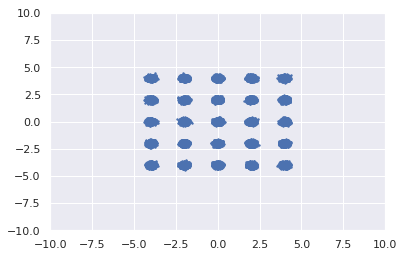

In [4]:
plt.scatter(x[:,0], x[:,1], s=2.0)
plt.xlim((-10, 10))
plt.ylim((-10, 10))
plt.show()

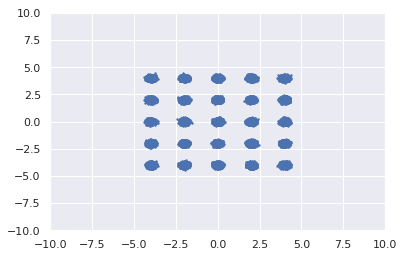

In [5]:
np.random.shuffle(x)
plt.scatter(x[:,0], x[:,1], s=2.0)
plt.xlim((-10, 10))
plt.ylim((-10, 10))
plt.show()

In [6]:
print(x.shape)

(250000, 2)


## Define Networks

In [7]:
class Generator(nn.Module):
    
    def __init__(self, input_size=10, output_size=2, hidden_size=128):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0.0)
                
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc3(x), negative_slope=2e-1)
        return x
        
class Discriminator(nn.Module):
    
    def __init__(self, input_size=2, output_size=1, hidden_size=128):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0.0)
                
    def forward(self, x):
        x = F.leaky_relu(self.fc1(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = torch.sigmoid(F.leaky_relu(self.fc3(x), negative_slope=2e-1))
        return x
        
class Mine(nn.Module):
    
    def __init__(self, noise_size=3, sample_size=2, output_size=1, hidden_size=128):
        super().__init__()
        self.fc1_noise = nn.Linear(noise_size, hidden_size, bias=False)
        self.fc1_sample = nn.Linear(sample_size, hidden_size, bias=False)
        self.fc1_bias = nn.Parameter(torch.zeros(hidden_size))
        self.fc2 = nn.Linear(hidden_size, hidden_size)
        self.fc3 = nn.Linear(hidden_size, output_size)
        
        self.ma_et = None
        
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)
                
    def forward(self, noise, sample):
        x_noise = self.fc1_noise(noise)
        x_sample = self.fc1_sample(sample)
        x = F.leaky_relu(x_noise + x_sample + self.fc1_bias, negative_slope=2e-1)
        x = F.leaky_relu(self.fc2(x), negative_slope=2e-1)
        x = F.leaky_relu(self.fc3(x), negative_slope=2e-1)
        return x

## Define training code

In [8]:
def update_target(ma_net, net, update_rate=1e-1):
        # update moving average network parameters using network
        for ma_net_param, net_param in zip(ma_net.parameters(), net.parameters()):
            ma_net_param.data.copy_((1.0 - update_rate) \
                                    * ma_net_param.data + update_rate*net_param.data)

In [20]:
def learn_discriminator(x, G, D , M, D_opt, zero_gp=True):
    '''
    real_samples : torch.Tensor
    G : Generator network
    D : Discriminator network
    M : Mutual Information Neural Estimation(MINE) network
    D_opt : Optimizer of Discriminator
    '''
    z = torch.randn((BATCH_SIZE, 10))
    if USE_GPU:
        z = z.cuda()
        x = x.cuda()
    x_tilde = G(z)
    Dx_tilde = D(x_tilde)
        
    if zero_gp:
        # zero centered gradient penalty  : https://arxiv.org/abs/1801.04406
        x.requires_grad = True
        Dx = D(x)
        grad = torch.autograd.grad(Dx, x, create_graph=True,
                             grad_outputs=torch.ones_like(Dx),
                             retain_graph=True, only_inputs=True)[0].view(BATCH_SIZE, -1)
        grad = grad.norm(dim=1)
        gp_loss = torch.mean(grad**2)
    else:
        Dx = D(x)
    
    loss = 0.
    gan_loss = - torch.log(Dx).mean() - torch.log(1-Dx_tilde).mean()
    loss += gan_loss
    if zero_gp:
        loss = gan_loss + 1.0 * gp_loss
    
    D_opt.zero_grad()
    loss.backward()
    D_opt.step()
    
    if zero_gp:
        return gan_loss.item(), gp_loss.item()
    
    return gan_loss.item(), 0

In [21]:
def learn_generator(x, G, D, M, G_opt, G_ma, mi_obj=False):
    '''
    real_samples : torch.Tensor
    G : Generator network
    D : Discriminator network
    M : Mutual Information Neural Estimation(MINE) network
    G_opt : Optimizer of Generator
    mi_reg : add Mutual information objective
    '''
    z = torch.randn((BATCH_SIZE, 10))
    z_bar = torch.narrow(torch.randn((BATCH_SIZE, 10)), dim=1, start=0, length=3)
        # which is for product distribution.
    if USE_GPU:
        z = z.cuda()
        z_bar = z_bar.cuda()
        x = x.cuda()
    x_tilde = G(z)
    Dx_tilde = D(x_tilde)
    Dx = D(x)
    
    loss = 0.
    gan_loss = torch.log(1-Dx_tilde).mean()
    loss += gan_loss
    if mi_obj:
        z = torch.narrow(z, dim=1, start=0, length=3) # slice for MI
        mi = torch.mean(M(z, x_tilde)) - torch.log(torch.mean(torch.exp(M(z_bar, x_tilde)))+1e-8)
        loss -= 0.01 * mi
    
    G_opt.zero_grad()
    loss.backward()
    G_opt.step()
    
    # EMA GAN : https://arxiv.org/abs/1806.04498
    update_target(G_ma, G)
    
    return gan_loss.item()

In [22]:
def learn_mine(G, M, M_opt, ma_rate=0.001):
    '''
    Mine is learning for MI of (input, output) of Generator.
    '''
    z = torch.randn((BATCH_SIZE, 10))
    # which is the input of Generator.
    z_bar = torch.narrow(torch.randn((BATCH_SIZE, 10)), dim=1, start=0, length=3)
    # which is for product distribution.
    if USE_GPU:
        z = z.cuda()
        z_bar = z_bar.cuda()
    x_tilde = G(z) # which is the output of Generator.
    
    et = torch.mean(torch.exp(M(z_bar, x_tilde)))
    if M.ma_et is None:
        M.ma_et = et.detach().item()
    M.ma_et += ma_rate * (et.detach().item() - M.ma_et)
    z = torch.narrow(z, dim=1, start=0, length=3) # slice for MI
    mutual_information = torch.mean(M(z, x_tilde)) \
    - torch.log(et) * et.detach() /M.ma_et
    loss = - mutual_information
    
    M_opt.zero_grad()
    loss.backward()
    M_opt.step()
    
    return mutual_information.item()

In [23]:
z_test = torch.randn((20000, 10))
if USE_GPU:
    z_test = z_test.cuda()
def train(epoch_num=300, is_zero_gp=False, is_mi_obj=False):
    for i in range(1, epoch_num+1):
        np.random.shuffle(x)
        iter_num = len(x) // BATCH_SIZE
        d_loss_arr, gp_loss_arr, g_loss_arr, mi_arr = [], [], [], []
        for j in tqdm(range(iter_num)):
            batch = torch.FloatTensor(x[BATCH_SIZE * j : BATCH_SIZE * j + BATCH_SIZE])
            d_loss, gp_loss = learn_discriminator(batch, G, D, M, D_opt, zero_gp=is_zero_gp)
            g_loss = learn_generator(batch, G, D, M, G_opt, G_ma, mi_obj=is_mi_obj)
            mi = learn_mine(G, M, M_opt)
            
            d_loss_arr.append(d_loss)
            gp_loss_arr.append(gp_loss)
            g_loss_arr.append(g_loss)
            mi_arr.append(mi)
        print('D loss : {0}, GP_loss : {1} G_loss : {2}, MI : {3}'.format(
            round(np.mean(d_loss_arr),4), round(np.mean(gp_loss_arr)),
            round(np.mean(g_loss_arr),4), round(np.mean(mi_arr),4)))
        x_test = G_ma(z_test).data.cpu().numpy()
        plt.title('Epoch {0}'.format(i))
        plt.scatter(x_test[:,0], x_test[:,1], s=2.0)
        plt.xlim((-10, 10))
        plt.ylim((-10, 10))
        plt.show()

100%|██████████| 976/976 [00:17<00:00, 56.16it/s]


D loss : 1.2654, GP_loss : 0.0 G_loss : -0.7073, MI : 0.8763


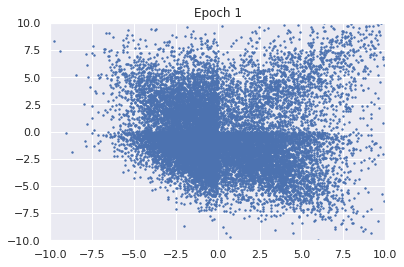

100%|██████████| 976/976 [00:15<00:00, 62.19it/s]


D loss : 1.3195, GP_loss : 0.0 G_loss : -0.7599, MI : 0.9395


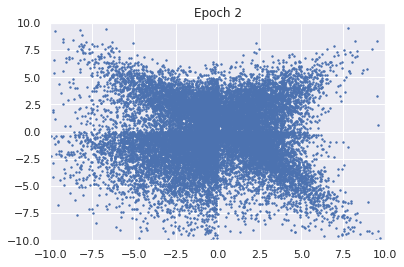

100%|██████████| 976/976 [00:15<00:00, 68.40it/s]


D loss : 1.32, GP_loss : 0.0 G_loss : -0.7591, MI : 0.6978


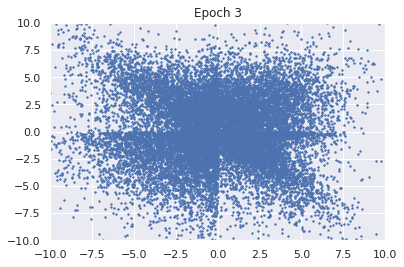

100%|██████████| 976/976 [00:17<00:00, 56.70it/s]


D loss : 1.3165, GP_loss : 0.0 G_loss : -0.7634, MI : 0.8899


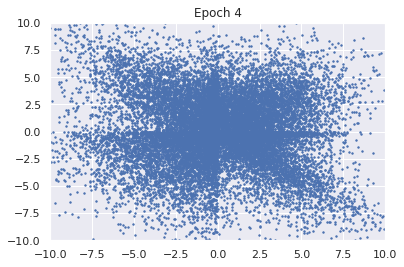

100%|██████████| 976/976 [00:17<00:00, 57.27it/s]


D loss : 1.3148, GP_loss : 0.0 G_loss : -0.7638, MI : 1.0635


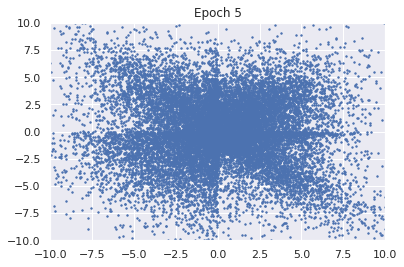

100%|██████████| 976/976 [00:17<00:00, 56.26it/s]


D loss : 1.3126, GP_loss : 0.0 G_loss : -0.7629, MI : 1.2319


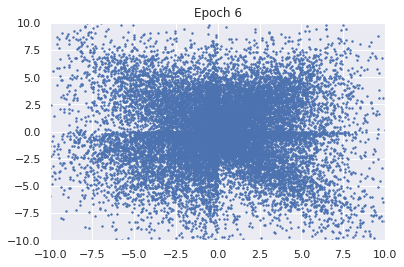

100%|██████████| 976/976 [00:17<00:00, 56.79it/s]


D loss : 1.3069, GP_loss : 0.0 G_loss : -0.7629, MI : 1.4108


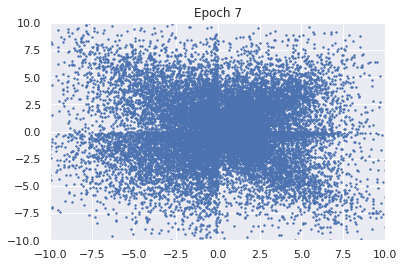

100%|██████████| 976/976 [00:17<00:00, 54.82it/s]


D loss : 1.3003, GP_loss : 0.0 G_loss : -0.7638, MI : 1.5743


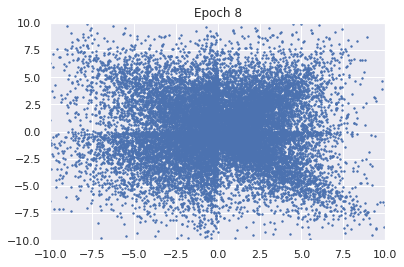

100%|██████████| 976/976 [00:17<00:00, 55.62it/s]


D loss : 1.2943, GP_loss : 0.0 G_loss : -0.7657, MI : 1.7382


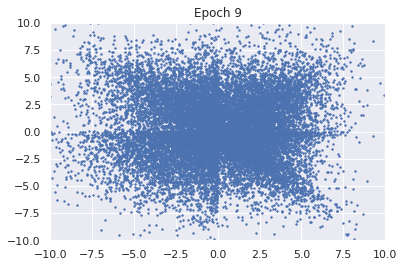

100%|██████████| 976/976 [00:17<00:00, 54.51it/s]


D loss : 1.2892, GP_loss : 0.0 G_loss : -0.768, MI : 1.9574


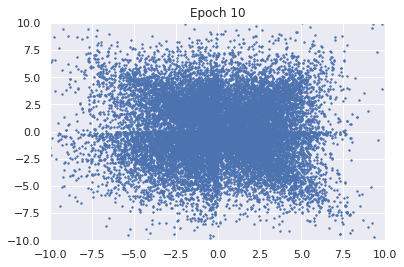

100%|██████████| 976/976 [00:17<00:00, 54.93it/s]


D loss : 1.2851, GP_loss : 0.0 G_loss : -0.7693, MI : 2.1111


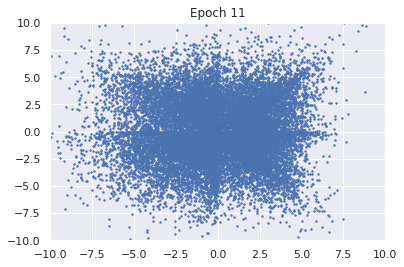

100%|██████████| 976/976 [00:17<00:00, 54.92it/s]


D loss : 1.2822, GP_loss : 0.0 G_loss : -0.7708, MI : 2.259


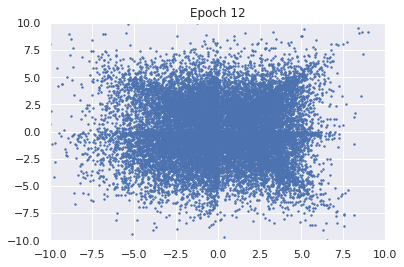

100%|██████████| 976/976 [00:17<00:00, 55.34it/s]


D loss : 1.2815, GP_loss : 0.0 G_loss : -0.7729, MI : 2.3491


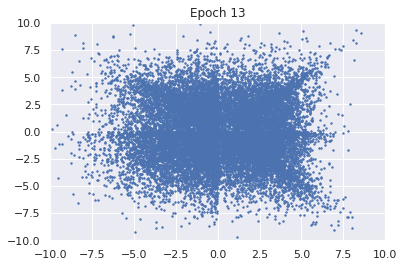

100%|██████████| 976/976 [00:17<00:00, 54.77it/s]


D loss : 1.2808, GP_loss : 0.0 G_loss : -0.7734, MI : 2.3877


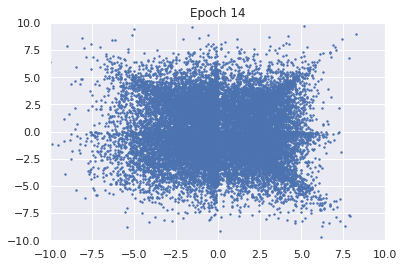

100%|██████████| 976/976 [00:17<00:00, 56.12it/s]


D loss : 1.2823, GP_loss : 0.0 G_loss : -0.7749, MI : 2.438


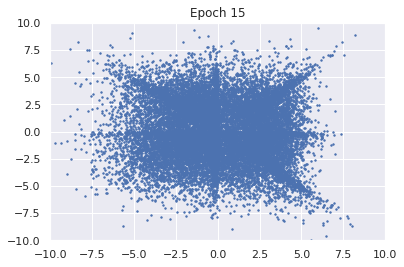

100%|██████████| 976/976 [00:17<00:00, 55.22it/s]


D loss : 1.2839, GP_loss : 0.0 G_loss : -0.7756, MI : 2.4803


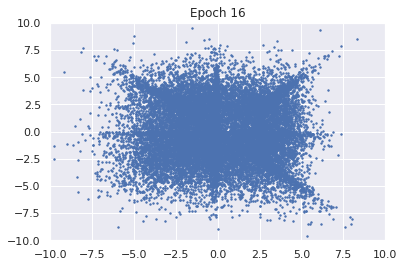

100%|██████████| 976/976 [00:17<00:00, 55.09it/s]


D loss : 1.2868, GP_loss : 0.0 G_loss : -0.7757, MI : 2.4817


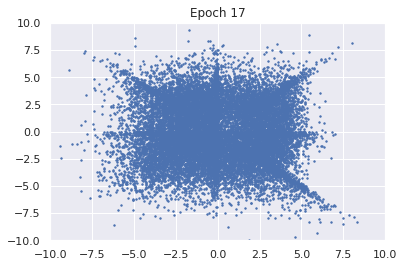

100%|██████████| 976/976 [00:17<00:00, 55.12it/s]


D loss : 1.2893, GP_loss : 0.0 G_loss : -0.7751, MI : 2.4627


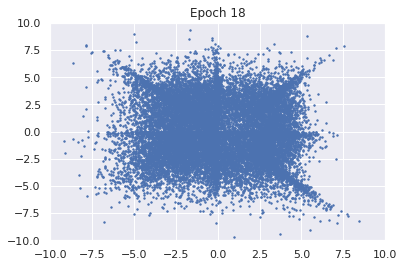

100%|██████████| 976/976 [00:17<00:00, 55.22it/s]


D loss : 1.2923, GP_loss : 0.0 G_loss : -0.7761, MI : 2.4334


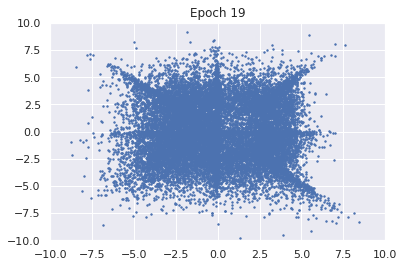

100%|██████████| 976/976 [00:17<00:00, 54.95it/s]


D loss : 1.2945, GP_loss : 0.0 G_loss : -0.7775, MI : 2.4491


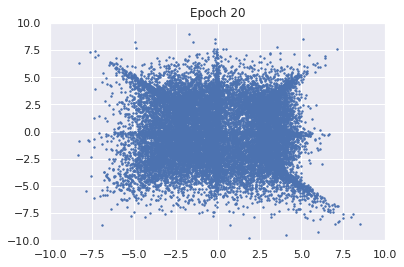

100%|██████████| 976/976 [00:17<00:00, 56.04it/s]


D loss : 1.2949, GP_loss : 0.0 G_loss : -0.778, MI : 2.4604


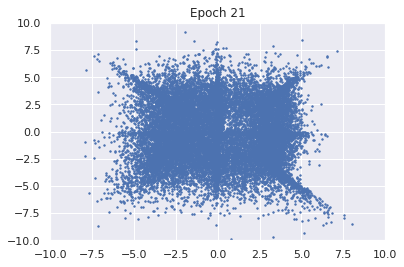

100%|██████████| 976/976 [00:17<00:00, 54.68it/s]


D loss : 1.2953, GP_loss : 0.0 G_loss : -0.7771, MI : 2.4485


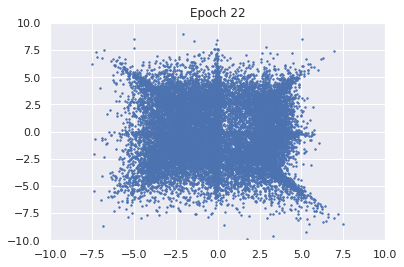

100%|██████████| 976/976 [00:17<00:00, 55.55it/s]


D loss : 1.2951, GP_loss : 0.0 G_loss : -0.7775, MI : 2.4368


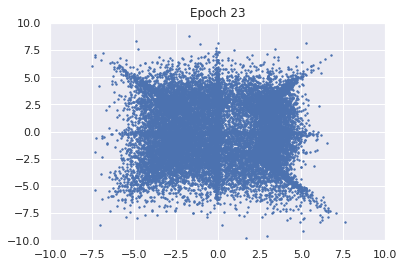

100%|██████████| 976/976 [00:17<00:00, 55.85it/s]


D loss : 1.2959, GP_loss : 0.0 G_loss : -0.7778, MI : 2.4294


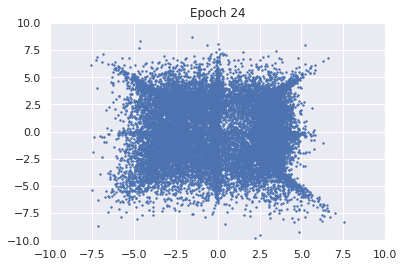

100%|██████████| 976/976 [00:17<00:00, 55.02it/s]


D loss : 1.2965, GP_loss : 0.0 G_loss : -0.7779, MI : 2.4884


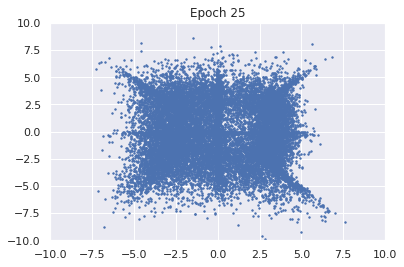

100%|██████████| 976/976 [00:17<00:00, 55.11it/s]


D loss : 1.2981, GP_loss : 0.0 G_loss : -0.7764, MI : 2.4816


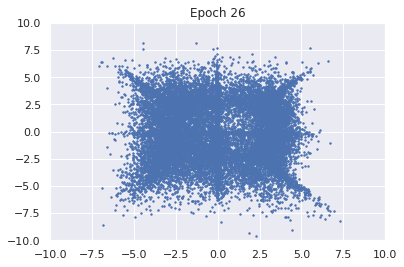

100%|██████████| 976/976 [00:17<00:00, 55.77it/s]


D loss : 1.2995, GP_loss : 0.0 G_loss : -0.7772, MI : 2.4948


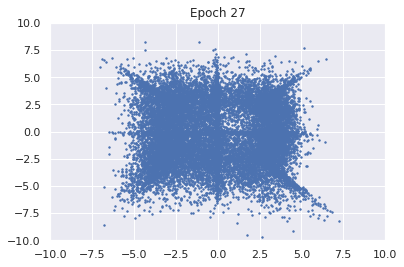

100%|██████████| 976/976 [00:17<00:00, 55.53it/s]


D loss : 1.3, GP_loss : 0.0 G_loss : -0.7764, MI : 2.4801


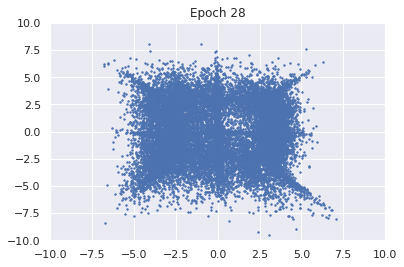

100%|██████████| 976/976 [00:17<00:00, 55.16it/s]


D loss : 1.301, GP_loss : 0.0 G_loss : -0.7755, MI : 2.493


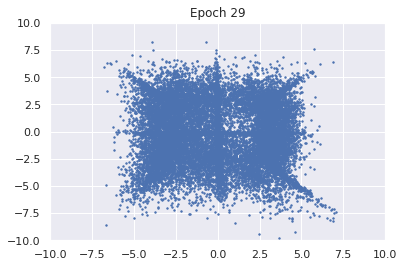

100%|██████████| 976/976 [00:17<00:00, 56.12it/s]


D loss : 1.3018, GP_loss : 0.0 G_loss : -0.7752, MI : 2.5133


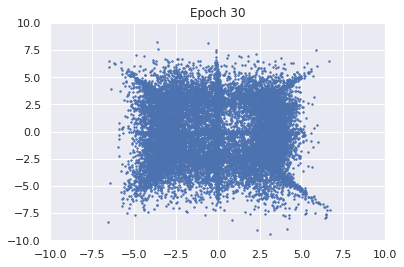

100%|██████████| 976/976 [00:17<00:00, 55.36it/s]


D loss : 1.3027, GP_loss : 0.0 G_loss : -0.7763, MI : 2.5218


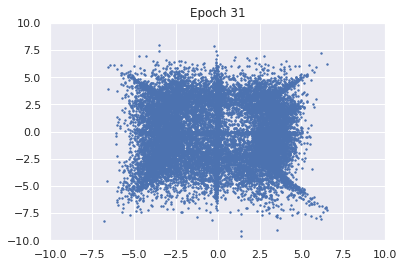

100%|██████████| 976/976 [00:17<00:00, 55.62it/s]


D loss : 1.3044, GP_loss : 0.0 G_loss : -0.7752, MI : 2.5531


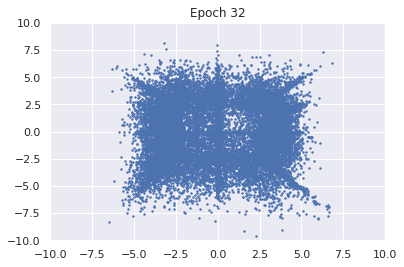

100%|██████████| 976/976 [00:17<00:00, 54.91it/s]


D loss : 1.3039, GP_loss : 0.0 G_loss : -0.7747, MI : 2.5651


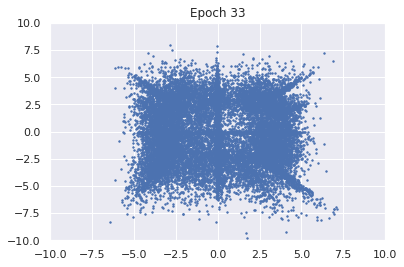

100%|██████████| 976/976 [00:17<00:00, 55.20it/s]


D loss : 1.3028, GP_loss : 0.0 G_loss : -0.7761, MI : 2.5027


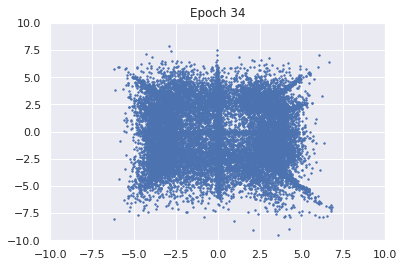

100%|██████████| 976/976 [00:17<00:00, 56.01it/s]


D loss : 1.3021, GP_loss : 0.0 G_loss : -0.7754, MI : 2.5643


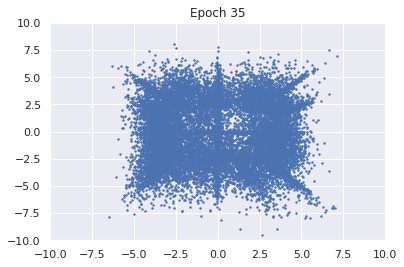

100%|██████████| 976/976 [00:16<00:00, 58.02it/s]


D loss : 1.3021, GP_loss : 0.0 G_loss : -0.7759, MI : 2.5707


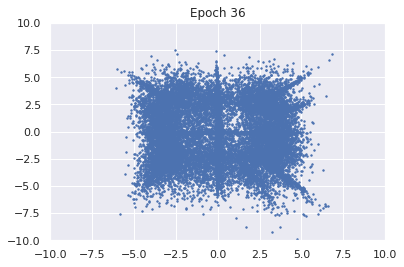

100%|██████████| 976/976 [00:16<00:00, 58.81it/s]


D loss : 1.3021, GP_loss : 0.0 G_loss : -0.7755, MI : 2.5543


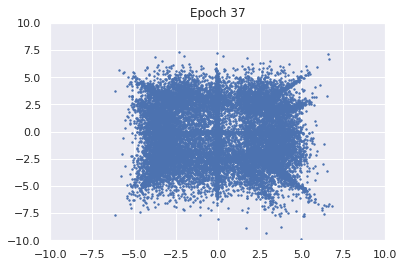

100%|██████████| 976/976 [00:17<00:00, 56.40it/s]


D loss : 1.3023, GP_loss : 0.0 G_loss : -0.775, MI : 2.5919


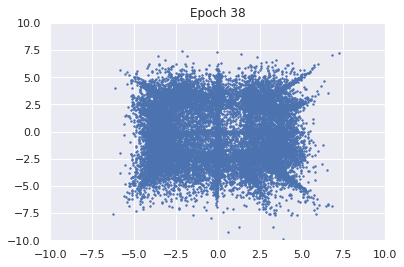

100%|██████████| 976/976 [00:15<00:00, 54.50it/s]


D loss : 1.3023, GP_loss : 0.0 G_loss : -0.7747, MI : 2.5722


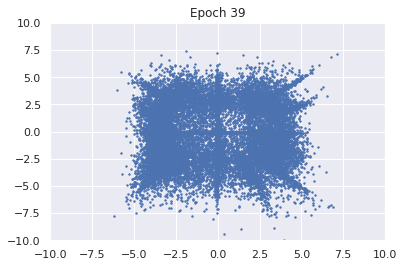

100%|██████████| 976/976 [00:16<00:00, 68.04it/s]


D loss : 1.3026, GP_loss : 0.0 G_loss : -0.7751, MI : 2.6054


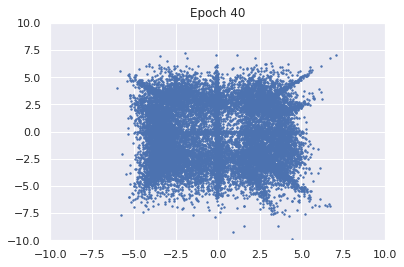

100%|██████████| 976/976 [00:12<00:00, 75.33it/s]


D loss : 1.3035, GP_loss : 0.0 G_loss : -0.7739, MI : 2.6068


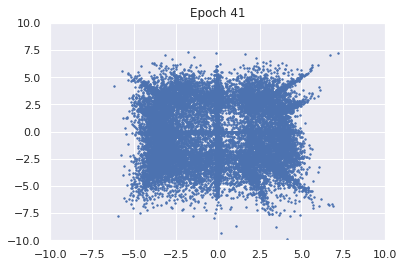

100%|██████████| 976/976 [00:17<00:00, 56.96it/s]


D loss : 1.3036, GP_loss : 0.0 G_loss : -0.7738, MI : 2.6124


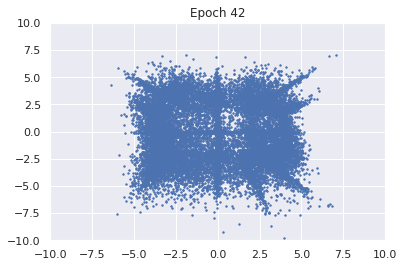

100%|██████████| 976/976 [00:17<00:00, 57.23it/s]


D loss : 1.3035, GP_loss : 0.0 G_loss : -0.7754, MI : 2.6174


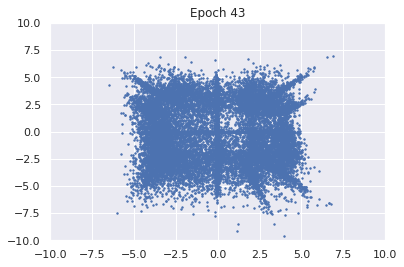

100%|██████████| 976/976 [00:16<00:00, 58.94it/s]


D loss : 1.3045, GP_loss : 0.0 G_loss : -0.7741, MI : 2.6442


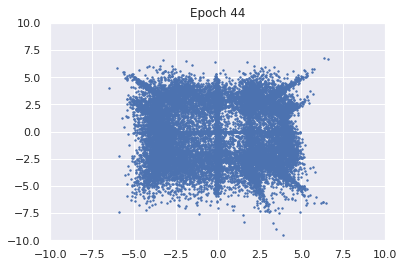

100%|██████████| 976/976 [00:16<00:00, 60.15it/s]


D loss : 1.3051, GP_loss : 0.0 G_loss : -0.774, MI : 2.6105


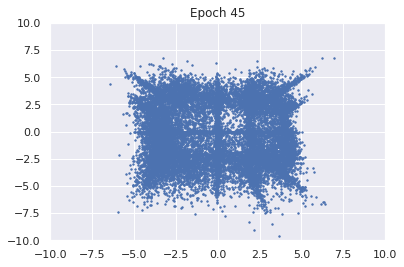

100%|██████████| 976/976 [00:17<00:00, 56.34it/s]


D loss : 1.3061, GP_loss : 0.0 G_loss : -0.7742, MI : 2.6146


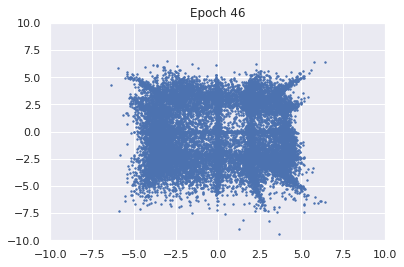

100%|██████████| 976/976 [00:17<00:00, 55.88it/s]


D loss : 1.307, GP_loss : 0.0 G_loss : -0.7737, MI : 2.6457


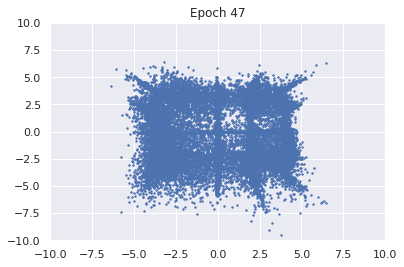

100%|██████████| 976/976 [00:17<00:00, 54.93it/s]


D loss : 1.3076, GP_loss : 0.0 G_loss : -0.7737, MI : 2.6131


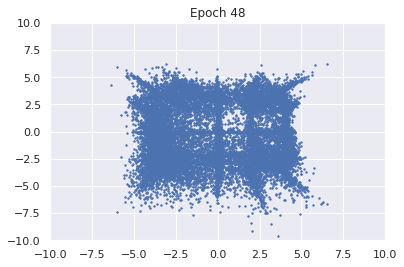

100%|██████████| 976/976 [00:17<00:00, 54.76it/s]


D loss : 1.3084, GP_loss : 0.0 G_loss : -0.7748, MI : 2.6314


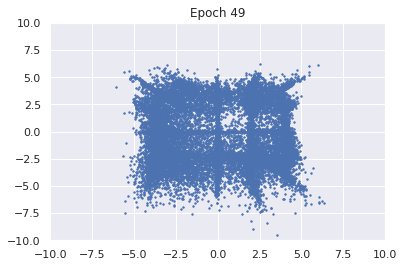

100%|██████████| 976/976 [00:17<00:00, 54.83it/s]


D loss : 1.3078, GP_loss : 0.0 G_loss : -0.7744, MI : 2.6087


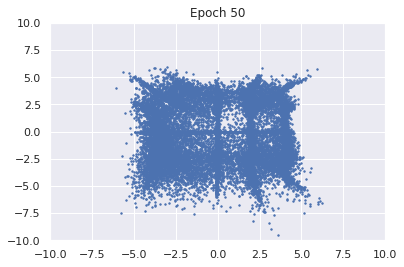

100%|██████████| 976/976 [00:16<00:00, 57.68it/s]


D loss : 1.306, GP_loss : 0.0 G_loss : -0.774, MI : 2.6205


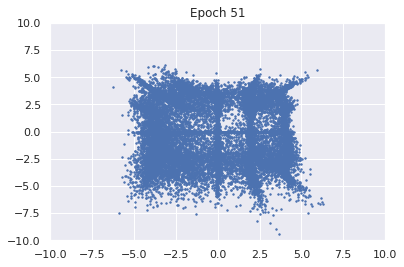

100%|██████████| 976/976 [00:17<00:00, 54.89it/s]


D loss : 1.3055, GP_loss : 0.0 G_loss : -0.774, MI : 2.6337


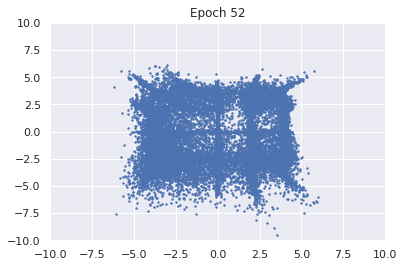

100%|██████████| 976/976 [00:17<00:00, 54.77it/s]


D loss : 1.3052, GP_loss : 0.0 G_loss : -0.774, MI : 2.6357


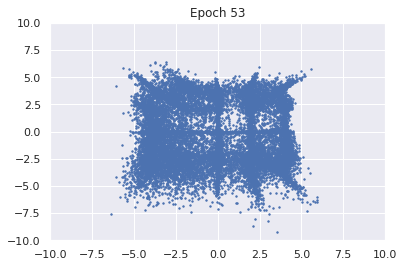

100%|██████████| 976/976 [00:17<00:00, 54.77it/s]


D loss : 1.3055, GP_loss : 0.0 G_loss : -0.7745, MI : 2.6324


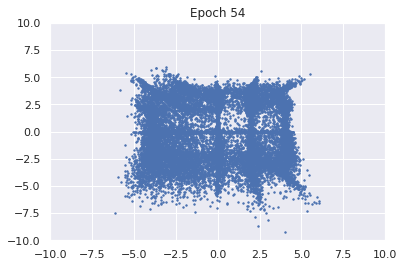

100%|██████████| 976/976 [00:17<00:00, 54.96it/s]


D loss : 1.3049, GP_loss : 0.0 G_loss : -0.7748, MI : 2.6544


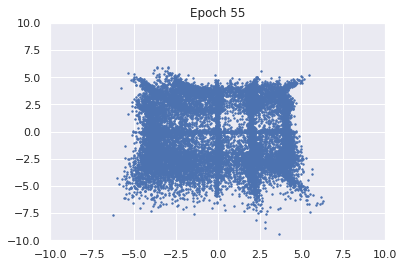

100%|██████████| 976/976 [00:17<00:00, 55.59it/s]


D loss : 1.305, GP_loss : 0.0 G_loss : -0.7746, MI : 2.659


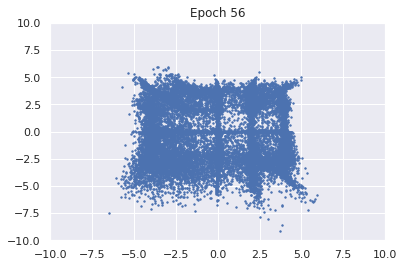

100%|██████████| 976/976 [00:17<00:00, 54.85it/s]


D loss : 1.3056, GP_loss : 0.0 G_loss : -0.7759, MI : 2.611


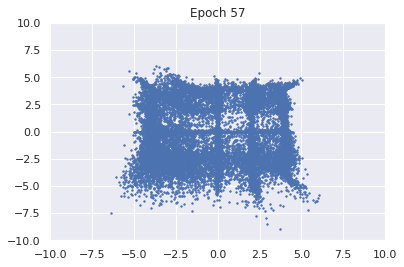

100%|██████████| 976/976 [00:17<00:00, 54.79it/s]


D loss : 1.3053, GP_loss : 0.0 G_loss : -0.7757, MI : 2.618


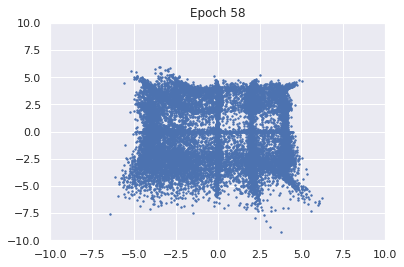

100%|██████████| 976/976 [00:17<00:00, 54.41it/s]


D loss : 1.3049, GP_loss : 0.0 G_loss : -0.7755, MI : 2.6622


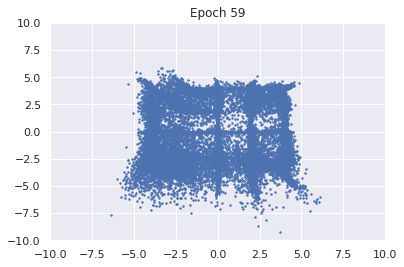

100%|██████████| 976/976 [00:17<00:00, 58.40it/s]


D loss : 1.3062, GP_loss : 0.0 G_loss : -0.7761, MI : 2.6406


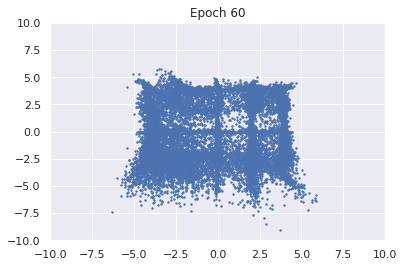

100%|██████████| 976/976 [00:13<00:00, 72.15it/s]


D loss : 1.3062, GP_loss : 0.0 G_loss : -0.776, MI : 2.6243


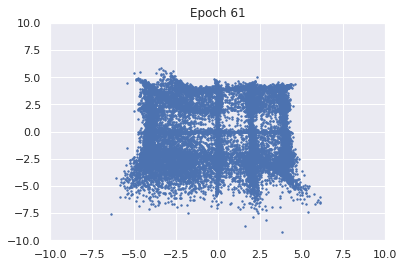

100%|██████████| 976/976 [00:13<00:00, 72.66it/s]


D loss : 1.306, GP_loss : 0.0 G_loss : -0.7757, MI : 2.6421


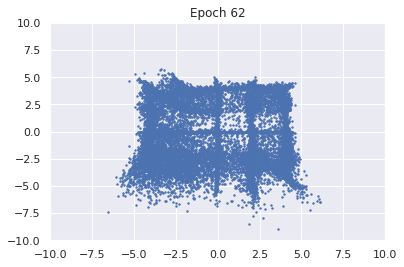

100%|██████████| 976/976 [00:15<00:00, 58.18it/s]


D loss : 1.3065, GP_loss : 0.0 G_loss : -0.7765, MI : 2.6135


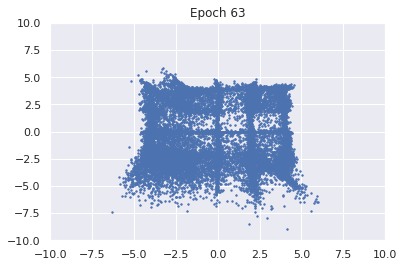

100%|██████████| 976/976 [00:17<00:00, 56.30it/s]


D loss : 1.3071, GP_loss : 0.0 G_loss : -0.7759, MI : 2.6639


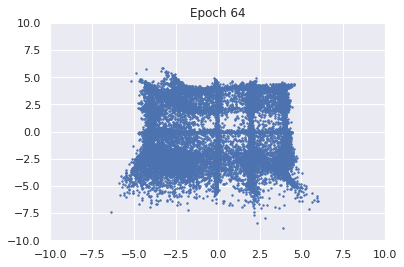

100%|██████████| 976/976 [00:17<00:00, 55.61it/s]


D loss : 1.307, GP_loss : 0.0 G_loss : -0.7762, MI : 2.6328


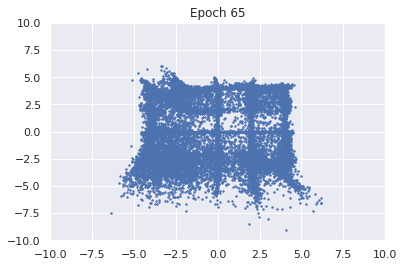

100%|██████████| 976/976 [00:17<00:00, 56.77it/s]


D loss : 1.3075, GP_loss : 0.0 G_loss : -0.7765, MI : 2.6995


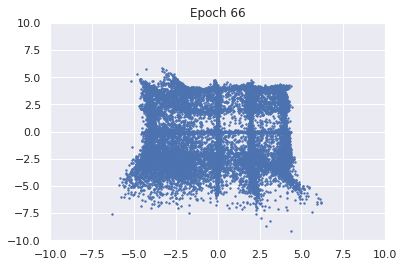

100%|██████████| 976/976 [00:17<00:00, 54.97it/s]


D loss : 1.3082, GP_loss : 0.0 G_loss : -0.7782, MI : 2.6598


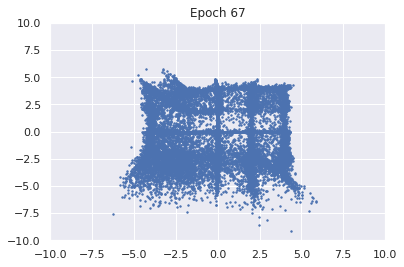

100%|██████████| 976/976 [00:17<00:00, 55.02it/s]


D loss : 1.3077, GP_loss : 0.0 G_loss : -0.7757, MI : 2.6862


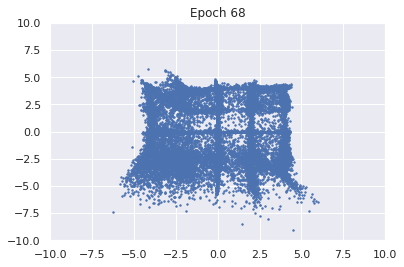

100%|██████████| 976/976 [00:17<00:00, 55.34it/s]


D loss : 1.3085, GP_loss : 0.0 G_loss : -0.7765, MI : 2.6581


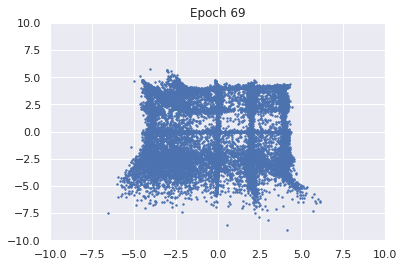

100%|██████████| 976/976 [00:17<00:00, 55.05it/s]


D loss : 1.3083, GP_loss : 0.0 G_loss : -0.7768, MI : 2.6743


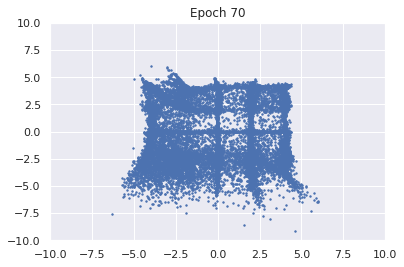

100%|██████████| 976/976 [00:17<00:00, 54.91it/s]


D loss : 1.3092, GP_loss : 0.0 G_loss : -0.7767, MI : 2.6495


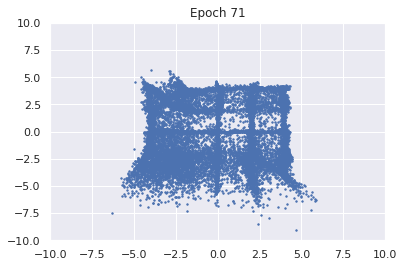

100%|██████████| 976/976 [00:17<00:00, 55.43it/s]


D loss : 1.3096, GP_loss : 0.0 G_loss : -0.7763, MI : 2.6717


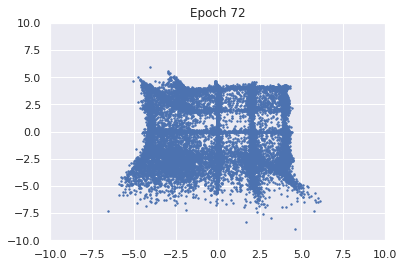

100%|██████████| 976/976 [00:17<00:00, 55.49it/s]


D loss : 1.3084, GP_loss : 0.0 G_loss : -0.778, MI : 2.6895


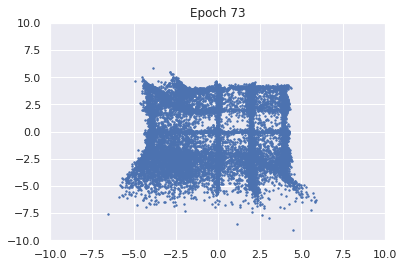

100%|██████████| 976/976 [00:17<00:00, 55.92it/s]


D loss : 1.309, GP_loss : 0.0 G_loss : -0.7771, MI : 2.7047


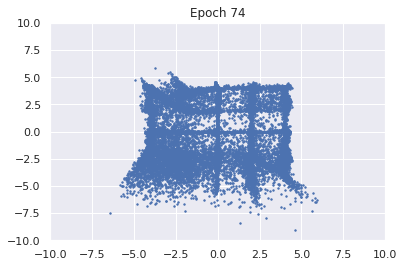

100%|██████████| 976/976 [00:10<00:00, 92.94it/s]


D loss : 1.3085, GP_loss : 0.0 G_loss : -0.7771, MI : 2.7236


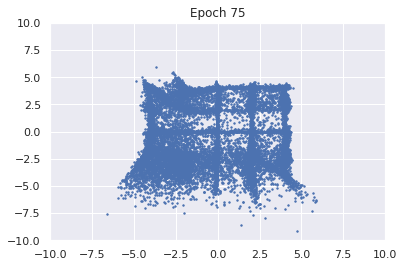

100%|██████████| 976/976 [00:17<00:00, 55.78it/s]


D loss : 1.309, GP_loss : 0.0 G_loss : -0.7771, MI : 2.6943


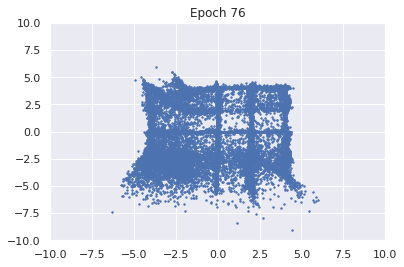

100%|██████████| 976/976 [00:17<00:00, 56.67it/s]


D loss : 1.3086, GP_loss : 0.0 G_loss : -0.7765, MI : 2.7121


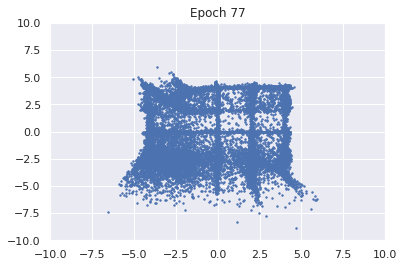

100%|██████████| 976/976 [00:17<00:00, 55.92it/s]


D loss : 1.3084, GP_loss : 0.0 G_loss : -0.777, MI : 2.7104


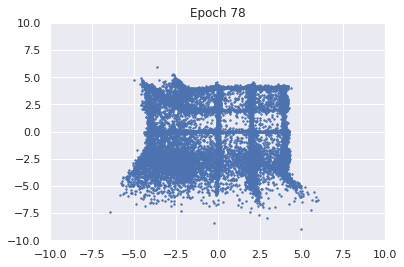

100%|██████████| 976/976 [00:17<00:00, 56.00it/s]


D loss : 1.3091, GP_loss : 0.0 G_loss : -0.777, MI : 2.6991


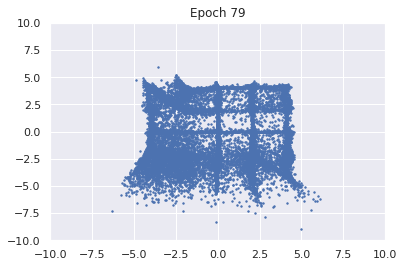

100%|██████████| 976/976 [00:17<00:00, 55.96it/s]


D loss : 1.3088, GP_loss : 0.0 G_loss : -0.7772, MI : 2.6918


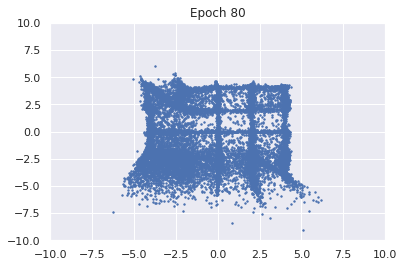

100%|██████████| 976/976 [00:15<00:00, 63.82it/s]


D loss : 1.3086, GP_loss : 0.0 G_loss : -0.7768, MI : 2.7336


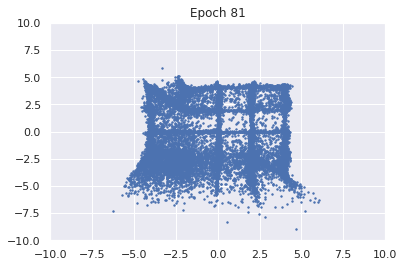

100%|██████████| 976/976 [00:17<00:00, 54.87it/s]


D loss : 1.3076, GP_loss : 0.0 G_loss : -0.7775, MI : 2.7282


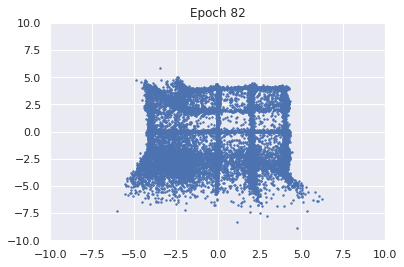

100%|██████████| 976/976 [00:17<00:00, 54.86it/s]


D loss : 1.3076, GP_loss : 0.0 G_loss : -0.7771, MI : 2.6995


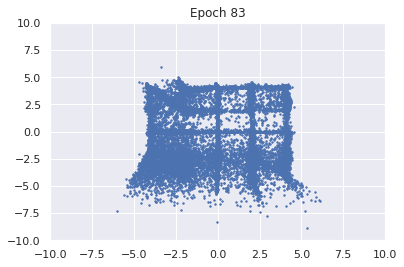

100%|██████████| 976/976 [00:17<00:00, 54.39it/s]


D loss : 1.3079, GP_loss : 0.0 G_loss : -0.7776, MI : 2.7298


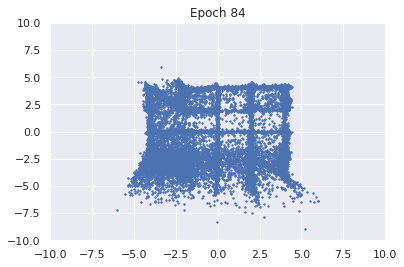

100%|██████████| 976/976 [00:17<00:00, 54.86it/s]


D loss : 1.3072, GP_loss : 0.0 G_loss : -0.778, MI : 2.7005


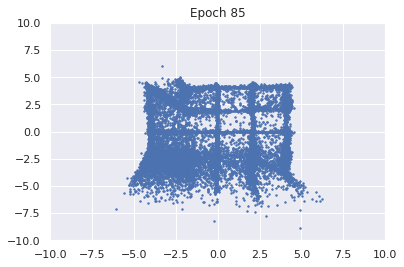

100%|██████████| 976/976 [00:17<00:00, 54.87it/s]


D loss : 1.3078, GP_loss : 0.0 G_loss : -0.7772, MI : 2.7043


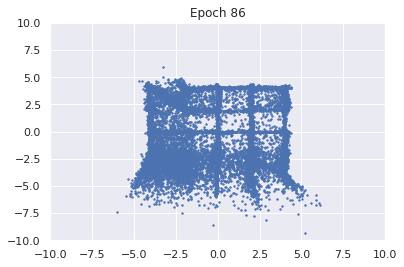

100%|██████████| 976/976 [00:17<00:00, 55.24it/s]


D loss : 1.3073, GP_loss : 0.0 G_loss : -0.7772, MI : 2.7031


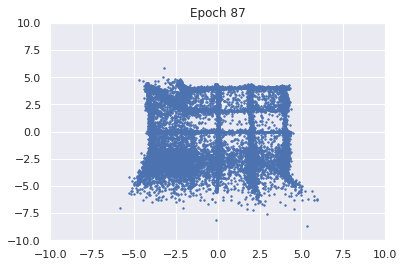

100%|██████████| 976/976 [00:15<00:00, 61.58it/s]


D loss : 1.3077, GP_loss : 0.0 G_loss : -0.7769, MI : 2.7174


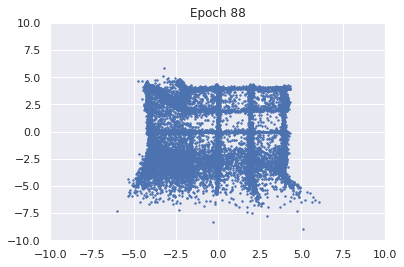

100%|██████████| 976/976 [00:10<00:00, 92.22it/s]


D loss : 1.3079, GP_loss : 0.0 G_loss : -0.7769, MI : 2.7148


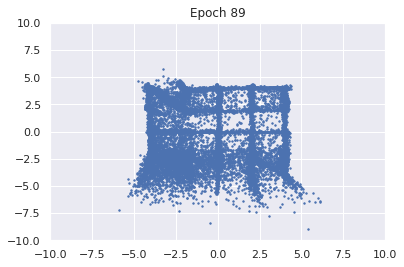

100%|██████████| 976/976 [00:10<00:00, 91.59it/s]


D loss : 1.3078, GP_loss : 0.0 G_loss : -0.7776, MI : 2.6725


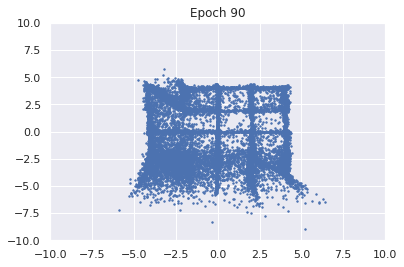

100%|██████████| 976/976 [00:10<00:00, 92.07it/s]


D loss : 1.3078, GP_loss : 0.0 G_loss : -0.7776, MI : 2.7285


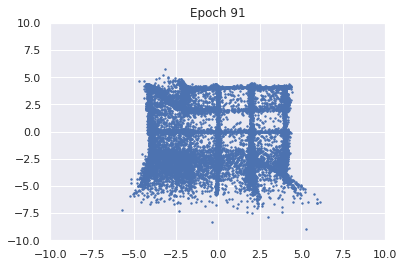

100%|██████████| 976/976 [00:11<00:00, 82.22it/s]


D loss : 1.3088, GP_loss : 0.0 G_loss : -0.7778, MI : 2.7111


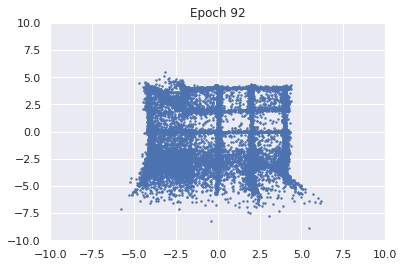

100%|██████████| 976/976 [00:16<00:00, 59.24it/s]


D loss : 1.3089, GP_loss : 0.0 G_loss : -0.7771, MI : 2.636


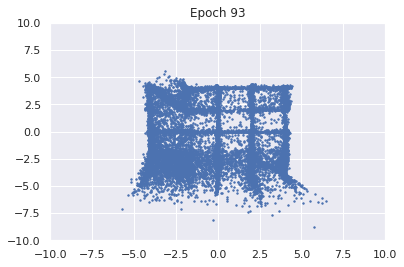

100%|██████████| 976/976 [00:17<00:00, 55.44it/s]


D loss : 1.3087, GP_loss : 0.0 G_loss : -0.7778, MI : 2.7084


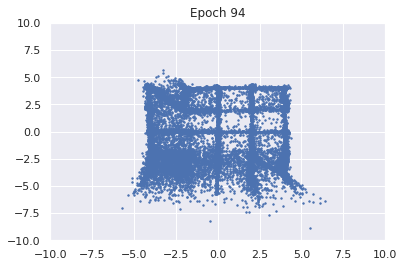

100%|██████████| 976/976 [00:15<00:00, 63.37it/s]


D loss : 1.3089, GP_loss : 0.0 G_loss : -0.7778, MI : 2.7192


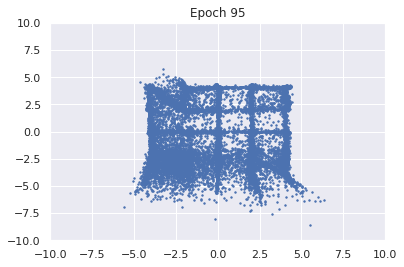

100%|██████████| 976/976 [00:14<00:00, 65.92it/s]


D loss : 1.309, GP_loss : 0.0 G_loss : -0.7785, MI : 2.7195


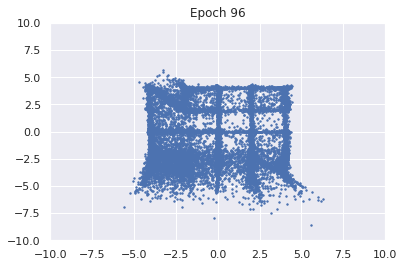

100%|██████████| 976/976 [00:17<00:00, 55.35it/s]


D loss : 1.3086, GP_loss : 0.0 G_loss : -0.7792, MI : 2.7142


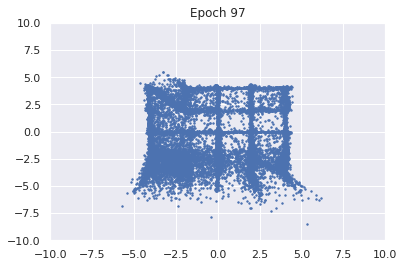

100%|██████████| 976/976 [00:15<00:00, 62.32it/s]


D loss : 1.3092, GP_loss : 0.0 G_loss : -0.7777, MI : 2.7489


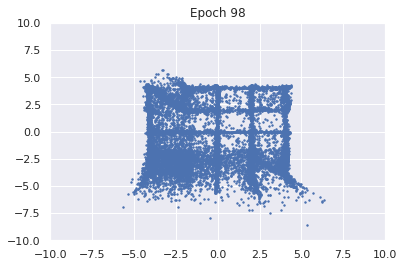

100%|██████████| 976/976 [00:10<00:00, 90.14it/s]


D loss : 1.3093, GP_loss : 0.0 G_loss : -0.7775, MI : 2.6916


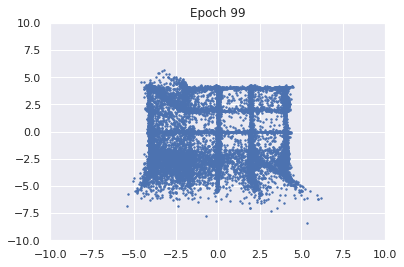

100%|██████████| 976/976 [00:10<00:00, 92.09it/s]


D loss : 1.3091, GP_loss : 0.0 G_loss : -0.7771, MI : 2.7116


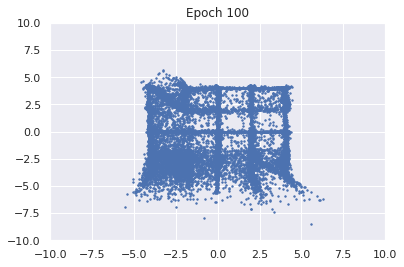

100%|██████████| 976/976 [00:12<00:00, 75.78it/s]


D loss : 1.3099, GP_loss : 0.0 G_loss : -0.7775, MI : 2.7272


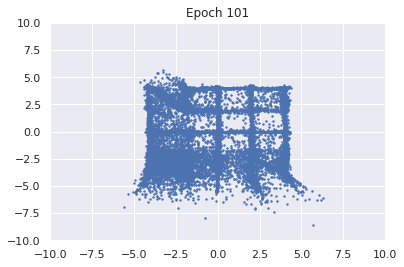

100%|██████████| 976/976 [00:13<00:00, 70.27it/s]


D loss : 1.3093, GP_loss : 0.0 G_loss : -0.7777, MI : 2.7352


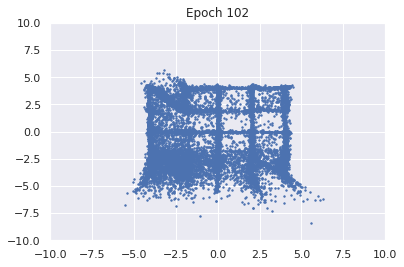

100%|██████████| 976/976 [00:14<00:00, 68.31it/s]


D loss : 1.3091, GP_loss : 0.0 G_loss : -0.7782, MI : 2.7202


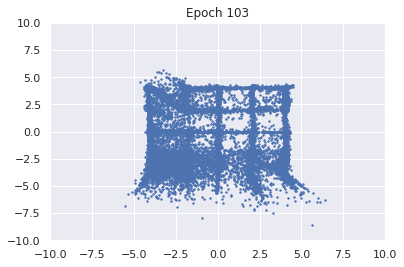

100%|██████████| 976/976 [00:17<00:00, 55.27it/s]


D loss : 1.3093, GP_loss : 0.0 G_loss : -0.7786, MI : 2.7549


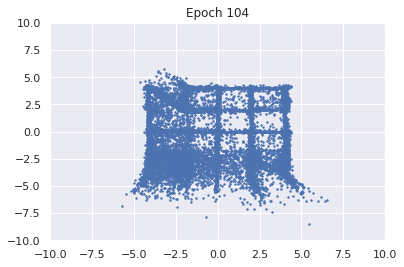

100%|██████████| 976/976 [00:17<00:00, 55.82it/s]


D loss : 1.3095, GP_loss : 0.0 G_loss : -0.7795, MI : 2.7387


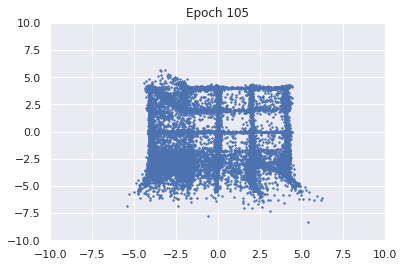

100%|██████████| 976/976 [00:17<00:00, 55.83it/s]


D loss : 1.3101, GP_loss : 0.0 G_loss : -0.7792, MI : 2.7317


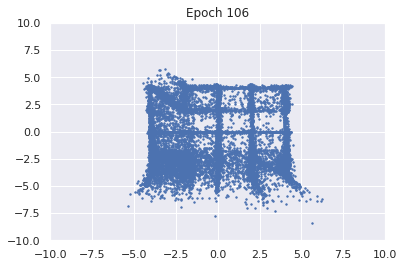

100%|██████████| 976/976 [00:17<00:00, 56.31it/s]


D loss : 1.3103, GP_loss : 0.0 G_loss : -0.7793, MI : 2.7317


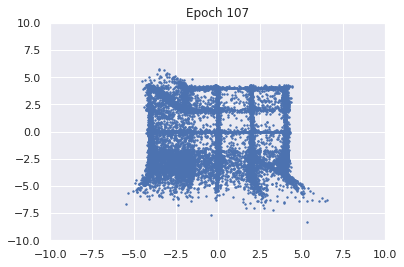

100%|██████████| 976/976 [00:17<00:00, 56.33it/s]


D loss : 1.3104, GP_loss : 0.0 G_loss : -0.7789, MI : 2.7466


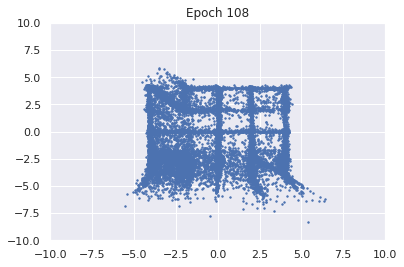

100%|██████████| 976/976 [00:17<00:00, 55.22it/s]


D loss : 1.3106, GP_loss : 0.0 G_loss : -0.7801, MI : 2.7228


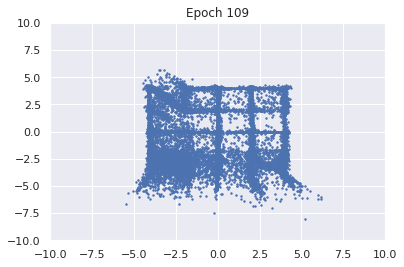

100%|██████████| 976/976 [00:17<00:00, 55.30it/s]


D loss : 1.3122, GP_loss : 0.0 G_loss : -0.7792, MI : 2.7529


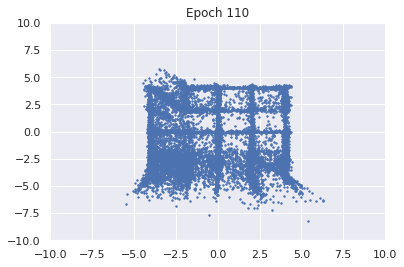

100%|██████████| 976/976 [00:17<00:00, 55.81it/s]


D loss : 1.3116, GP_loss : 0.0 G_loss : -0.7797, MI : 2.6839


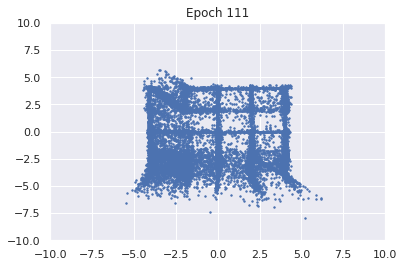

100%|██████████| 976/976 [00:17<00:00, 56.35it/s]


D loss : 1.3123, GP_loss : 0.0 G_loss : -0.7794, MI : 2.7076


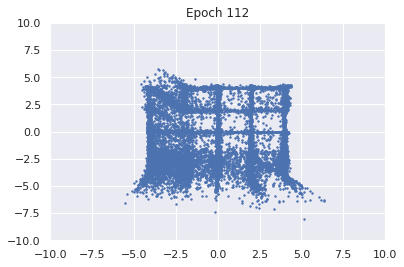

100%|██████████| 976/976 [00:17<00:00, 56.71it/s]


D loss : 1.3132, GP_loss : 0.0 G_loss : -0.7796, MI : 2.7193


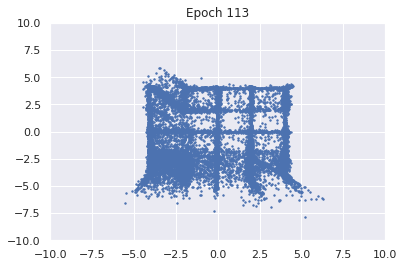

100%|██████████| 976/976 [00:17<00:00, 55.38it/s]


D loss : 1.3137, GP_loss : 0.0 G_loss : -0.7797, MI : 2.6998


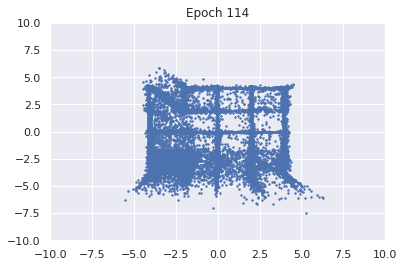

100%|██████████| 976/976 [00:17<00:00, 56.05it/s]


D loss : 1.3143, GP_loss : 0.0 G_loss : -0.7799, MI : 2.6764


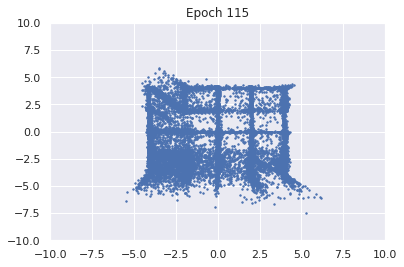

100%|██████████| 976/976 [00:10<00:00, 92.97it/s]


D loss : 1.3148, GP_loss : 0.0 G_loss : -0.7792, MI : 2.6721


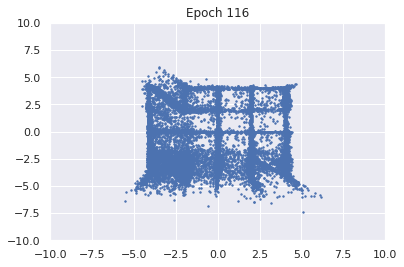

100%|██████████| 976/976 [00:10<00:00, 94.05it/s]


D loss : 1.3153, GP_loss : 0.0 G_loss : -0.781, MI : 2.6563


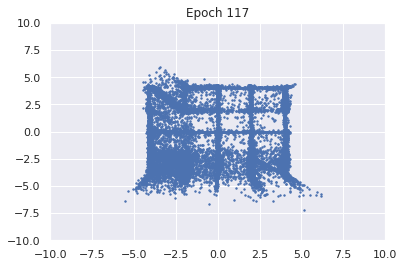

100%|██████████| 976/976 [00:10<00:00, 94.24it/s]


D loss : 1.3166, GP_loss : 0.0 G_loss : -0.7793, MI : 2.6547


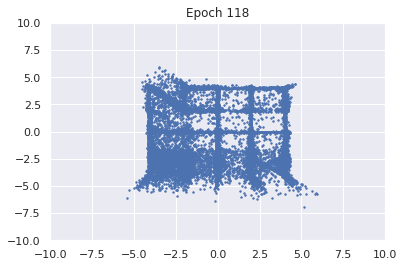

100%|██████████| 976/976 [00:16<00:00, 60.18it/s]


D loss : 1.3179, GP_loss : 0.0 G_loss : -0.78, MI : 2.6325


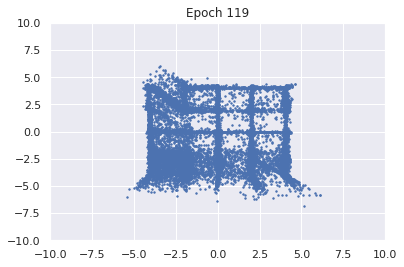

100%|██████████| 976/976 [00:17<00:00, 55.87it/s]


D loss : 1.3184, GP_loss : 0.0 G_loss : -0.7793, MI : 2.6424


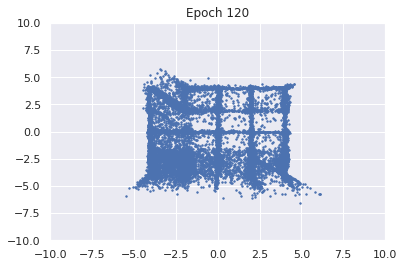

100%|██████████| 976/976 [00:17<00:00, 56.28it/s]


D loss : 1.3197, GP_loss : 0.0 G_loss : -0.7792, MI : 2.5989


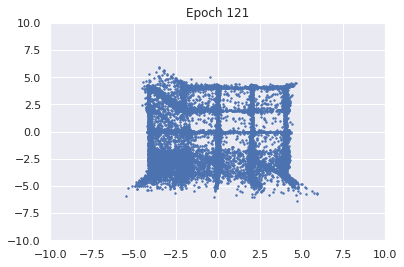

100%|██████████| 976/976 [00:17<00:00, 56.01it/s]


D loss : 1.3213, GP_loss : 0.0 G_loss : -0.7792, MI : 2.6409


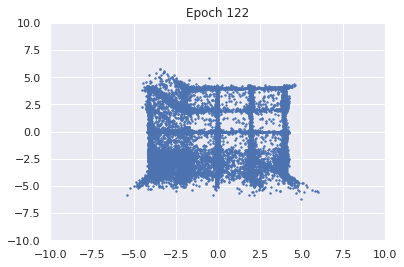

100%|██████████| 976/976 [00:17<00:00, 56.26it/s]


D loss : 1.322, GP_loss : 0.0 G_loss : -0.7801, MI : 2.5609


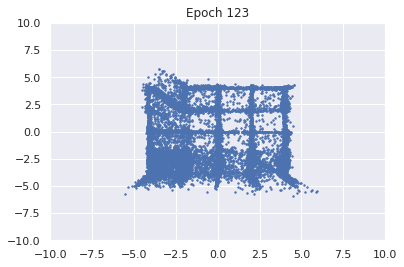

100%|██████████| 976/976 [00:17<00:00, 56.43it/s]


D loss : 1.3235, GP_loss : 0.0 G_loss : -0.7811, MI : 2.5733


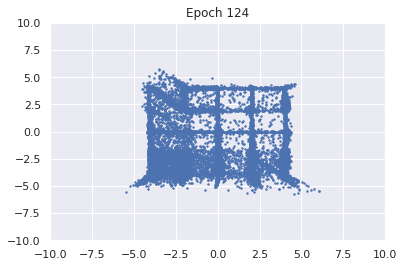

100%|██████████| 976/976 [00:17<00:00, 56.49it/s]


D loss : 1.3248, GP_loss : 0.0 G_loss : -0.7798, MI : 2.5742


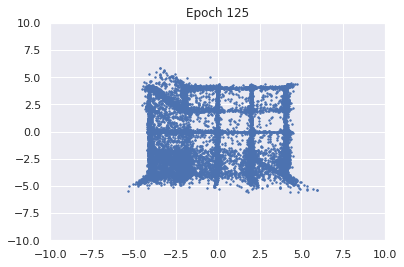

100%|██████████| 976/976 [00:13<00:00, 72.97it/s]


D loss : 1.3257, GP_loss : 0.0 G_loss : -0.7809, MI : 2.5345


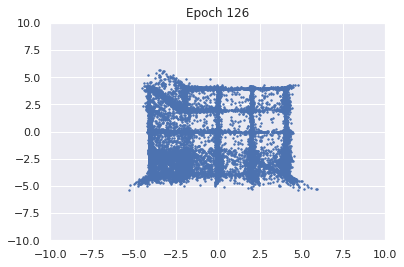

100%|██████████| 976/976 [00:16<00:00, 60.11it/s]


D loss : 1.3278, GP_loss : 0.0 G_loss : -0.7801, MI : 2.5386


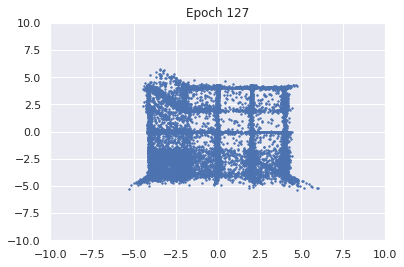

100%|██████████| 976/976 [00:17<00:00, 56.96it/s]


D loss : 1.3297, GP_loss : 0.0 G_loss : -0.7806, MI : 2.5221


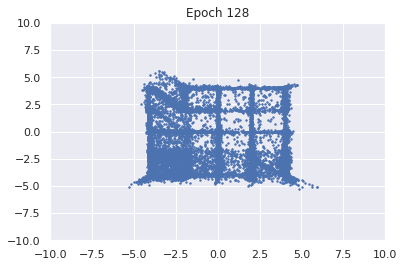

100%|██████████| 976/976 [00:17<00:00, 56.71it/s]


D loss : 1.3321, GP_loss : 0.0 G_loss : -0.7778, MI : 2.4863


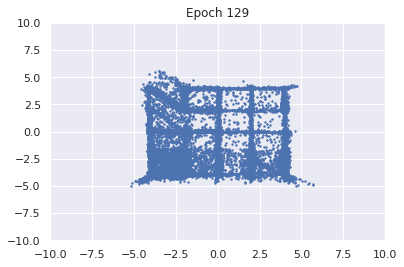

100%|██████████| 976/976 [00:17<00:00, 56.92it/s]


D loss : 1.3328, GP_loss : 0.0 G_loss : -0.7788, MI : 2.5123


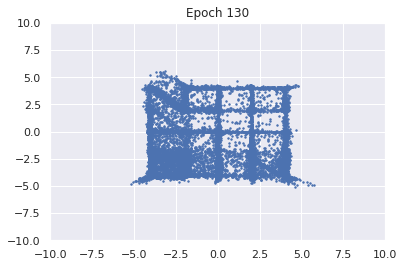

100%|██████████| 976/976 [00:17<00:00, 57.31it/s]


D loss : 1.3344, GP_loss : 0.0 G_loss : -0.7794, MI : 2.5379


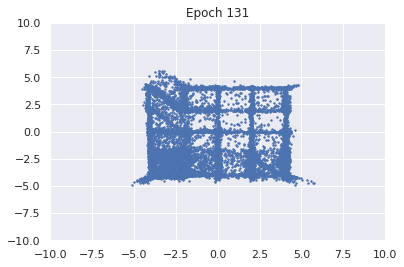

100%|██████████| 976/976 [00:16<00:00, 57.70it/s]


D loss : 1.3359, GP_loss : 0.0 G_loss : -0.7785, MI : 2.4995


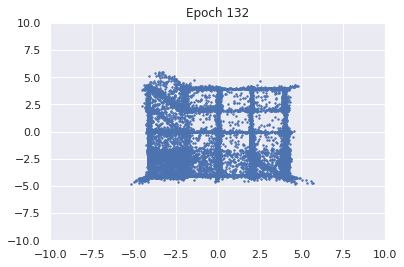

100%|██████████| 976/976 [00:16<00:00, 60.12it/s]


D loss : 1.3372, GP_loss : 0.0 G_loss : -0.778, MI : 2.5044


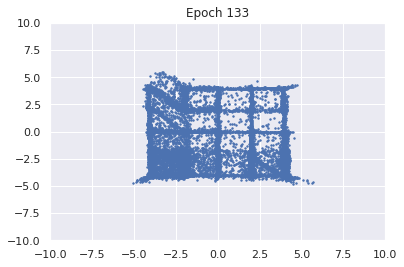

100%|██████████| 976/976 [00:16<00:00, 60.11it/s]


D loss : 1.3383, GP_loss : 0.0 G_loss : -0.7779, MI : 2.5232


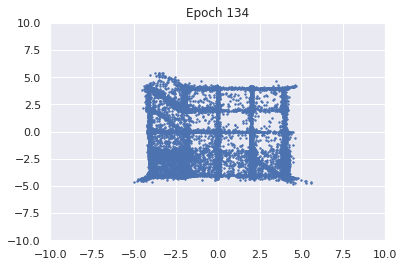

100%|██████████| 976/976 [00:17<00:00, 56.93it/s]


D loss : 1.3397, GP_loss : 0.0 G_loss : -0.7787, MI : 2.5345


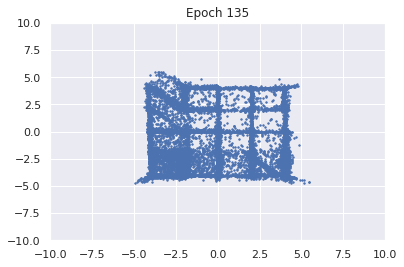

100%|██████████| 976/976 [00:17<00:00, 56.78it/s]


D loss : 1.3408, GP_loss : 0.0 G_loss : -0.7785, MI : 2.5396


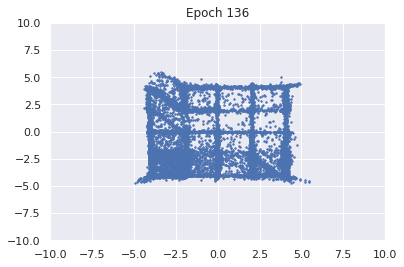

100%|██████████| 976/976 [00:17<00:00, 56.67it/s]


D loss : 1.3422, GP_loss : 0.0 G_loss : -0.7778, MI : 2.4989


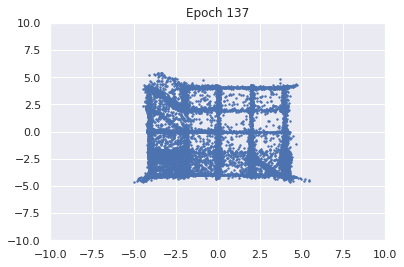

100%|██████████| 976/976 [00:17<00:00, 56.97it/s]


D loss : 1.3434, GP_loss : 0.0 G_loss : -0.7785, MI : 2.5296


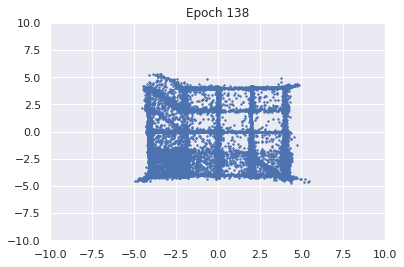

100%|██████████| 976/976 [00:16<00:00, 57.14it/s]


D loss : 1.3444, GP_loss : 0.0 G_loss : -0.7788, MI : 2.5395


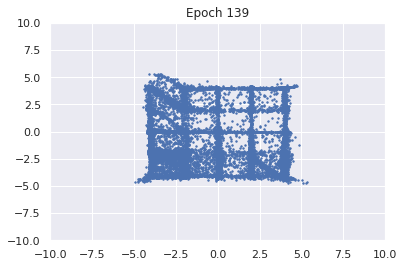

100%|██████████| 976/976 [00:17<00:00, 55.86it/s]


D loss : 1.3458, GP_loss : 0.0 G_loss : -0.7777, MI : 2.5289


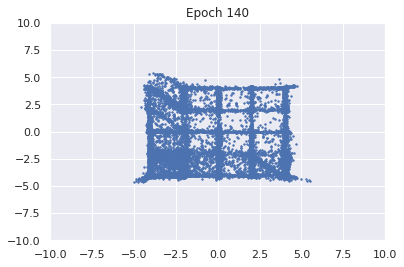

100%|██████████| 976/976 [00:14<00:00, 55.76it/s]


D loss : 1.3469, GP_loss : 0.0 G_loss : -0.778, MI : 2.5315


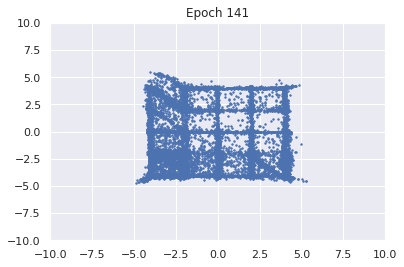

100%|██████████| 976/976 [00:17<00:00, 55.57it/s]


D loss : 1.3485, GP_loss : 0.0 G_loss : -0.7774, MI : 2.5062


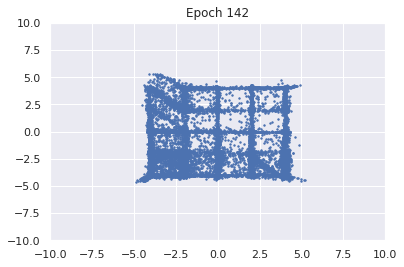

100%|██████████| 976/976 [00:17<00:00, 55.55it/s]


D loss : 1.3492, GP_loss : 0.0 G_loss : -0.7767, MI : 2.5293


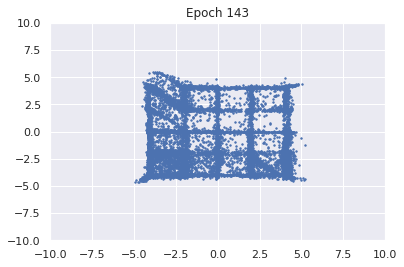

100%|██████████| 976/976 [00:17<00:00, 55.78it/s]


D loss : 1.3509, GP_loss : 0.0 G_loss : -0.7763, MI : 2.4544


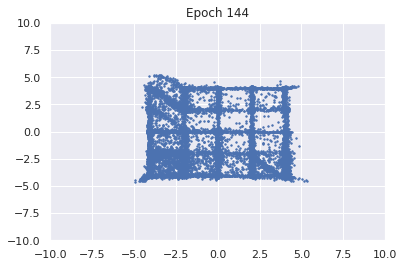

100%|██████████| 976/976 [00:17<00:00, 55.78it/s]


D loss : 1.3524, GP_loss : 0.0 G_loss : -0.7751, MI : 2.4971


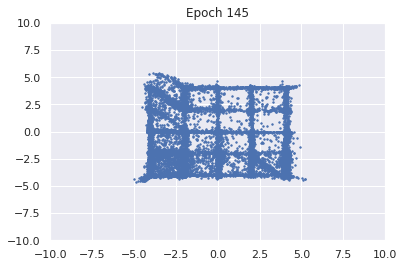

100%|██████████| 976/976 [00:17<00:00, 55.61it/s]


D loss : 1.3531, GP_loss : 0.0 G_loss : -0.7762, MI : 2.5389


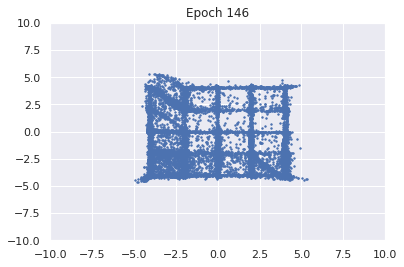

100%|██████████| 976/976 [00:17<00:00, 55.50it/s]


D loss : 1.3546, GP_loss : 0.0 G_loss : -0.7743, MI : 2.4734


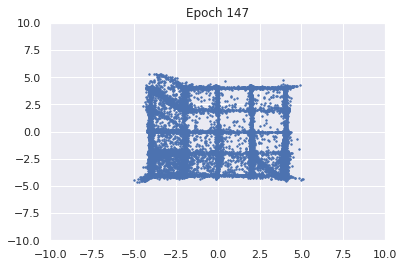

100%|██████████| 976/976 [00:17<00:00, 55.18it/s]


D loss : 1.3547, GP_loss : 0.0 G_loss : -0.7749, MI : 2.5076


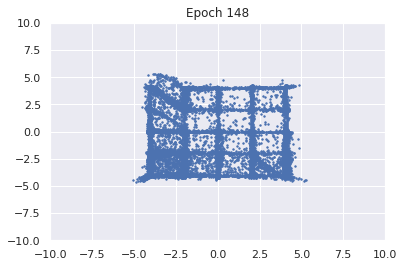

100%|██████████| 976/976 [00:17<00:00, 55.08it/s]


D loss : 1.3565, GP_loss : 0.0 G_loss : -0.7725, MI : 2.446


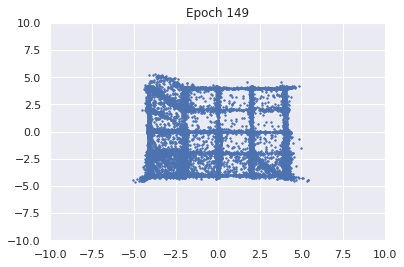

100%|██████████| 976/976 [00:17<00:00, 55.14it/s]


D loss : 1.3572, GP_loss : 0.0 G_loss : -0.7727, MI : 2.4755


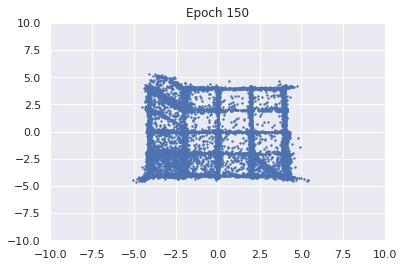

100%|██████████| 976/976 [00:17<00:00, 54.91it/s]


D loss : 1.3581, GP_loss : 0.0 G_loss : -0.7709, MI : 2.4391


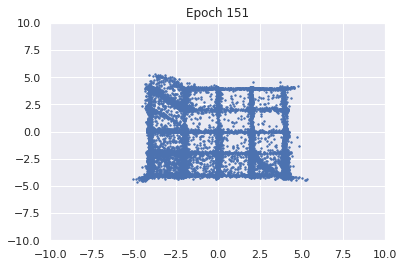

100%|██████████| 976/976 [00:17<00:00, 54.94it/s]


D loss : 1.3586, GP_loss : 0.0 G_loss : -0.7714, MI : 2.4375


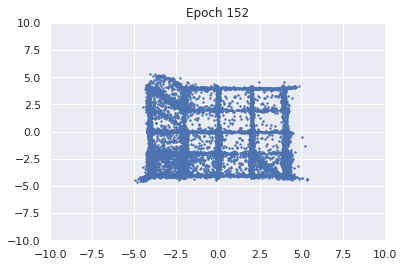

100%|██████████| 976/976 [00:17<00:00, 54.86it/s]


D loss : 1.359, GP_loss : 0.0 G_loss : -0.7713, MI : 2.4567


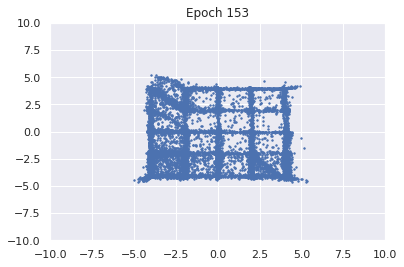

100%|██████████| 976/976 [00:17<00:00, 55.32it/s]


D loss : 1.3598, GP_loss : 0.0 G_loss : -0.7704, MI : 2.4477


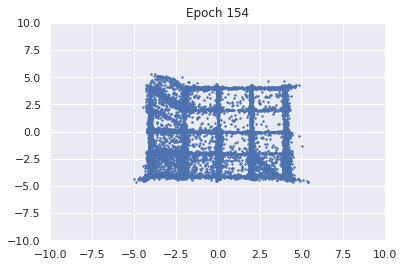

100%|██████████| 976/976 [00:17<00:00, 55.27it/s]


D loss : 1.3607, GP_loss : 0.0 G_loss : -0.7695, MI : 2.4299


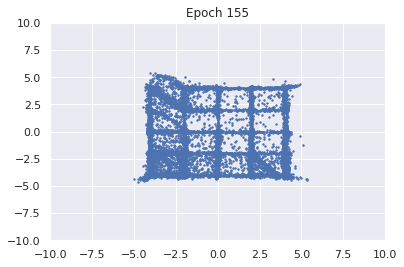

100%|██████████| 976/976 [00:17<00:00, 55.71it/s]


D loss : 1.3609, GP_loss : 0.0 G_loss : -0.7693, MI : 2.4334


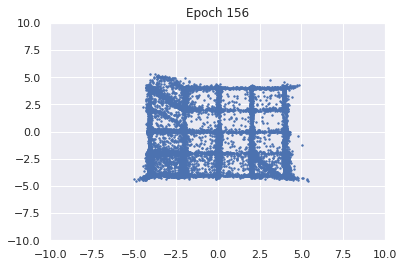

100%|██████████| 976/976 [00:17<00:00, 54.41it/s]


D loss : 1.3621, GP_loss : 0.0 G_loss : -0.768, MI : 2.4634


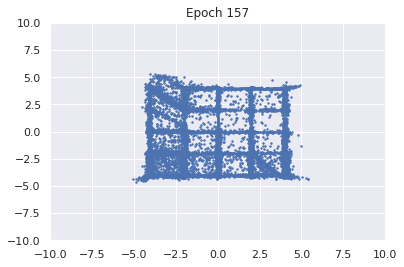

100%|██████████| 976/976 [00:17<00:00, 54.35it/s]


D loss : 1.3619, GP_loss : 0.0 G_loss : -0.7679, MI : 2.4325


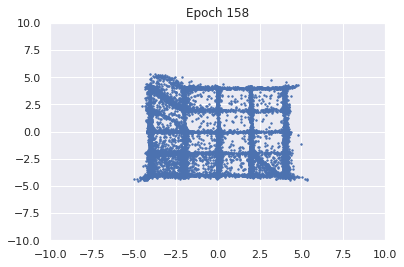

100%|██████████| 976/976 [00:17<00:00, 54.65it/s]


D loss : 1.3628, GP_loss : 0.0 G_loss : -0.7667, MI : 2.4194


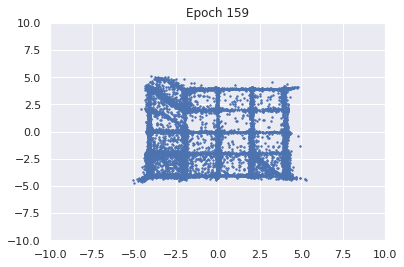

100%|██████████| 976/976 [00:17<00:00, 55.09it/s]


D loss : 1.3635, GP_loss : 0.0 G_loss : -0.764, MI : 2.4136


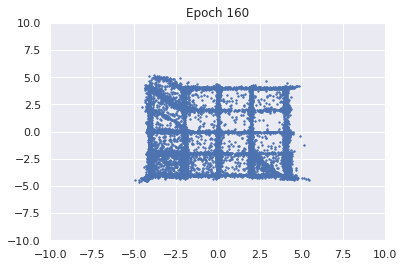

100%|██████████| 976/976 [00:17<00:00, 54.96it/s]


D loss : 1.364, GP_loss : 0.0 G_loss : -0.765, MI : 2.4362


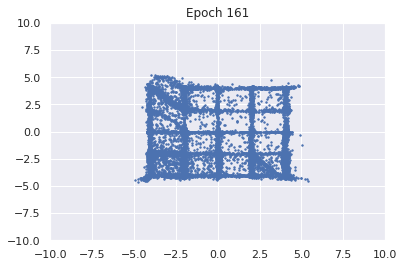

100%|██████████| 976/976 [00:17<00:00, 55.83it/s]


D loss : 1.3637, GP_loss : 0.0 G_loss : -0.7664, MI : 2.4236


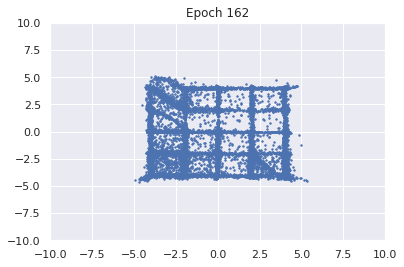

100%|██████████| 976/976 [00:10<00:00, 91.75it/s]


D loss : 1.3643, GP_loss : 0.0 G_loss : -0.7659, MI : 2.4385


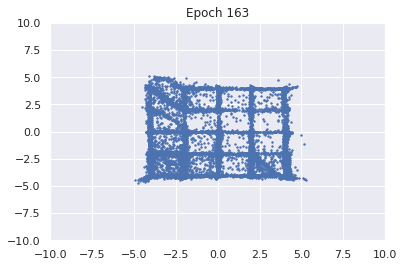

100%|██████████| 976/976 [00:10<00:00, 91.55it/s]


D loss : 1.3652, GP_loss : 0.0 G_loss : -0.7629, MI : 2.4478


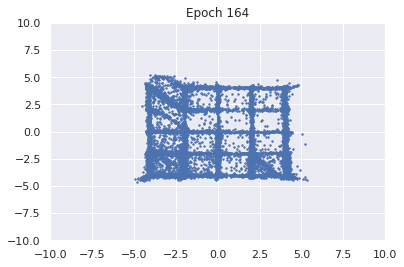

100%|██████████| 976/976 [00:10<00:00, 92.68it/s]


D loss : 1.3646, GP_loss : 0.0 G_loss : -0.7646, MI : 2.431


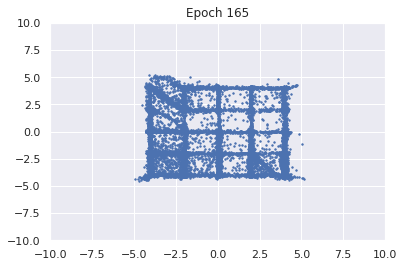

100%|██████████| 976/976 [00:10<00:00, 91.55it/s]


D loss : 1.366, GP_loss : 0.0 G_loss : -0.7628, MI : 2.4143


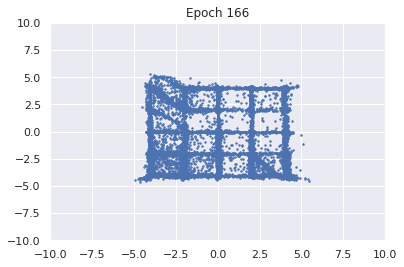

100%|██████████| 976/976 [00:10<00:00, 90.16it/s]


D loss : 1.3654, GP_loss : 0.0 G_loss : -0.7649, MI : 2.4347


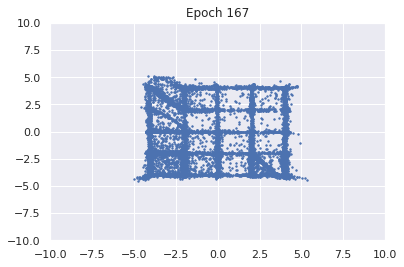

100%|██████████| 976/976 [00:11<00:00, 83.63it/s]


D loss : 1.3663, GP_loss : 0.0 G_loss : -0.7634, MI : 2.4316


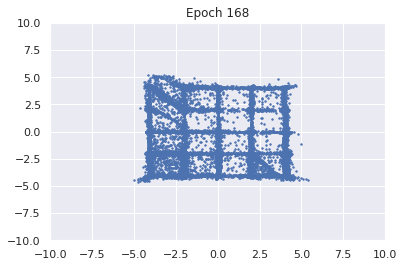

100%|██████████| 976/976 [00:17<00:00, 57.21it/s]


D loss : 1.3669, GP_loss : 0.0 G_loss : -0.7603, MI : 2.4518


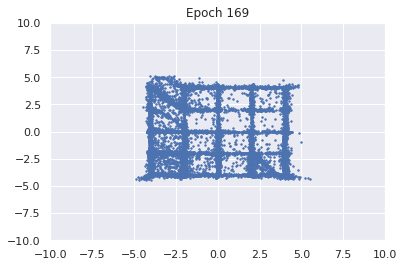

100%|██████████| 976/976 [00:17<00:00, 55.91it/s]


D loss : 1.3672, GP_loss : 0.0 G_loss : -0.7607, MI : 2.4461


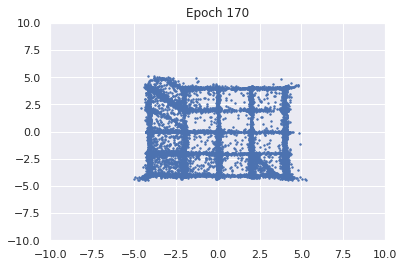

100%|██████████| 976/976 [00:17<00:00, 57.11it/s]


D loss : 1.3671, GP_loss : 0.0 G_loss : -0.7616, MI : 2.4019


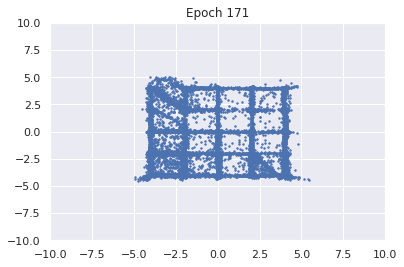

100%|██████████| 976/976 [00:17<00:00, 55.29it/s]


D loss : 1.3675, GP_loss : 0.0 G_loss : -0.7606, MI : 2.4299


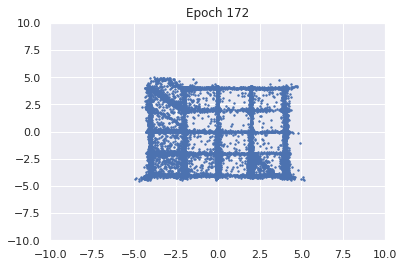

100%|██████████| 976/976 [00:17<00:00, 54.82it/s]


D loss : 1.3671, GP_loss : 0.0 G_loss : -0.7625, MI : 2.4271


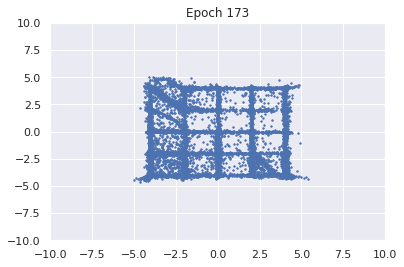

100%|██████████| 976/976 [00:17<00:00, 55.00it/s]


D loss : 1.3676, GP_loss : 0.0 G_loss : -0.762, MI : 2.4172


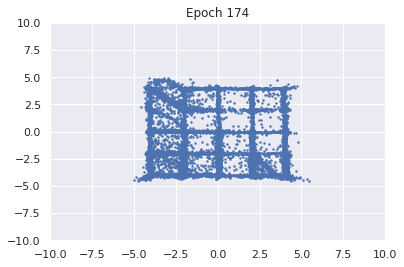

100%|██████████| 976/976 [00:17<00:00, 55.00it/s]


D loss : 1.3677, GP_loss : 0.0 G_loss : -0.7619, MI : 2.4511


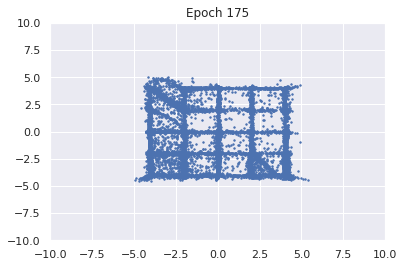

100%|██████████| 976/976 [00:17<00:00, 55.74it/s]


D loss : 1.3683, GP_loss : 0.0 G_loss : -0.7596, MI : 2.4248


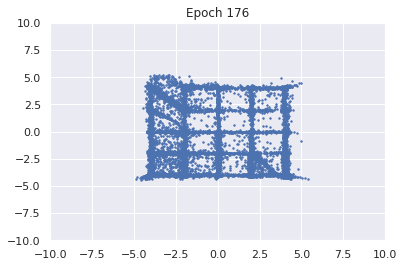

100%|██████████| 976/976 [00:17<00:00, 55.41it/s]


D loss : 1.3685, GP_loss : 0.0 G_loss : -0.7593, MI : 2.4301


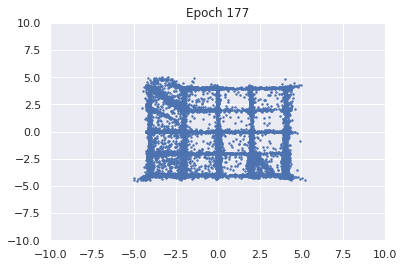

100%|██████████| 976/976 [00:17<00:00, 55.68it/s]


D loss : 1.3692, GP_loss : 0.0 G_loss : -0.7571, MI : 2.4414


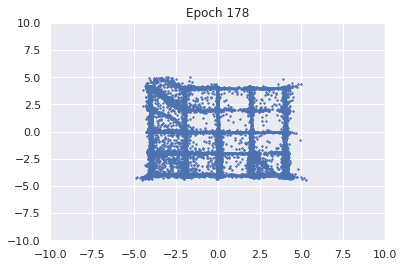

100%|██████████| 976/976 [00:17<00:00, 55.45it/s]


D loss : 1.3695, GP_loss : 0.0 G_loss : -0.7584, MI : 2.4493


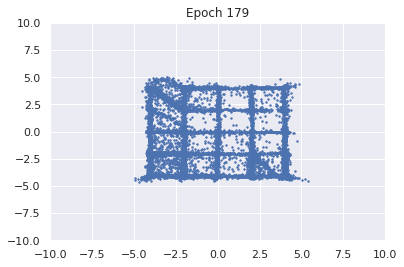

100%|██████████| 976/976 [00:17<00:00, 56.10it/s]


D loss : 1.3693, GP_loss : 0.0 G_loss : -0.7577, MI : 2.4466


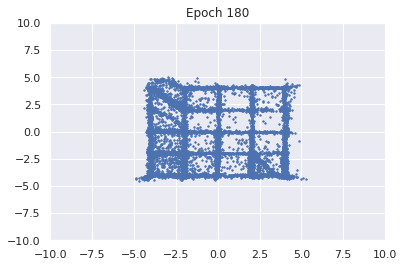

100%|██████████| 976/976 [00:17<00:00, 55.79it/s]


D loss : 1.3691, GP_loss : 0.0 G_loss : -0.7597, MI : 2.4467


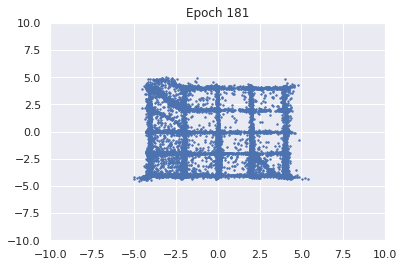

100%|██████████| 976/976 [00:17<00:00, 56.03it/s]


D loss : 1.3696, GP_loss : 0.0 G_loss : -0.7584, MI : 2.4546


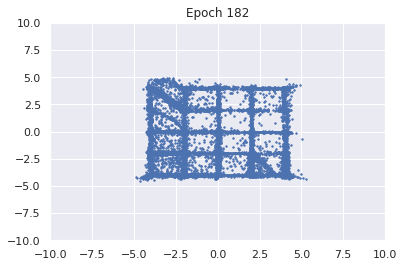

100%|██████████| 976/976 [00:17<00:00, 56.25it/s]


D loss : 1.3699, GP_loss : 0.0 G_loss : -0.757, MI : 2.4437


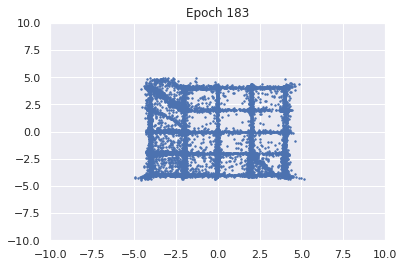

100%|██████████| 976/976 [00:16<00:00, 60.16it/s]


D loss : 1.37, GP_loss : 0.0 G_loss : -0.7576, MI : 2.4453


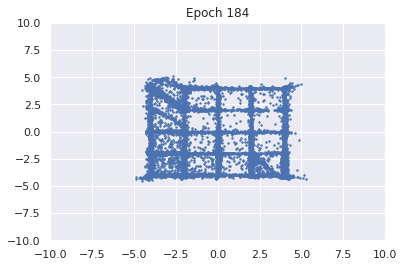

100%|██████████| 976/976 [00:17<00:00, 56.17it/s]


D loss : 1.3704, GP_loss : 0.0 G_loss : -0.7565, MI : 2.4413


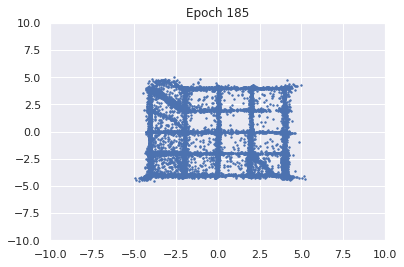

100%|██████████| 976/976 [00:17<00:00, 56.46it/s]


D loss : 1.37, GP_loss : 0.0 G_loss : -0.7582, MI : 2.4504


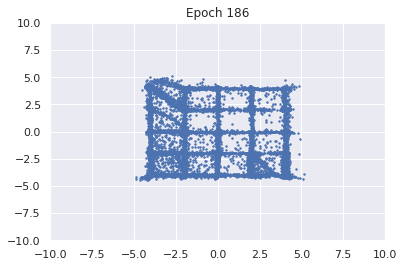

100%|██████████| 976/976 [00:17<00:00, 56.21it/s]


D loss : 1.3704, GP_loss : 0.0 G_loss : -0.7588, MI : 2.4583


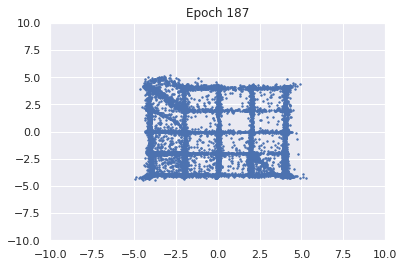

100%|██████████| 976/976 [00:17<00:00, 56.02it/s]


D loss : 1.3711, GP_loss : 0.0 G_loss : -0.7552, MI : 2.4654


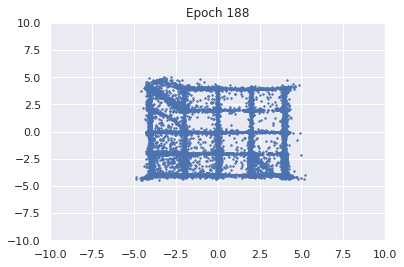

100%|██████████| 976/976 [00:17<00:00, 56.38it/s]


D loss : 1.3711, GP_loss : 0.0 G_loss : -0.7548, MI : 2.4453


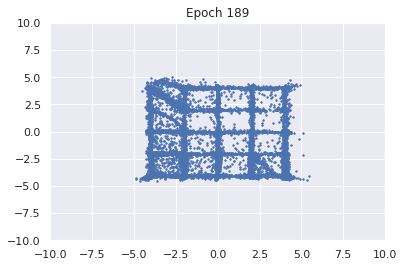

100%|██████████| 976/976 [00:17<00:00, 56.09it/s]


D loss : 1.3711, GP_loss : 0.0 G_loss : -0.7562, MI : 2.463


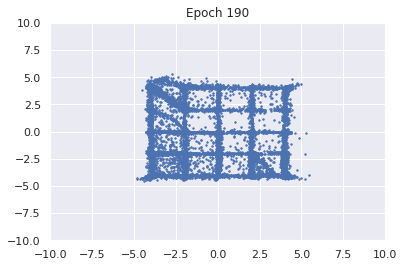

100%|██████████| 976/976 [00:17<00:00, 56.57it/s]


D loss : 1.3709, GP_loss : 0.0 G_loss : -0.7569, MI : 2.4573


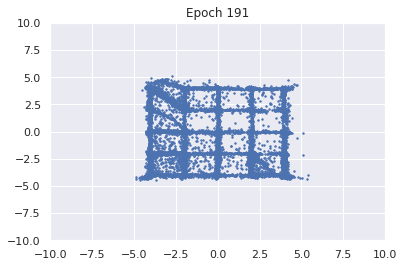

100%|██████████| 976/976 [00:17<00:00, 56.00it/s]


D loss : 1.3713, GP_loss : 0.0 G_loss : -0.7561, MI : 2.4744


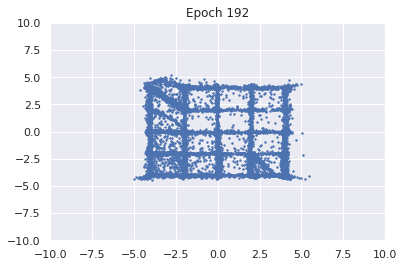

100%|██████████| 976/976 [00:17<00:00, 56.09it/s]


D loss : 1.3717, GP_loss : 0.0 G_loss : -0.7543, MI : 2.4523


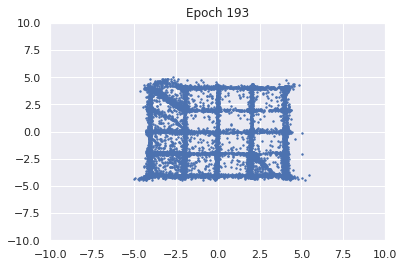

100%|██████████| 976/976 [00:17<00:00, 56.32it/s]


D loss : 1.372, GP_loss : 0.0 G_loss : -0.7543, MI : 2.4749


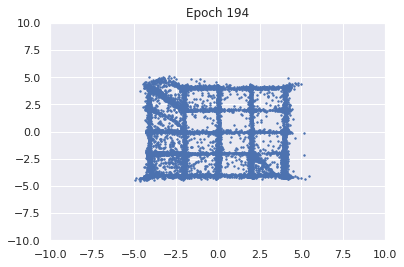

100%|██████████| 976/976 [00:17<00:00, 55.63it/s]


D loss : 1.372, GP_loss : 0.0 G_loss : -0.7543, MI : 2.4583


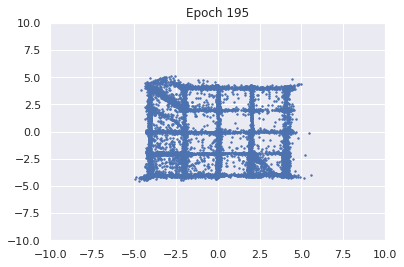

100%|██████████| 976/976 [00:17<00:00, 56.04it/s]


D loss : 1.3724, GP_loss : 0.0 G_loss : -0.7531, MI : 2.4948


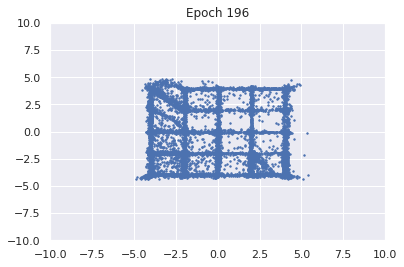

100%|██████████| 976/976 [00:17<00:00, 55.48it/s]


D loss : 1.3715, GP_loss : 0.0 G_loss : -0.7558, MI : 2.4675


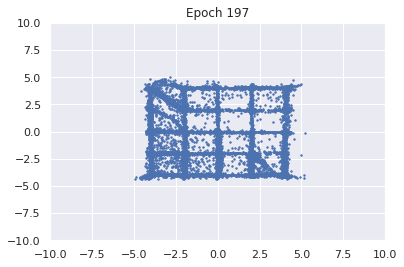

100%|██████████| 976/976 [00:17<00:00, 55.40it/s]


D loss : 1.3722, GP_loss : 0.0 G_loss : -0.7541, MI : 2.4622


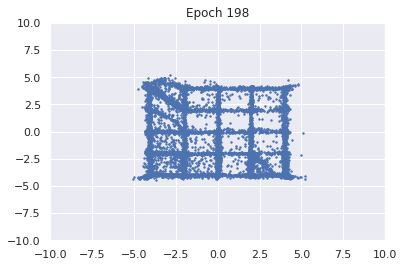

100%|██████████| 976/976 [00:17<00:00, 55.82it/s]


D loss : 1.3727, GP_loss : 0.0 G_loss : -0.7541, MI : 2.4849


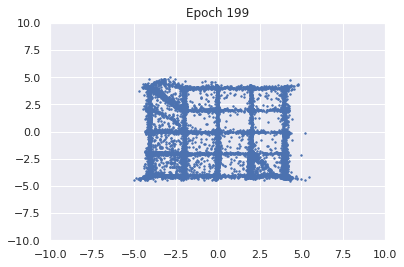

100%|██████████| 976/976 [00:17<00:00, 55.81it/s]


D loss : 1.3725, GP_loss : 0.0 G_loss : -0.7531, MI : 2.4971


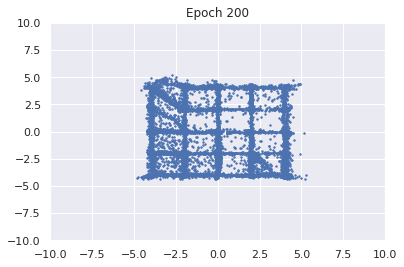

100%|██████████| 976/976 [00:16<00:00, 58.75it/s]


D loss : 1.3725, GP_loss : 0.0 G_loss : -0.7542, MI : 2.4668


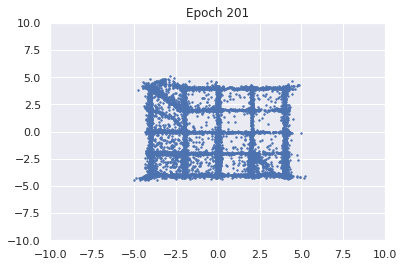

100%|██████████| 976/976 [00:17<00:00, 56.35it/s]


D loss : 1.3727, GP_loss : 0.0 G_loss : -0.7533, MI : 2.5089


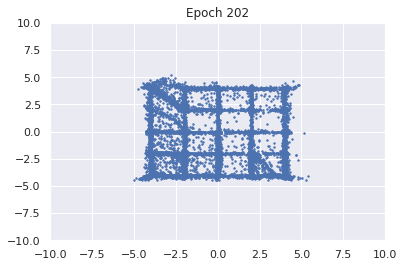

100%|██████████| 976/976 [00:17<00:00, 55.55it/s]


D loss : 1.3731, GP_loss : 0.0 G_loss : -0.7525, MI : 2.4861


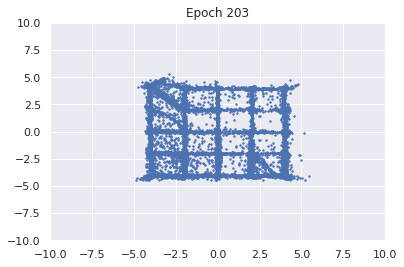

100%|██████████| 976/976 [00:17<00:00, 56.10it/s]


D loss : 1.3726, GP_loss : 0.0 G_loss : -0.7532, MI : 2.4939


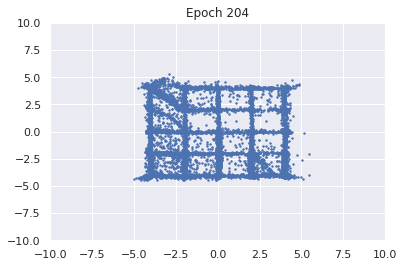

100%|██████████| 976/976 [00:17<00:00, 55.93it/s]


D loss : 1.3732, GP_loss : 0.0 G_loss : -0.7519, MI : 2.5102


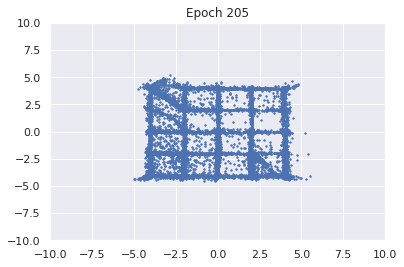

100%|██████████| 976/976 [00:14<00:00, 68.96it/s]


D loss : 1.3736, GP_loss : 0.0 G_loss : -0.7501, MI : 2.477


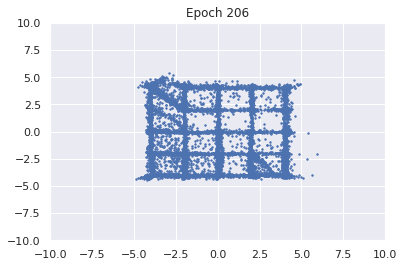

100%|██████████| 976/976 [00:16<00:00, 57.97it/s]


D loss : 1.3733, GP_loss : 0.0 G_loss : -0.7522, MI : 2.494


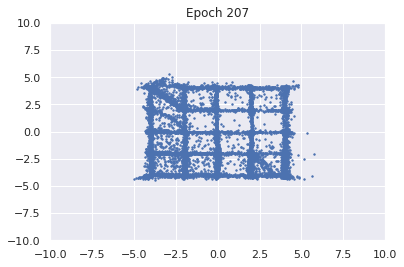

100%|██████████| 976/976 [00:17<00:00, 55.19it/s]


D loss : 1.3732, GP_loss : 0.0 G_loss : -0.7528, MI : 2.4871


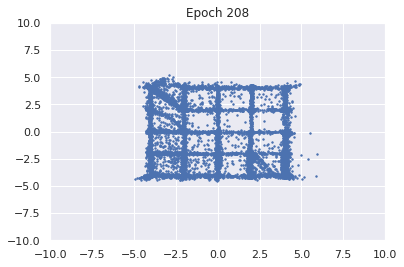

100%|██████████| 976/976 [00:17<00:00, 56.20it/s]


D loss : 1.3733, GP_loss : 0.0 G_loss : -0.753, MI : 2.5148


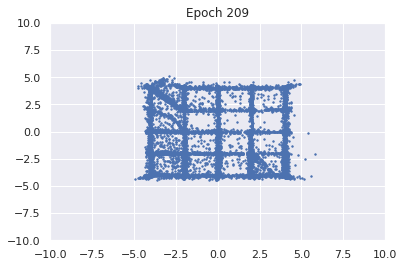

100%|██████████| 976/976 [00:17<00:00, 55.66it/s]


D loss : 1.3735, GP_loss : 0.0 G_loss : -0.7517, MI : 2.511


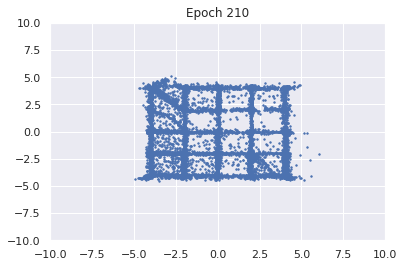

100%|██████████| 976/976 [00:17<00:00, 55.53it/s]


D loss : 1.3737, GP_loss : 0.0 G_loss : -0.7507, MI : 2.5238


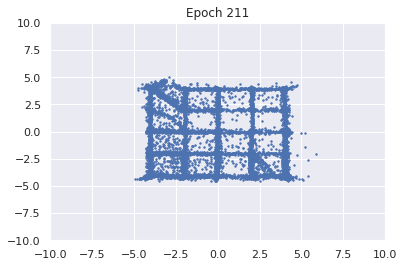

100%|██████████| 976/976 [00:13<00:00, 55.84it/s]


D loss : 1.3741, GP_loss : 0.0 G_loss : -0.7499, MI : 2.5176


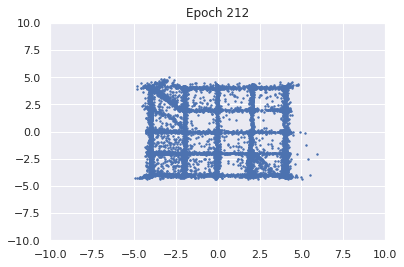

100%|██████████| 976/976 [00:17<00:00, 56.25it/s]


D loss : 1.3731, GP_loss : 0.0 G_loss : -0.7534, MI : 2.5192


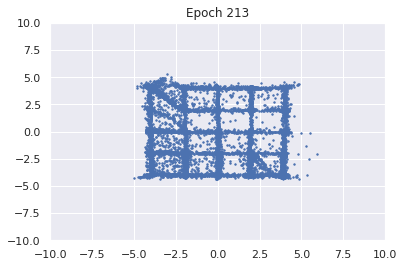

100%|██████████| 976/976 [00:17<00:00, 57.28it/s]


D loss : 1.3741, GP_loss : 0.0 G_loss : -0.7498, MI : 2.5259


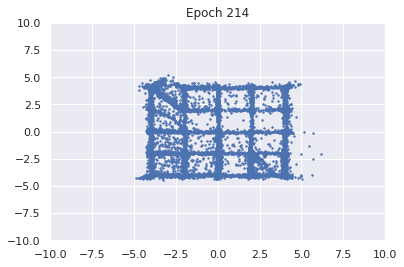

100%|██████████| 976/976 [00:17<00:00, 56.65it/s]


D loss : 1.374, GP_loss : 0.0 G_loss : -0.7505, MI : 2.5229


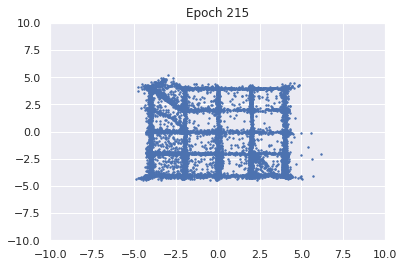

100%|██████████| 976/976 [00:17<00:00, 60.12it/s]


D loss : 1.3745, GP_loss : 0.0 G_loss : -0.7492, MI : 2.5281


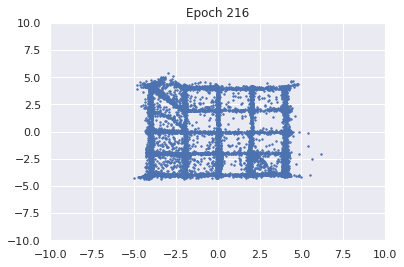

100%|██████████| 976/976 [00:17<00:00, 57.33it/s]


D loss : 1.3742, GP_loss : 0.0 G_loss : -0.7488, MI : 2.5237


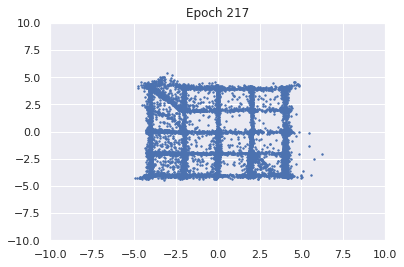

100%|██████████| 976/976 [00:17<00:00, 55.33it/s]


D loss : 1.3742, GP_loss : 0.0 G_loss : -0.7499, MI : 2.5489


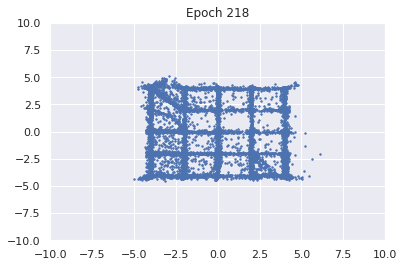

100%|██████████| 976/976 [00:17<00:00, 54.94it/s]


D loss : 1.3742, GP_loss : 0.0 G_loss : -0.7509, MI : 2.5301


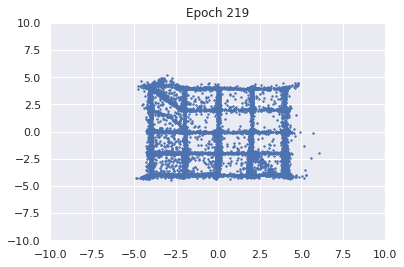

100%|██████████| 976/976 [00:17<00:00, 55.52it/s]


D loss : 1.3741, GP_loss : 0.0 G_loss : -0.7515, MI : 2.5421


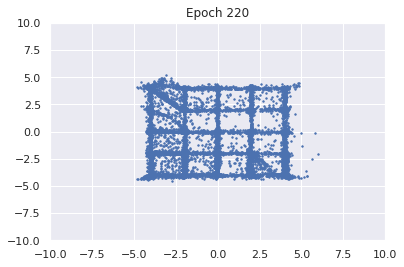

100%|██████████| 976/976 [00:17<00:00, 55.55it/s]


D loss : 1.3744, GP_loss : 0.0 G_loss : -0.7496, MI : 2.5041


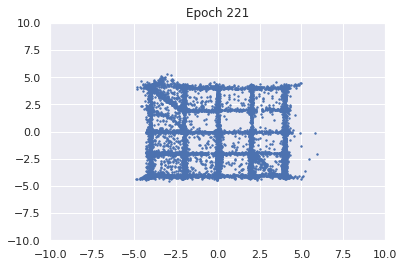

100%|██████████| 976/976 [00:17<00:00, 54.98it/s]


D loss : 1.3743, GP_loss : 0.0 G_loss : -0.7503, MI : 2.5683


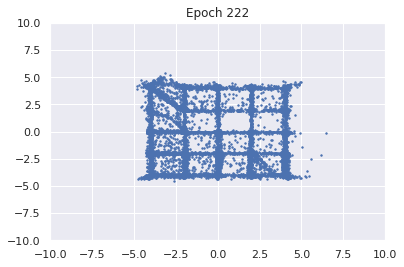

100%|██████████| 976/976 [00:17<00:00, 55.32it/s]


D loss : 1.3745, GP_loss : 0.0 G_loss : -0.7489, MI : 2.5343


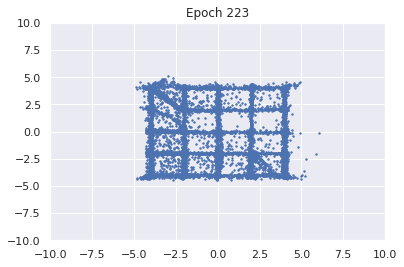

100%|██████████| 976/976 [00:17<00:00, 55.94it/s]


D loss : 1.3743, GP_loss : 0.0 G_loss : -0.7509, MI : 2.5524


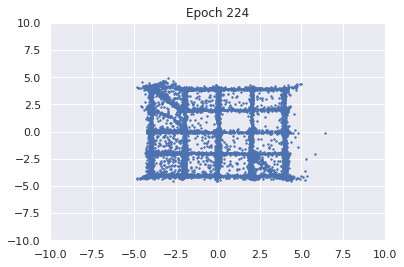

100%|██████████| 976/976 [00:17<00:00, 56.06it/s]


D loss : 1.3746, GP_loss : 0.0 G_loss : -0.7508, MI : 2.5611


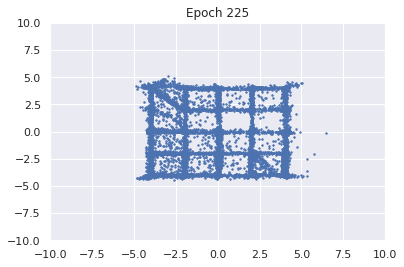

100%|██████████| 976/976 [00:17<00:00, 55.18it/s]


D loss : 1.3747, GP_loss : 0.0 G_loss : -0.7492, MI : 2.5573


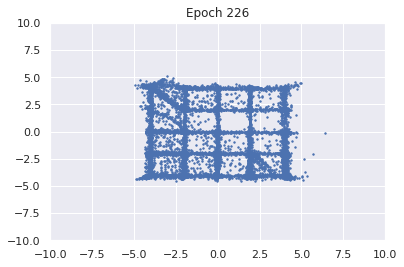

100%|██████████| 976/976 [00:17<00:00, 55.62it/s]


D loss : 1.375, GP_loss : 0.0 G_loss : -0.748, MI : 2.5545


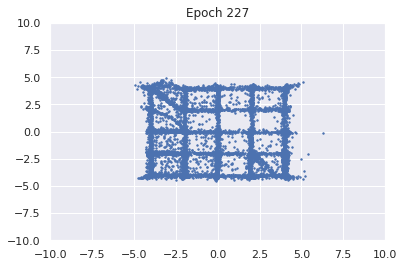

100%|██████████| 976/976 [00:17<00:00, 55.83it/s]


D loss : 1.375, GP_loss : 0.0 G_loss : -0.7486, MI : 2.5708


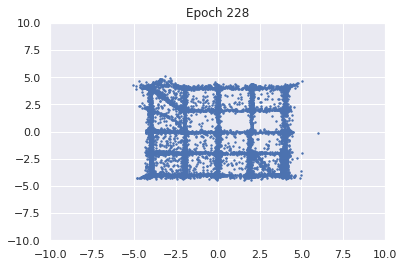

100%|██████████| 976/976 [00:17<00:00, 55.25it/s]


D loss : 1.3752, GP_loss : 0.0 G_loss : -0.7467, MI : 2.5471


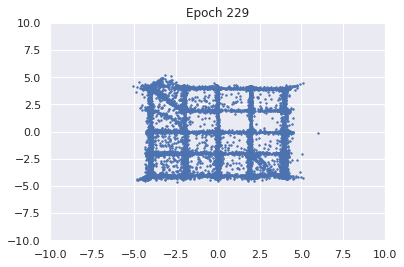

100%|██████████| 976/976 [00:17<00:00, 55.19it/s]


D loss : 1.375, GP_loss : 0.0 G_loss : -0.7483, MI : 2.571


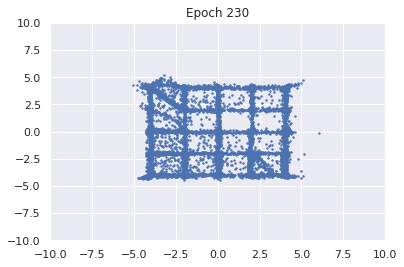

100%|██████████| 976/976 [00:17<00:00, 56.96it/s]


D loss : 1.3751, GP_loss : 0.0 G_loss : -0.7483, MI : 2.5783


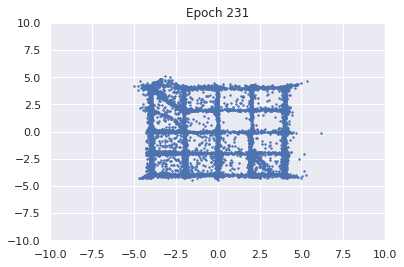

100%|██████████| 976/976 [00:17<00:00, 55.27it/s]


D loss : 1.3753, GP_loss : 0.0 G_loss : -0.7478, MI : 2.5665


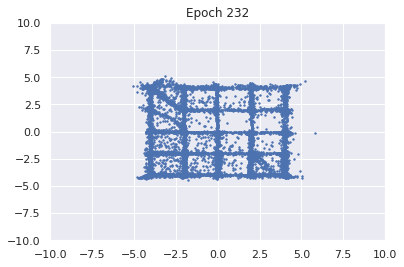

100%|██████████| 976/976 [00:17<00:00, 54.66it/s]


D loss : 1.3755, GP_loss : 0.0 G_loss : -0.7468, MI : 2.5877


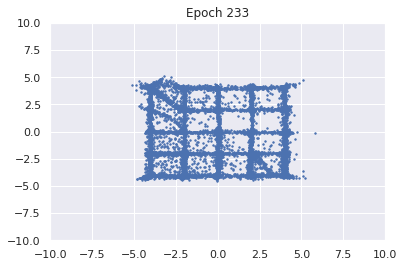

100%|██████████| 976/976 [00:17<00:00, 54.91it/s]


D loss : 1.3753, GP_loss : 0.0 G_loss : -0.7486, MI : 2.5661


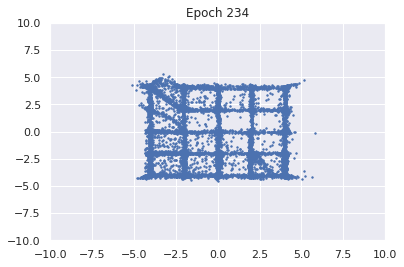

100%|██████████| 976/976 [00:17<00:00, 55.21it/s]


D loss : 1.3756, GP_loss : 0.0 G_loss : -0.7462, MI : 2.5734


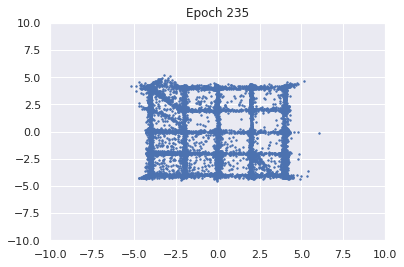

100%|██████████| 976/976 [00:17<00:00, 55.11it/s]


D loss : 1.3753, GP_loss : 0.0 G_loss : -0.747, MI : 2.4004


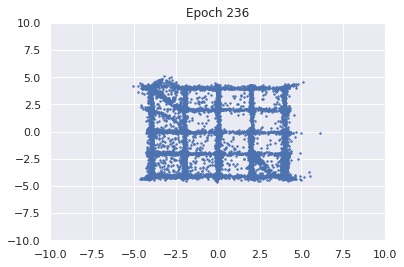

100%|██████████| 976/976 [00:17<00:00, 55.15it/s]


D loss : 1.3754, GP_loss : 0.0 G_loss : -0.7484, MI : 2.5955


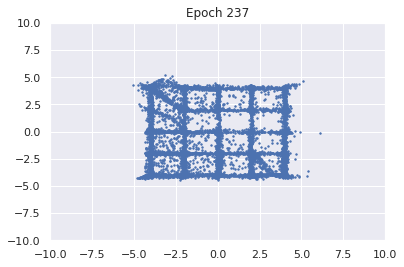

100%|██████████| 976/976 [00:17<00:00, 56.16it/s]


D loss : 1.3752, GP_loss : 0.0 G_loss : -0.7486, MI : 2.5169


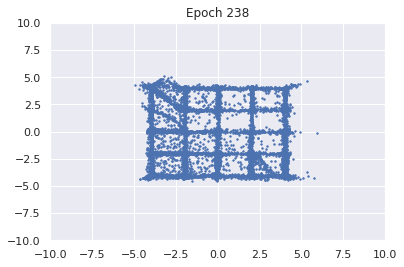

100%|██████████| 976/976 [00:17<00:00, 54.92it/s]


D loss : 1.3759, GP_loss : 0.0 G_loss : -0.7443, MI : 2.5804


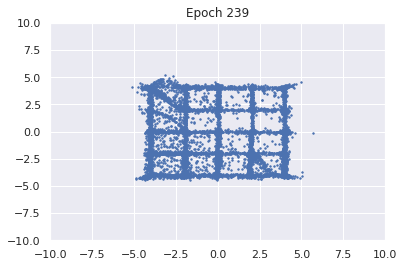

100%|██████████| 976/976 [00:17<00:00, 55.22it/s]


D loss : 1.3756, GP_loss : 0.0 G_loss : -0.7476, MI : 2.5808


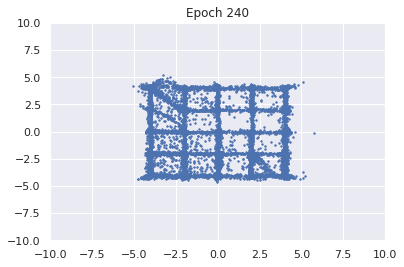

100%|██████████| 976/976 [00:17<00:00, 55.22it/s]


D loss : 1.3758, GP_loss : 0.0 G_loss : -0.747, MI : 2.6054


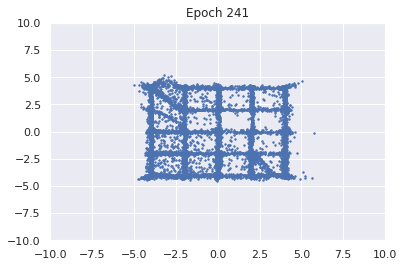

100%|██████████| 976/976 [00:17<00:00, 55.50it/s]


D loss : 1.3761, GP_loss : 0.0 G_loss : -0.7463, MI : 2.5873


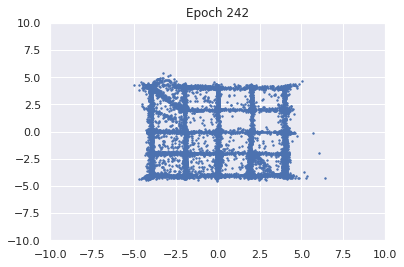

100%|██████████| 976/976 [00:17<00:00, 54.91it/s]


D loss : 1.376, GP_loss : 0.0 G_loss : -0.7463, MI : 2.608


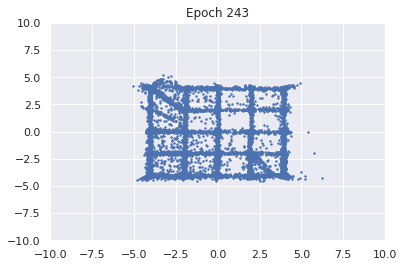

100%|██████████| 976/976 [00:17<00:00, 55.81it/s]


D loss : 1.376, GP_loss : 0.0 G_loss : -0.7465, MI : 2.5917


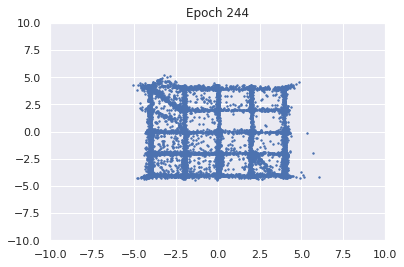

100%|██████████| 976/976 [00:17<00:00, 55.21it/s]


D loss : 1.3759, GP_loss : 0.0 G_loss : -0.7472, MI : 2.6129


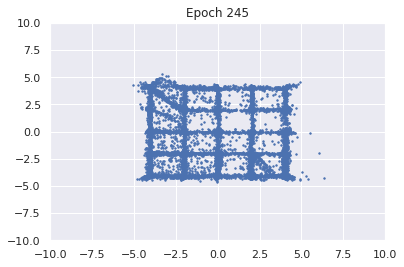

100%|██████████| 976/976 [00:16<00:00, 57.52it/s]


D loss : 1.3757, GP_loss : 0.0 G_loss : -0.7468, MI : 2.6184


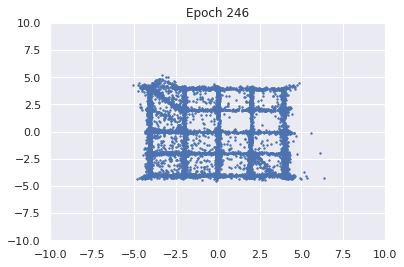

100%|██████████| 976/976 [00:17<00:00, 55.26it/s]


D loss : 1.3756, GP_loss : 0.0 G_loss : -0.748, MI : 2.5794


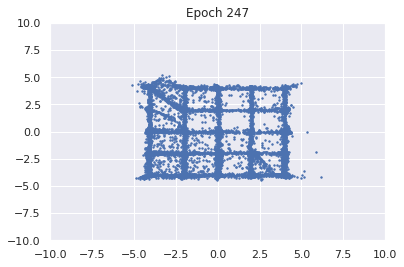

100%|██████████| 976/976 [00:17<00:00, 55.08it/s]


D loss : 1.3755, GP_loss : 0.0 G_loss : -0.7485, MI : 2.6124


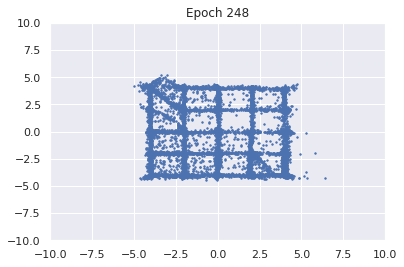

100%|██████████| 976/976 [00:17<00:00, 54.80it/s]


D loss : 1.3759, GP_loss : 0.0 G_loss : -0.7483, MI : 2.6113


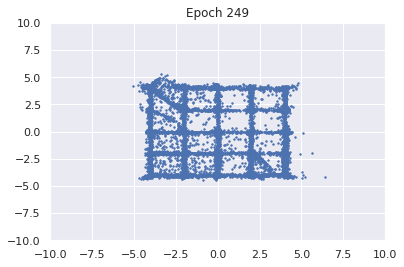

100%|██████████| 976/976 [00:17<00:00, 54.62it/s]


D loss : 1.3762, GP_loss : 0.0 G_loss : -0.7452, MI : 2.6256


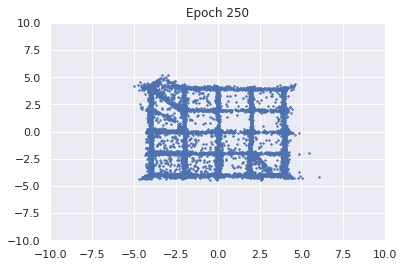

100%|██████████| 976/976 [00:17<00:00, 57.07it/s]


D loss : 1.3759, GP_loss : 0.0 G_loss : -0.7472, MI : 2.6062


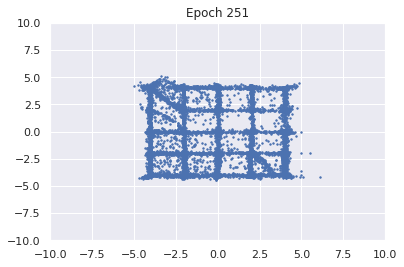

100%|██████████| 976/976 [00:17<00:00, 55.31it/s]


D loss : 1.3766, GP_loss : 0.0 G_loss : -0.7423, MI : 2.6423


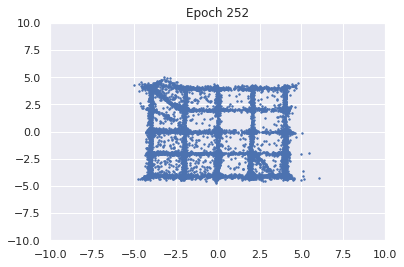

100%|██████████| 976/976 [00:17<00:00, 55.00it/s]


D loss : 1.3767, GP_loss : 0.0 G_loss : -0.7437, MI : 2.6063


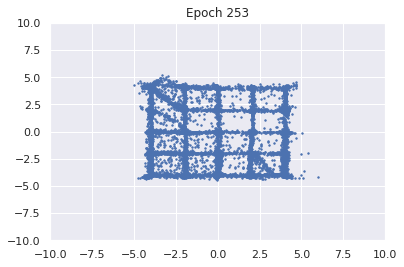

100%|██████████| 976/976 [00:17<00:00, 55.60it/s]


D loss : 1.3763, GP_loss : 0.0 G_loss : -0.7459, MI : 2.6484


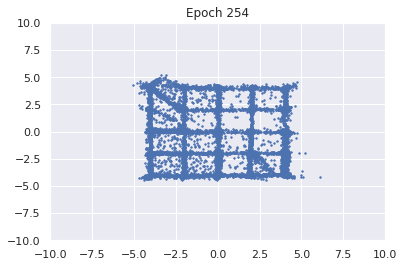

100%|██████████| 976/976 [00:17<00:00, 54.77it/s]


D loss : 1.3766, GP_loss : 0.0 G_loss : -0.7445, MI : 2.6358


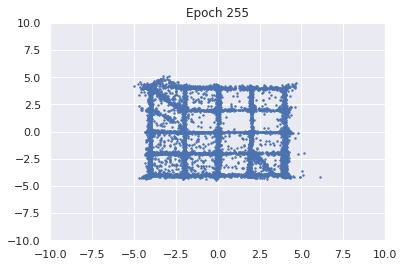

100%|██████████| 976/976 [00:17<00:00, 55.13it/s]


D loss : 1.3764, GP_loss : 0.0 G_loss : -0.7445, MI : 2.6309


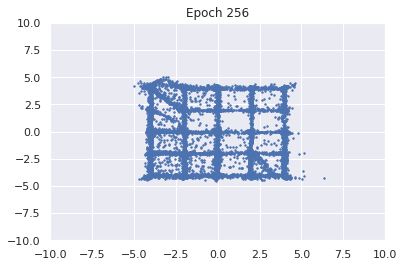

100%|██████████| 976/976 [00:17<00:00, 55.02it/s]


D loss : 1.3764, GP_loss : 0.0 G_loss : -0.7446, MI : 2.6058


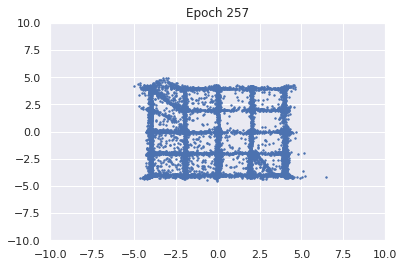

100%|██████████| 976/976 [00:17<00:00, 55.21it/s]


D loss : 1.3765, GP_loss : 0.0 G_loss : -0.7444, MI : 2.67


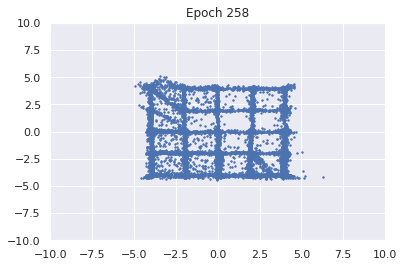

100%|██████████| 976/976 [00:17<00:00, 54.96it/s]


D loss : 1.3765, GP_loss : 0.0 G_loss : -0.7449, MI : 2.6432


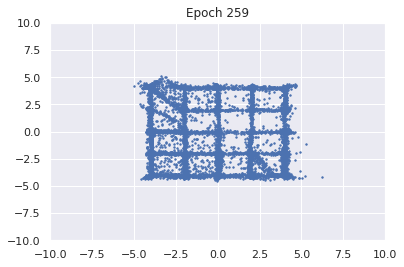

100%|██████████| 976/976 [00:17<00:00, 54.92it/s]


D loss : 1.3763, GP_loss : 0.0 G_loss : -0.747, MI : 2.6317


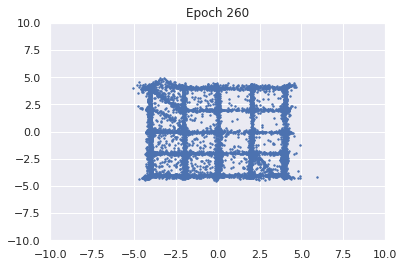

100%|██████████| 976/976 [00:17<00:00, 55.57it/s]


D loss : 1.3768, GP_loss : 0.0 G_loss : -0.743, MI : 2.6698


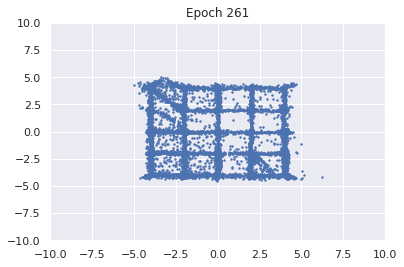

100%|██████████| 976/976 [00:17<00:00, 55.13it/s]


D loss : 1.3763, GP_loss : 0.0 G_loss : -0.7463, MI : 2.646


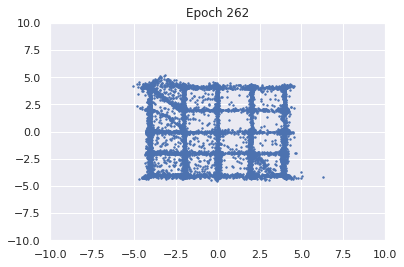

100%|██████████| 976/976 [00:17<00:00, 54.87it/s]


D loss : 1.3766, GP_loss : 0.0 G_loss : -0.7455, MI : 2.6686


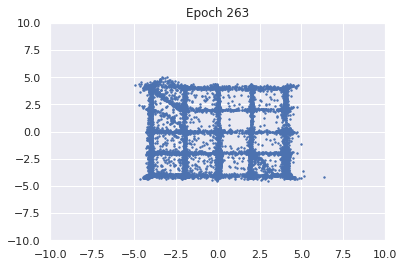

100%|██████████| 976/976 [00:17<00:00, 55.10it/s]


D loss : 1.3766, GP_loss : 0.0 G_loss : -0.7456, MI : 2.6646


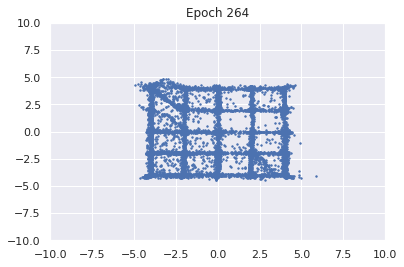

100%|██████████| 976/976 [00:17<00:00, 55.11it/s]


D loss : 1.3768, GP_loss : 0.0 G_loss : -0.7439, MI : 2.6684


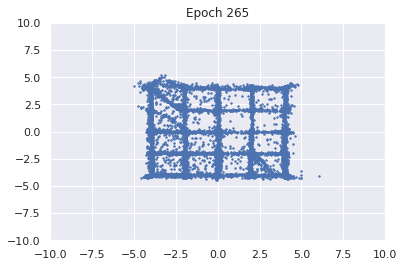

100%|██████████| 976/976 [00:17<00:00, 54.75it/s]


D loss : 1.3763, GP_loss : 0.0 G_loss : -0.7458, MI : 2.6464


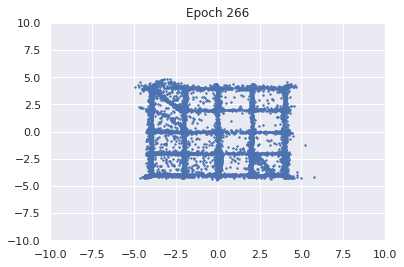

100%|██████████| 976/976 [00:17<00:00, 55.28it/s]


D loss : 1.3767, GP_loss : 0.0 G_loss : -0.7446, MI : 2.673


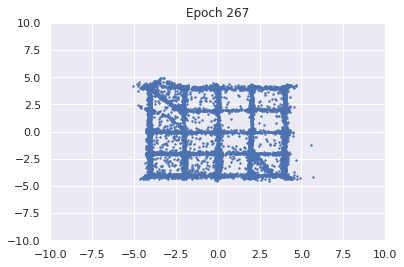

100%|██████████| 976/976 [00:17<00:00, 54.93it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7434, MI : 2.678


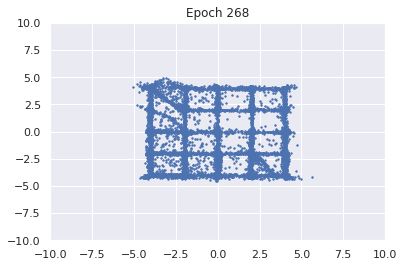

100%|██████████| 976/976 [00:17<00:00, 55.11it/s]


D loss : 1.3767, GP_loss : 0.0 G_loss : -0.7444, MI : 2.6789


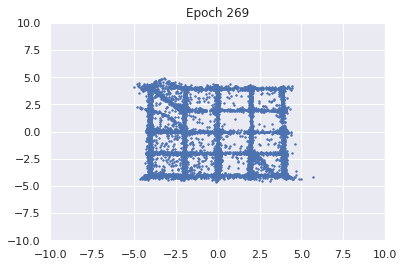

100%|██████████| 976/976 [00:17<00:00, 55.23it/s]


D loss : 1.3767, GP_loss : 0.0 G_loss : -0.745, MI : 2.6613


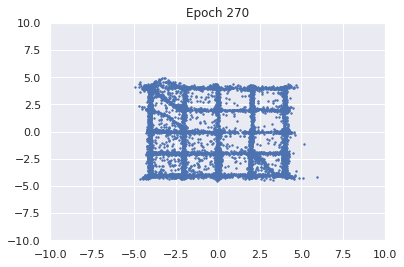

100%|██████████| 976/976 [00:17<00:00, 54.84it/s]


D loss : 1.3766, GP_loss : 0.0 G_loss : -0.7445, MI : 2.6626


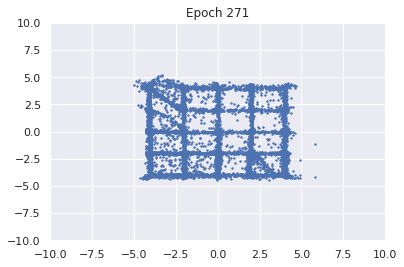

100%|██████████| 976/976 [00:17<00:00, 54.99it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7427, MI : 2.6686


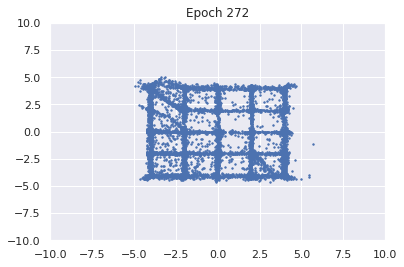

100%|██████████| 976/976 [00:17<00:00, 55.25it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7437, MI : 2.6827


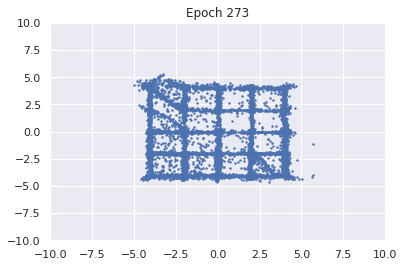

100%|██████████| 976/976 [00:17<00:00, 55.18it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7436, MI : 2.6723


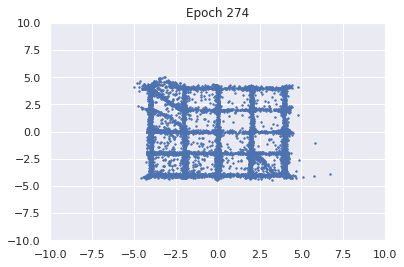

100%|██████████| 976/976 [00:17<00:00, 55.36it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7434, MI : 2.6986


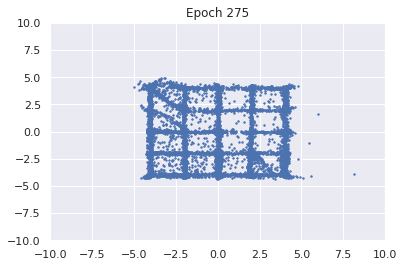

100%|██████████| 976/976 [00:16<00:00, 60.35it/s]


D loss : 1.3767, GP_loss : 0.0 G_loss : -0.7456, MI : 2.6841


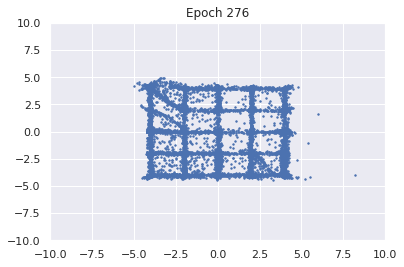

100%|██████████| 976/976 [00:17<00:00, 54.54it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7435, MI : 2.6819


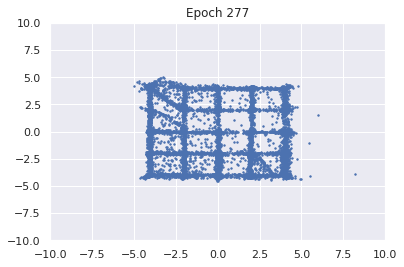

100%|██████████| 976/976 [00:17<00:00, 54.76it/s]


D loss : 1.3769, GP_loss : 0.0 G_loss : -0.7448, MI : 2.6875


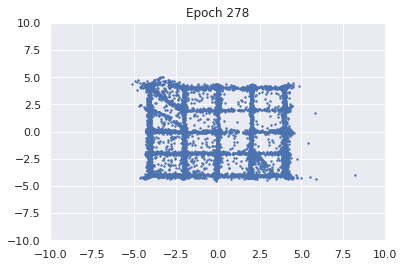

100%|██████████| 976/976 [00:17<00:00, 55.06it/s]


D loss : 1.3768, GP_loss : 0.0 G_loss : -0.744, MI : 2.6644


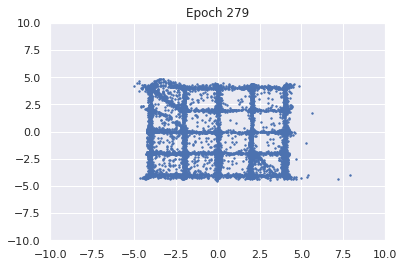

100%|██████████| 976/976 [00:17<00:00, 55.31it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7441, MI : 2.7029


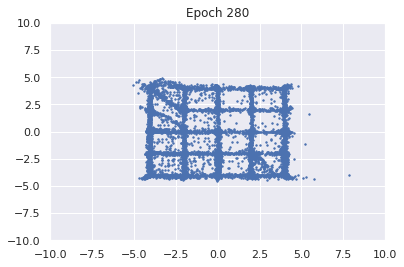

100%|██████████| 976/976 [00:17<00:00, 55.17it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.744, MI : 2.6912


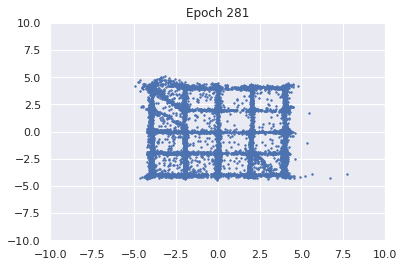

100%|██████████| 976/976 [00:17<00:00, 55.87it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7427, MI : 2.7181


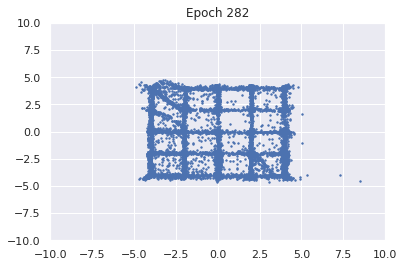

100%|██████████| 976/976 [00:17<00:00, 56.66it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7431, MI : 2.7046


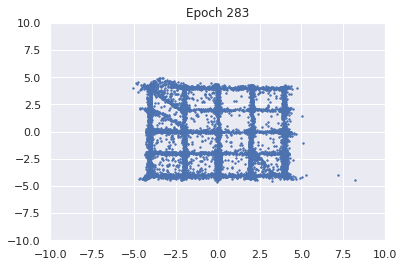

100%|██████████| 976/976 [00:13<00:00, 71.90it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7441, MI : 2.721


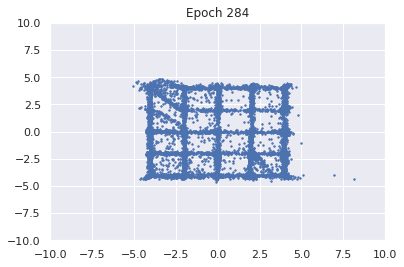

100%|██████████| 976/976 [00:14<00:00, 66.31it/s]


D loss : 1.3772, GP_loss : 0.0 G_loss : -0.7431, MI : 2.6914


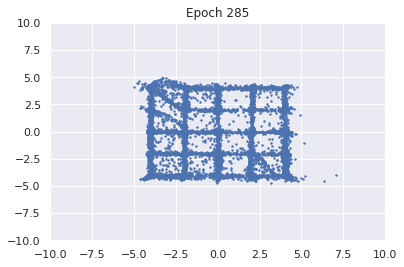

100%|██████████| 976/976 [00:10<00:00, 92.20it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7435, MI : 2.7086


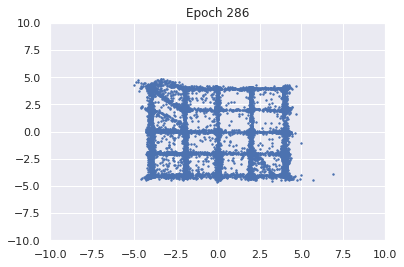

100%|██████████| 976/976 [00:10<00:00, 92.14it/s]


D loss : 1.3774, GP_loss : 0.0 G_loss : -0.7436, MI : 2.6994


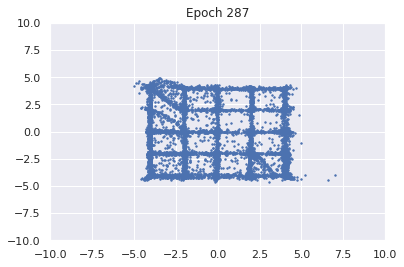

100%|██████████| 976/976 [00:10<00:00, 91.36it/s]


D loss : 1.3772, GP_loss : 0.0 G_loss : -0.7443, MI : 2.709


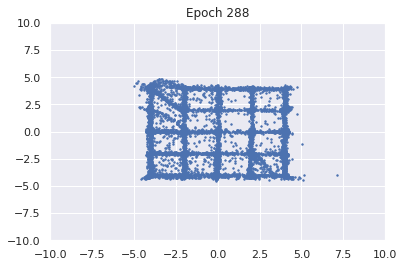

100%|██████████| 976/976 [00:10<00:00, 92.37it/s]


D loss : 1.3773, GP_loss : 0.0 G_loss : -0.7439, MI : 2.7345


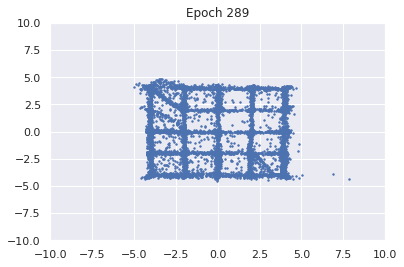

100%|██████████| 976/976 [00:10<00:00, 92.21it/s]


D loss : 1.3772, GP_loss : 0.0 G_loss : -0.7435, MI : 2.7123


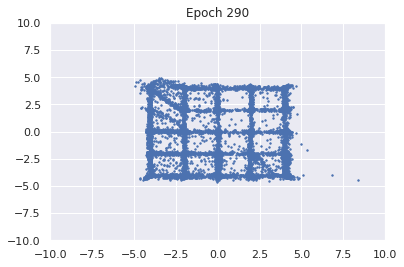

100%|██████████| 976/976 [00:10<00:00, 91.98it/s]


D loss : 1.3773, GP_loss : 0.0 G_loss : -0.7433, MI : 2.7162


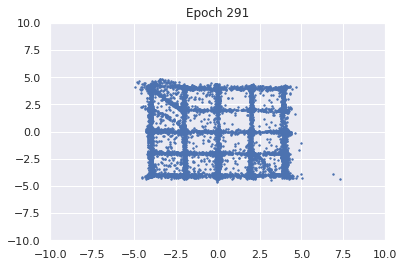

100%|██████████| 976/976 [00:10<00:00, 91.72it/s]


D loss : 1.3774, GP_loss : 0.0 G_loss : -0.7433, MI : 2.7195


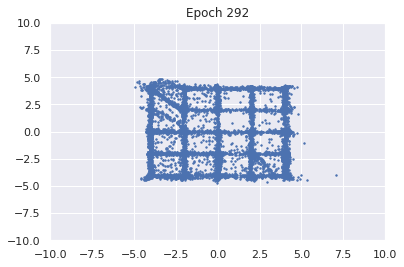

100%|██████████| 976/976 [00:12<00:00, 81.00it/s]


D loss : 1.3775, GP_loss : 0.0 G_loss : -0.7427, MI : 2.7335


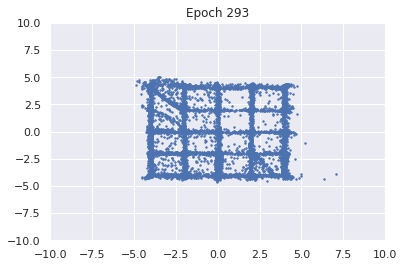

100%|██████████| 976/976 [00:17<00:00, 55.94it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7442, MI : 2.7514


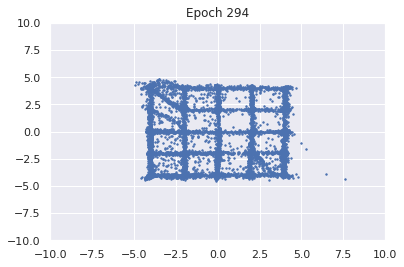

100%|██████████| 976/976 [00:17<00:00, 55.84it/s]


D loss : 1.377, GP_loss : 0.0 G_loss : -0.7451, MI : 2.6338


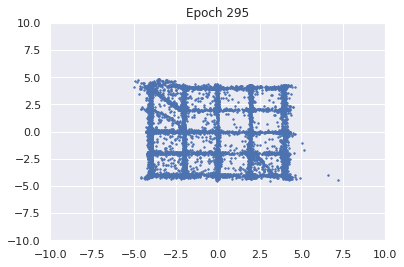

100%|██████████| 976/976 [00:17<00:00, 55.70it/s]


D loss : 1.3773, GP_loss : 0.0 G_loss : -0.7437, MI : 2.729


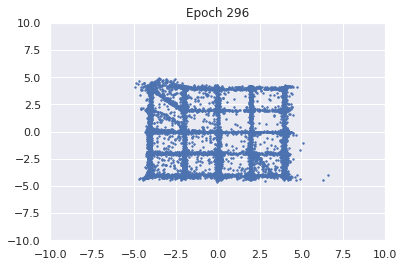

100%|██████████| 976/976 [00:17<00:00, 57.36it/s]


D loss : 1.3775, GP_loss : 0.0 G_loss : -0.7439, MI : 2.7464


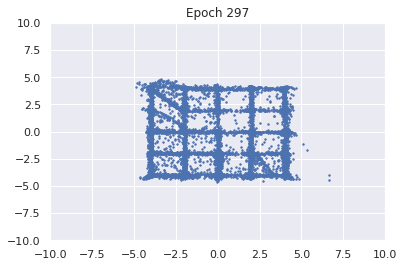

100%|██████████| 976/976 [00:15<00:00, 63.58it/s]


D loss : 1.3775, GP_loss : 0.0 G_loss : -0.7422, MI : 2.7419


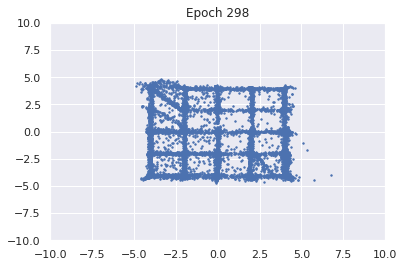

100%|██████████| 976/976 [00:17<00:00, 55.52it/s]


D loss : 1.3776, GP_loss : 0.0 G_loss : -0.7425, MI : 2.7402


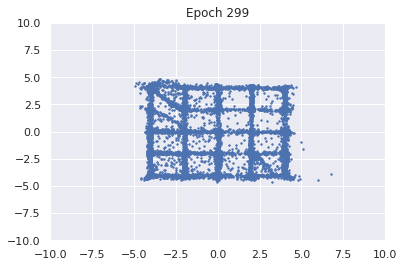

100%|██████████| 976/976 [00:17<00:00, 55.71it/s]


D loss : 1.3775, GP_loss : 0.0 G_loss : -0.7428, MI : 2.7677


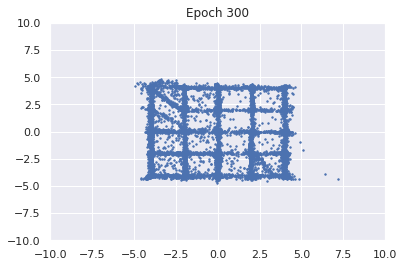

In [13]:
# MI augemented GAN
G = Generator()
G_ma = Generator()
D = Discriminator()
M = Mine()

if USE_GPU:
    G, G_ma, D, M = G.cuda(), G_ma.cuda(), D.cuda(), M.cuda()

G_ma.load_state_dict(G.state_dict())

G_opt = torch.optim.Adam(G.parameters(), lr=2e-4)
D_opt = torch.optim.Adam(D.parameters(), lr=2e-4)
M_opt = torch.optim.Adam(M.parameters(), lr=2e-4)

train(is_zero_gp=True, is_mi_obj=True)

100%|██████████| 976/976 [00:14<00:00, 65.19it/s]


D loss : 1.2734, GP_loss : 0.0 G_loss : -0.7252, MI : 0.5852


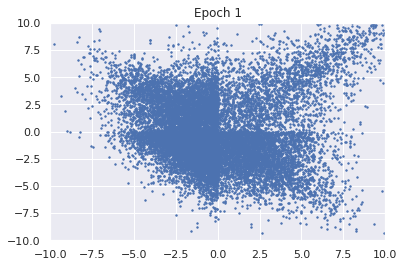

100%|██████████| 976/976 [00:14<00:00, 68.76it/s]


D loss : 1.3152, GP_loss : 0.0 G_loss : -0.7608, MI : 0.835


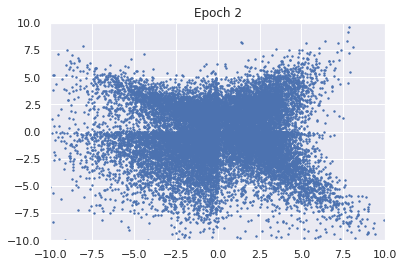

100%|██████████| 976/976 [00:12<00:00, 81.25it/s]


D loss : 1.3214, GP_loss : 0.0 G_loss : -0.7548, MI : 0.5726


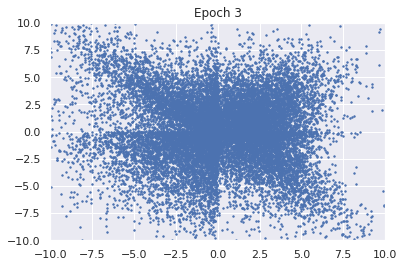

100%|██████████| 976/976 [00:14<00:00, 65.11it/s]


D loss : 1.3162, GP_loss : 0.0 G_loss : -0.7604, MI : 0.5332


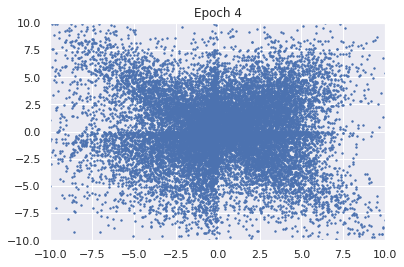

100%|██████████| 976/976 [00:11<00:00, 83.34it/s]


D loss : 1.3067, GP_loss : 0.0 G_loss : -0.764, MI : 0.5699


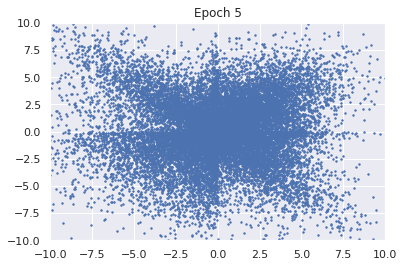

100%|██████████| 976/976 [00:11<00:00, 82.75it/s]


D loss : 1.2924, GP_loss : 0.0 G_loss : -0.7644, MI : 0.65


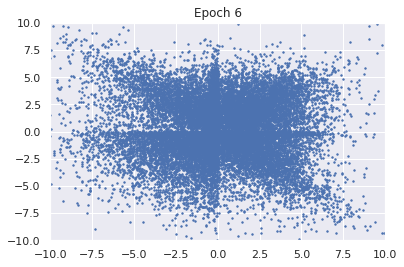

100%|██████████| 976/976 [00:11<00:00, 82.40it/s]


D loss : 1.2798, GP_loss : 0.0 G_loss : -0.7715, MI : 0.6708


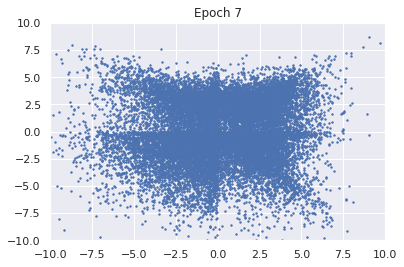

100%|██████████| 976/976 [00:11<00:00, 83.88it/s]


D loss : 1.2694, GP_loss : 0.0 G_loss : -0.7752, MI : 0.6486


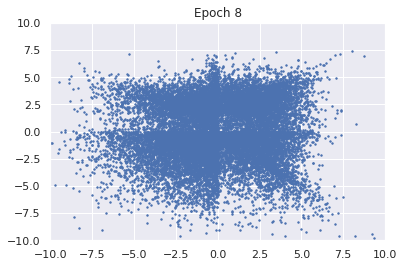

100%|██████████| 976/976 [00:14<00:00, 68.44it/s]


D loss : 1.2605, GP_loss : 0.0 G_loss : -0.777, MI : 0.6418


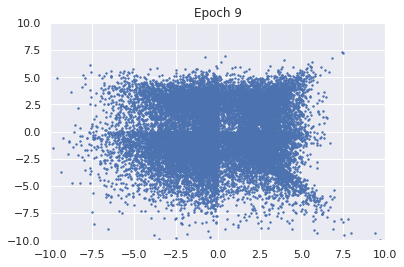

100%|██████████| 976/976 [00:11<00:00, 84.54it/s]


D loss : 1.2548, GP_loss : 0.0 G_loss : -0.7796, MI : 0.6363


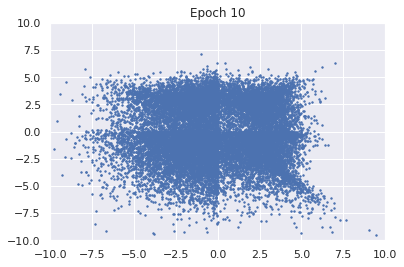

100%|██████████| 976/976 [00:14<00:00, 69.65it/s]


D loss : 1.2502, GP_loss : 0.0 G_loss : -0.782, MI : 0.6627


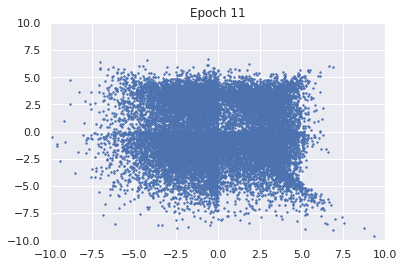

100%|██████████| 976/976 [00:12<00:00, 81.07it/s]


D loss : 1.248, GP_loss : 0.0 G_loss : -0.7833, MI : 0.6726


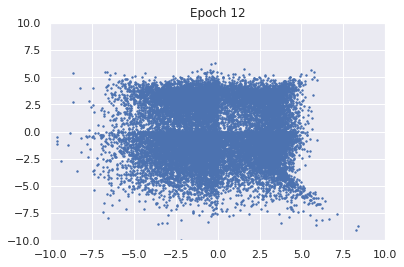

100%|██████████| 976/976 [00:12<00:00, 65.13it/s]


D loss : 1.2481, GP_loss : 0.0 G_loss : -0.7855, MI : 0.6795


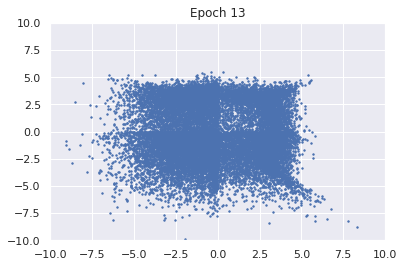

100%|██████████| 976/976 [00:11<00:00, 82.83it/s]


D loss : 1.2492, GP_loss : 0.0 G_loss : -0.7849, MI : 0.6878


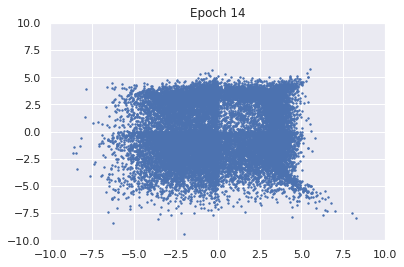

100%|██████████| 976/976 [00:13<00:00, 69.85it/s]


D loss : 1.2509, GP_loss : 0.0 G_loss : -0.7844, MI : 0.6554


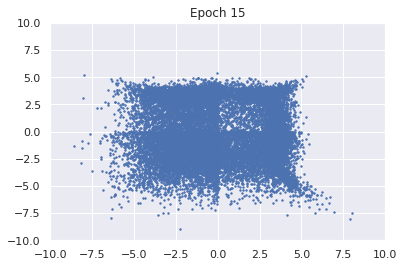

100%|██████████| 976/976 [00:14<00:00, 69.56it/s]


D loss : 1.2531, GP_loss : 0.0 G_loss : -0.7808, MI : 0.6677


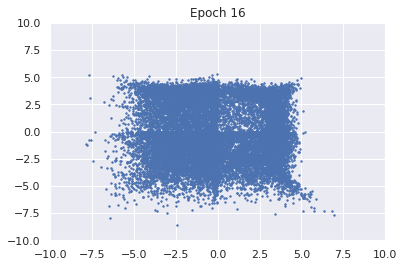

100%|██████████| 976/976 [00:11<00:00, 82.68it/s]


D loss : 1.2562, GP_loss : 0.0 G_loss : -0.7809, MI : 0.6809


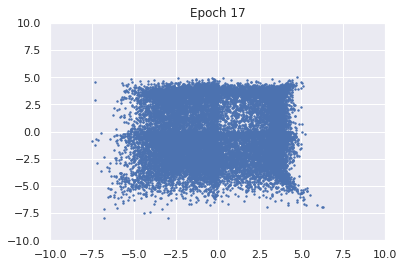

100%|██████████| 976/976 [00:11<00:00, 84.29it/s]


D loss : 1.2602, GP_loss : 0.0 G_loss : -0.7814, MI : 0.6649


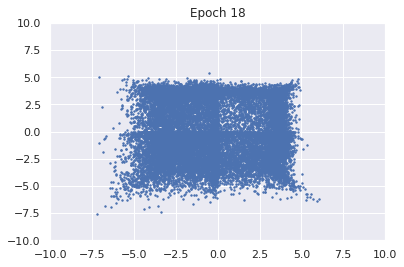

100%|██████████| 976/976 [00:11<00:00, 83.71it/s]


D loss : 1.2663, GP_loss : 0.0 G_loss : -0.7812, MI : 0.661


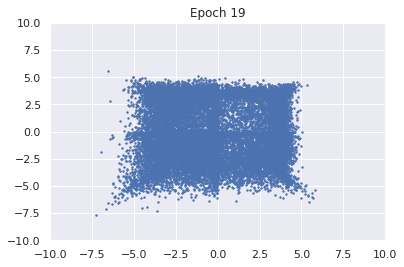

100%|██████████| 976/976 [00:11<00:00, 83.10it/s]


D loss : 1.2725, GP_loss : 0.0 G_loss : -0.7817, MI : 0.667


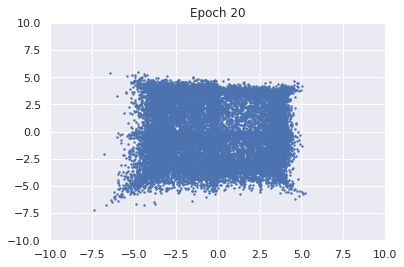

100%|██████████| 976/976 [00:11<00:00, 83.98it/s]


D loss : 1.2784, GP_loss : 0.0 G_loss : -0.7814, MI : 0.6486


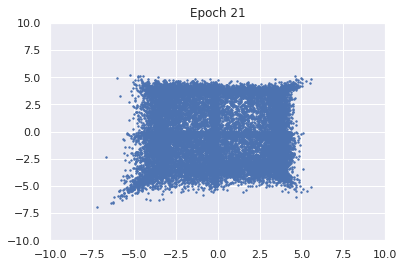

100%|██████████| 976/976 [00:11<00:00, 83.82it/s]


D loss : 1.2826, GP_loss : 0.0 G_loss : -0.7809, MI : 0.638


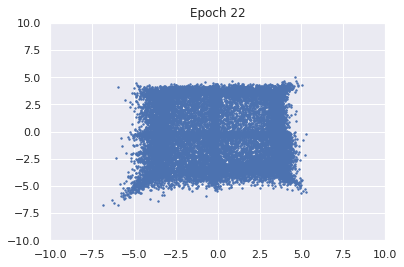

100%|██████████| 976/976 [00:12<00:00, 84.42it/s]


D loss : 1.2877, GP_loss : 0.0 G_loss : -0.7808, MI : 0.6185


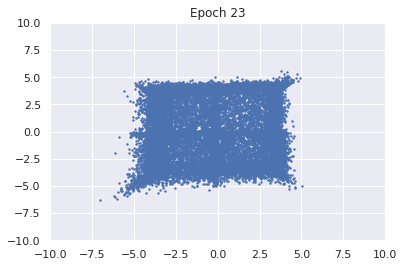

100%|██████████| 976/976 [00:11<00:00, 82.90it/s]


D loss : 1.2923, GP_loss : 0.0 G_loss : -0.7812, MI : 0.6235


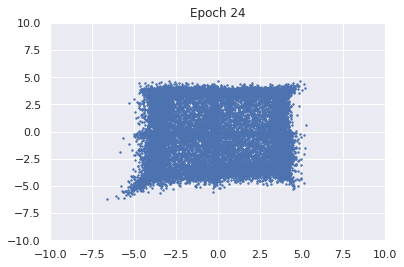

100%|██████████| 976/976 [00:11<00:00, 83.46it/s]


D loss : 1.2962, GP_loss : 0.0 G_loss : -0.778, MI : 0.6246


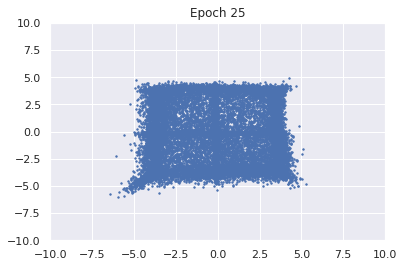

100%|██████████| 976/976 [00:15<00:00, 64.23it/s]


D loss : 1.3005, GP_loss : 0.0 G_loss : -0.7735, MI : 0.6265


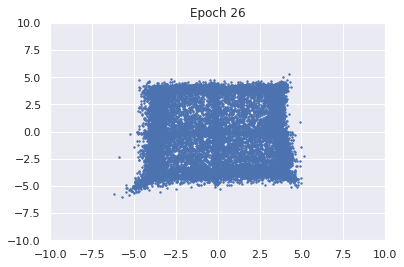

100%|██████████| 976/976 [00:13<00:00, 74.15it/s]


D loss : 1.3027, GP_loss : 0.0 G_loss : -0.7694, MI : 0.6347


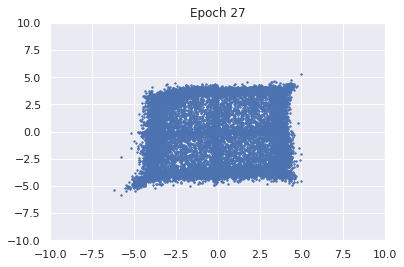

100%|██████████| 976/976 [00:15<00:00, 64.37it/s]


D loss : 1.3043, GP_loss : 0.0 G_loss : -0.7672, MI : 0.6388


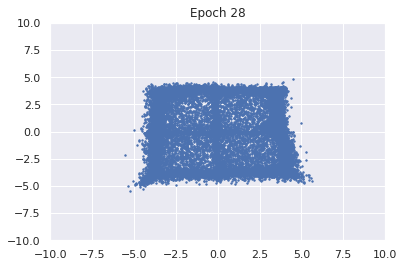

100%|██████████| 976/976 [00:15<00:00, 63.99it/s]


D loss : 1.3041, GP_loss : 0.0 G_loss : -0.7656, MI : 0.6497


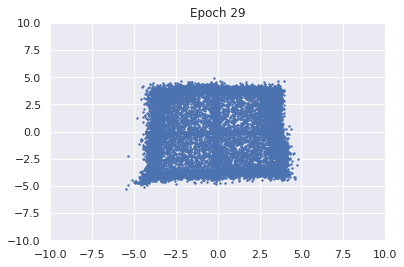

100%|██████████| 976/976 [00:11<00:00, 81.23it/s]


D loss : 1.3065, GP_loss : 0.0 G_loss : -0.7572, MI : 0.6204


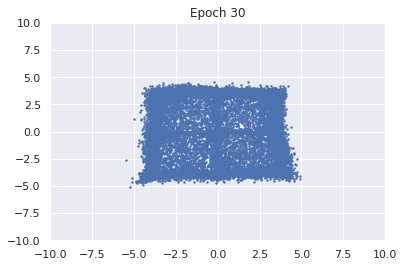

100%|██████████| 976/976 [00:13<00:00, 70.02it/s]


D loss : 1.3042, GP_loss : 0.0 G_loss : -0.7637, MI : 0.6438


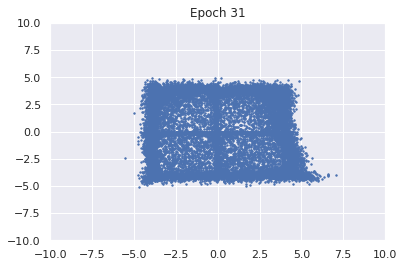

100%|██████████| 976/976 [00:15<00:00, 64.08it/s]


D loss : 1.3038, GP_loss : 0.0 G_loss : -0.7641, MI : 0.6349


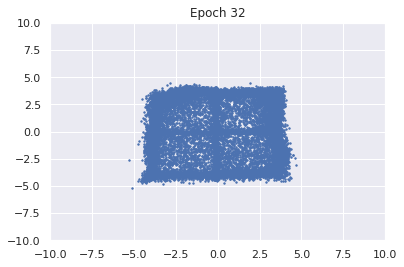

100%|██████████| 976/976 [00:12<00:00, 75.14it/s]


D loss : 1.3032, GP_loss : 0.0 G_loss : -0.7639, MI : 0.6319


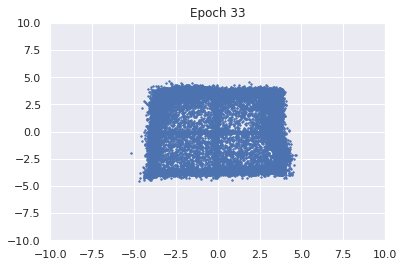

100%|██████████| 976/976 [00:12<00:00, 62.83it/s]


D loss : 1.3026, GP_loss : 0.0 G_loss : -0.7648, MI : 0.6375


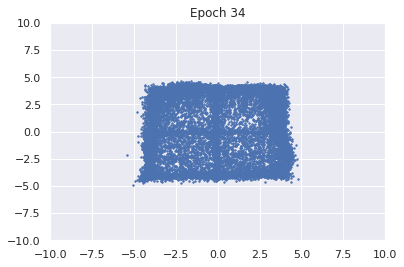

100%|██████████| 976/976 [00:11<00:00, 82.84it/s]


D loss : 1.302, GP_loss : 0.0 G_loss : -0.7645, MI : 0.6376


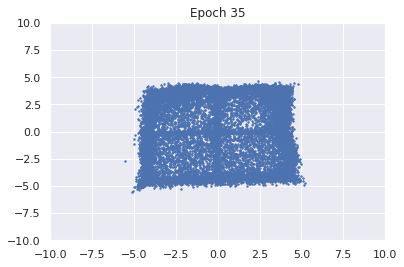

100%|██████████| 976/976 [00:14<00:00, 67.63it/s]


D loss : 1.3004, GP_loss : 0.0 G_loss : -0.766, MI : 0.6441


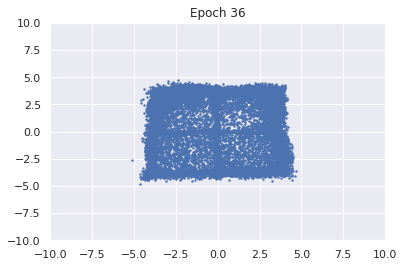

100%|██████████| 976/976 [00:11<00:00, 85.72it/s]


D loss : 1.2991, GP_loss : 0.0 G_loss : -0.7653, MI : 0.6503


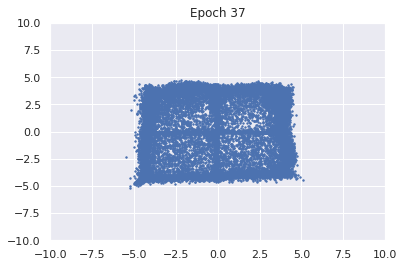

100%|██████████| 976/976 [00:12<00:00, 76.59it/s]


D loss : 1.2974, GP_loss : 0.0 G_loss : -0.7656, MI : 0.6517


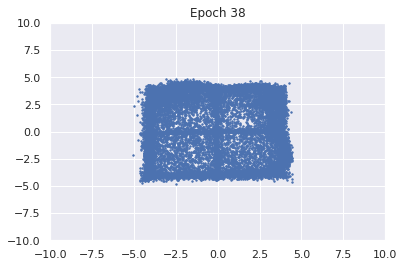

100%|██████████| 976/976 [00:12<00:00, 75.60it/s]


D loss : 1.298, GP_loss : 0.0 G_loss : -0.7677, MI : 0.651


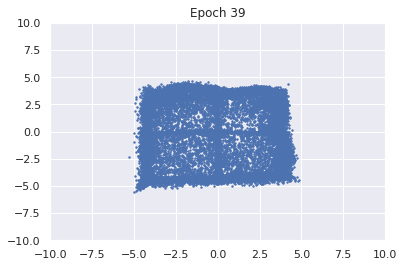

100%|██████████| 976/976 [00:12<00:00, 79.64it/s]


D loss : 1.2959, GP_loss : 0.0 G_loss : -0.7718, MI : 0.6536


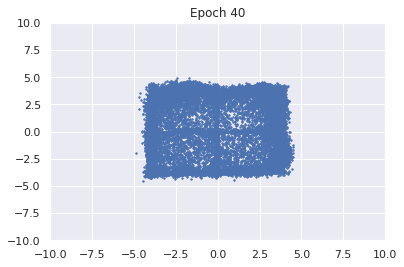

100%|██████████| 976/976 [00:11<00:00, 81.37it/s]


D loss : 1.2928, GP_loss : 0.0 G_loss : -0.771, MI : 0.6641


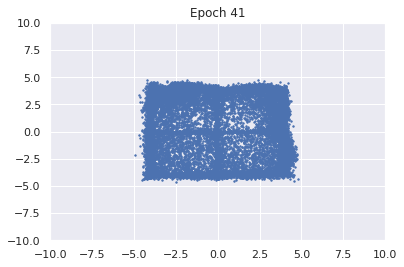

100%|██████████| 976/976 [00:13<00:00, 69.87it/s]


D loss : 1.2905, GP_loss : 0.0 G_loss : -0.7725, MI : 0.667


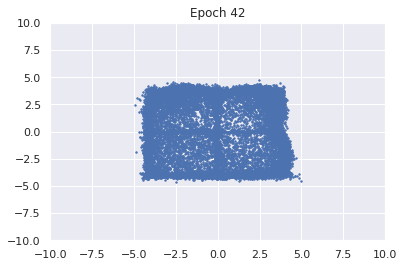

100%|██████████| 976/976 [00:11<00:00, 81.98it/s]


D loss : 1.2883, GP_loss : 0.0 G_loss : -0.7722, MI : 0.6714


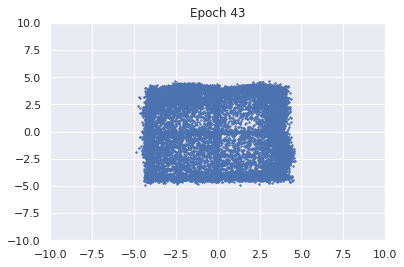

100%|██████████| 976/976 [00:12<00:00, 69.18it/s]


D loss : 1.2878, GP_loss : 0.0 G_loss : -0.7733, MI : 0.6816


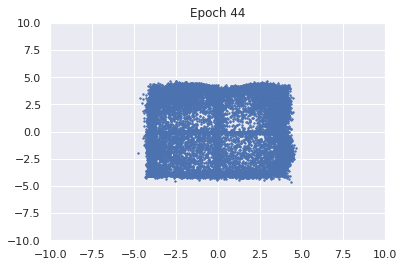

100%|██████████| 976/976 [00:10<00:00, 94.30it/s] 


D loss : 1.2858, GP_loss : 0.0 G_loss : -0.7737, MI : 0.6797


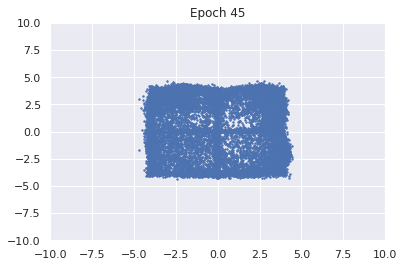

100%|██████████| 976/976 [00:12<00:00, 78.60it/s] 


D loss : 1.2858, GP_loss : 0.0 G_loss : -0.7747, MI : 0.6926


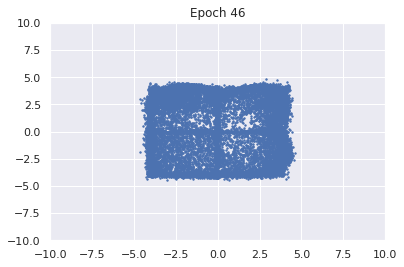

100%|██████████| 976/976 [00:14<00:00, 65.25it/s]


D loss : 1.2843, GP_loss : 0.0 G_loss : -0.7745, MI : 0.7076


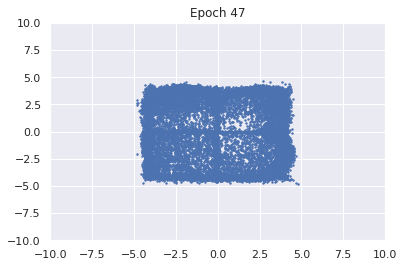

100%|██████████| 976/976 [00:12<00:00, 78.22it/s]


D loss : 1.2832, GP_loss : 0.0 G_loss : -0.7758, MI : 0.7109


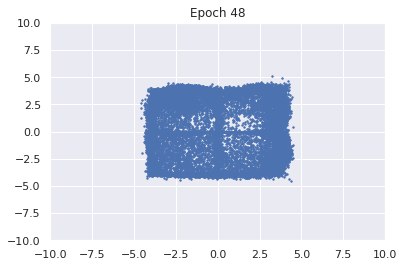

100%|██████████| 976/976 [00:12<00:00, 78.49it/s]


D loss : 1.2839, GP_loss : 0.0 G_loss : -0.7755, MI : 0.7192


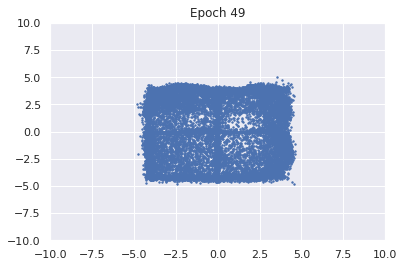

100%|██████████| 976/976 [00:14<00:00, 64.76it/s]


D loss : 1.2845, GP_loss : 0.0 G_loss : -0.775, MI : 0.7277


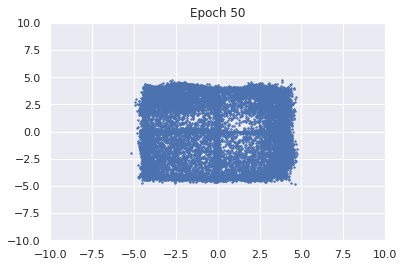

100%|██████████| 976/976 [00:15<00:00, 63.39it/s]


D loss : 1.2835, GP_loss : 0.0 G_loss : -0.7755, MI : 0.7437


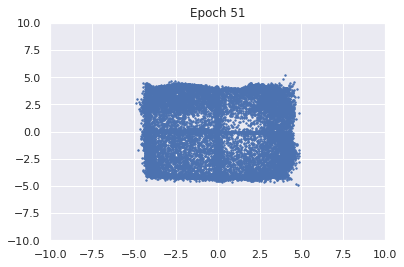

100%|██████████| 976/976 [00:12<00:00, 79.84it/s]


D loss : 1.2832, GP_loss : 0.0 G_loss : -0.7764, MI : 0.7487


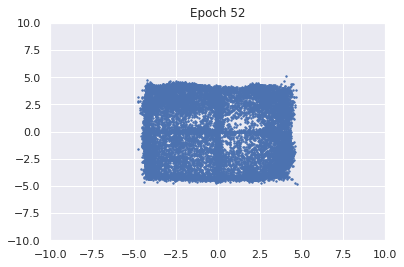

100%|██████████| 976/976 [00:11<00:00, 82.36it/s]


D loss : 1.2837, GP_loss : 0.0 G_loss : -0.7765, MI : 0.7533


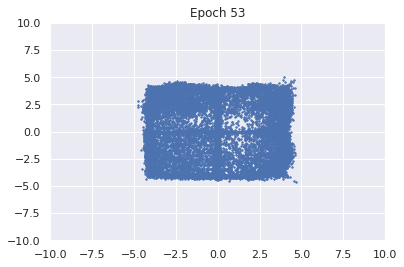

100%|██████████| 976/976 [00:11<00:00, 81.73it/s]


D loss : 1.2833, GP_loss : 0.0 G_loss : -0.7761, MI : 0.7612


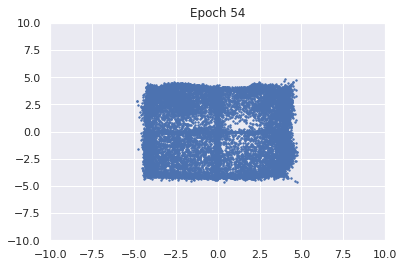

100%|██████████| 976/976 [00:11<00:00, 82.71it/s]


D loss : 1.2835, GP_loss : 0.0 G_loss : -0.7765, MI : 0.7643


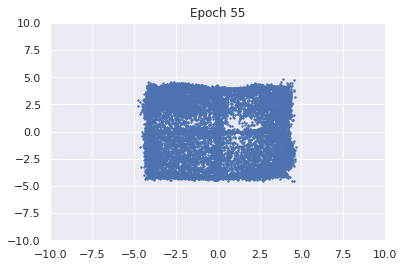

100%|██████████| 976/976 [00:14<00:00, 63.72it/s]


D loss : 1.2836, GP_loss : 0.0 G_loss : -0.7771, MI : 0.7712


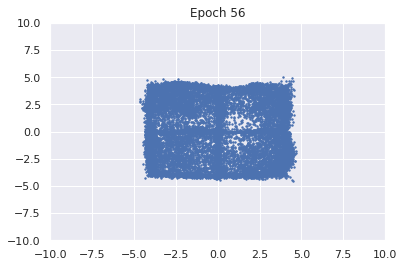

100%|██████████| 976/976 [00:11<00:00, 82.47it/s]


D loss : 1.2842, GP_loss : 0.0 G_loss : -0.7775, MI : 0.7865


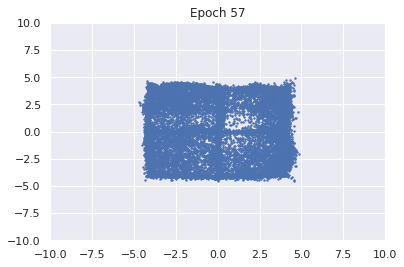

100%|██████████| 976/976 [00:13<00:00, 73.42it/s]


D loss : 1.2854, GP_loss : 0.0 G_loss : -0.7781, MI : 0.779


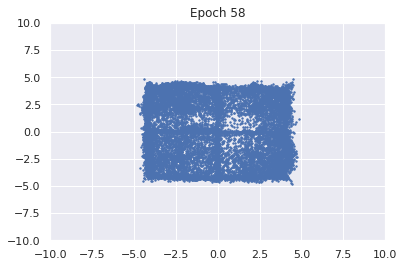

100%|██████████| 976/976 [00:14<00:00, 67.35it/s]


D loss : 1.2871, GP_loss : 0.0 G_loss : -0.7786, MI : 0.7806


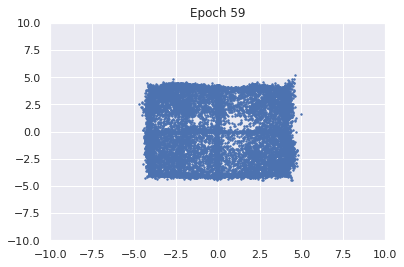

100%|██████████| 976/976 [00:14<00:00, 67.87it/s]


D loss : 1.2877, GP_loss : 0.0 G_loss : -0.7784, MI : 0.7843


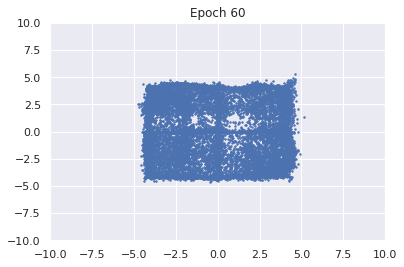

100%|██████████| 976/976 [00:12<00:00, 80.73it/s]


D loss : 1.2902, GP_loss : 0.0 G_loss : -0.7798, MI : 0.7863


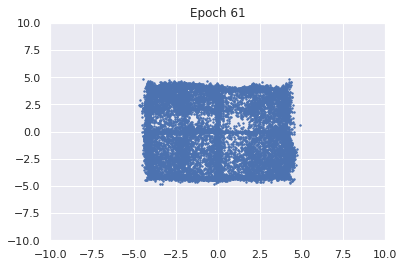

100%|██████████| 976/976 [00:13<00:00, 74.52it/s]


D loss : 1.2928, GP_loss : 0.0 G_loss : -0.7799, MI : 0.7824


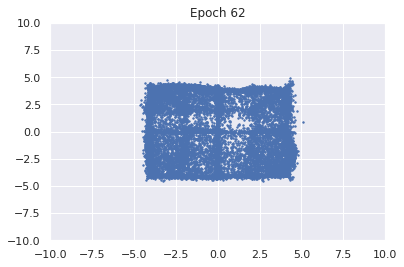

100%|██████████| 976/976 [00:12<00:00, 78.47it/s]


D loss : 1.2942, GP_loss : 0.0 G_loss : -0.7806, MI : 0.7871


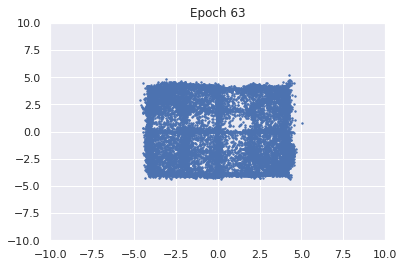

100%|██████████| 976/976 [00:12<00:00, 80.16it/s]


D loss : 1.2971, GP_loss : 0.0 G_loss : -0.7815, MI : 0.7917


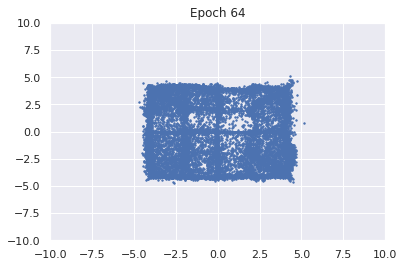

100%|██████████| 976/976 [00:12<00:00, 81.18it/s]


D loss : 1.2999, GP_loss : 0.0 G_loss : -0.7802, MI : 0.7947


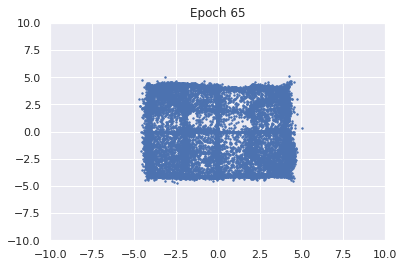

100%|██████████| 976/976 [00:13<00:00, 74.18it/s]


D loss : 1.3018, GP_loss : 0.0 G_loss : -0.7802, MI : 0.7941


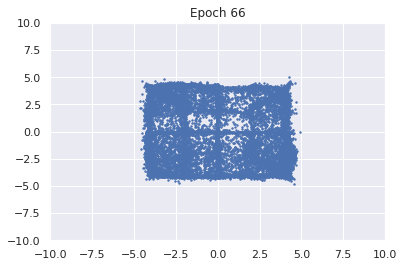

100%|██████████| 976/976 [00:14<00:00, 68.47it/s]


D loss : 1.3045, GP_loss : 0.0 G_loss : -0.7809, MI : 0.7924


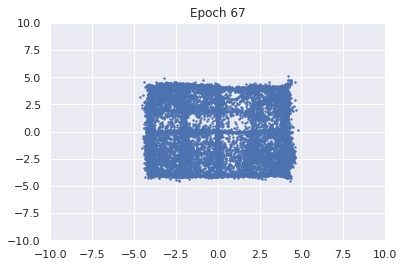

100%|██████████| 976/976 [00:11<00:00, 83.25it/s]


D loss : 1.3066, GP_loss : 0.0 G_loss : -0.7808, MI : 0.7977


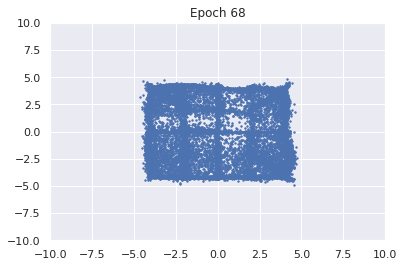

100%|██████████| 976/976 [00:13<00:00, 71.30it/s]


D loss : 1.3093, GP_loss : 0.0 G_loss : -0.7807, MI : 0.795


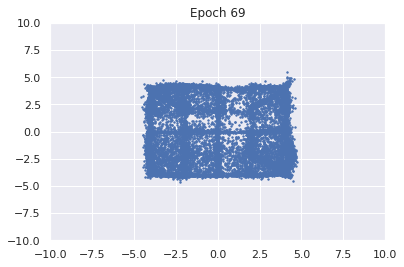

100%|██████████| 976/976 [00:14<00:00, 62.84it/s]


D loss : 1.3104, GP_loss : 0.0 G_loss : -0.7817, MI : 0.7954


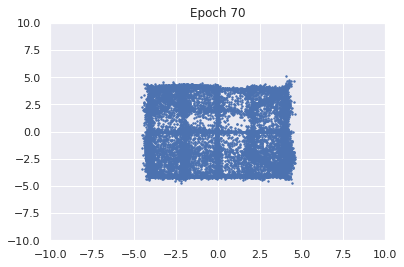

100%|██████████| 976/976 [00:13<00:00, 73.19it/s]


D loss : 1.3135, GP_loss : 0.0 G_loss : -0.7806, MI : 0.798


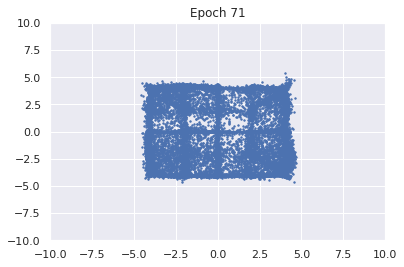

100%|██████████| 976/976 [00:13<00:00, 72.35it/s]


D loss : 1.316, GP_loss : 0.0 G_loss : -0.7817, MI : 0.7998


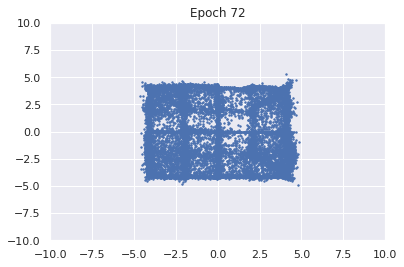

100%|██████████| 976/976 [00:15<00:00, 64.87it/s]


D loss : 1.3184, GP_loss : 0.0 G_loss : -0.7814, MI : 0.796


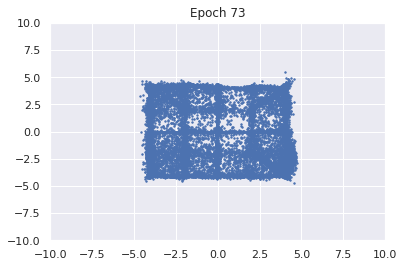

100%|██████████| 976/976 [00:12<00:00, 75.23it/s]


D loss : 1.3211, GP_loss : 0.0 G_loss : -0.781, MI : 0.7982


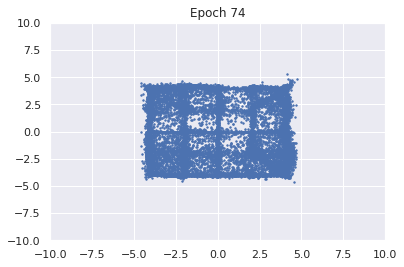

100%|██████████| 976/976 [00:15<00:00, 63.91it/s]


D loss : 1.324, GP_loss : 0.0 G_loss : -0.7812, MI : 0.7979


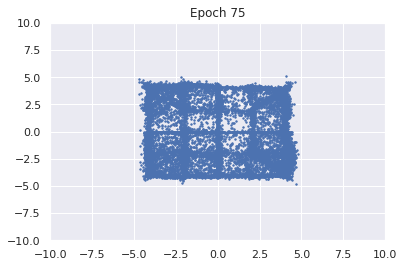

100%|██████████| 976/976 [00:14<00:00, 69.24it/s]


D loss : 1.326, GP_loss : 0.0 G_loss : -0.7809, MI : 0.7985


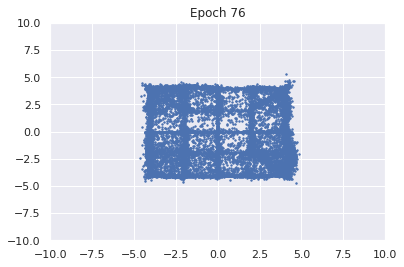

100%|██████████| 976/976 [00:11<00:00, 82.50it/s]


D loss : 1.3283, GP_loss : 0.0 G_loss : -0.7815, MI : 0.7881


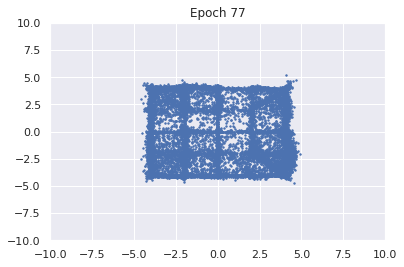

100%|██████████| 976/976 [00:11<00:00, 82.89it/s]


D loss : 1.3307, GP_loss : 0.0 G_loss : -0.7799, MI : 0.7914


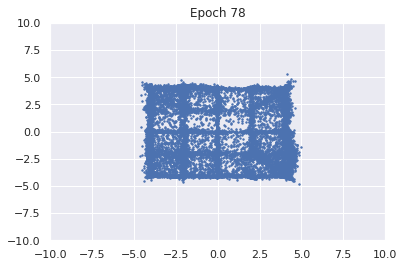

100%|██████████| 976/976 [00:11<00:00, 82.89it/s]


D loss : 1.3324, GP_loss : 0.0 G_loss : -0.781, MI : 0.7906


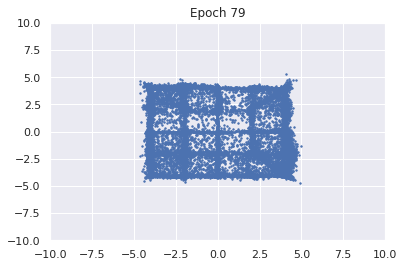

100%|██████████| 976/976 [00:14<00:00, 69.28it/s]


D loss : 1.3347, GP_loss : 0.0 G_loss : -0.7792, MI : 0.7917


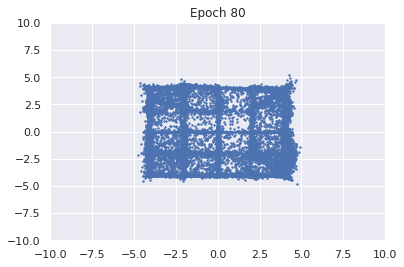

100%|██████████| 976/976 [00:11<00:00, 83.43it/s]


D loss : 1.3371, GP_loss : 0.0 G_loss : -0.7793, MI : 0.7882


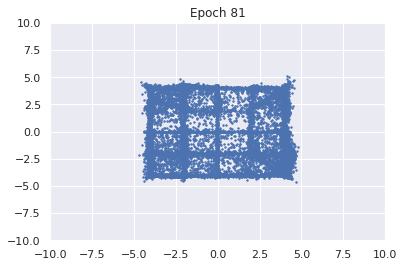

100%|██████████| 976/976 [00:13<00:00, 74.19it/s]


D loss : 1.3385, GP_loss : 0.0 G_loss : -0.7793, MI : 0.7875


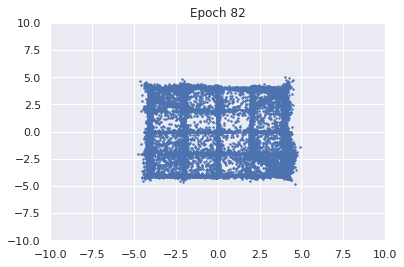

100%|██████████| 976/976 [00:11<00:00, 85.05it/s] 


D loss : 1.3408, GP_loss : 0.0 G_loss : -0.778, MI : 0.7898


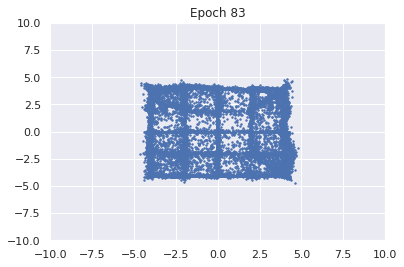

100%|██████████| 976/976 [00:10<00:00, 92.38it/s] 


D loss : 1.3429, GP_loss : 0.0 G_loss : -0.7766, MI : 0.7897


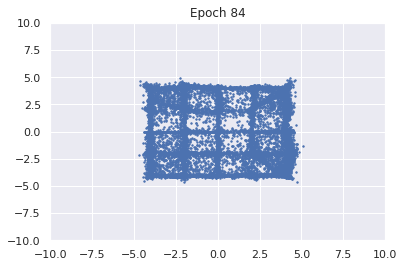

100%|██████████| 976/976 [00:13<00:00, 70.45it/s]


D loss : 1.3436, GP_loss : 0.0 G_loss : -0.7757, MI : 0.7843


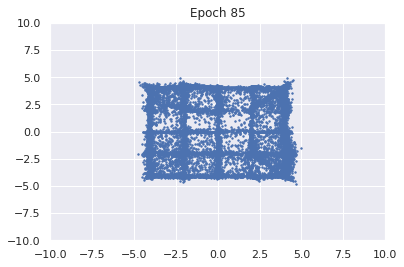

100%|██████████| 976/976 [00:14<00:00, 69.07it/s]


D loss : 1.3461, GP_loss : 0.0 G_loss : -0.7758, MI : 0.7844


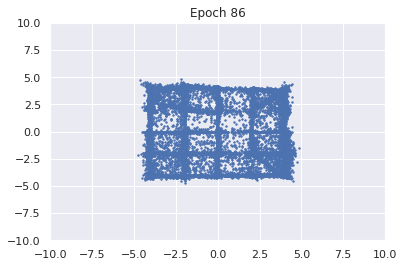

100%|██████████| 976/976 [00:14<00:00, 69.07it/s]


D loss : 1.3481, GP_loss : 0.0 G_loss : -0.7752, MI : 0.789


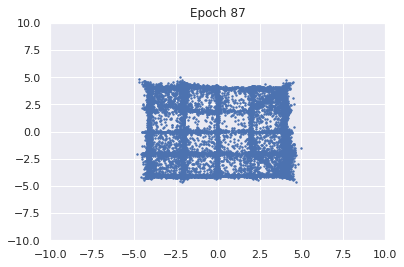

100%|██████████| 976/976 [00:11<00:00, 81.50it/s]


D loss : 1.3494, GP_loss : 0.0 G_loss : -0.7744, MI : 0.7843


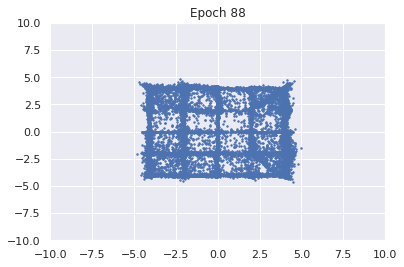

100%|██████████| 976/976 [00:13<00:00, 70.67it/s]


D loss : 1.3514, GP_loss : 0.0 G_loss : -0.7728, MI : 0.7861


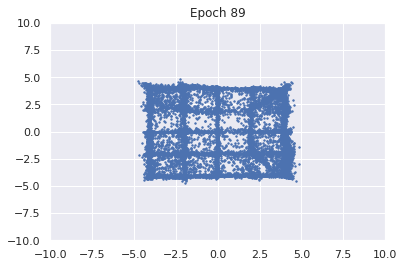

100%|██████████| 976/976 [00:13<00:00, 73.75it/s]


D loss : 1.3522, GP_loss : 0.0 G_loss : -0.7737, MI : 0.7869


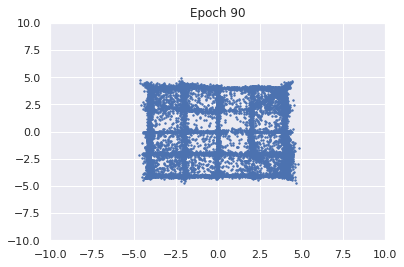

100%|██████████| 976/976 [00:13<00:00, 72.02it/s]


D loss : 1.3537, GP_loss : 0.0 G_loss : -0.7717, MI : 0.7868


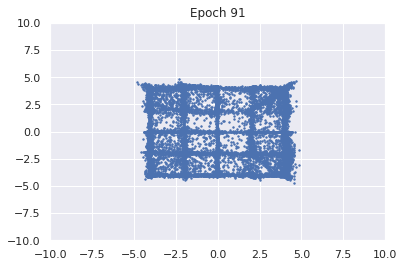

100%|██████████| 976/976 [00:14<00:00, 65.81it/s]


D loss : 1.3554, GP_loss : 0.0 G_loss : -0.7714, MI : 0.7902


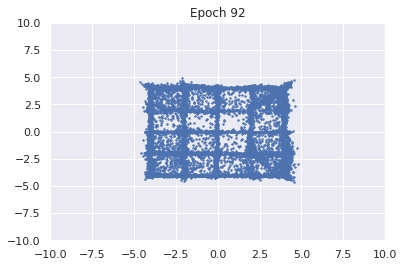

100%|██████████| 976/976 [00:13<00:00, 70.00it/s]


D loss : 1.3563, GP_loss : 0.0 G_loss : -0.7704, MI : 0.7834


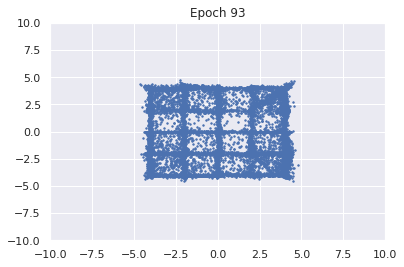

100%|██████████| 976/976 [00:12<00:00, 80.61it/s]


D loss : 1.3574, GP_loss : 0.0 G_loss : -0.7699, MI : 0.7829


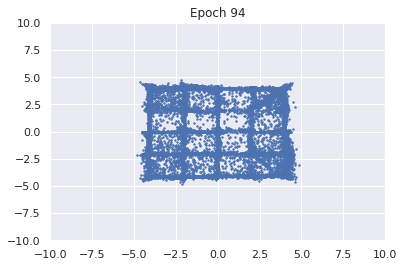

100%|██████████| 976/976 [00:12<00:00, 76.77it/s]


D loss : 1.3593, GP_loss : 0.0 G_loss : -0.766, MI : 0.784


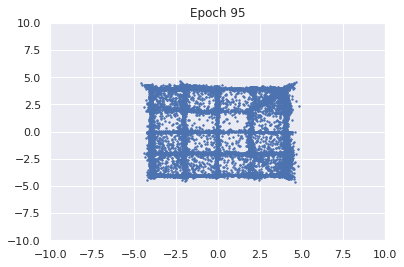

100%|██████████| 976/976 [00:12<00:00, 63.41it/s]


D loss : 1.3594, GP_loss : 0.0 G_loss : -0.7695, MI : 0.786


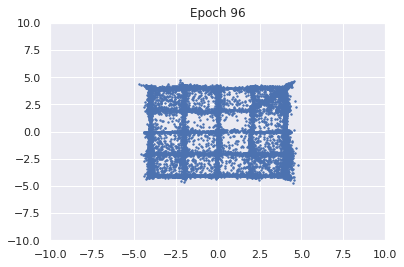

100%|██████████| 976/976 [00:13<00:00, 74.34it/s]


D loss : 1.3607, GP_loss : 0.0 G_loss : -0.7687, MI : 0.7789


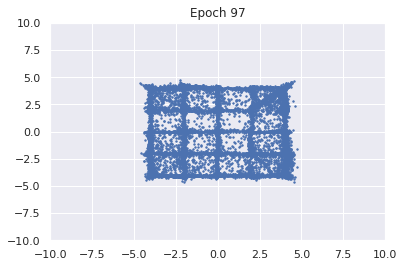

100%|██████████| 976/976 [00:12<00:00, 81.78it/s]


D loss : 1.3617, GP_loss : 0.0 G_loss : -0.7672, MI : 0.786


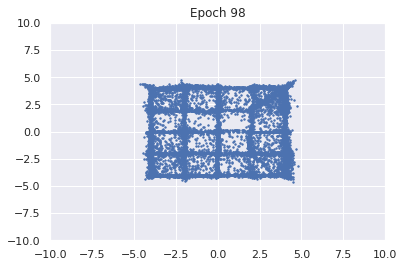

100%|██████████| 976/976 [00:12<00:00, 80.32it/s]


D loss : 1.363, GP_loss : 0.0 G_loss : -0.7644, MI : 0.7849


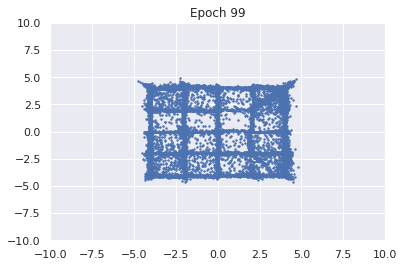

100%|██████████| 976/976 [00:12<00:00, 80.06it/s]


D loss : 1.3637, GP_loss : 0.0 G_loss : -0.7645, MI : 0.7852


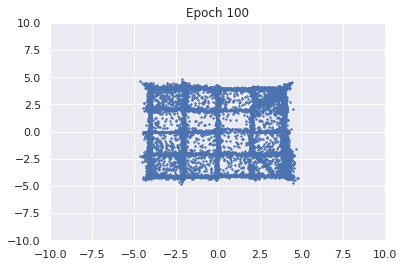

100%|██████████| 976/976 [00:11<00:00, 81.66it/s]


D loss : 1.3647, GP_loss : 0.0 G_loss : -0.7627, MI : 0.7868


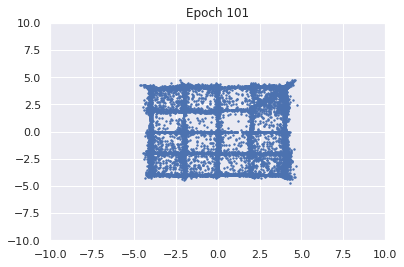

100%|██████████| 976/976 [00:14<00:00, 68.89it/s]


D loss : 1.3648, GP_loss : 0.0 G_loss : -0.7642, MI : 0.7869


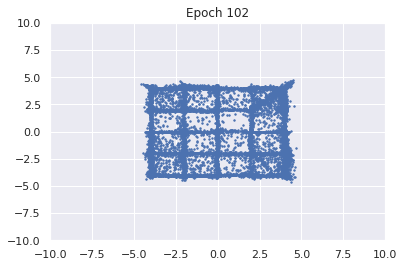

100%|██████████| 976/976 [00:12<00:00, 81.04it/s]


D loss : 1.3661, GP_loss : 0.0 G_loss : -0.7624, MI : 0.7815


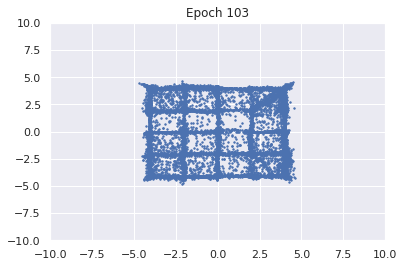

100%|██████████| 976/976 [00:12<00:00, 80.76it/s]


D loss : 1.3663, GP_loss : 0.0 G_loss : -0.7629, MI : 0.781


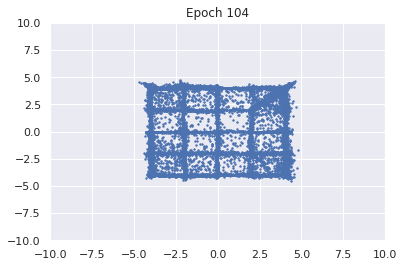

100%|██████████| 976/976 [00:12<00:00, 80.87it/s]


D loss : 1.3673, GP_loss : 0.0 G_loss : -0.7595, MI : 0.7789


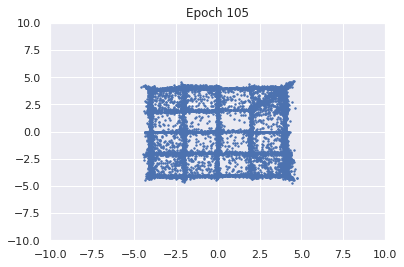

100%|██████████| 976/976 [00:12<00:00, 80.73it/s]


D loss : 1.3674, GP_loss : 0.0 G_loss : -0.7606, MI : 0.7757


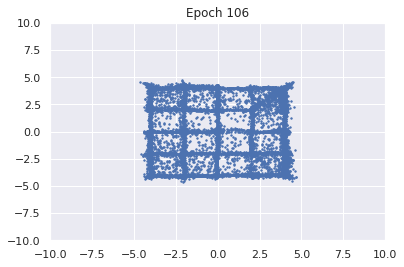

100%|██████████| 976/976 [00:15<00:00, 64.66it/s]


D loss : 1.3685, GP_loss : 0.0 G_loss : -0.759, MI : 0.7829


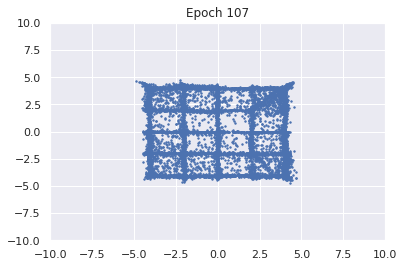

100%|██████████| 976/976 [00:12<00:00, 81.67it/s]


D loss : 1.369, GP_loss : 0.0 G_loss : -0.7575, MI : 0.7722


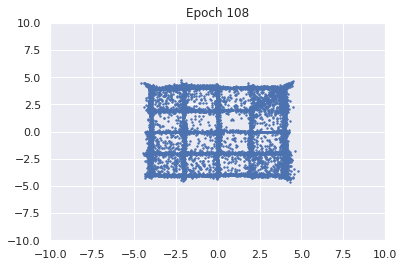

100%|██████████| 976/976 [00:12<00:00, 80.60it/s]


D loss : 1.3693, GP_loss : 0.0 G_loss : -0.7581, MI : 0.7784


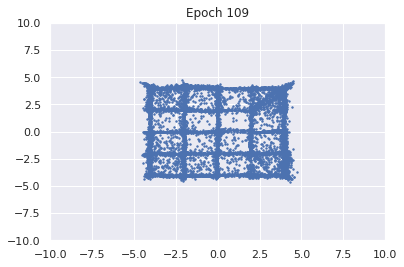

100%|██████████| 976/976 [00:12<00:00, 80.33it/s]


D loss : 1.3695, GP_loss : 0.0 G_loss : -0.7583, MI : 0.7812


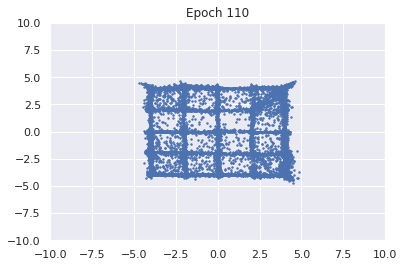

100%|██████████| 976/976 [00:13<00:00, 70.19it/s]


D loss : 1.3702, GP_loss : 0.0 G_loss : -0.7548, MI : 0.7878


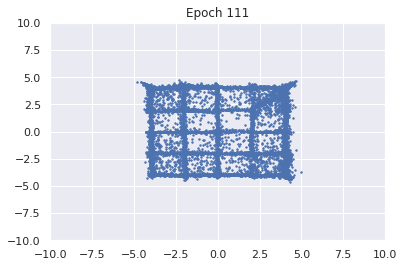

100%|██████████| 976/976 [00:12<00:00, 80.76it/s]


D loss : 1.3705, GP_loss : 0.0 G_loss : -0.7574, MI : 0.7885


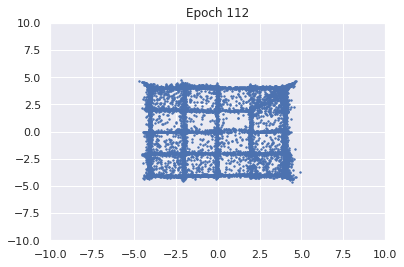

100%|██████████| 976/976 [00:12<00:00, 80.44it/s]


D loss : 1.3714, GP_loss : 0.0 G_loss : -0.7532, MI : 0.7725


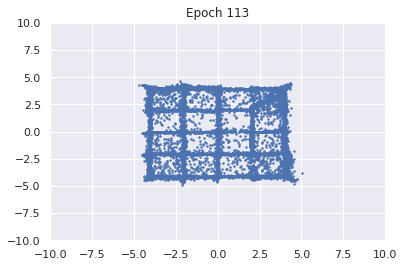

100%|██████████| 976/976 [00:15<00:00, 63.91it/s]


D loss : 1.3721, GP_loss : 0.0 G_loss : -0.7519, MI : 0.7761


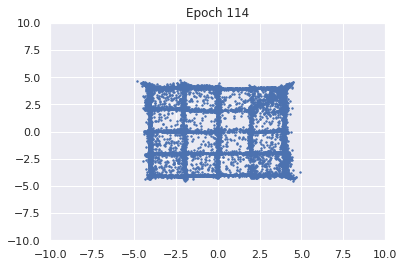

100%|██████████| 976/976 [00:14<00:00, 66.47it/s]


D loss : 1.3712, GP_loss : 0.0 G_loss : -0.7566, MI : 0.7825


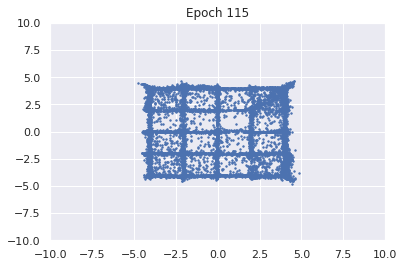

100%|██████████| 976/976 [00:11<00:00, 82.37it/s]


D loss : 1.3728, GP_loss : 0.0 G_loss : -0.7511, MI : 0.7822


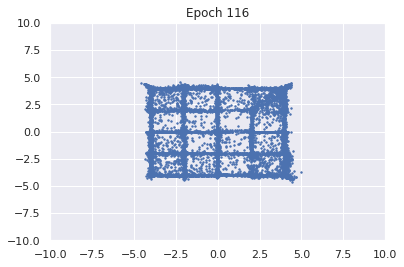

100%|██████████| 976/976 [00:12<00:00, 80.12it/s]


D loss : 1.3726, GP_loss : 0.0 G_loss : -0.7525, MI : 0.7835


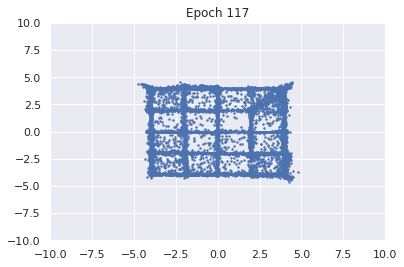

100%|██████████| 976/976 [00:12<00:00, 80.77it/s]


D loss : 1.3734, GP_loss : 0.0 G_loss : -0.7501, MI : 0.7736


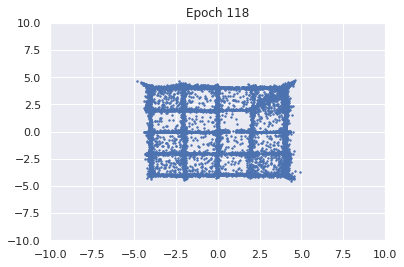

100%|██████████| 976/976 [00:11<00:00, 82.33it/s]


D loss : 1.3736, GP_loss : 0.0 G_loss : -0.7498, MI : 0.7765


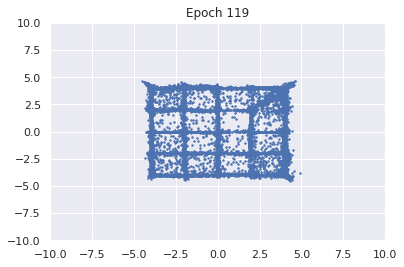

100%|██████████| 976/976 [00:13<00:00, 70.27it/s]


D loss : 1.3736, GP_loss : 0.0 G_loss : -0.7507, MI : 0.78


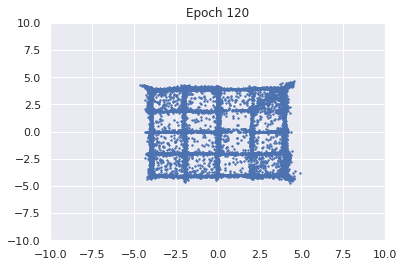

100%|██████████| 976/976 [00:11<00:00, 82.51it/s]


D loss : 1.3738, GP_loss : 0.0 G_loss : -0.7491, MI : 0.7769


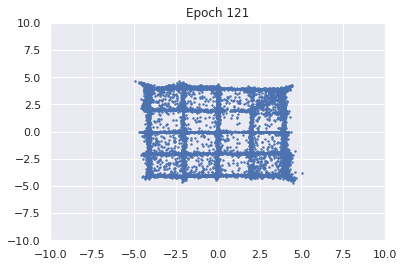

100%|██████████| 976/976 [00:11<00:00, 81.41it/s]


D loss : 1.3739, GP_loss : 0.0 G_loss : -0.7513, MI : 0.7683


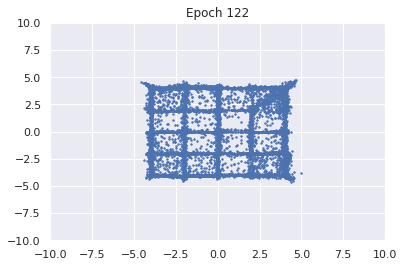

100%|██████████| 976/976 [00:11<00:00, 82.19it/s]


D loss : 1.374, GP_loss : 0.0 G_loss : -0.7517, MI : 0.7728


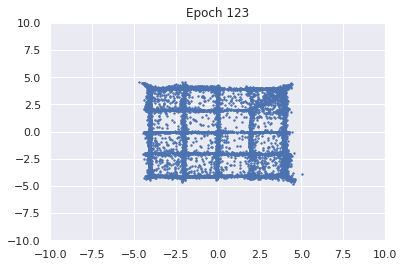

100%|██████████| 976/976 [00:11<00:00, 83.00it/s]


D loss : 1.3749, GP_loss : 0.0 G_loss : -0.7466, MI : 0.7763


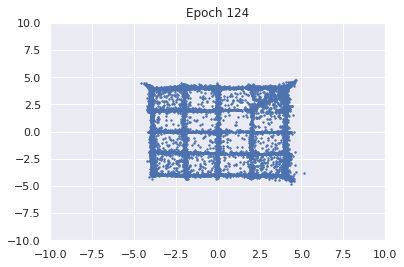

100%|██████████| 976/976 [00:12<00:00, 79.64it/s]


D loss : 1.375, GP_loss : 0.0 G_loss : -0.7468, MI : 0.7797


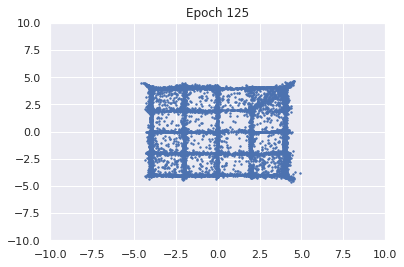

100%|██████████| 976/976 [00:11<00:00, 82.22it/s]


D loss : 1.375, GP_loss : 0.0 G_loss : -0.747, MI : 0.7748


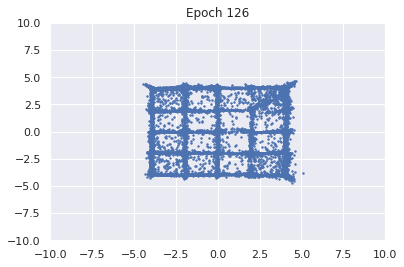

100%|██████████| 976/976 [00:11<00:00, 81.62it/s]


D loss : 1.3758, GP_loss : 0.0 G_loss : -0.7438, MI : 0.768


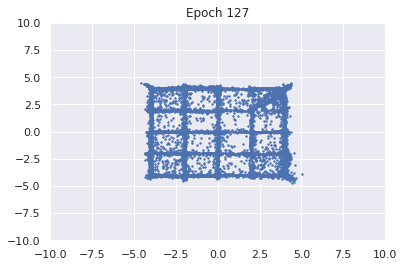

100%|██████████| 976/976 [00:11<00:00, 81.52it/s]


D loss : 1.3758, GP_loss : 0.0 G_loss : -0.7457, MI : 0.769


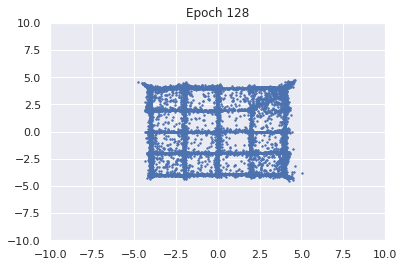

100%|██████████| 976/976 [00:12<00:00, 80.54it/s]


D loss : 1.3761, GP_loss : 0.0 G_loss : -0.7436, MI : 0.7705


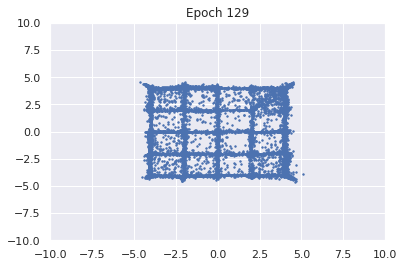

100%|██████████| 976/976 [00:14<00:00, 66.99it/s]


D loss : 1.376, GP_loss : 0.0 G_loss : -0.7434, MI : 0.7766


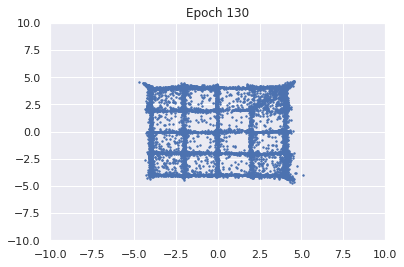

100%|██████████| 976/976 [00:12<00:00, 80.46it/s]


D loss : 1.3761, GP_loss : 0.0 G_loss : -0.744, MI : 0.7741


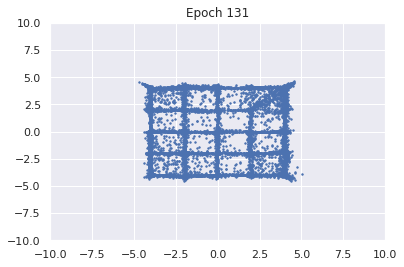

100%|██████████| 976/976 [00:12<00:00, 81.08it/s]


D loss : 1.3765, GP_loss : 0.0 G_loss : -0.7415, MI : 0.7742


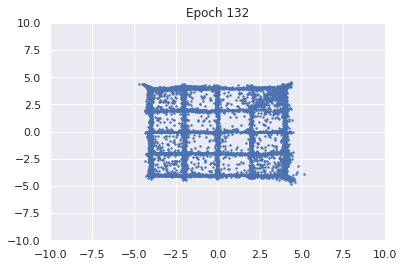

100%|██████████| 976/976 [00:13<00:00, 63.45it/s]


D loss : 1.3764, GP_loss : 0.0 G_loss : -0.7443, MI : 0.7719


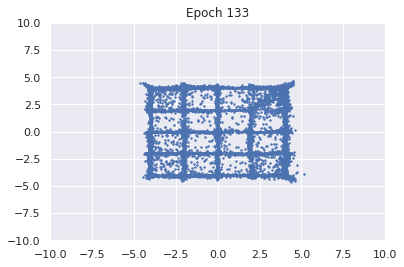

100%|██████████| 976/976 [00:11<00:00, 80.59it/s]


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.7397, MI : 0.7696


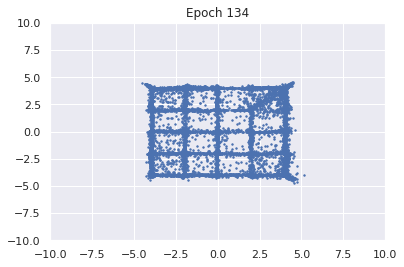

100%|██████████| 976/976 [00:11<00:00, 81.98it/s]


D loss : 1.3768, GP_loss : 0.0 G_loss : -0.7416, MI : 0.771


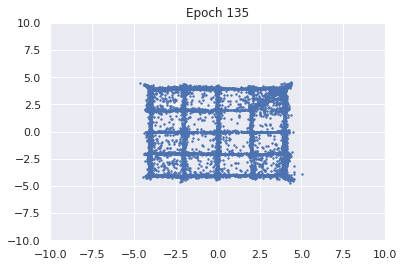

100%|██████████| 976/976 [00:11<00:00, 87.30it/s] 


D loss : 1.3771, GP_loss : 0.0 G_loss : -0.742, MI : 0.7738


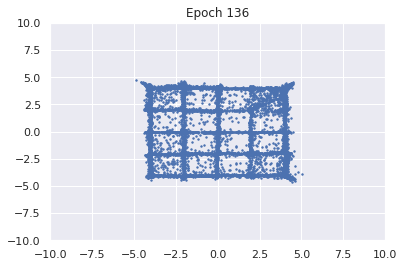

100%|██████████| 976/976 [00:09<00:00, 104.41it/s]


D loss : 1.3772, GP_loss : 0.0 G_loss : -0.7404, MI : 0.7662


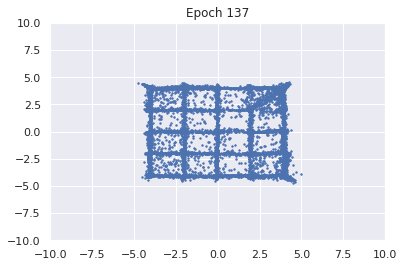

100%|██████████| 976/976 [00:09<00:00, 105.65it/s]


D loss : 1.3782, GP_loss : 0.0 G_loss : -0.7341, MI : 0.7687


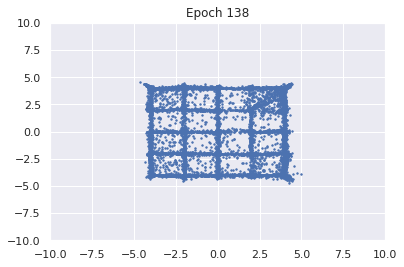

100%|██████████| 976/976 [00:09<00:00, 101.71it/s]


D loss : 1.3777, GP_loss : 0.0 G_loss : -0.7386, MI : 0.7655


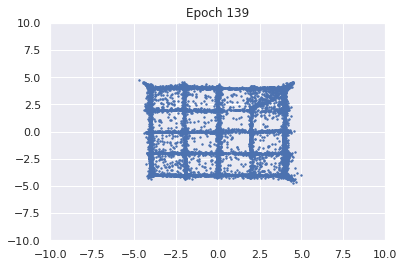

100%|██████████| 976/976 [00:09<00:00, 103.86it/s]


D loss : 1.378, GP_loss : 0.0 G_loss : -0.7364, MI : 0.767


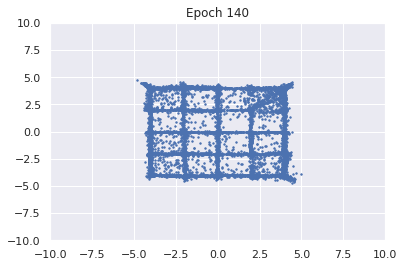

100%|██████████| 976/976 [00:09<00:00, 105.43it/s]


D loss : 1.3778, GP_loss : 0.0 G_loss : -0.7383, MI : 0.7715


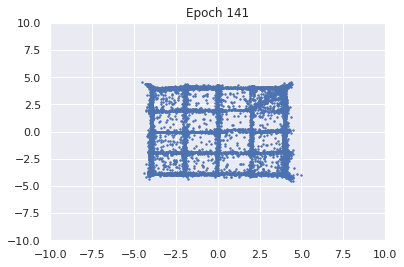

100%|██████████| 976/976 [00:09<00:00, 101.25it/s]


D loss : 1.3786, GP_loss : 0.0 G_loss : -0.7344, MI : 0.7633


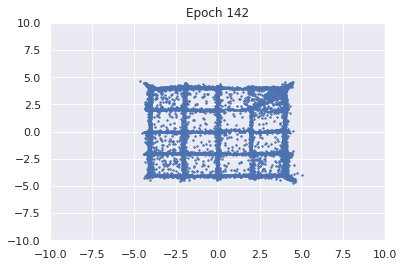

100%|██████████| 976/976 [00:09<00:00, 104.86it/s]


D loss : 1.3789, GP_loss : 0.0 G_loss : -0.7317, MI : 0.7677


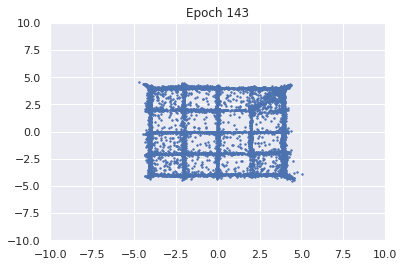

100%|██████████| 976/976 [00:09<00:00, 104.06it/s]


D loss : 1.3784, GP_loss : 0.0 G_loss : -0.7364, MI : 0.7738


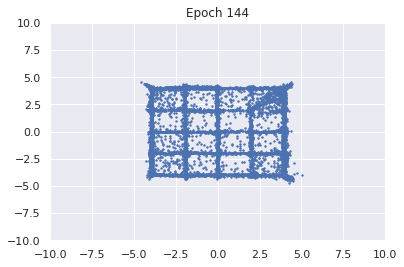

100%|██████████| 976/976 [00:09<00:00, 101.48it/s]


D loss : 1.3785, GP_loss : 0.0 G_loss : -0.7375, MI : 0.77


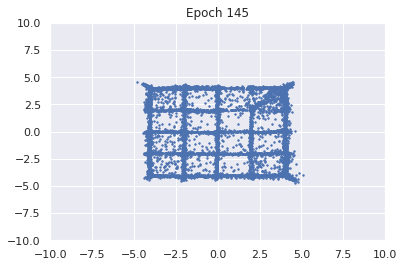

100%|██████████| 976/976 [00:09<00:00, 104.58it/s]


D loss : 1.3785, GP_loss : 0.0 G_loss : -0.7368, MI : 0.7716


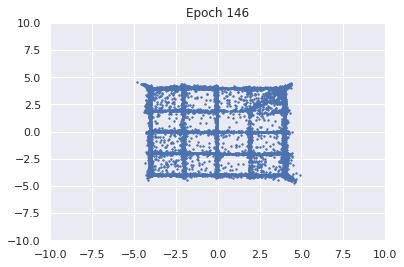

100%|██████████| 976/976 [00:09<00:00, 105.04it/s]


D loss : 1.3786, GP_loss : 0.0 G_loss : -0.7376, MI : 0.773


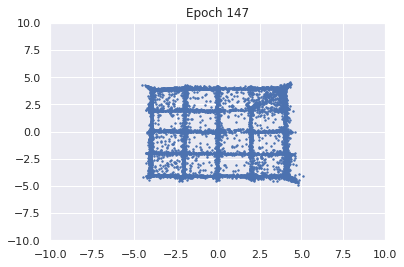

100%|██████████| 976/976 [00:10<00:00, 95.32it/s] 


D loss : 1.3787, GP_loss : 0.0 G_loss : -0.7356, MI : 0.7767


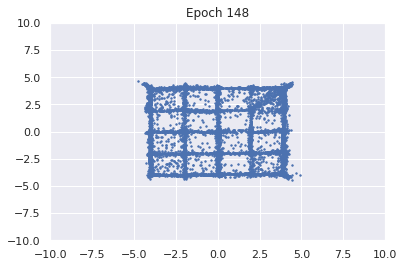

100%|██████████| 976/976 [00:14<00:00, 65.63it/s]


D loss : 1.379, GP_loss : 0.0 G_loss : -0.7349, MI : 0.7805


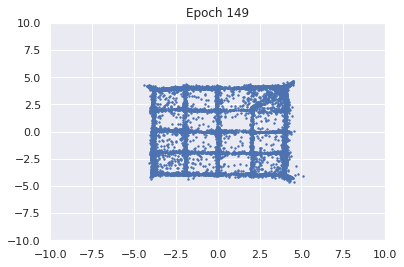

100%|██████████| 976/976 [00:11<00:00, 82.23it/s]


D loss : 1.3792, GP_loss : 0.0 G_loss : -0.7332, MI : 0.7732


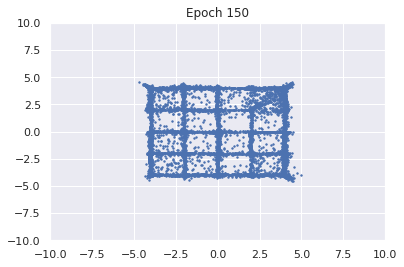

100%|██████████| 976/976 [00:11<00:00, 83.55it/s]


D loss : 1.3787, GP_loss : 0.0 G_loss : -0.7376, MI : 0.7765


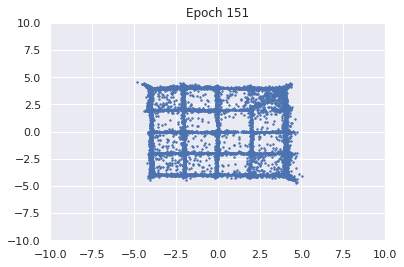

100%|██████████| 976/976 [00:11<00:00, 85.15it/s]


D loss : 1.3793, GP_loss : 0.0 G_loss : -0.7332, MI : 0.7727


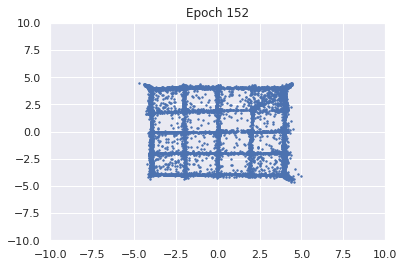

100%|██████████| 976/976 [00:13<00:00, 70.75it/s]


D loss : 1.3792, GP_loss : 0.0 G_loss : -0.7355, MI : 0.7744


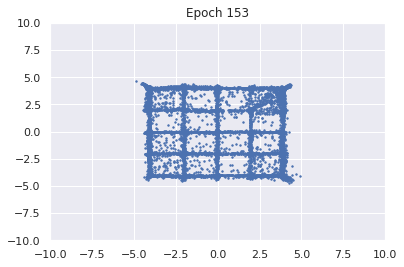

100%|██████████| 976/976 [00:11<00:00, 83.93it/s]


D loss : 1.3795, GP_loss : 0.0 G_loss : -0.7306, MI : 0.7769


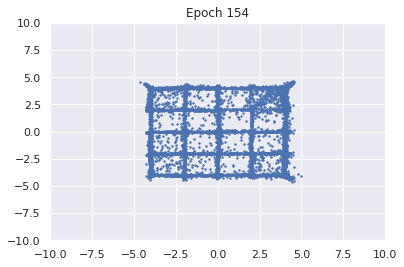

100%|██████████| 976/976 [00:11<00:00, 83.36it/s]


D loss : 1.3796, GP_loss : 0.0 G_loss : -0.732, MI : 0.7763


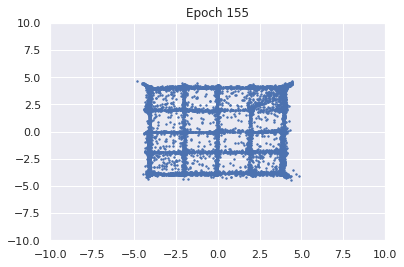

100%|██████████| 976/976 [00:11<00:00, 83.14it/s]


D loss : 1.3792, GP_loss : 0.0 G_loss : -0.7368, MI : 0.7764


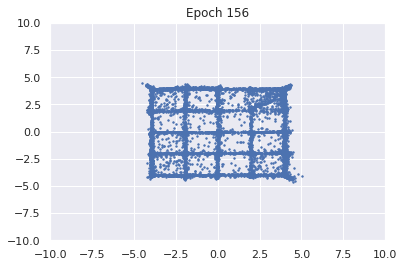

100%|██████████| 976/976 [00:11<00:00, 83.76it/s]


D loss : 1.3795, GP_loss : 0.0 G_loss : -0.7346, MI : 0.774


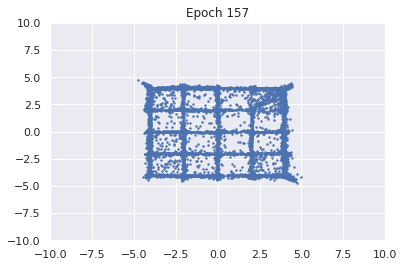

100%|██████████| 976/976 [00:15<00:00, 64.06it/s]


D loss : 1.3793, GP_loss : 0.0 G_loss : -0.7358, MI : 0.7763


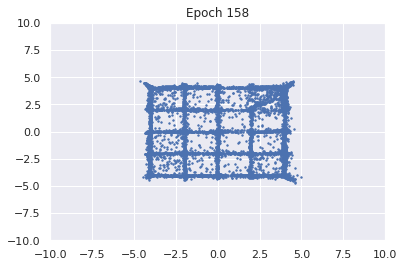

100%|██████████| 976/976 [00:12<00:00, 80.23it/s]


D loss : 1.3798, GP_loss : 0.0 G_loss : -0.733, MI : 0.7772


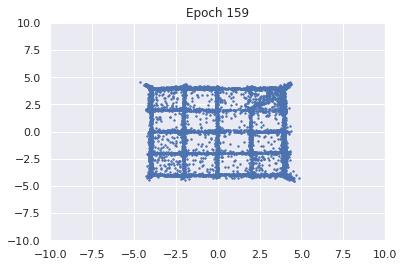

100%|██████████| 976/976 [00:14<00:00, 66.64it/s]


D loss : 1.38, GP_loss : 0.0 G_loss : -0.7316, MI : 0.7764


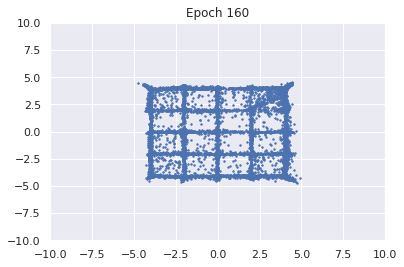

100%|██████████| 976/976 [00:14<00:00, 68.21it/s]


D loss : 1.3804, GP_loss : 0.0 G_loss : -0.7283, MI : 0.7811


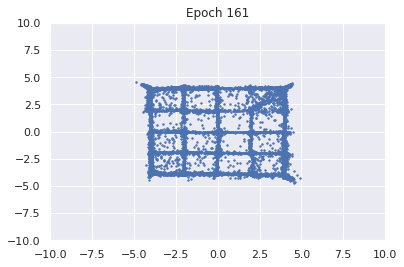

100%|██████████| 976/976 [00:14<00:00, 67.95it/s]


D loss : 1.38, GP_loss : 0.0 G_loss : -0.7313, MI : 0.7855


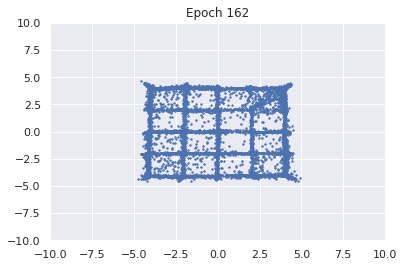

100%|██████████| 976/976 [00:14<00:00, 67.75it/s]


D loss : 1.3806, GP_loss : 0.0 G_loss : -0.7268, MI : 0.7763


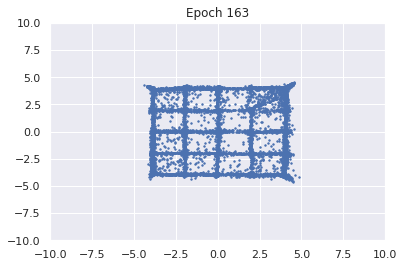

100%|██████████| 976/976 [00:14<00:00, 65.65it/s]


D loss : 1.38, GP_loss : 0.0 G_loss : -0.7328, MI : 0.7781


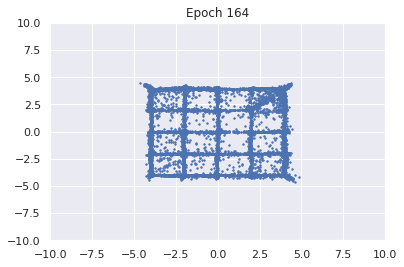

100%|██████████| 976/976 [00:12<00:00, 79.97it/s]


D loss : 1.3801, GP_loss : 0.0 G_loss : -0.7338, MI : 0.7812


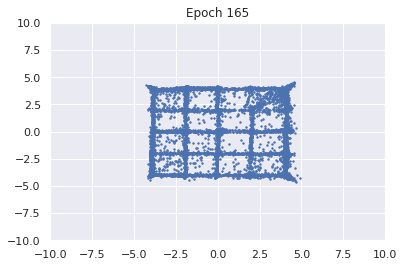

100%|██████████| 976/976 [00:12<00:00, 81.01it/s]


D loss : 1.3804, GP_loss : 0.0 G_loss : -0.729, MI : 0.7713


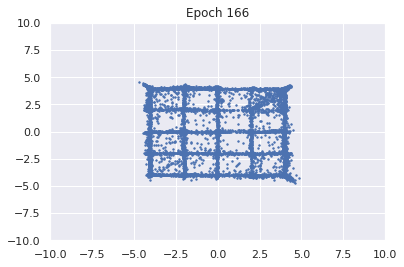

100%|██████████| 976/976 [00:11<00:00, 81.73it/s]


D loss : 1.3807, GP_loss : 0.0 G_loss : -0.7284, MI : 0.773


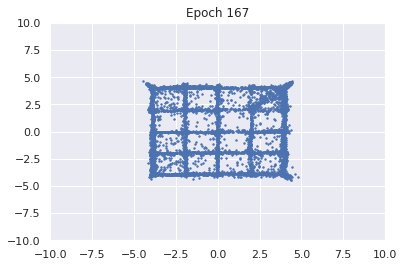

100%|██████████| 976/976 [00:13<00:00, 63.98it/s]


D loss : 1.3807, GP_loss : 0.0 G_loss : -0.7287, MI : 0.7763


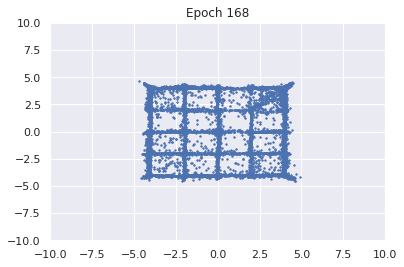

100%|██████████| 976/976 [00:12<00:00, 78.11it/s]


D loss : 1.3805, GP_loss : 0.0 G_loss : -0.7294, MI : 0.7756


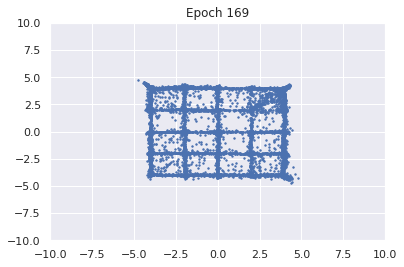

100%|██████████| 976/976 [00:13<00:00, 73.94it/s]


D loss : 1.3807, GP_loss : 0.0 G_loss : -0.7283, MI : 0.7851


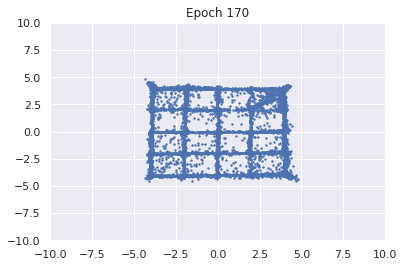

100%|██████████| 976/976 [00:12<00:00, 80.23it/s]


D loss : 1.3813, GP_loss : 0.0 G_loss : -0.7236, MI : 0.7877


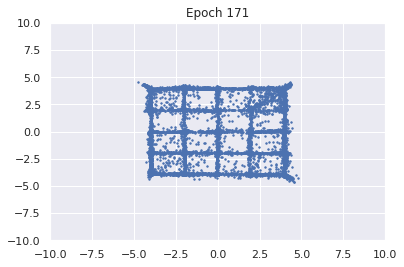

100%|██████████| 976/976 [00:12<00:00, 80.32it/s]


D loss : 1.3812, GP_loss : 0.0 G_loss : -0.7242, MI : 0.7857


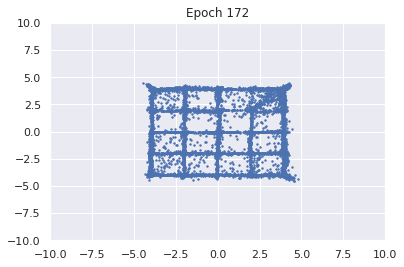

100%|██████████| 976/976 [00:14<00:00, 65.51it/s]


D loss : 1.3808, GP_loss : 0.0 G_loss : -0.728, MI : 0.7925


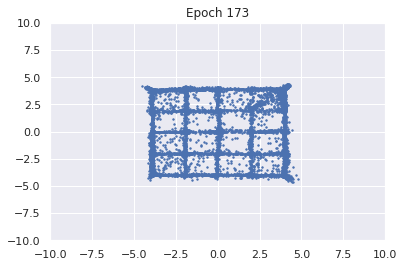

100%|██████████| 976/976 [00:12<00:00, 80.25it/s]


D loss : 1.3811, GP_loss : 0.0 G_loss : -0.7262, MI : 0.7865


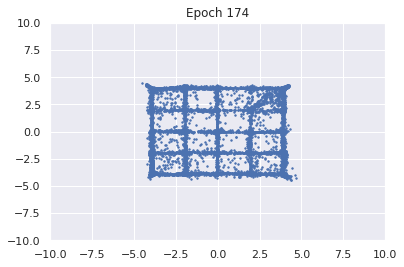

100%|██████████| 976/976 [00:13<00:00, 69.84it/s]


D loss : 1.3813, GP_loss : 0.0 G_loss : -0.7257, MI : 0.7835


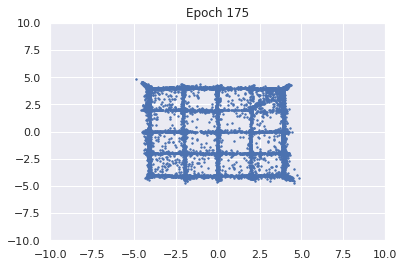

100%|██████████| 976/976 [00:12<00:00, 81.24it/s]


D loss : 1.3809, GP_loss : 0.0 G_loss : -0.7261, MI : 0.7815


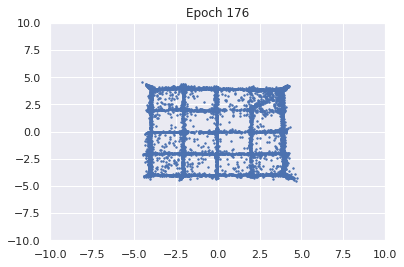

100%|██████████| 976/976 [00:13<00:00, 73.70it/s]


D loss : 1.3811, GP_loss : 0.0 G_loss : -0.7283, MI : 0.787


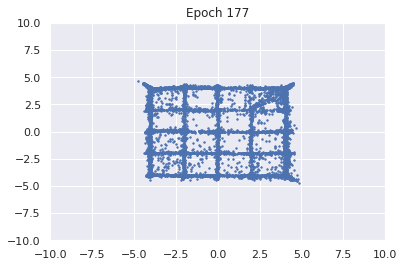

100%|██████████| 976/976 [00:15<00:00, 64.69it/s]


D loss : 1.3808, GP_loss : 0.0 G_loss : -0.729, MI : 0.7803


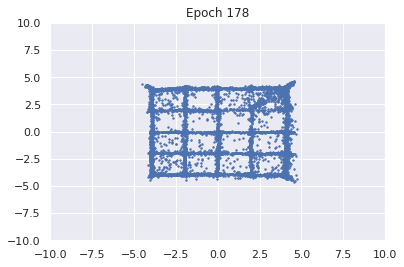

100%|██████████| 976/976 [00:13<00:00, 73.88it/s]


D loss : 1.3811, GP_loss : 0.0 G_loss : -0.7272, MI : 0.7819


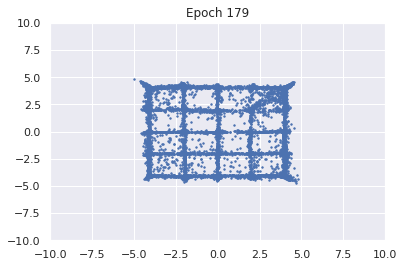

100%|██████████| 976/976 [00:12<00:00, 79.12it/s]


D loss : 1.3813, GP_loss : 0.0 G_loss : -0.7268, MI : 0.7817


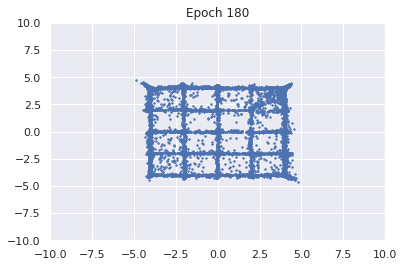

100%|██████████| 976/976 [00:11<00:00, 81.94it/s]


D loss : 1.3813, GP_loss : 0.0 G_loss : -0.7256, MI : 0.7828


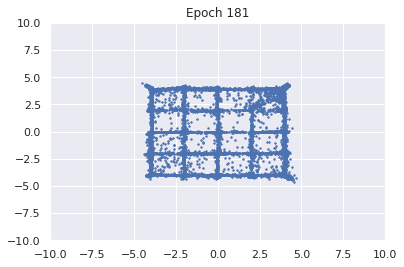

100%|██████████| 976/976 [00:11<00:00, 84.07it/s]


D loss : 1.3813, GP_loss : 0.0 G_loss : -0.7269, MI : 0.787


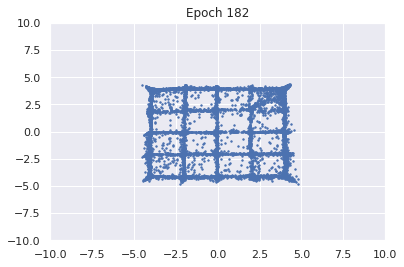

100%|██████████| 976/976 [00:11<00:00, 83.22it/s]


D loss : 1.3819, GP_loss : 0.0 G_loss : -0.7209, MI : 0.7923


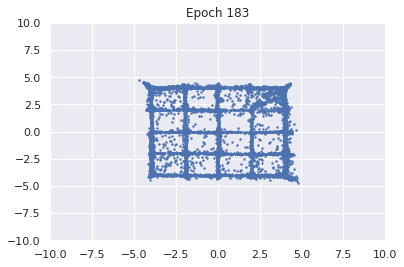

100%|██████████| 976/976 [00:11<00:00, 83.64it/s]


D loss : 1.3811, GP_loss : 0.0 G_loss : -0.7299, MI : 0.7856


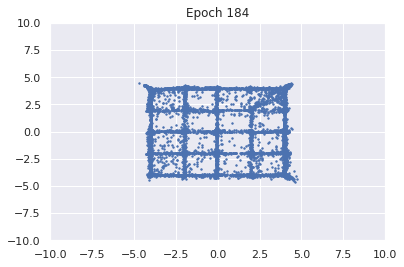

100%|██████████| 976/976 [00:11<00:00, 83.87it/s]


D loss : 1.3814, GP_loss : 0.0 G_loss : -0.7269, MI : 0.7863


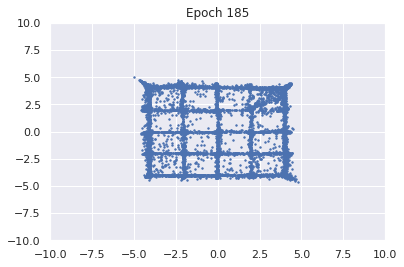

100%|██████████| 976/976 [00:11<00:00, 83.51it/s]


D loss : 1.3815, GP_loss : 0.0 G_loss : -0.7256, MI : 0.7829


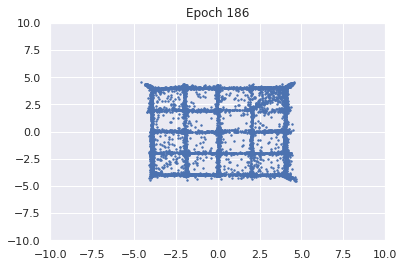

100%|██████████| 976/976 [00:11<00:00, 79.91it/s]


D loss : 1.3815, GP_loss : 0.0 G_loss : -0.7265, MI : 0.784


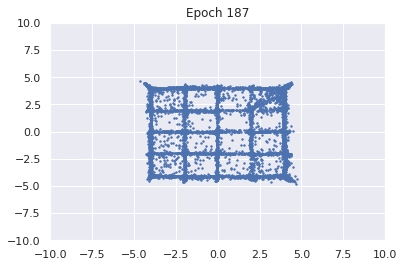

100%|██████████| 976/976 [00:11<00:00, 82.73it/s]


D loss : 1.3819, GP_loss : 0.0 G_loss : -0.7226, MI : 0.7874


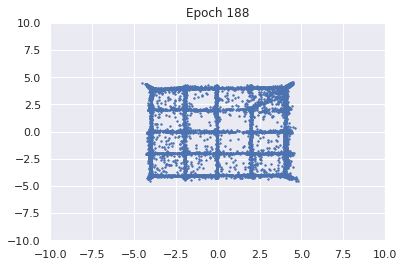

100%|██████████| 976/976 [00:12<00:00, 80.90it/s]


D loss : 1.382, GP_loss : 0.0 G_loss : -0.7224, MI : 0.7862


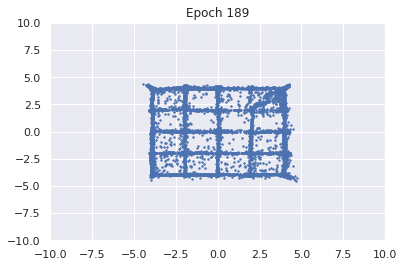

100%|██████████| 976/976 [00:11<00:00, 81.70it/s]


D loss : 1.3818, GP_loss : 0.0 G_loss : -0.7259, MI : 0.7875


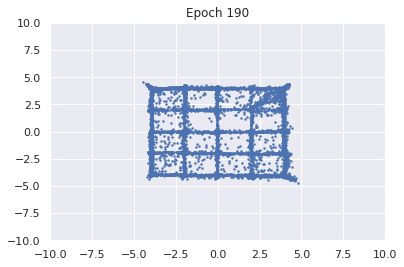

100%|██████████| 976/976 [00:12<00:00, 81.23it/s]


D loss : 1.3816, GP_loss : 0.0 G_loss : -0.7256, MI : 0.7894


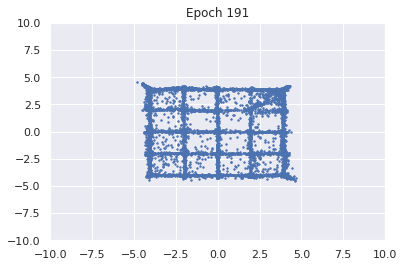

100%|██████████| 976/976 [00:11<00:00, 82.69it/s]


D loss : 1.3814, GP_loss : 0.0 G_loss : -0.7284, MI : 0.7912


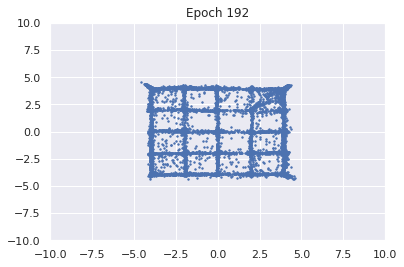

100%|██████████| 976/976 [00:11<00:00, 82.96it/s]


D loss : 1.3822, GP_loss : 0.0 G_loss : -0.7199, MI : 0.791


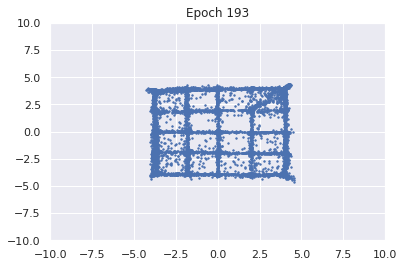

100%|██████████| 976/976 [00:12<00:00, 78.95it/s]


D loss : 1.3819, GP_loss : 0.0 G_loss : -0.7257, MI : 0.7839


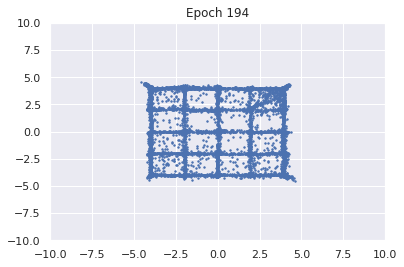

100%|██████████| 976/976 [00:15<00:00, 64.46it/s]


D loss : 1.3823, GP_loss : 0.0 G_loss : -0.7202, MI : 0.7846


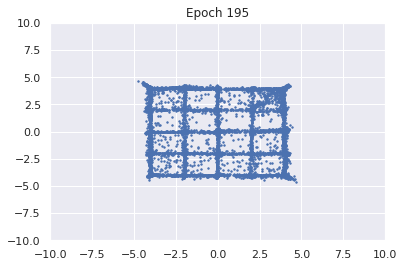

100%|██████████| 976/976 [00:14<00:00, 66.44it/s]


D loss : 1.382, GP_loss : 0.0 G_loss : -0.7231, MI : 0.7878


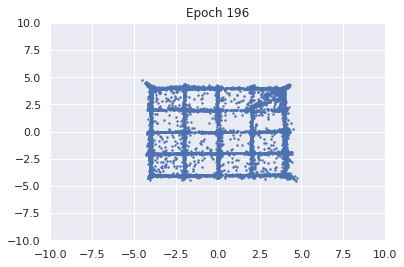

100%|██████████| 976/976 [00:11<00:00, 81.68it/s]


D loss : 1.382, GP_loss : 0.0 G_loss : -0.7242, MI : 0.784


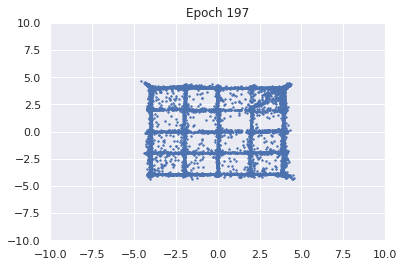

100%|██████████| 976/976 [00:12<00:00, 74.41it/s]


D loss : 1.3822, GP_loss : 0.0 G_loss : -0.7236, MI : 0.7854


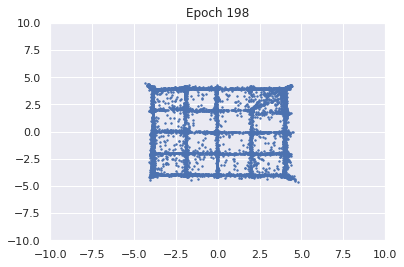

100%|██████████| 976/976 [00:11<00:00, 82.39it/s]


D loss : 1.382, GP_loss : 0.0 G_loss : -0.7235, MI : 0.7926


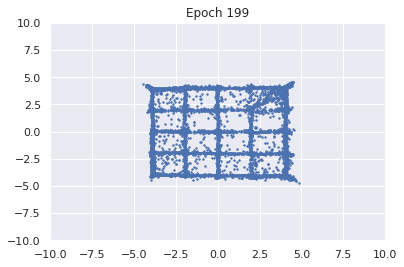

100%|██████████| 976/976 [00:13<00:00, 74.15it/s]


D loss : 1.3818, GP_loss : 0.0 G_loss : -0.7276, MI : 0.7814


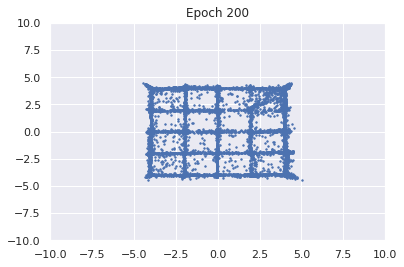

100%|██████████| 976/976 [00:15<00:00, 63.79it/s]


D loss : 1.3822, GP_loss : 0.0 G_loss : -0.7221, MI : 0.7906


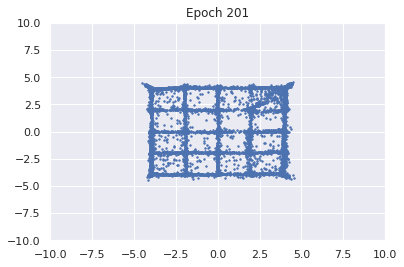

100%|██████████| 976/976 [00:12<00:00, 76.30it/s]


D loss : 1.3827, GP_loss : 0.0 G_loss : -0.7179, MI : 0.7831


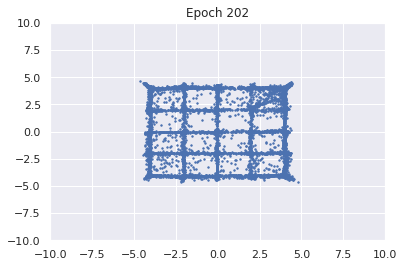

100%|██████████| 976/976 [00:11<00:00, 81.61it/s]


D loss : 1.3822, GP_loss : 0.0 G_loss : -0.7229, MI : 0.7845


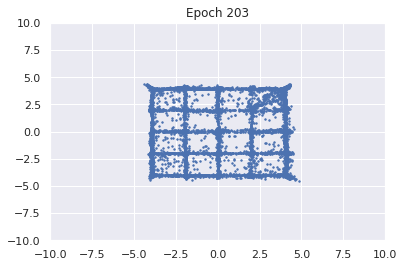

100%|██████████| 976/976 [00:12<00:00, 64.04it/s]


D loss : 1.3824, GP_loss : 0.0 G_loss : -0.7219, MI : 0.784


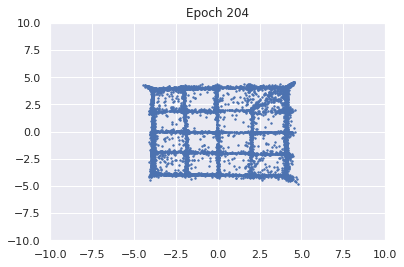

100%|██████████| 976/976 [00:13<00:00, 72.79it/s]


D loss : 1.3822, GP_loss : 0.0 G_loss : -0.724, MI : 0.7867


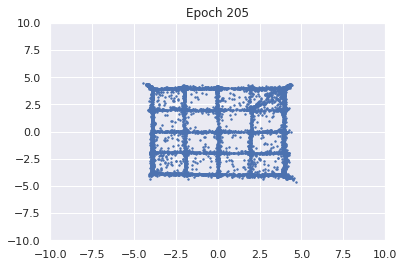

100%|██████████| 976/976 [00:12<00:00, 80.41it/s]


D loss : 1.3828, GP_loss : 0.0 G_loss : -0.7174, MI : 0.7852


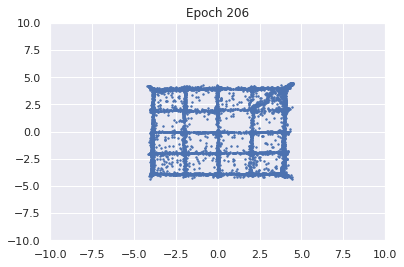

100%|██████████| 976/976 [00:09<00:00, 98.18it/s] 


D loss : 1.3829, GP_loss : 0.0 G_loss : -0.7155, MI : 0.7894


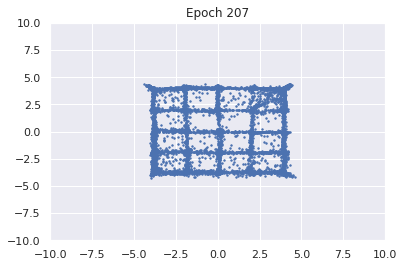

100%|██████████| 976/976 [00:09<00:00, 105.29it/s]


D loss : 1.3825, GP_loss : 0.0 G_loss : -0.719, MI : 0.7854


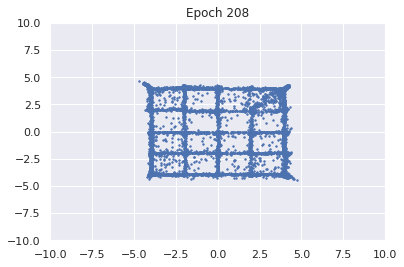

100%|██████████| 976/976 [00:09<00:00, 105.59it/s]


D loss : 1.3827, GP_loss : 0.0 G_loss : -0.7169, MI : 0.7906


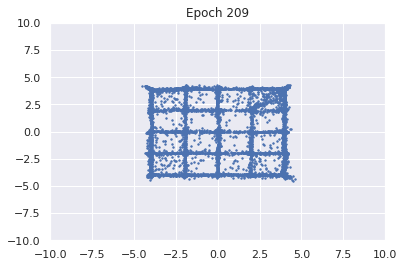

100%|██████████| 976/976 [00:11<00:00, 81.37it/s] 


D loss : 1.3824, GP_loss : 0.0 G_loss : -0.7238, MI : 0.7838


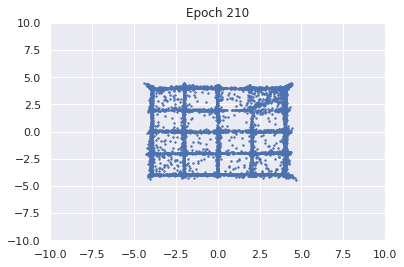

100%|██████████| 976/976 [00:11<00:00, 82.81it/s]


D loss : 1.3826, GP_loss : 0.0 G_loss : -0.7212, MI : 0.7804


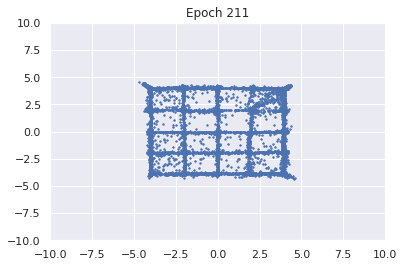

100%|██████████| 976/976 [00:12<00:00, 63.49it/s]


D loss : 1.3825, GP_loss : 0.0 G_loss : -0.7213, MI : 0.7888


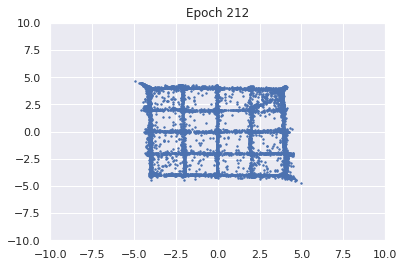

100%|██████████| 976/976 [00:11<00:00, 81.36it/s]


D loss : 1.3827, GP_loss : 0.0 G_loss : -0.7201, MI : 0.778


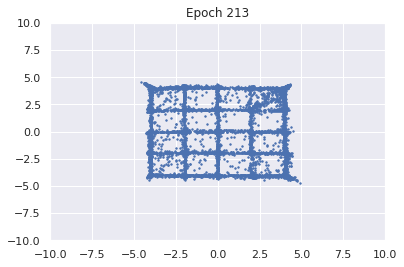

100%|██████████| 976/976 [00:12<00:00, 81.32it/s]


D loss : 1.3825, GP_loss : 0.0 G_loss : -0.7231, MI : 0.7875


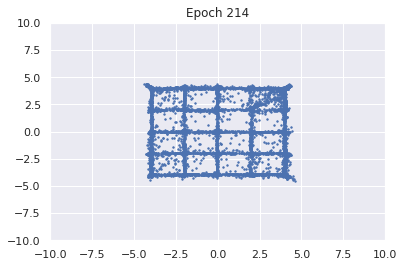

100%|██████████| 976/976 [00:14<00:00, 67.39it/s]


D loss : 1.3825, GP_loss : 0.0 G_loss : -0.7215, MI : 0.7834


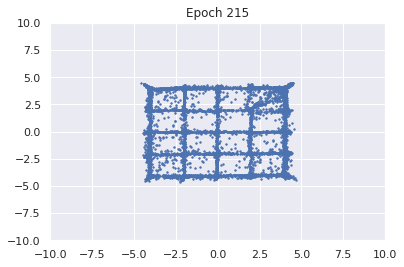

100%|██████████| 976/976 [00:12<00:00, 80.27it/s]


D loss : 1.3828, GP_loss : 0.0 G_loss : -0.72, MI : 0.7813


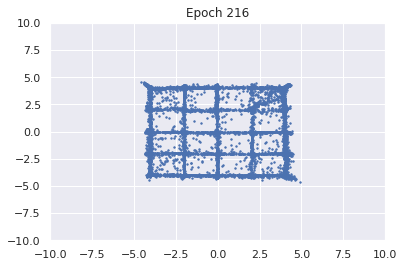

100%|██████████| 976/976 [00:14<00:00, 62.83it/s]


D loss : 1.3829, GP_loss : 0.0 G_loss : -0.7187, MI : 0.7814


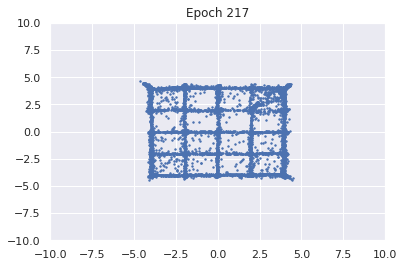

100%|██████████| 976/976 [00:12<00:00, 81.59it/s]


D loss : 1.3826, GP_loss : 0.0 G_loss : -0.7208, MI : 0.778


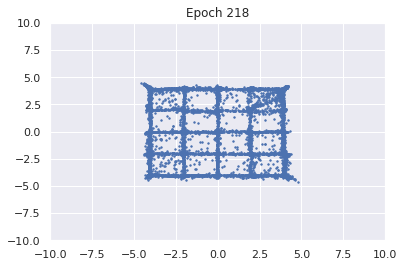

100%|██████████| 976/976 [00:13<00:00, 74.60it/s]


D loss : 1.3826, GP_loss : 0.0 G_loss : -0.721, MI : 0.7804


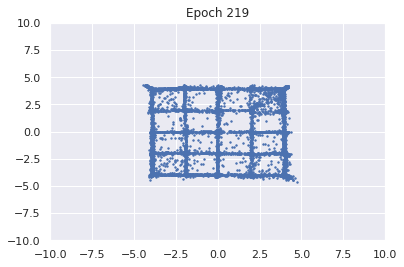

100%|██████████| 976/976 [00:14<00:00, 67.88it/s]


D loss : 1.3828, GP_loss : 0.0 G_loss : -0.7195, MI : 0.7789


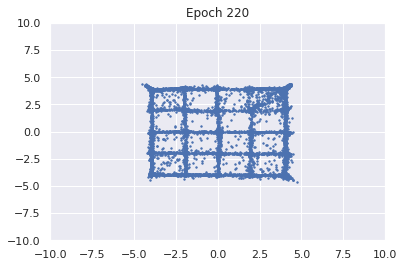

100%|██████████| 976/976 [00:14<00:00, 68.20it/s]


D loss : 1.3828, GP_loss : 0.0 G_loss : -0.719, MI : 0.7848


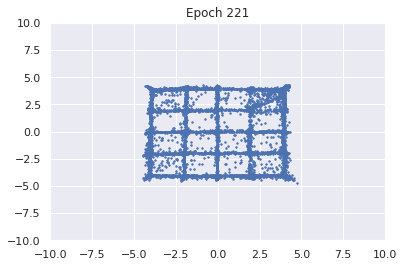

100%|██████████| 976/976 [00:14<00:00, 66.68it/s]


D loss : 1.3826, GP_loss : 0.0 G_loss : -0.7214, MI : 0.7831


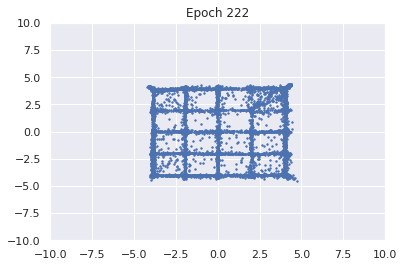

100%|██████████| 976/976 [00:14<00:00, 69.35it/s]


D loss : 1.3828, GP_loss : 0.0 G_loss : -0.7208, MI : 0.7793


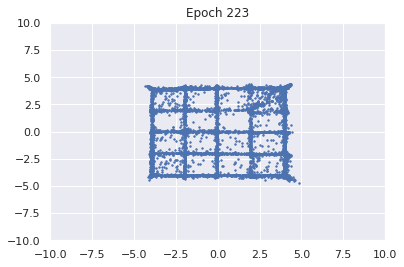

100%|██████████| 976/976 [00:12<00:00, 80.10it/s]


D loss : 1.383, GP_loss : 0.0 G_loss : -0.7197, MI : 0.777


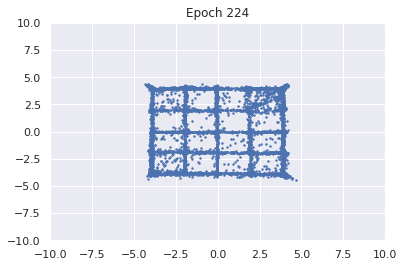

100%|██████████| 976/976 [00:13<00:00, 73.14it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7146, MI : 0.7813


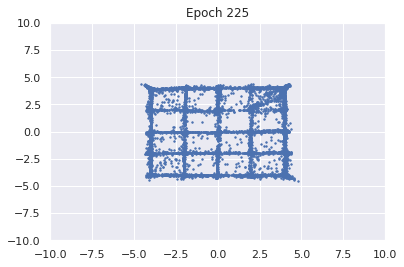

100%|██████████| 976/976 [00:14<00:00, 66.36it/s]


D loss : 1.3829, GP_loss : 0.0 G_loss : -0.7186, MI : 0.7784


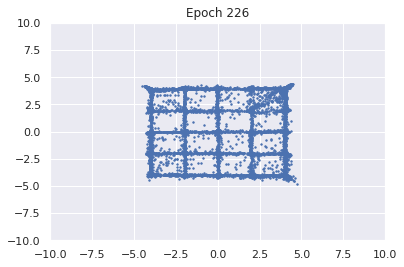

100%|██████████| 976/976 [00:15<00:00, 63.44it/s]


D loss : 1.383, GP_loss : 0.0 G_loss : -0.7185, MI : 0.7775


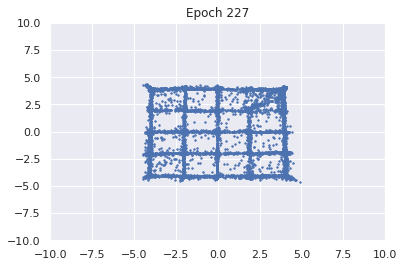

100%|██████████| 976/976 [00:14<00:00, 68.21it/s]


D loss : 1.3831, GP_loss : 0.0 G_loss : -0.7157, MI : 0.7783


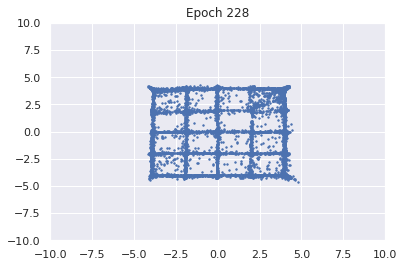

100%|██████████| 976/976 [00:12<00:00, 80.13it/s]


D loss : 1.383, GP_loss : 0.0 G_loss : -0.7183, MI : 0.7789


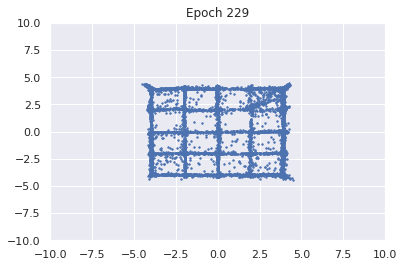

100%|██████████| 976/976 [00:11<00:00, 83.20it/s]


D loss : 1.3829, GP_loss : 0.0 G_loss : -0.7188, MI : 0.778


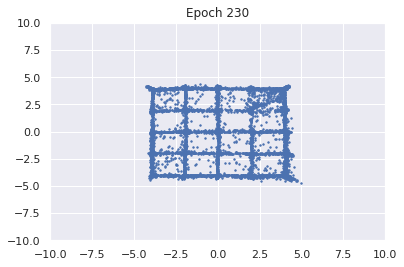

100%|██████████| 976/976 [00:11<00:00, 82.97it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7144, MI : 0.7756


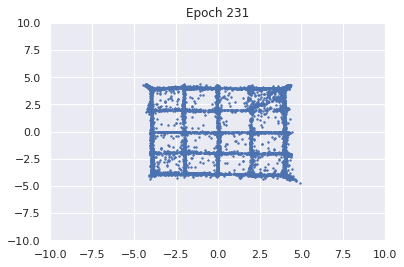

100%|██████████| 976/976 [00:12<00:00, 80.47it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7175, MI : 0.7829


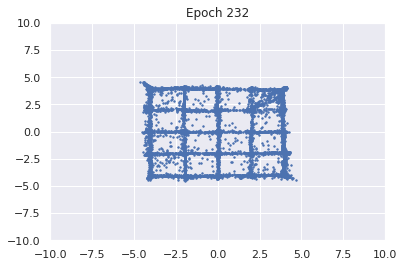

100%|██████████| 976/976 [00:12<00:00, 81.25it/s]


D loss : 1.3833, GP_loss : 0.0 G_loss : -0.716, MI : 0.7836


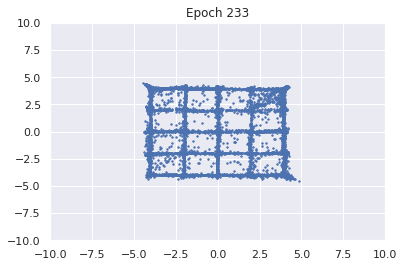

100%|██████████| 976/976 [00:14<00:00, 67.70it/s]


D loss : 1.3833, GP_loss : 0.0 G_loss : -0.7152, MI : 0.7802


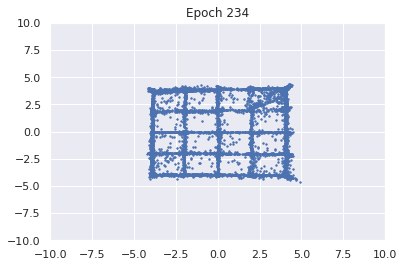

100%|██████████| 976/976 [00:11<00:00, 81.80it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7158, MI : 0.7802


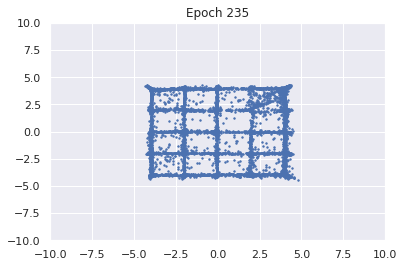

100%|██████████| 976/976 [00:13<00:00, 67.98it/s]


D loss : 1.383, GP_loss : 0.0 G_loss : -0.7218, MI : 0.7842


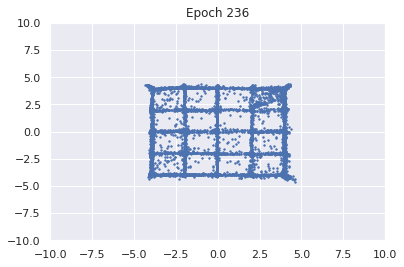

100%|██████████| 976/976 [00:14<00:00, 66.51it/s]


D loss : 1.3833, GP_loss : 0.0 G_loss : -0.7183, MI : 0.7747


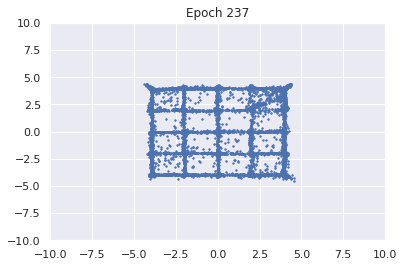

100%|██████████| 976/976 [00:14<00:00, 67.50it/s]


D loss : 1.3831, GP_loss : 0.0 G_loss : -0.7206, MI : 0.7783


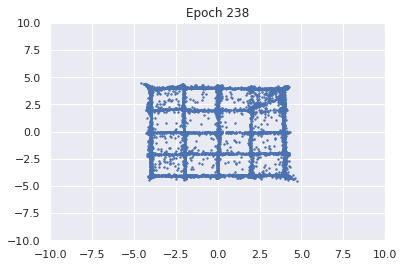

100%|██████████| 976/976 [00:14<00:00, 68.23it/s]


D loss : 1.383, GP_loss : 0.0 G_loss : -0.7208, MI : 0.782


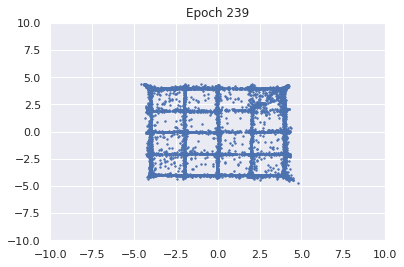

100%|██████████| 976/976 [00:11<00:00, 82.89it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7184, MI : 0.7834


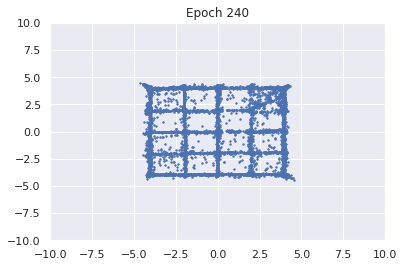

100%|██████████| 976/976 [00:11<00:00, 82.42it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7137, MI : 0.778


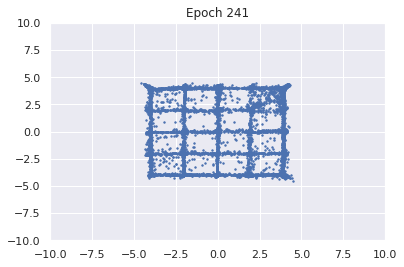

100%|██████████| 976/976 [00:12<00:00, 78.71it/s]


D loss : 1.3831, GP_loss : 0.0 G_loss : -0.7187, MI : 0.7811


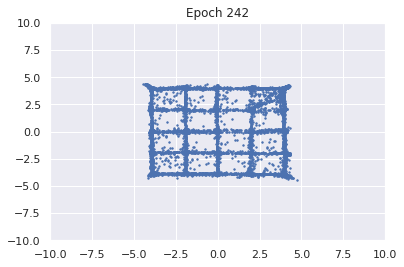

100%|██████████| 976/976 [00:12<00:00, 76.12it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7189, MI : 0.7789


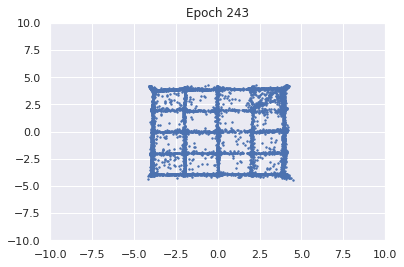

100%|██████████| 976/976 [00:14<00:00, 67.55it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7185, MI : 0.7836


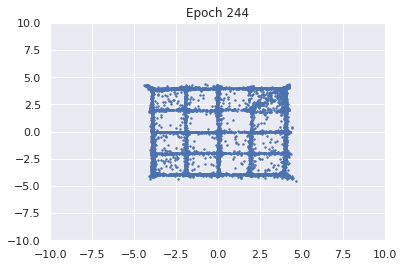

100%|██████████| 976/976 [00:14<00:00, 68.48it/s]


D loss : 1.3833, GP_loss : 0.0 G_loss : -0.7185, MI : 0.7959


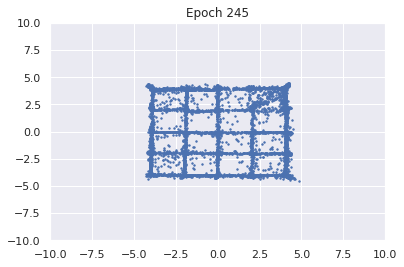

100%|██████████| 976/976 [00:14<00:00, 67.49it/s]


D loss : 1.3833, GP_loss : 0.0 G_loss : -0.7179, MI : 0.7853


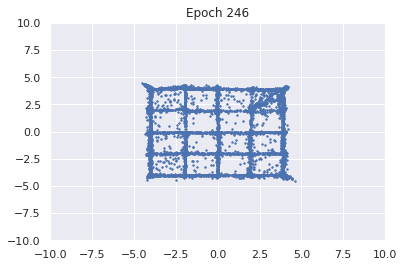

100%|██████████| 976/976 [00:13<00:00, 70.19it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7131, MI : 0.7767


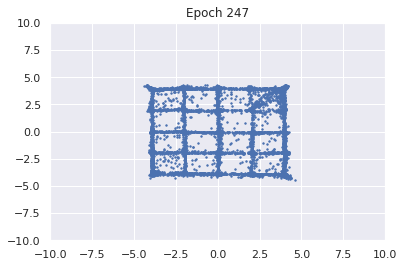

100%|██████████| 976/976 [00:14<00:00, 68.37it/s]


D loss : 1.3835, GP_loss : 0.0 G_loss : -0.7166, MI : 0.7737


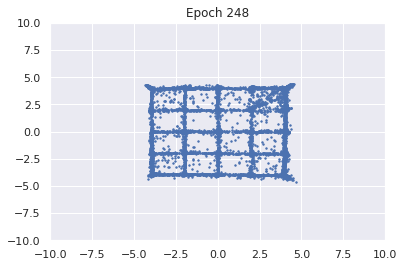

100%|██████████| 976/976 [00:14<00:00, 68.24it/s]


D loss : 1.3831, GP_loss : 0.0 G_loss : -0.7208, MI : 0.7736


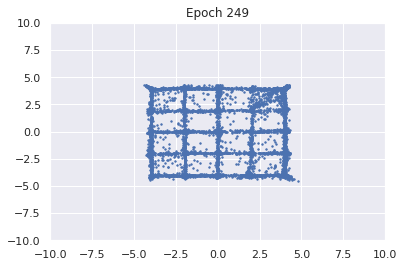

100%|██████████| 976/976 [00:13<00:00, 73.27it/s]


D loss : 1.3833, GP_loss : 0.0 G_loss : -0.7165, MI : 0.7773


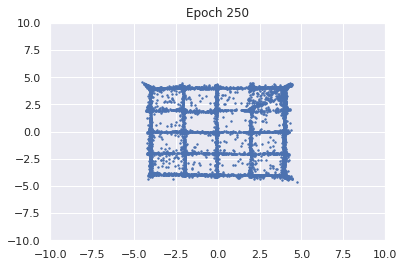

100%|██████████| 976/976 [00:11<00:00, 84.51it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.722, MI : 0.7771


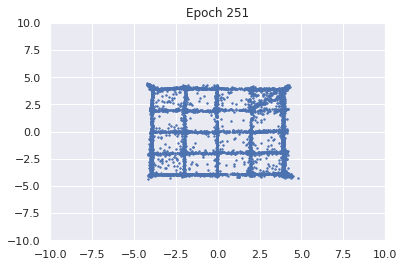

100%|██████████| 976/976 [00:11<00:00, 85.59it/s]


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7203, MI : 0.7858


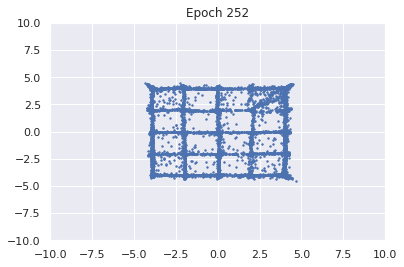

100%|██████████| 976/976 [00:11<00:00, 76.29it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7162, MI : 0.7842


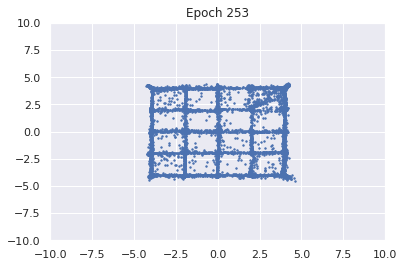

100%|██████████| 976/976 [00:11<00:00, 83.42it/s]


D loss : 1.3834, GP_loss : 0.0 G_loss : -0.7176, MI : 0.7811


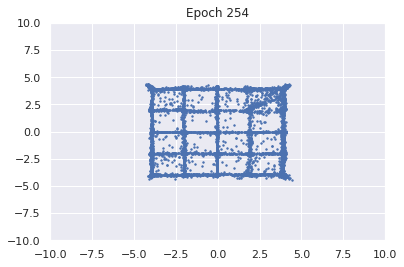

100%|██████████| 976/976 [00:11<00:00, 83.54it/s] 


D loss : 1.3832, GP_loss : 0.0 G_loss : -0.7178, MI : 0.7822


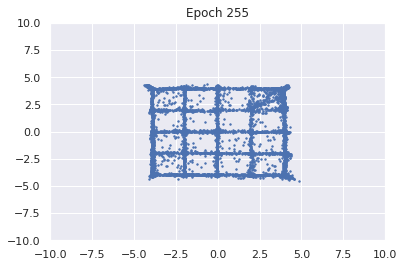

100%|██████████| 976/976 [00:09<00:00, 101.45it/s]


D loss : 1.3834, GP_loss : 0.0 G_loss : -0.7168, MI : 0.7852


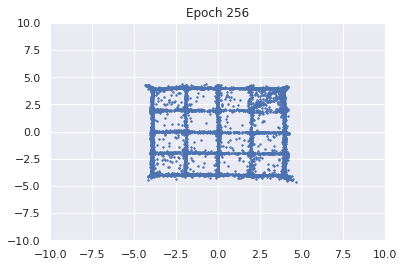

100%|██████████| 976/976 [00:09<00:00, 105.21it/s]


D loss : 1.3835, GP_loss : 0.0 G_loss : -0.7153, MI : 0.7834


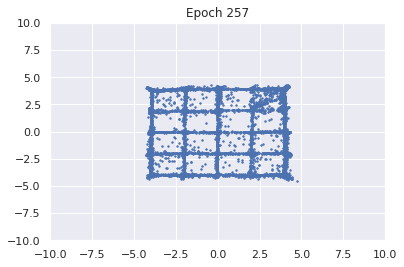

100%|██████████| 976/976 [00:09<00:00, 104.83it/s]


D loss : 1.384, GP_loss : 0.0 G_loss : -0.7107, MI : 0.7882


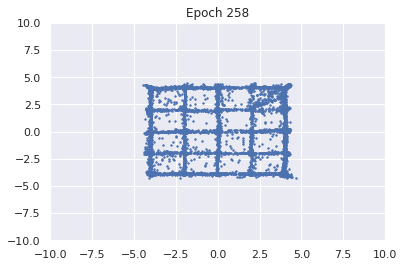

100%|██████████| 976/976 [00:13<00:00, 70.18it/s]


D loss : 1.3838, GP_loss : 0.0 G_loss : -0.7088, MI : 0.7888


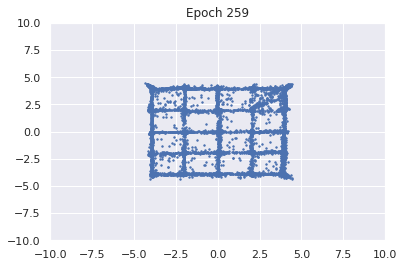

100%|██████████| 976/976 [00:14<00:00, 68.39it/s]


D loss : 1.3835, GP_loss : 0.0 G_loss : -0.7168, MI : 0.7821


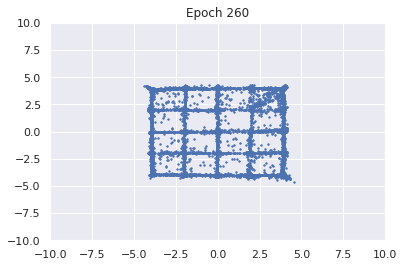

100%|██████████| 976/976 [00:14<00:00, 68.23it/s]


D loss : 1.3834, GP_loss : 0.0 G_loss : -0.7185, MI : 0.7846


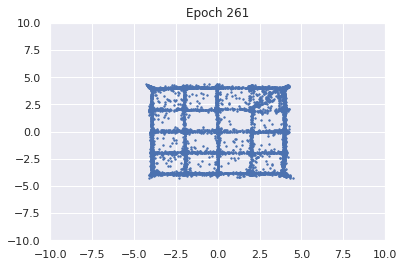

100%|██████████| 976/976 [00:14<00:00, 65.97it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7146, MI : 0.7825


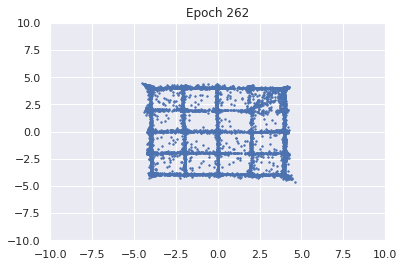

100%|██████████| 976/976 [00:14<00:00, 65.99it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7161, MI : 0.7831


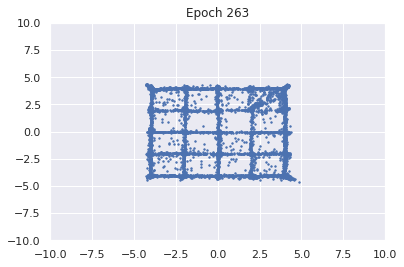

100%|██████████| 976/976 [00:14<00:00, 68.20it/s]


D loss : 1.3838, GP_loss : 0.0 G_loss : -0.7129, MI : 0.7865


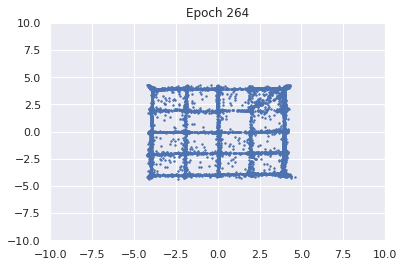

100%|██████████| 976/976 [00:11<00:00, 82.37it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7156, MI : 0.783


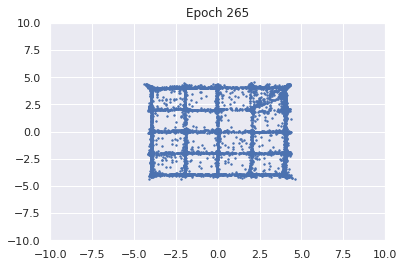

100%|██████████| 976/976 [00:11<00:00, 82.32it/s]


D loss : 1.3835, GP_loss : 0.0 G_loss : -0.7175, MI : 0.7793


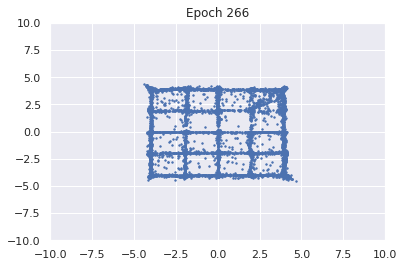

100%|██████████| 976/976 [00:13<00:00, 74.58it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7181, MI : 0.7802


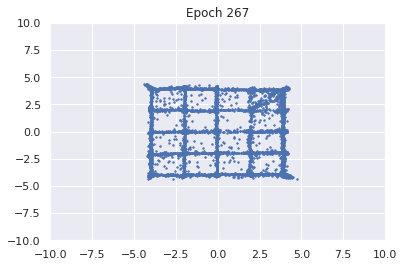

100%|██████████| 976/976 [00:15<00:00, 64.32it/s]


D loss : 1.3835, GP_loss : 0.0 G_loss : -0.7159, MI : 0.7851


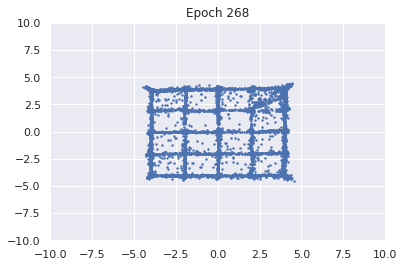

100%|██████████| 976/976 [00:14<00:00, 68.04it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7173, MI : 0.7866


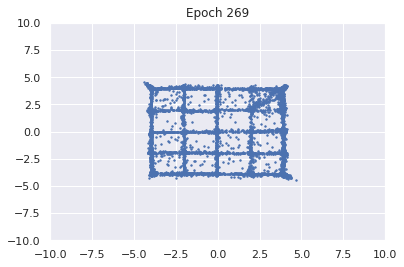

100%|██████████| 976/976 [00:11<00:00, 81.37it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.716, MI : 0.7838


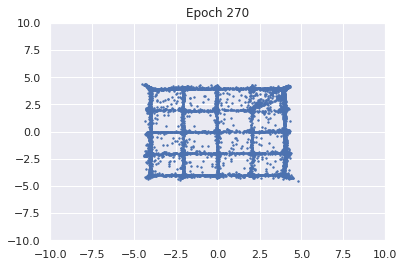

100%|██████████| 976/976 [00:12<00:00, 80.12it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7161, MI : 0.7848


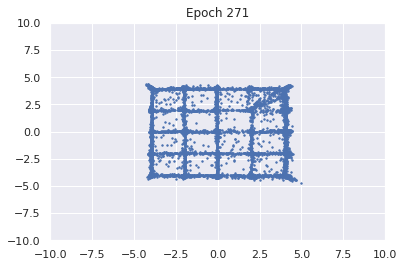

100%|██████████| 976/976 [00:11<00:00, 81.43it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7172, MI : 0.7815


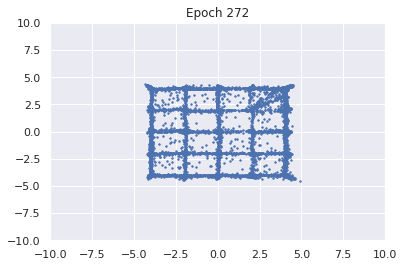

100%|██████████| 976/976 [00:12<00:00, 81.16it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.7145, MI : 0.787


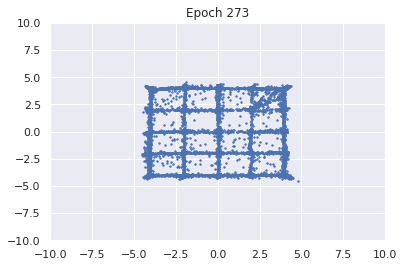

100%|██████████| 976/976 [00:13<00:00, 71.23it/s]


D loss : 1.3838, GP_loss : 0.0 G_loss : -0.7147, MI : 0.7861


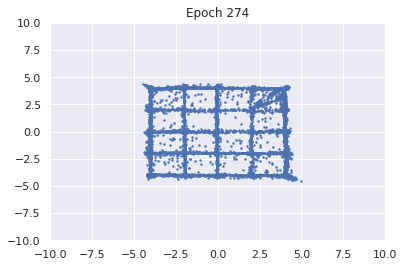

100%|██████████| 976/976 [00:12<00:00, 79.08it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7165, MI : 0.786


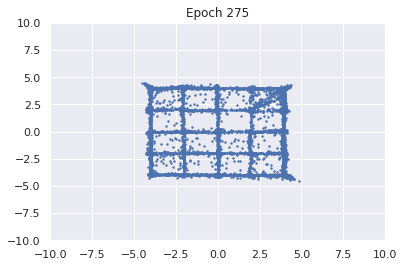

100%|██████████| 976/976 [00:13<00:00, 70.45it/s]


D loss : 1.3836, GP_loss : 0.0 G_loss : -0.7148, MI : 0.7807


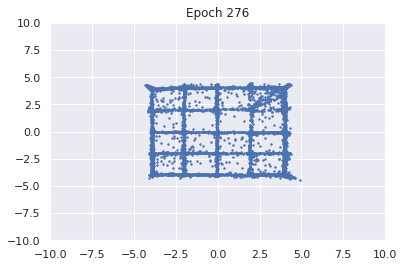

100%|██████████| 976/976 [00:12<00:00, 81.26it/s]


D loss : 1.3838, GP_loss : 0.0 G_loss : -0.7136, MI : 0.7829


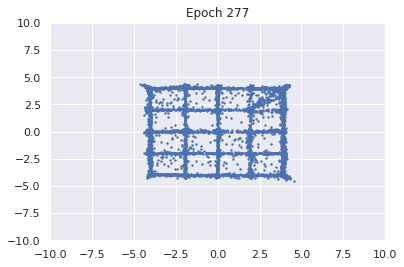

100%|██████████| 976/976 [00:13<00:00, 72.42it/s]


D loss : 1.3838, GP_loss : 0.0 G_loss : -0.7154, MI : 0.7851


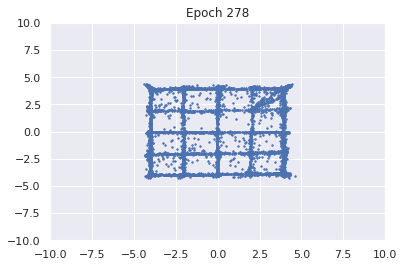

100%|██████████| 976/976 [00:14<00:00, 69.83it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.714, MI : 0.7893


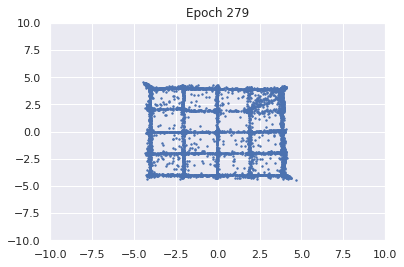

100%|██████████| 976/976 [00:15<00:00, 64.27it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.717, MI : 0.7863


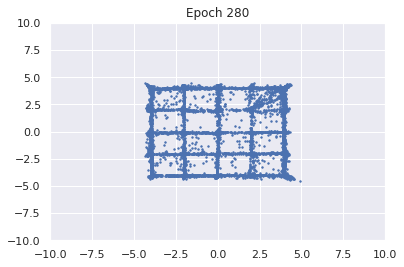

100%|██████████| 976/976 [00:11<00:00, 85.62it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.715, MI : 0.7913


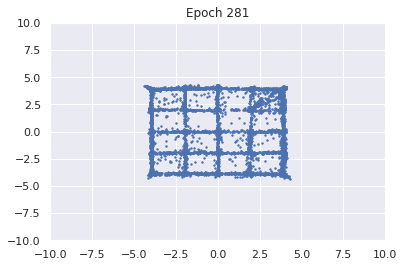

100%|██████████| 976/976 [00:11<00:00, 84.88it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.7135, MI : 0.7834


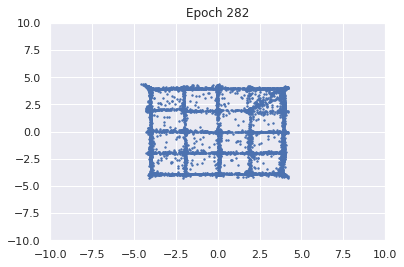

100%|██████████| 976/976 [00:11<00:00, 83.40it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7168, MI : 0.7904


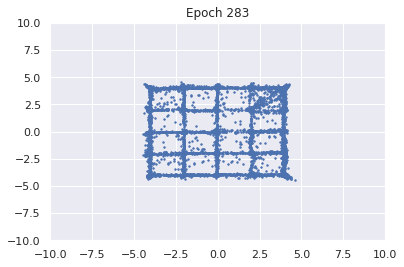

100%|██████████| 976/976 [00:11<00:00, 83.36it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7168, MI : 0.7865


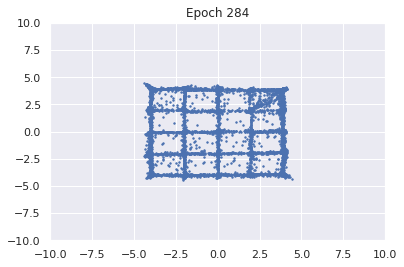

100%|██████████| 976/976 [00:13<00:00, 71.30it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7155, MI : 0.791


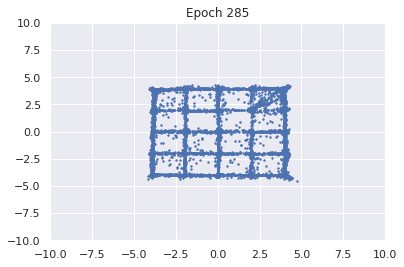

100%|██████████| 976/976 [00:12<00:00, 63.90it/s]


D loss : 1.3841, GP_loss : 0.0 G_loss : -0.7113, MI : 0.7862


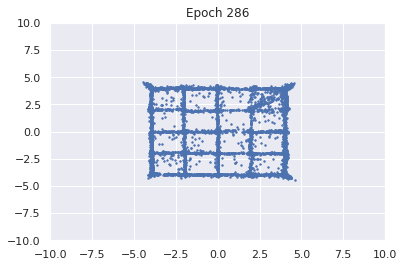

100%|██████████| 976/976 [00:11<00:00, 82.68it/s]


D loss : 1.3842, GP_loss : 0.0 G_loss : -0.7063, MI : 0.7909


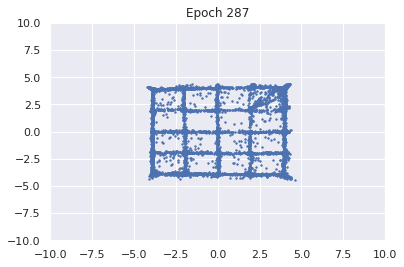

100%|██████████| 976/976 [00:11<00:00, 81.72it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.7143, MI : 0.7952


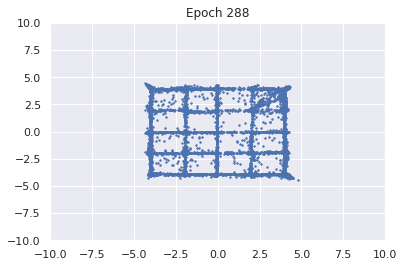

100%|██████████| 976/976 [00:11<00:00, 83.48it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.7145, MI : 0.7951


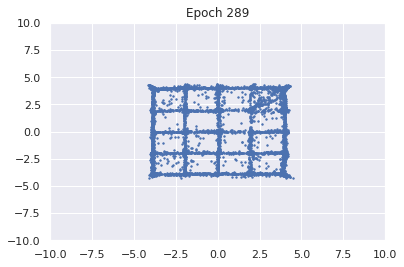

100%|██████████| 976/976 [00:11<00:00, 83.81it/s]


D loss : 1.384, GP_loss : 0.0 G_loss : -0.7141, MI : 0.7899


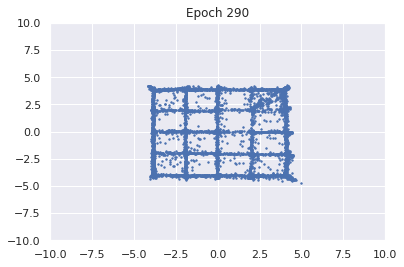

100%|██████████| 976/976 [00:11<00:00, 84.35it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.7139, MI : 0.7918


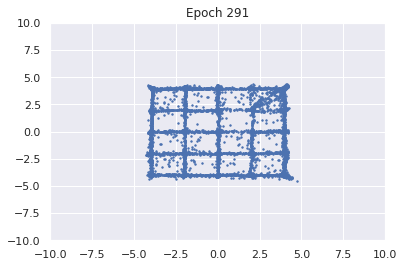

100%|██████████| 976/976 [00:11<00:00, 83.22it/s]


D loss : 1.3841, GP_loss : 0.0 G_loss : -0.712, MI : 0.7911


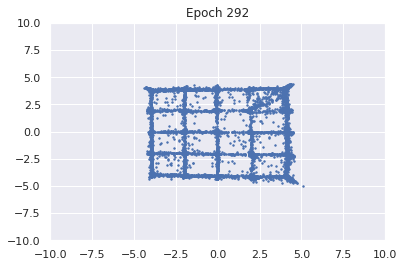

100%|██████████| 976/976 [00:11<00:00, 84.13it/s]


D loss : 1.3837, GP_loss : 0.0 G_loss : -0.7168, MI : 0.794


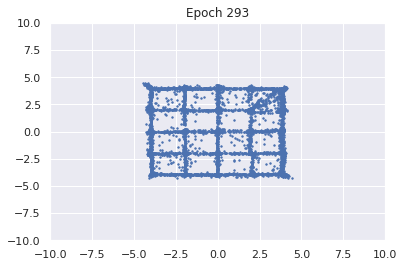

100%|██████████| 976/976 [00:11<00:00, 81.75it/s]


D loss : 1.3841, GP_loss : 0.0 G_loss : -0.7079, MI : 0.7994


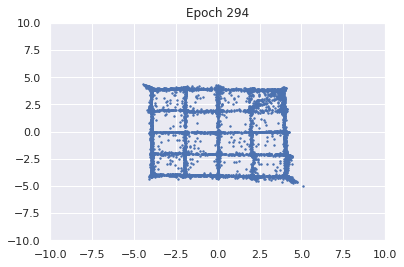

100%|██████████| 976/976 [00:11<00:00, 83.92it/s]


D loss : 1.3842, GP_loss : 0.0 G_loss : -0.7097, MI : 0.791


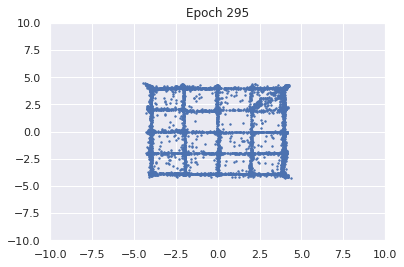

100%|██████████| 976/976 [00:11<00:00, 84.15it/s]


D loss : 1.384, GP_loss : 0.0 G_loss : -0.7142, MI : 0.7921


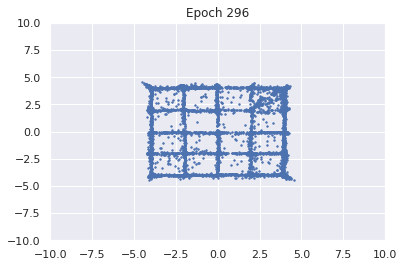

100%|██████████| 976/976 [00:11<00:00, 82.90it/s]


D loss : 1.3841, GP_loss : 0.0 G_loss : -0.7153, MI : 0.7917


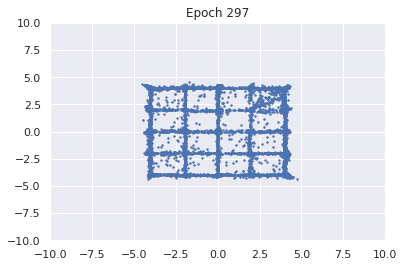

100%|██████████| 976/976 [00:11<00:00, 83.85it/s]


D loss : 1.3841, GP_loss : 0.0 G_loss : -0.7129, MI : 0.7853


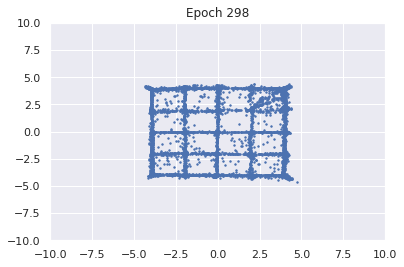

100%|██████████| 976/976 [00:11<00:00, 83.99it/s]


D loss : 1.3843, GP_loss : 0.0 G_loss : -0.7066, MI : 0.794


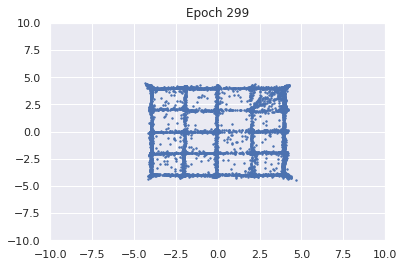

100%|██████████| 976/976 [00:11<00:00, 83.77it/s]


D loss : 1.3839, GP_loss : 0.0 G_loss : -0.7157, MI : 0.7987


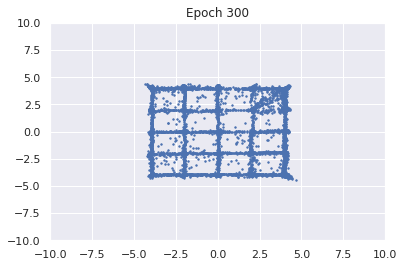

In [14]:
# non MI augmented GAN
G = Generator()
G_ma = Generator()
D = Discriminator()
M = Mine()

if USE_GPU:
    G, G_ma, D, M = G.cuda(), G_ma.cuda(), D.cuda(), M.cuda()

G_ma.load_state_dict(G.state_dict())

G_opt = torch.optim.Adam(G.parameters(), lr=2e-4)
D_opt = torch.optim.Adam(D.parameters(), lr=2e-4)
M_opt = torch.optim.Adam(M.parameters(), lr=2e-4)

train(is_zero_gp=True, is_mi_obj=False)

100%|██████████| 976/976 [00:09<00:00, 99.55it/s] 


D loss : 1.278, GP_loss : 0.0 G_loss : -0.7074, MI : 0.4592


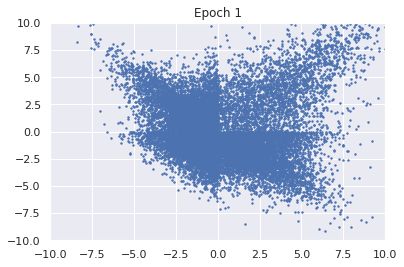

100%|██████████| 976/976 [00:09<00:00, 99.06it/s] 


D loss : 1.2968, GP_loss : 0.0 G_loss : -0.7432, MI : 0.3715


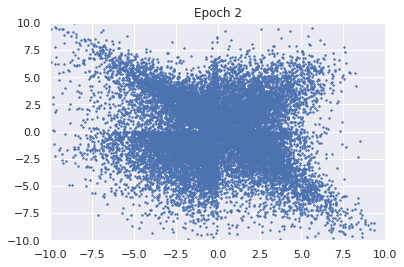

100%|██████████| 976/976 [00:12<00:00, 79.83it/s]


D loss : 1.2845, GP_loss : 0.0 G_loss : -0.7542, MI : 0.3325


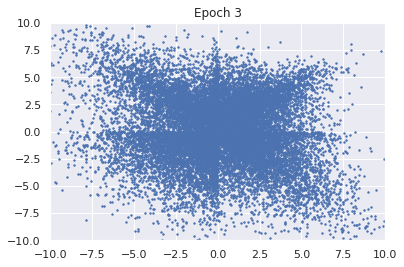

100%|██████████| 976/976 [00:10<00:00, 97.29it/s] 


D loss : 1.2745, GP_loss : 0.0 G_loss : -0.7538, MI : 0.3261


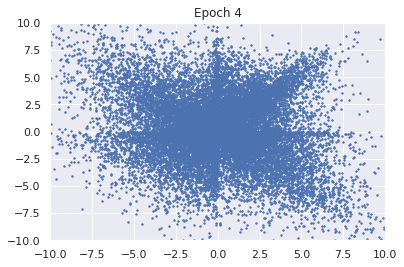

100%|██████████| 976/976 [00:13<00:00, 75.05it/s]


D loss : 1.2663, GP_loss : 0.0 G_loss : -0.7563, MI : 0.3563


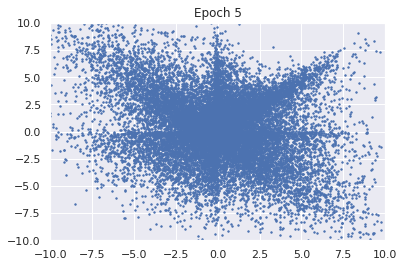

100%|██████████| 976/976 [00:12<00:00, 80.36it/s]


D loss : 1.259, GP_loss : 0.0 G_loss : -0.7517, MI : 0.3617


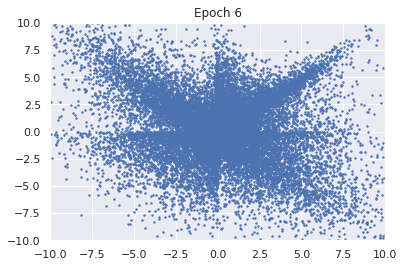

100%|██████████| 976/976 [00:10<00:00, 94.02it/s]


D loss : 1.2536, GP_loss : 0.0 G_loss : -0.7478, MI : 0.3977


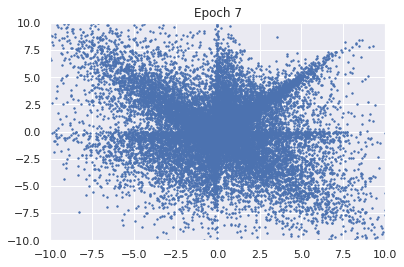

100%|██████████| 976/976 [00:10<00:00, 92.44it/s]


D loss : 1.2476, GP_loss : 0.0 G_loss : -0.7456, MI : 0.41


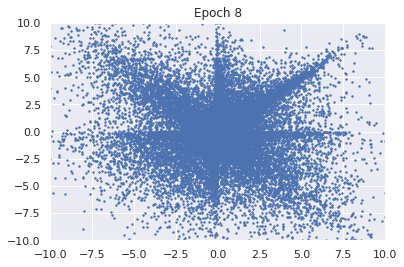

100%|██████████| 976/976 [00:09<00:00, 97.62it/s]


D loss : 1.2393, GP_loss : 0.0 G_loss : -0.7434, MI : 0.4125


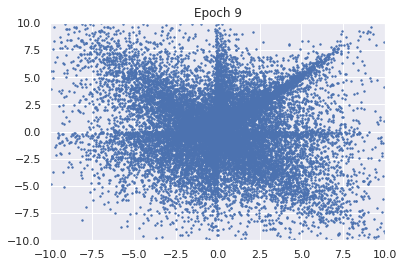

100%|██████████| 976/976 [00:09<00:00, 97.61it/s] 


D loss : 1.2302, GP_loss : 0.0 G_loss : -0.7415, MI : 0.4252


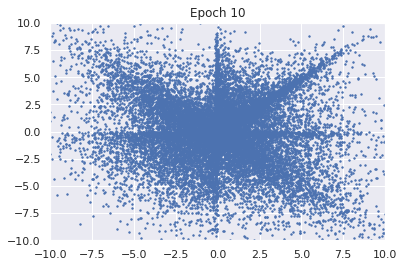

100%|██████████| 976/976 [00:10<00:00, 93.22it/s]


D loss : 1.218, GP_loss : 0.0 G_loss : -0.7436, MI : 0.4484


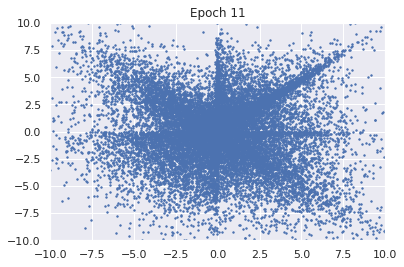

100%|██████████| 976/976 [00:10<00:00, 92.46it/s]


D loss : 1.203, GP_loss : 0.0 G_loss : -0.7457, MI : 0.4519


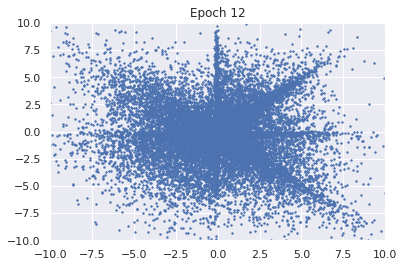

100%|██████████| 976/976 [00:10<00:00, 91.00it/s]


D loss : 1.1917, GP_loss : 0.0 G_loss : -0.7494, MI : 0.4639


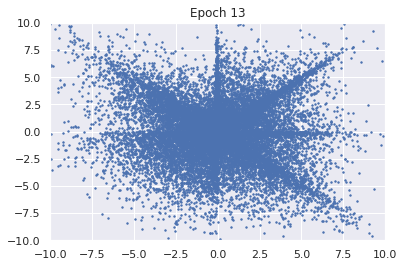

100%|██████████| 976/976 [00:10<00:00, 91.57it/s]


D loss : 1.1794, GP_loss : 0.0 G_loss : -0.7555, MI : 0.4757


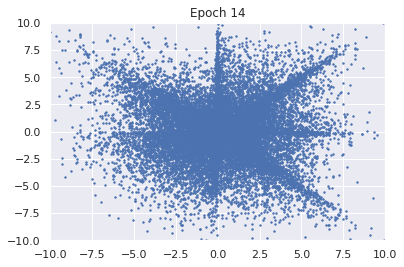

100%|██████████| 976/976 [00:10<00:00, 92.83it/s]


D loss : 1.1701, GP_loss : 0.0 G_loss : -0.7527, MI : 0.5003


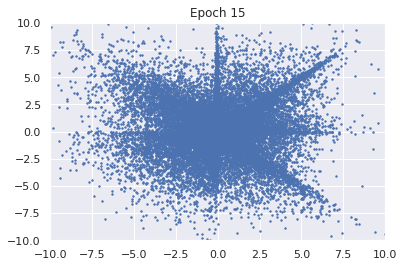

100%|██████████| 976/976 [00:10<00:00, 90.61it/s]


D loss : 1.1613, GP_loss : 0.0 G_loss : -0.7496, MI : 0.5072


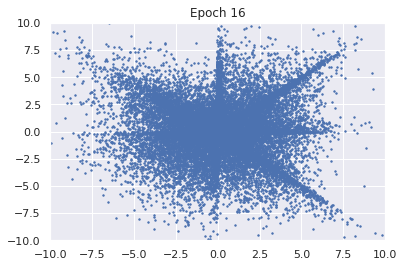

100%|██████████| 976/976 [00:10<00:00, 93.05it/s]


D loss : 1.1517, GP_loss : 0.0 G_loss : -0.7459, MI : 0.5251


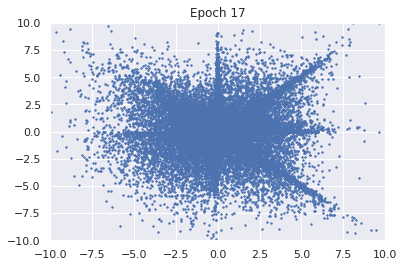

100%|██████████| 976/976 [00:10<00:00, 94.05it/s]


D loss : 1.1443, GP_loss : 0.0 G_loss : -0.7404, MI : 0.5251


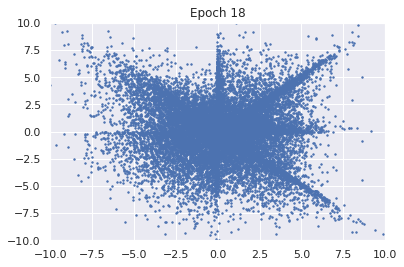

100%|██████████| 976/976 [00:10<00:00, 91.94it/s]


D loss : 1.1367, GP_loss : 0.0 G_loss : -0.7342, MI : 0.5351


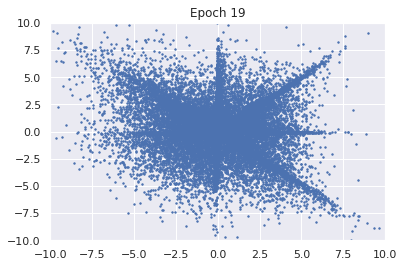

100%|██████████| 976/976 [00:10<00:00, 94.53it/s]


D loss : 1.1286, GP_loss : 0.0 G_loss : -0.7285, MI : 0.5157


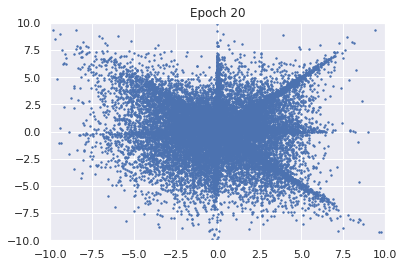

100%|██████████| 976/976 [00:10<00:00, 94.56it/s]


D loss : 1.1204, GP_loss : 0.0 G_loss : -0.7275, MI : 0.5286


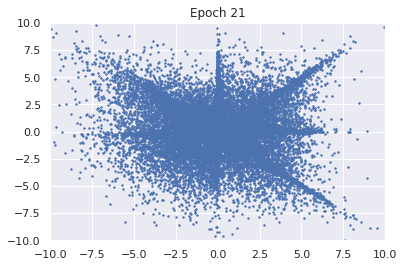

100%|██████████| 976/976 [00:10<00:00, 94.19it/s]


D loss : 1.1099, GP_loss : 0.0 G_loss : -0.7295, MI : 0.5517


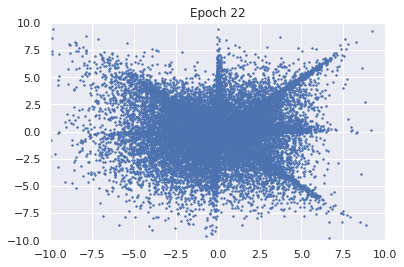

100%|██████████| 976/976 [00:10<00:00, 94.20it/s]


D loss : 1.1023, GP_loss : 0.0 G_loss : -0.7231, MI : 0.5637


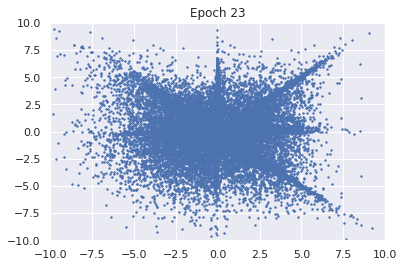

100%|██████████| 976/976 [00:08<00:00, 110.96it/s]


D loss : 1.0962, GP_loss : 0.0 G_loss : -0.7161, MI : 0.5691


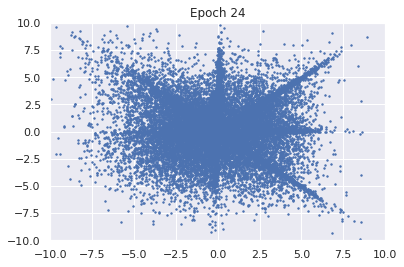

100%|██████████| 976/976 [00:08<00:00, 116.39it/s]


D loss : 1.0899, GP_loss : 0.0 G_loss : -0.713, MI : 0.5763


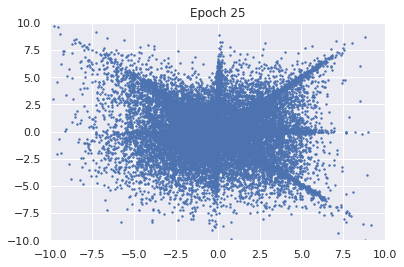

100%|██████████| 976/976 [00:11<00:00, 84.00it/s] 


D loss : 1.0826, GP_loss : 0.0 G_loss : -0.7069, MI : 0.5976


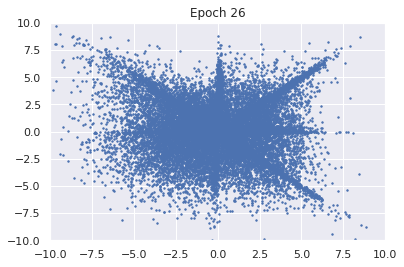

100%|██████████| 976/976 [00:10<00:00, 93.17it/s]


D loss : 1.08, GP_loss : 0.0 G_loss : -0.7021, MI : 0.6073


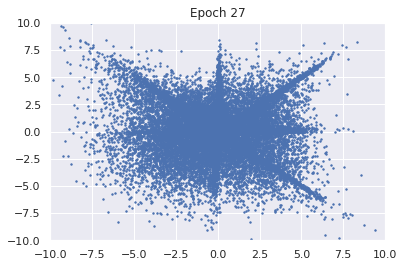

100%|██████████| 976/976 [00:10<00:00, 92.32it/s]


D loss : 1.0732, GP_loss : 0.0 G_loss : -0.6965, MI : 0.5929


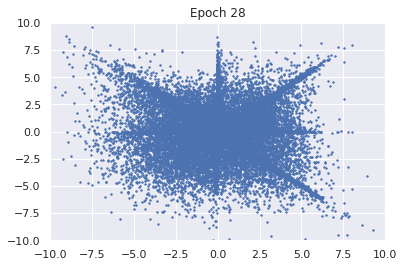

100%|██████████| 976/976 [00:10<00:00, 91.96it/s]


D loss : 1.0686, GP_loss : 0.0 G_loss : -0.69, MI : 0.6051


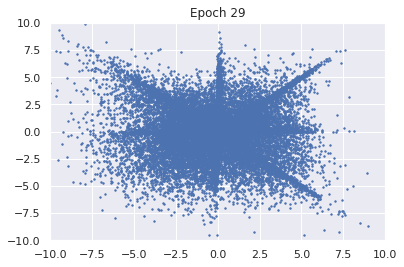

100%|██████████| 976/976 [00:10<00:00, 92.39it/s]


D loss : 1.0664, GP_loss : 0.0 G_loss : -0.6839, MI : 0.6178


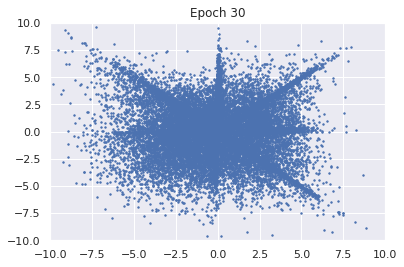

100%|██████████| 976/976 [00:10<00:00, 93.87it/s]


D loss : 1.0613, GP_loss : 0.0 G_loss : -0.6812, MI : 0.6209


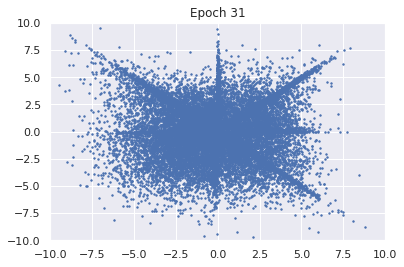

100%|██████████| 976/976 [00:10<00:00, 93.79it/s]


D loss : 1.0609, GP_loss : 0.0 G_loss : -0.6732, MI : 0.6226


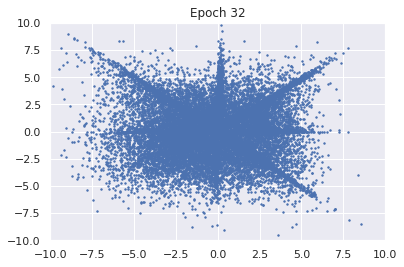

100%|██████████| 976/976 [00:10<00:00, 94.00it/s]


D loss : 1.0556, GP_loss : 0.0 G_loss : -0.6709, MI : 0.6234


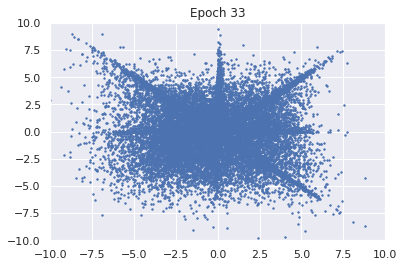

100%|██████████| 976/976 [00:10<00:00, 93.80it/s]


D loss : 1.0549, GP_loss : 0.0 G_loss : -0.6663, MI : 0.6428


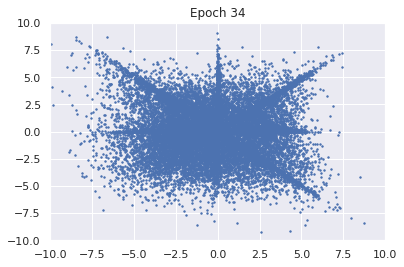

100%|██████████| 976/976 [00:10<00:00, 93.57it/s]


D loss : 1.0535, GP_loss : 0.0 G_loss : -0.6605, MI : 0.6478


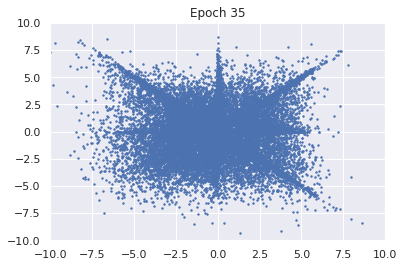

100%|██████████| 976/976 [00:10<00:00, 92.87it/s]


D loss : 1.0534, GP_loss : 0.0 G_loss : -0.6566, MI : 0.65


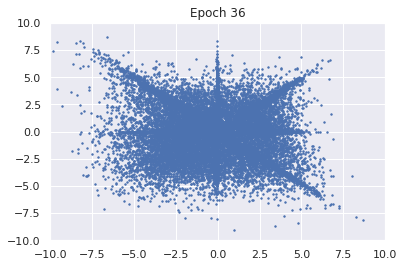

100%|██████████| 976/976 [00:10<00:00, 91.32it/s]


D loss : 1.0505, GP_loss : 0.0 G_loss : -0.655, MI : 0.6638


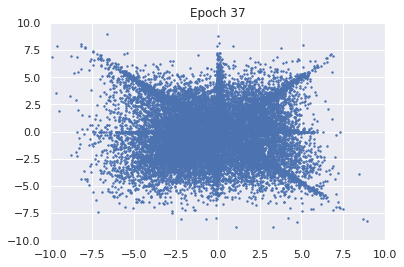

100%|██████████| 976/976 [00:10<00:00, 93.97it/s]


D loss : 1.0486, GP_loss : 0.0 G_loss : -0.6521, MI : 0.6701


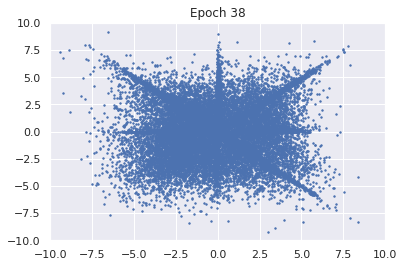

100%|██████████| 976/976 [00:10<00:00, 93.56it/s]


D loss : 1.0485, GP_loss : 0.0 G_loss : -0.6505, MI : 0.6591


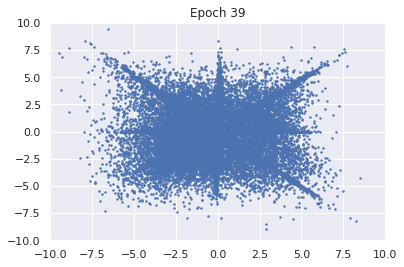

100%|██████████| 976/976 [00:12<00:00, 77.53it/s]


D loss : 1.0463, GP_loss : 0.0 G_loss : -0.6453, MI : 0.6728


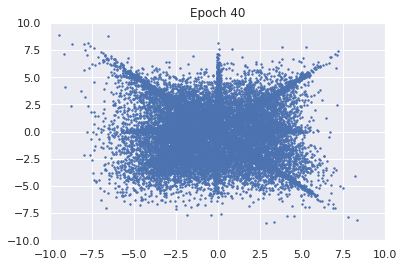

100%|██████████| 976/976 [00:10<00:00, 91.29it/s]


D loss : 1.0441, GP_loss : 0.0 G_loss : -0.6402, MI : 0.6819


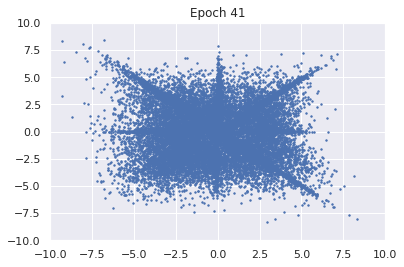

100%|██████████| 976/976 [00:12<00:00, 72.62it/s]


D loss : 1.0426, GP_loss : 0.0 G_loss : -0.6405, MI : 0.6884


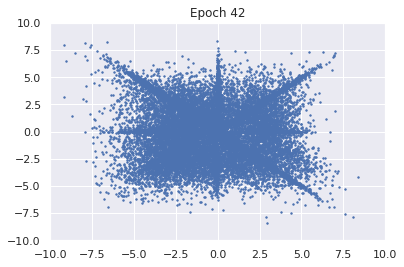

100%|██████████| 976/976 [00:10<00:00, 92.34it/s]


D loss : 1.0425, GP_loss : 0.0 G_loss : -0.6364, MI : 0.6815


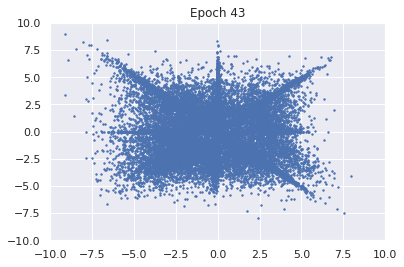

100%|██████████| 976/976 [00:10<00:00, 92.50it/s]


D loss : 1.0436, GP_loss : 0.0 G_loss : -0.6317, MI : 0.6822


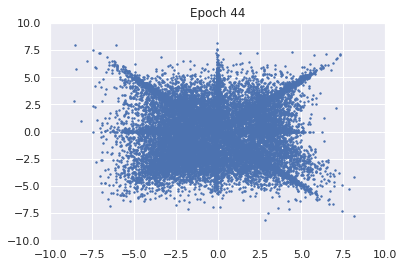

100%|██████████| 976/976 [00:10<00:00, 92.64it/s]


D loss : 1.0401, GP_loss : 0.0 G_loss : -0.6311, MI : 0.6951


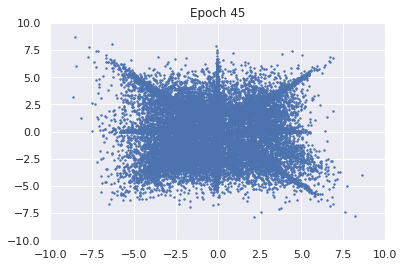

100%|██████████| 976/976 [00:10<00:00, 92.17it/s]


D loss : 1.0459, GP_loss : 0.0 G_loss : -0.6266, MI : 0.6883


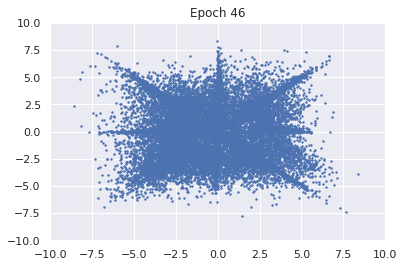

100%|██████████| 976/976 [00:12<00:00, 75.13it/s]


D loss : 1.0388, GP_loss : 0.0 G_loss : -0.6287, MI : 0.68


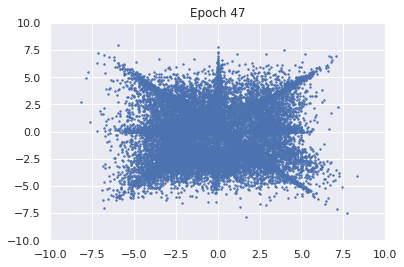

100%|██████████| 976/976 [00:08<00:00, 116.77it/s]


D loss : 1.0424, GP_loss : 0.0 G_loss : -0.6227, MI : 0.6821


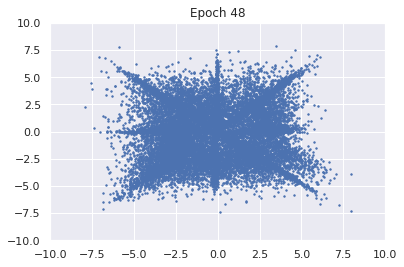

100%|██████████| 976/976 [00:08<00:00, 115.59it/s]


D loss : 1.0449, GP_loss : 0.0 G_loss : -0.6233, MI : 0.6939


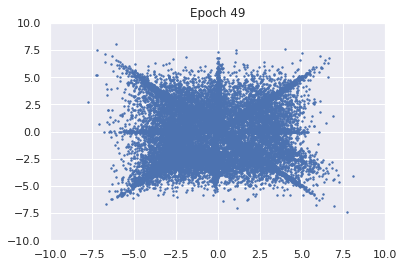

100%|██████████| 976/976 [00:08<00:00, 117.51it/s]


D loss : 1.0436, GP_loss : 0.0 G_loss : -0.6219, MI : 0.6871


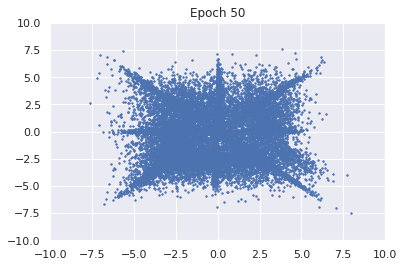

100%|██████████| 976/976 [00:08<00:00, 116.87it/s]


D loss : 1.0471, GP_loss : 0.0 G_loss : -0.6171, MI : 0.7036


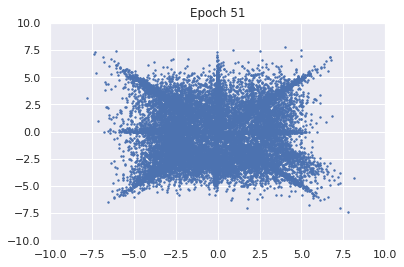

100%|██████████| 976/976 [00:08<00:00, 116.14it/s]


D loss : 1.0452, GP_loss : 0.0 G_loss : -0.6127, MI : 0.6998


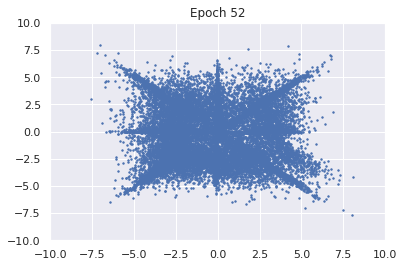

100%|██████████| 976/976 [00:08<00:00, 116.75it/s]


D loss : 1.0475, GP_loss : 0.0 G_loss : -0.6117, MI : 0.7183


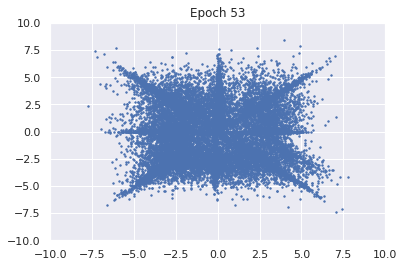

100%|██████████| 976/976 [00:08<00:00, 117.66it/s]


D loss : 1.0446, GP_loss : 0.0 G_loss : -0.6153, MI : 0.7145


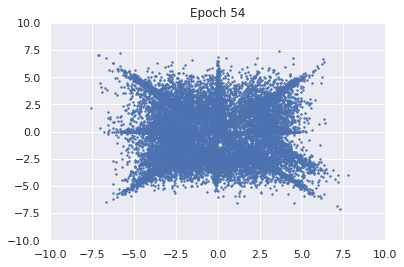

100%|██████████| 976/976 [00:08<00:00, 117.18it/s]


D loss : 1.0459, GP_loss : 0.0 G_loss : -0.6092, MI : 0.7121


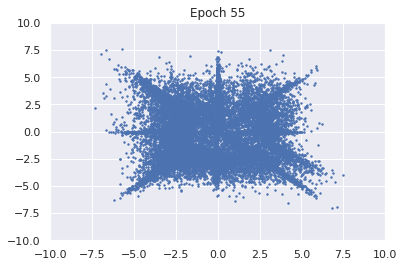

100%|██████████| 976/976 [00:07<00:00, 122.19it/s]


D loss : 1.0464, GP_loss : 0.0 G_loss : -0.6087, MI : 0.7138


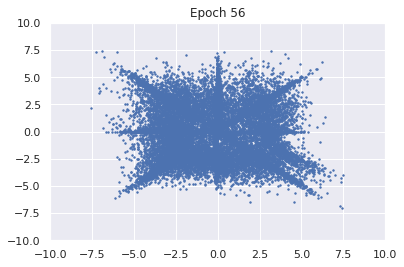

100%|██████████| 976/976 [00:08<00:00, 121.97it/s]


D loss : 1.049, GP_loss : 0.0 G_loss : -0.6036, MI : 0.697


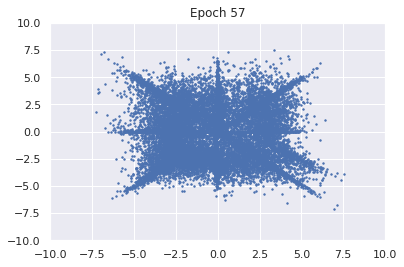

100%|██████████| 976/976 [00:07<00:00, 122.70it/s]


D loss : 1.0528, GP_loss : 0.0 G_loss : -0.6025, MI : 0.696


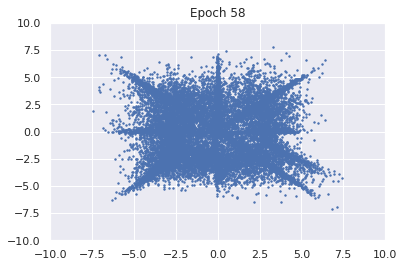

100%|██████████| 976/976 [00:08<00:00, 120.29it/s]


D loss : 1.0474, GP_loss : 0.0 G_loss : -0.6002, MI : 0.7037


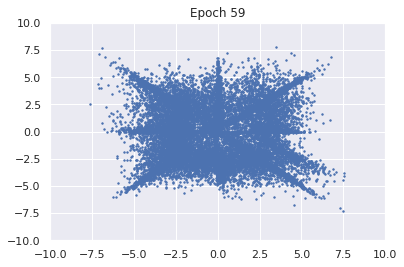

100%|██████████| 976/976 [00:10<00:00, 94.23it/s] 


D loss : 1.0517, GP_loss : 0.0 G_loss : -0.596, MI : 0.6947


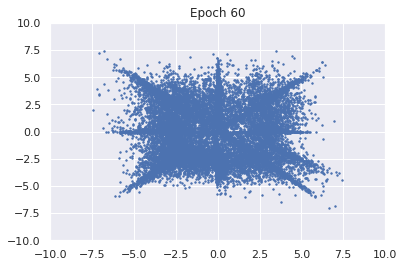

100%|██████████| 976/976 [00:12<00:00, 79.09it/s]


D loss : 1.0541, GP_loss : 0.0 G_loss : -0.5932, MI : 0.6987


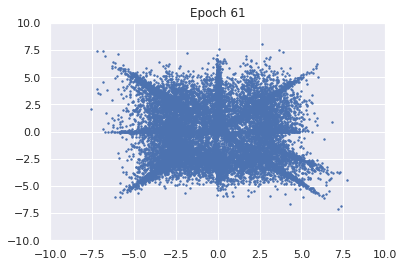

100%|██████████| 976/976 [00:09<00:00, 99.61it/s] 


D loss : 1.052, GP_loss : 0.0 G_loss : -0.5939, MI : 0.6894


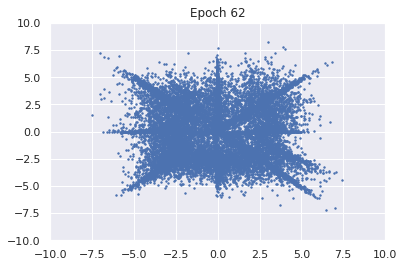

100%|██████████| 976/976 [00:09<00:00, 98.90it/s] 


D loss : 1.0523, GP_loss : 0.0 G_loss : -0.5934, MI : 0.7014


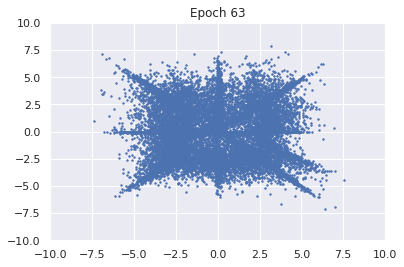

100%|██████████| 976/976 [00:09<00:00, 99.54it/s] 


D loss : 1.0527, GP_loss : 0.0 G_loss : -0.5942, MI : 0.6919


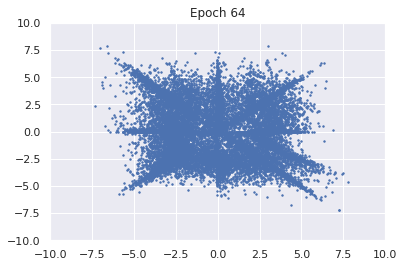

100%|██████████| 976/976 [00:12<00:00, 77.82it/s]


D loss : 1.0563, GP_loss : 0.0 G_loss : -0.5907, MI : 0.6922


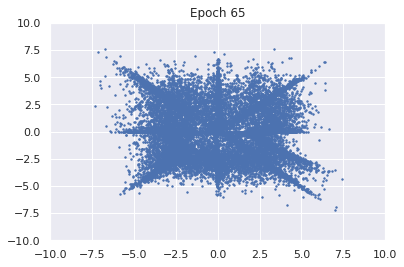

100%|██████████| 976/976 [00:10<00:00, 96.20it/s]


D loss : 1.0538, GP_loss : 0.0 G_loss : -0.5899, MI : 0.6978


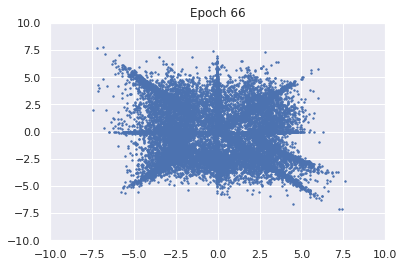

100%|██████████| 976/976 [00:10<00:00, 97.42it/s]


D loss : 1.0572, GP_loss : 0.0 G_loss : -0.5884, MI : 0.7078


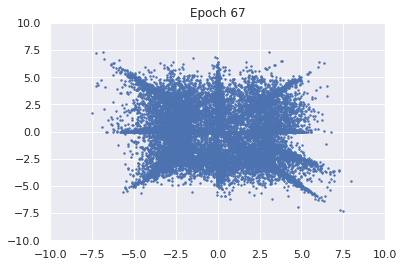

100%|██████████| 976/976 [00:10<00:00, 96.67it/s]


D loss : 1.0538, GP_loss : 0.0 G_loss : -0.5861, MI : 0.7074


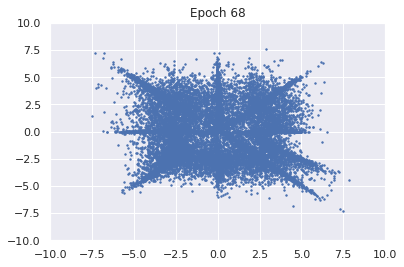

100%|██████████| 976/976 [00:10<00:00, 92.90it/s]


D loss : 1.0558, GP_loss : 0.0 G_loss : -0.5888, MI : 0.6994


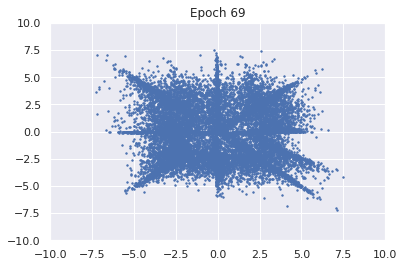

100%|██████████| 976/976 [00:10<00:00, 95.69it/s]


D loss : 1.058, GP_loss : 0.0 G_loss : -0.5876, MI : 0.6967


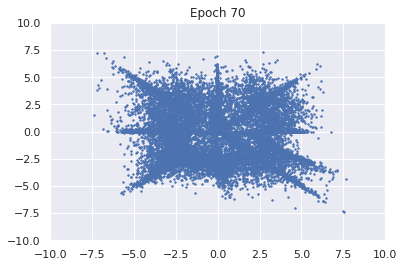

100%|██████████| 976/976 [00:11<00:00, 84.32it/s]


D loss : 1.0532, GP_loss : 0.0 G_loss : -0.59, MI : 0.6947


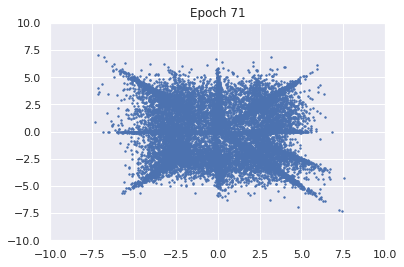

100%|██████████| 976/976 [00:11<00:00, 84.38it/s] 


D loss : 1.0562, GP_loss : 0.0 G_loss : -0.5863, MI : 0.6891


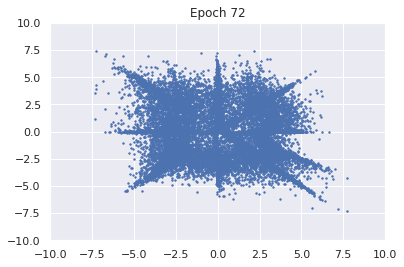

100%|██████████| 976/976 [00:11<00:00, 83.26it/s] 


D loss : 1.0538, GP_loss : 0.0 G_loss : -0.5854, MI : 0.6906


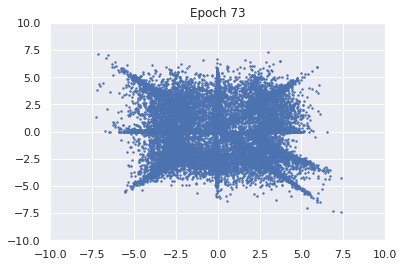

100%|██████████| 976/976 [00:10<00:00, 95.81it/s]


D loss : 1.0527, GP_loss : 0.0 G_loss : -0.586, MI : 0.6944


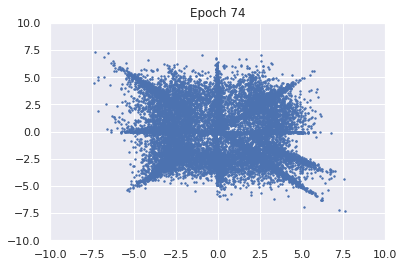

100%|██████████| 976/976 [00:13<00:00, 75.06it/s]


D loss : 1.0565, GP_loss : 0.0 G_loss : -0.5878, MI : 0.7014


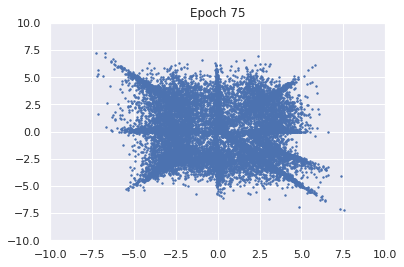

100%|██████████| 976/976 [00:10<00:00, 96.37it/s]


D loss : 1.057, GP_loss : 0.0 G_loss : -0.585, MI : 0.7066


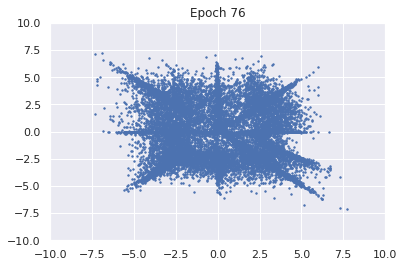

100%|██████████| 976/976 [00:10<00:00, 97.04it/s]


D loss : 1.0566, GP_loss : 0.0 G_loss : -0.585, MI : 0.7219


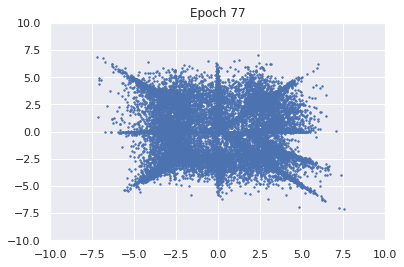

100%|██████████| 976/976 [00:10<00:00, 95.38it/s]


D loss : 1.0596, GP_loss : 0.0 G_loss : -0.5858, MI : 0.7139


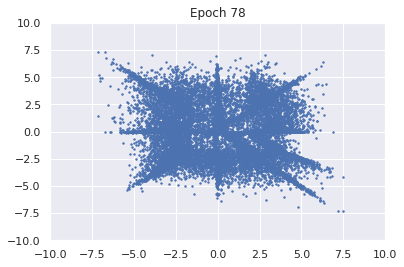

100%|██████████| 976/976 [00:10<00:00, 93.49it/s]


D loss : 1.0569, GP_loss : 0.0 G_loss : -0.5804, MI : 0.7169


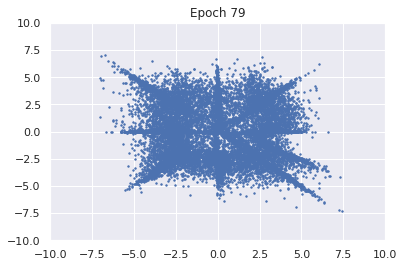

100%|██████████| 976/976 [00:10<00:00, 95.34it/s]


D loss : 1.057, GP_loss : 0.0 G_loss : -0.5862, MI : 0.7265


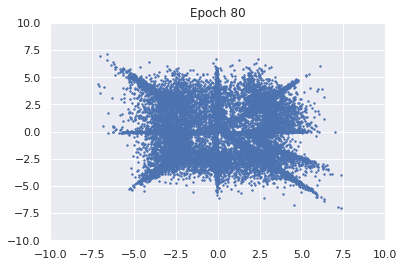

100%|██████████| 976/976 [00:10<00:00, 93.56it/s]


D loss : 1.0548, GP_loss : 0.0 G_loss : -0.5844, MI : 0.7283


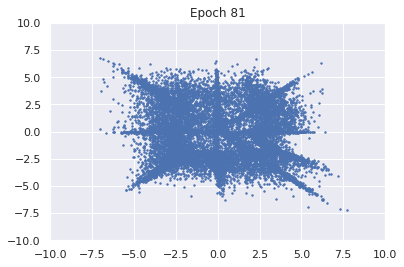

100%|██████████| 976/976 [00:09<00:00, 98.18it/s] 


D loss : 1.0556, GP_loss : 0.0 G_loss : -0.5837, MI : 0.704


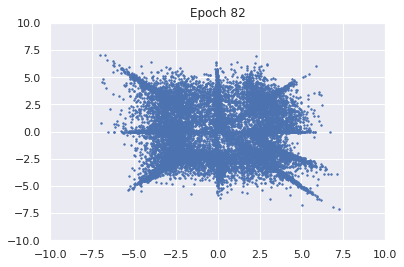

100%|██████████| 976/976 [00:12<00:00, 79.54it/s]


D loss : 1.0597, GP_loss : 0.0 G_loss : -0.5835, MI : 0.7199


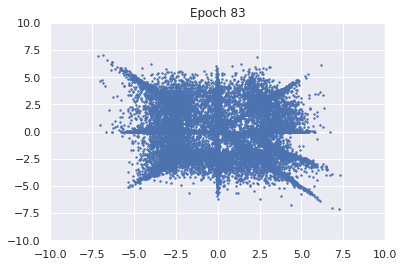

100%|██████████| 976/976 [00:11<00:00, 86.87it/s]


D loss : 1.0585, GP_loss : 0.0 G_loss : -0.5799, MI : 0.7281


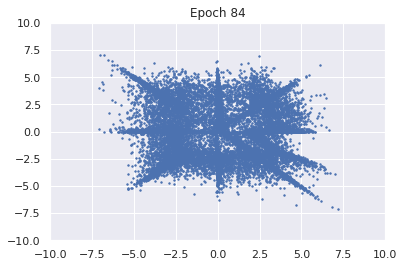

100%|██████████| 976/976 [00:10<00:00, 97.03it/s]


D loss : 1.0608, GP_loss : 0.0 G_loss : -0.5832, MI : 0.7262


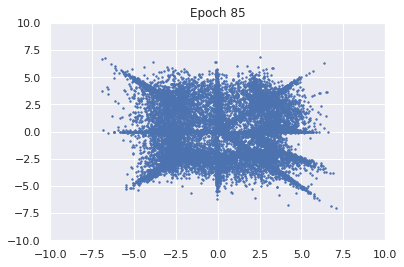

100%|██████████| 976/976 [00:10<00:00, 96.25it/s]


D loss : 1.0582, GP_loss : 0.0 G_loss : -0.5812, MI : 0.7299


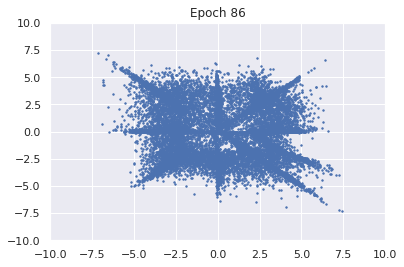

100%|██████████| 976/976 [00:10<00:00, 96.93it/s]


D loss : 1.058, GP_loss : 0.0 G_loss : -0.5801, MI : 0.7301


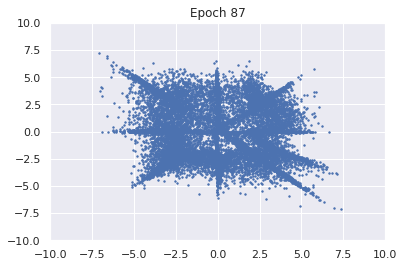

100%|██████████| 976/976 [00:10<00:00, 96.09it/s]


D loss : 1.0595, GP_loss : 0.0 G_loss : -0.5815, MI : 0.7248


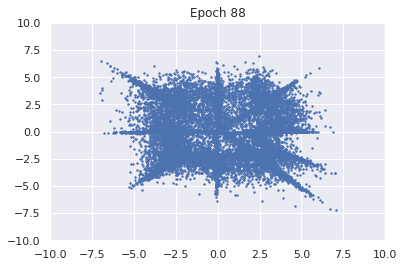

100%|██████████| 976/976 [00:10<00:00, 96.71it/s]


D loss : 1.0631, GP_loss : 0.0 G_loss : -0.5815, MI : 0.7339


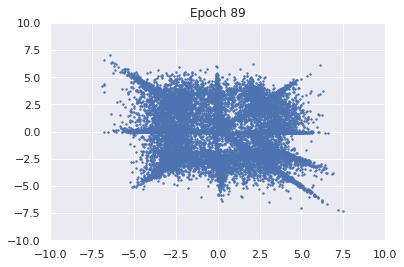

100%|██████████| 976/976 [00:10<00:00, 88.16it/s]


D loss : 1.0625, GP_loss : 0.0 G_loss : -0.5833, MI : 0.7393


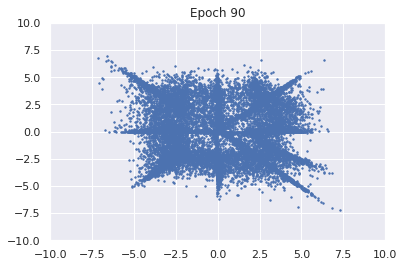

100%|██████████| 976/976 [00:10<00:00, 96.90it/s]


D loss : 1.0619, GP_loss : 0.0 G_loss : -0.5821, MI : 0.7369


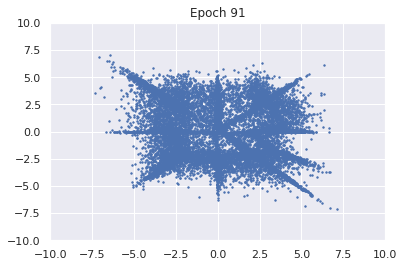

100%|██████████| 976/976 [00:10<00:00, 97.46it/s]


D loss : 1.0618, GP_loss : 0.0 G_loss : -0.5804, MI : 0.7388


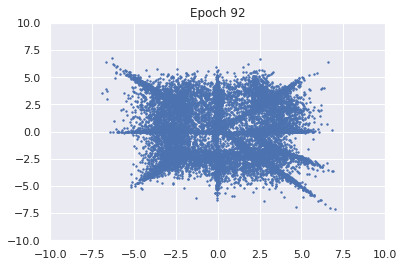

100%|██████████| 976/976 [00:10<00:00, 97.37it/s]


D loss : 1.0637, GP_loss : 0.0 G_loss : -0.5811, MI : 0.7455


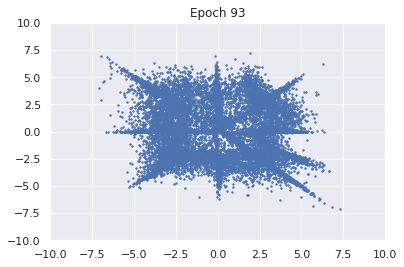

100%|██████████| 976/976 [00:10<00:00, 93.08it/s]


D loss : 1.0649, GP_loss : 0.0 G_loss : -0.5852, MI : 0.7427


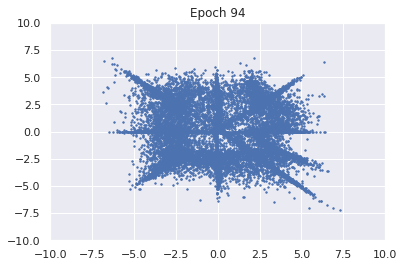

100%|██████████| 976/976 [00:11<00:00, 82.51it/s]


D loss : 1.0613, GP_loss : 0.0 G_loss : -0.5836, MI : 0.742


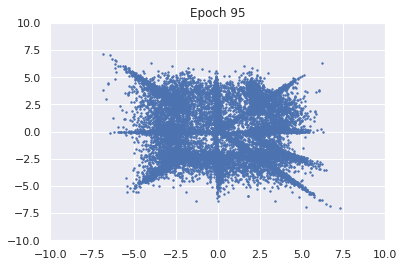

100%|██████████| 976/976 [00:10<00:00, 96.62it/s]


D loss : 1.0608, GP_loss : 0.0 G_loss : -0.5822, MI : 0.7366


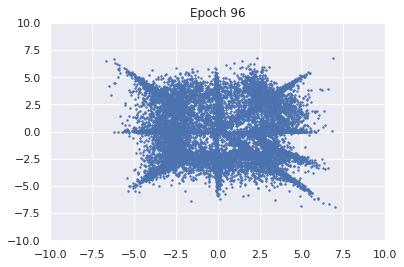

100%|██████████| 976/976 [00:10<00:00, 90.36it/s]


D loss : 1.0614, GP_loss : 0.0 G_loss : -0.5834, MI : 0.7524


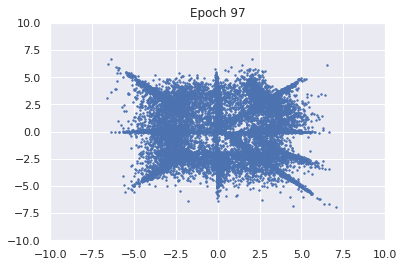

100%|██████████| 976/976 [00:12<00:00, 80.81it/s]


D loss : 1.0644, GP_loss : 0.0 G_loss : -0.5838, MI : 0.7463


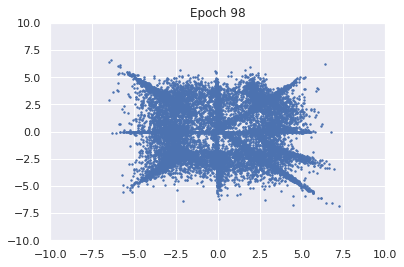

100%|██████████| 976/976 [00:12<00:00, 80.72it/s]


D loss : 1.0649, GP_loss : 0.0 G_loss : -0.5858, MI : 0.7394


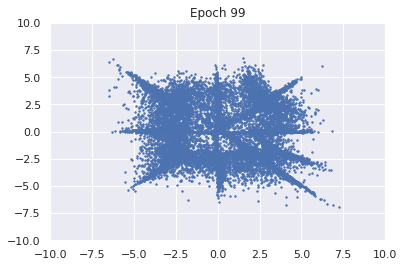

100%|██████████| 976/976 [00:10<00:00, 92.96it/s]


D loss : 1.0662, GP_loss : 0.0 G_loss : -0.5854, MI : 0.7577


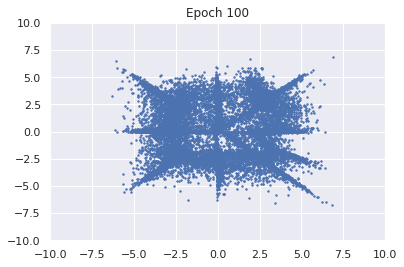

100%|██████████| 976/976 [00:10<00:00, 95.96it/s]


D loss : 1.0663, GP_loss : 0.0 G_loss : -0.588, MI : 0.7662


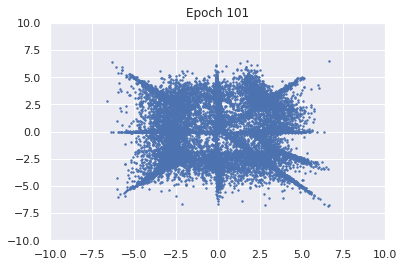

100%|██████████| 976/976 [00:10<00:00, 96.77it/s]


D loss : 1.0665, GP_loss : 0.0 G_loss : -0.5864, MI : 0.7559


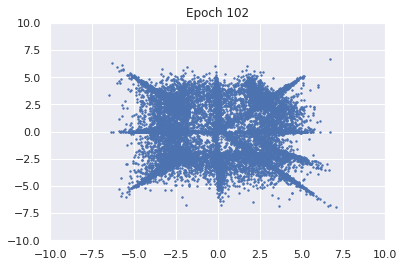

100%|██████████| 976/976 [00:12<00:00, 79.71it/s]


D loss : 1.0705, GP_loss : 0.0 G_loss : -0.5872, MI : 0.7521


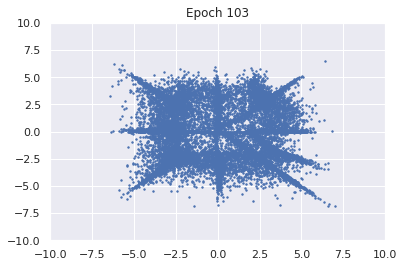

100%|██████████| 976/976 [00:10<00:00, 96.24it/s]


D loss : 1.067, GP_loss : 0.0 G_loss : -0.5869, MI : 0.7597


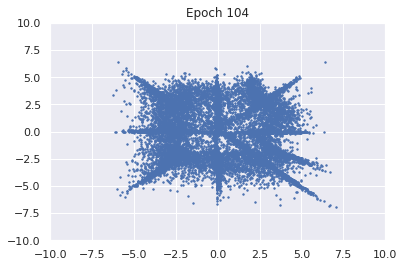

100%|██████████| 976/976 [00:13<00:00, 71.88it/s]


D loss : 1.0694, GP_loss : 0.0 G_loss : -0.587, MI : 0.7676


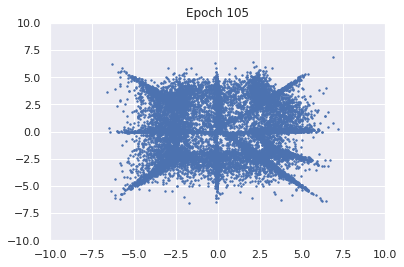

100%|██████████| 976/976 [00:10<00:00, 96.70it/s]


D loss : 1.0695, GP_loss : 0.0 G_loss : -0.5872, MI : 0.7558


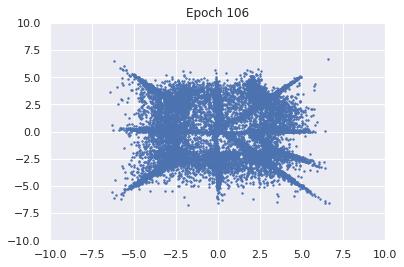

100%|██████████| 976/976 [00:10<00:00, 92.96it/s]


D loss : 1.0687, GP_loss : 0.0 G_loss : -0.5878, MI : 0.757


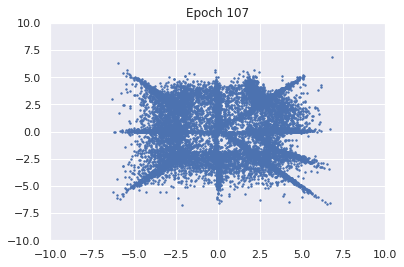

100%|██████████| 976/976 [00:10<00:00, 96.30it/s]


D loss : 1.072, GP_loss : 0.0 G_loss : -0.589, MI : 0.7492


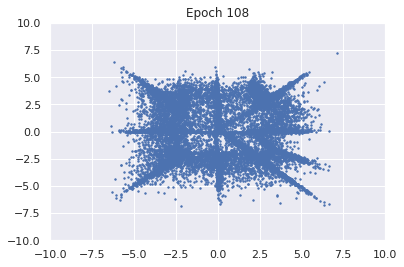

100%|██████████| 976/976 [00:10<00:00, 96.86it/s]


D loss : 1.07, GP_loss : 0.0 G_loss : -0.5895, MI : 0.7725


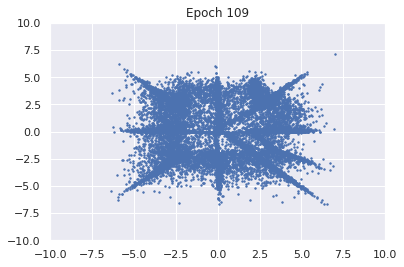

100%|██████████| 976/976 [00:10<00:00, 96.12it/s]


D loss : 1.0718, GP_loss : 0.0 G_loss : -0.5896, MI : 0.7675


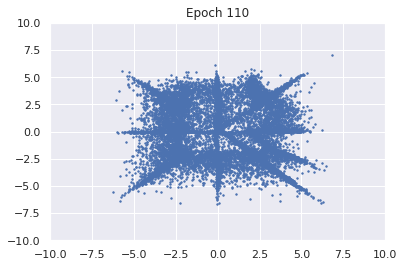

100%|██████████| 976/976 [00:10<00:00, 95.87it/s]


D loss : 1.0725, GP_loss : 0.0 G_loss : -0.5885, MI : 0.7601


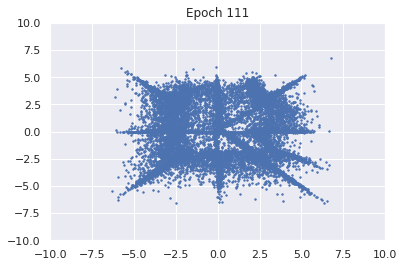

100%|██████████| 976/976 [00:10<00:00, 96.72it/s]


D loss : 1.0734, GP_loss : 0.0 G_loss : -0.591, MI : 0.7697


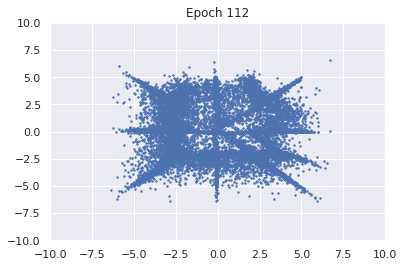

100%|██████████| 976/976 [00:10<00:00, 91.82it/s]


D loss : 1.0642, GP_loss : 0.0 G_loss : -0.5896, MI : 0.7615


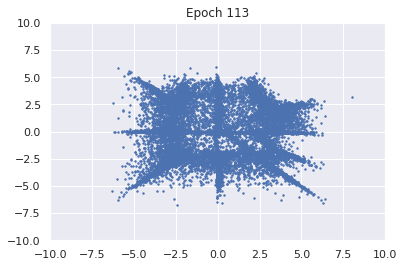

100%|██████████| 976/976 [00:10<00:00, 96.83it/s]


D loss : 1.0374, GP_loss : 0.0 G_loss : -0.594, MI : 0.7575


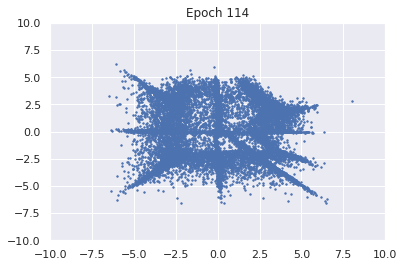

100%|██████████| 976/976 [00:10<00:00, 97.04it/s]


D loss : 1.0437, GP_loss : 0.0 G_loss : -0.5961, MI : 0.7592


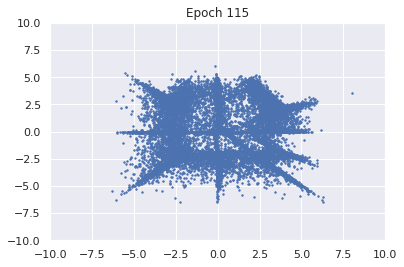

100%|██████████| 976/976 [00:13<00:00, 74.78it/s]


D loss : 1.048, GP_loss : 0.0 G_loss : -0.5983, MI : 0.757


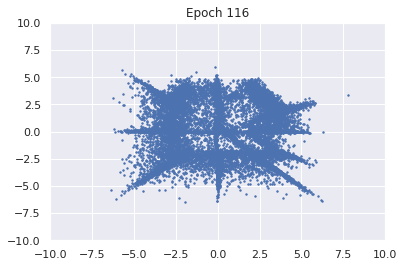

100%|██████████| 976/976 [00:10<00:00, 96.98it/s]


D loss : 1.0499, GP_loss : 0.0 G_loss : -0.5972, MI : 0.7506


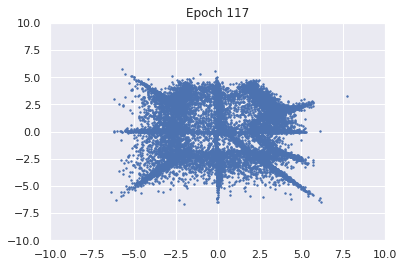

100%|██████████| 976/976 [00:10<00:00, 94.63it/s]


D loss : 1.0581, GP_loss : 0.0 G_loss : -0.5972, MI : 0.7411


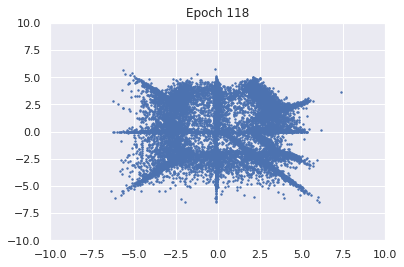

100%|██████████| 976/976 [00:10<00:00, 97.02it/s]


D loss : 1.0546, GP_loss : 0.0 G_loss : -0.5941, MI : 0.7433


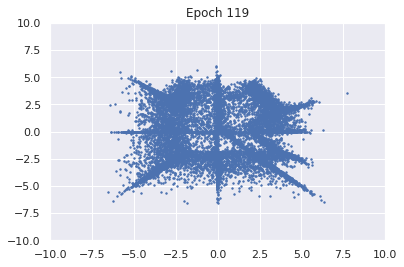

100%|██████████| 976/976 [00:10<00:00, 96.95it/s]


D loss : 1.0611, GP_loss : 0.0 G_loss : -0.5969, MI : 0.7537


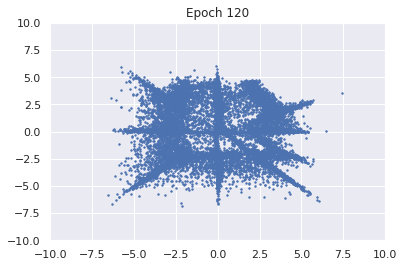

100%|██████████| 976/976 [00:10<00:00, 96.97it/s]


D loss : 1.0596, GP_loss : 0.0 G_loss : -0.596, MI : 0.7466


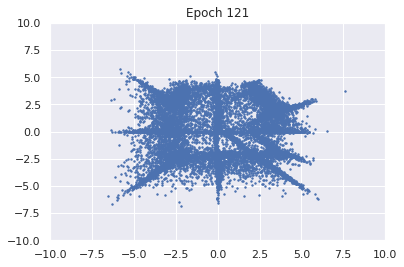

100%|██████████| 976/976 [00:10<00:00, 97.51it/s]


D loss : 1.0617, GP_loss : 0.0 G_loss : -0.5932, MI : 0.7476


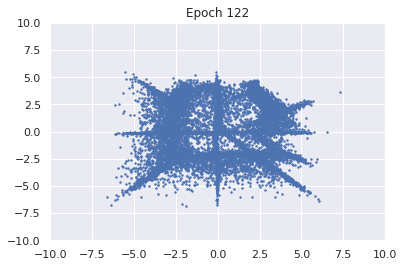

100%|██████████| 976/976 [00:10<00:00, 95.68it/s]


D loss : 1.0597, GP_loss : 0.0 G_loss : -0.5949, MI : 0.7414


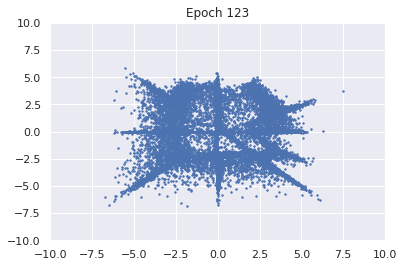

100%|██████████| 976/976 [00:10<00:00, 95.90it/s]


D loss : 1.0622, GP_loss : 0.0 G_loss : -0.597, MI : 0.7442


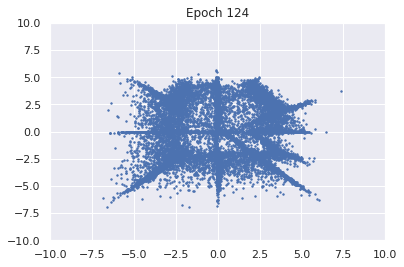

100%|██████████| 976/976 [00:10<00:00, 96.54it/s]


D loss : 1.0675, GP_loss : 0.0 G_loss : -0.5965, MI : 0.7566


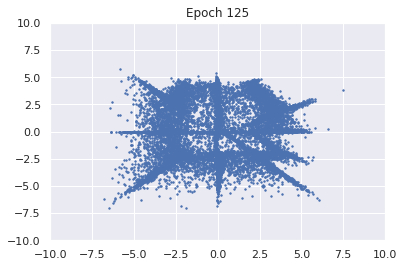

100%|██████████| 976/976 [00:10<00:00, 91.07it/s]


D loss : 1.0645, GP_loss : 0.0 G_loss : -0.5956, MI : 0.7546


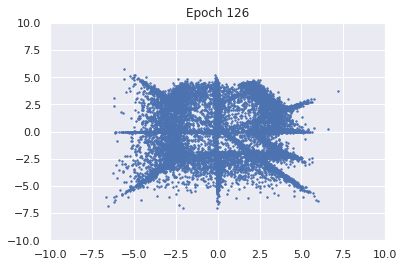

100%|██████████| 976/976 [00:15<00:00, 64.83it/s]


D loss : 1.071, GP_loss : 0.0 G_loss : -0.5942, MI : 0.7564


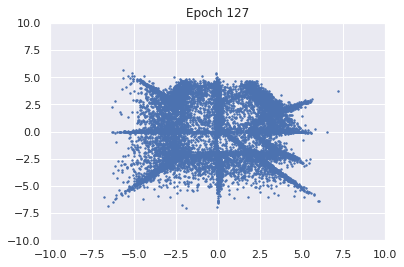

100%|██████████| 976/976 [00:10<00:00, 96.22it/s]


D loss : 1.0671, GP_loss : 0.0 G_loss : -0.5995, MI : 0.7532


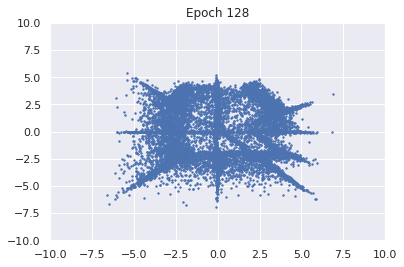

100%|██████████| 976/976 [00:10<00:00, 94.81it/s]


D loss : 1.0639, GP_loss : 0.0 G_loss : -0.5946, MI : 0.7505


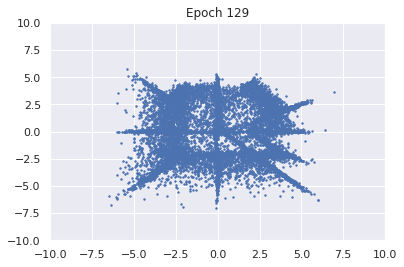

100%|██████████| 976/976 [00:11<00:00, 75.37it/s] 


D loss : 1.0674, GP_loss : 0.0 G_loss : -0.5989, MI : 0.7418


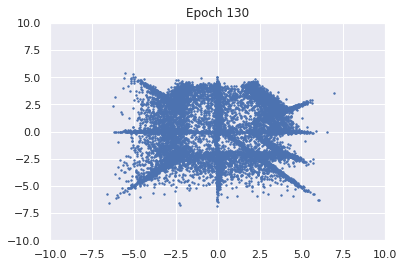

100%|██████████| 976/976 [00:11<00:00, 76.35it/s]


D loss : 1.0661, GP_loss : 0.0 G_loss : -0.5988, MI : 0.7556


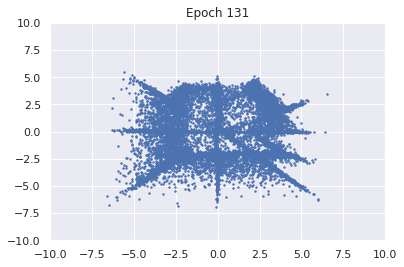

100%|██████████| 976/976 [00:13<00:00, 74.34it/s]


D loss : 1.0683, GP_loss : 0.0 G_loss : -0.6005, MI : 0.7436


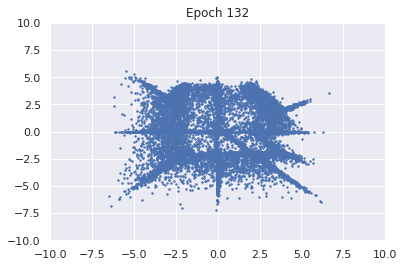

100%|██████████| 976/976 [00:10<00:00, 95.71it/s]


D loss : 1.0671, GP_loss : 0.0 G_loss : -0.6007, MI : 0.7537


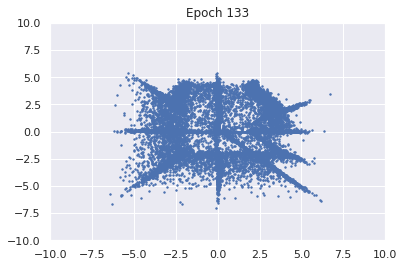

100%|██████████| 976/976 [00:09<00:00, 97.63it/s] 


D loss : 1.0721, GP_loss : 0.0 G_loss : -0.5987, MI : 0.7508


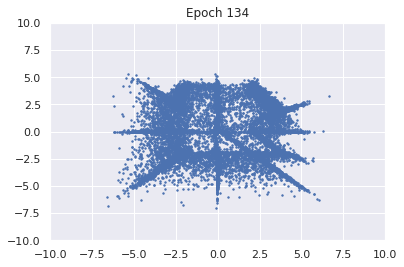

100%|██████████| 976/976 [00:12<00:00, 77.42it/s]


D loss : 1.0669, GP_loss : 0.0 G_loss : -0.5932, MI : 0.7469


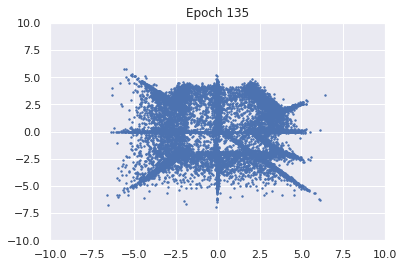

100%|██████████| 976/976 [00:10<00:00, 69.27it/s]


D loss : 1.076, GP_loss : 0.0 G_loss : -0.5997, MI : 0.754


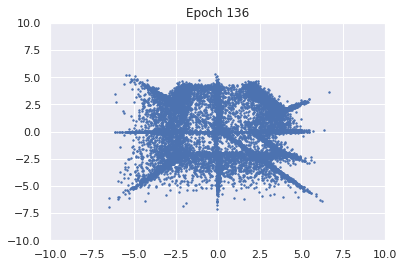

100%|██████████| 976/976 [00:09<00:00, 100.29it/s]


D loss : 1.0723, GP_loss : 0.0 G_loss : -0.5945, MI : 0.7427


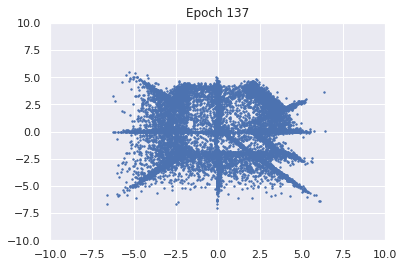

100%|██████████| 976/976 [00:09<00:00, 100.33it/s]


D loss : 1.071, GP_loss : 0.0 G_loss : -0.5965, MI : 0.7405


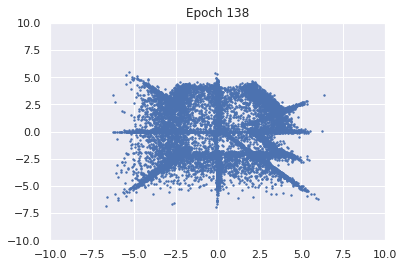

100%|██████████| 976/976 [00:09<00:00, 99.84it/s] 


D loss : 1.0734, GP_loss : 0.0 G_loss : -0.5994, MI : 0.7407


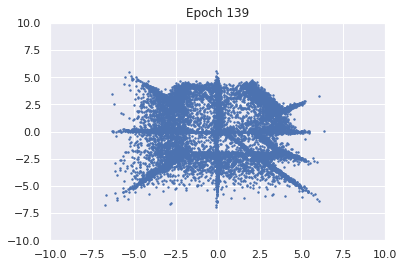

100%|██████████| 976/976 [00:09<00:00, 100.70it/s]


D loss : 1.0697, GP_loss : 0.0 G_loss : -0.5963, MI : 0.7464


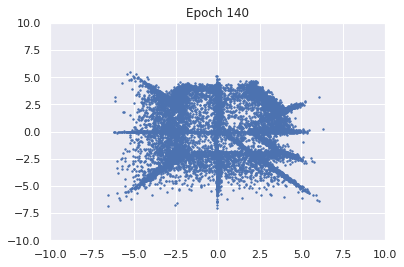

100%|██████████| 976/976 [00:09<00:00, 100.45it/s]


D loss : 1.074, GP_loss : 0.0 G_loss : -0.5993, MI : 0.7269


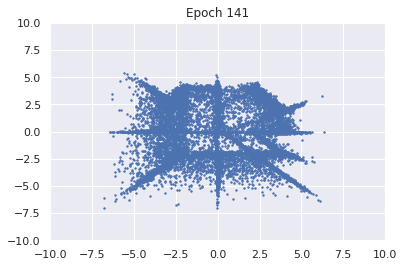

100%|██████████| 976/976 [00:09<00:00, 100.94it/s]


D loss : 1.0727, GP_loss : 0.0 G_loss : -0.5968, MI : 0.7245


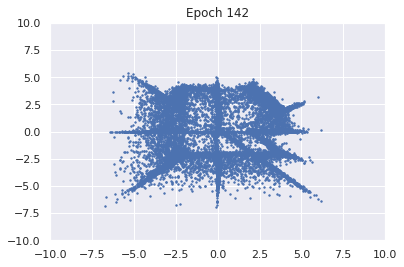

100%|██████████| 976/976 [00:09<00:00, 100.43it/s]


D loss : 1.0762, GP_loss : 0.0 G_loss : -0.5987, MI : 0.7242


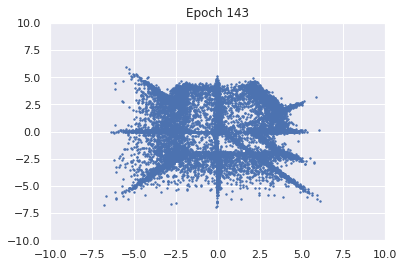

100%|██████████| 976/976 [00:09<00:00, 99.92it/s] 


D loss : 1.0742, GP_loss : 0.0 G_loss : -0.5993, MI : 0.7177


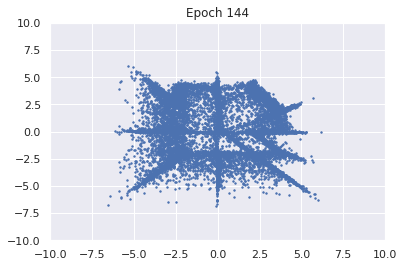

100%|██████████| 976/976 [00:10<00:00, 99.59it/s] 


D loss : 1.0778, GP_loss : 0.0 G_loss : -0.5993, MI : 0.7125


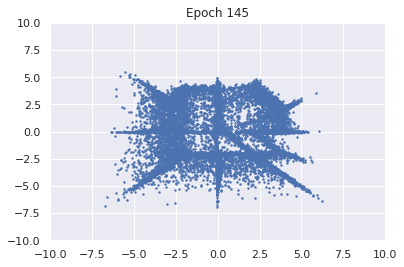

100%|██████████| 976/976 [00:09<00:00, 100.02it/s]


D loss : 1.079, GP_loss : 0.0 G_loss : -0.5973, MI : 0.7122


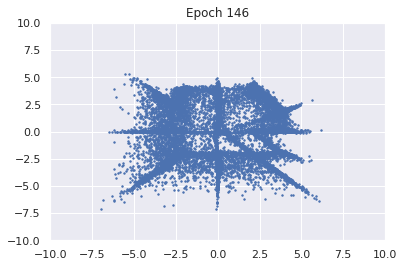

100%|██████████| 976/976 [00:09<00:00, 100.36it/s]


D loss : 1.0799, GP_loss : 0.0 G_loss : -0.5968, MI : 0.7256


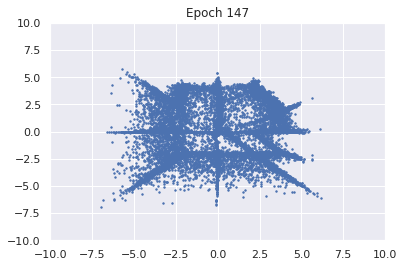

100%|██████████| 976/976 [00:11<00:00, 83.07it/s] 


D loss : 1.0814, GP_loss : 0.0 G_loss : -0.5997, MI : 0.7039


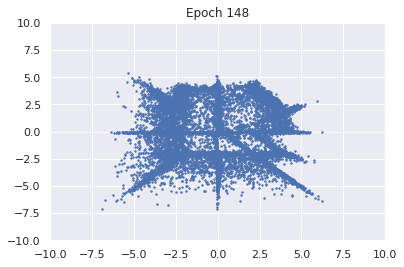

100%|██████████| 976/976 [00:12<00:00, 75.13it/s]


D loss : 1.0781, GP_loss : 0.0 G_loss : -0.5977, MI : 0.7167


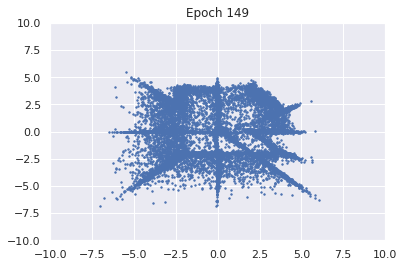

100%|██████████| 976/976 [00:10<00:00, 96.61it/s]


D loss : 1.0791, GP_loss : 0.0 G_loss : -0.5985, MI : 0.7078


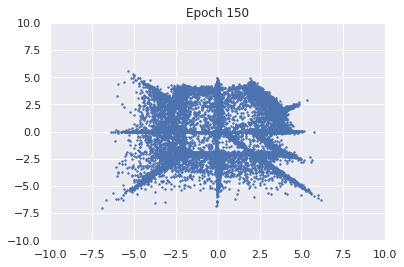

100%|██████████| 976/976 [00:10<00:00, 97.53it/s]


D loss : 1.0815, GP_loss : 0.0 G_loss : -0.6006, MI : 0.7102


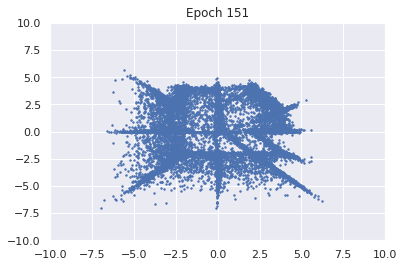

100%|██████████| 976/976 [00:09<00:00, 98.89it/s]


D loss : 1.0779, GP_loss : 0.0 G_loss : -0.6017, MI : 0.7103


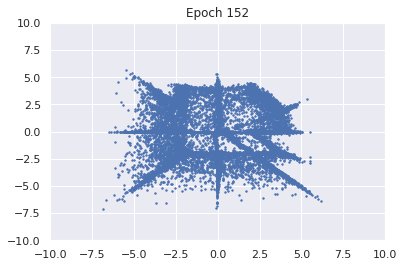

100%|██████████| 976/976 [00:09<00:00, 98.18it/s]


D loss : 1.0763, GP_loss : 0.0 G_loss : -0.5999, MI : 0.7105


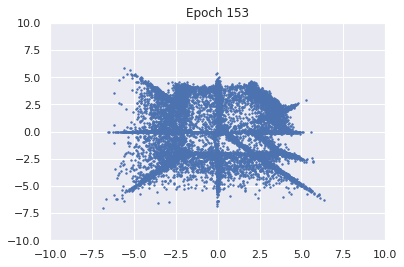

100%|██████████| 976/976 [00:10<00:00, 97.19it/s]


D loss : 1.0789, GP_loss : 0.0 G_loss : -0.5999, MI : 0.7168


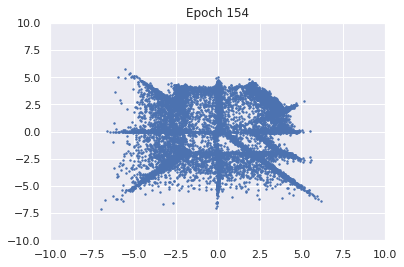

100%|██████████| 976/976 [00:12<00:00, 79.58it/s]


D loss : 1.079, GP_loss : 0.0 G_loss : -0.6007, MI : 0.7113


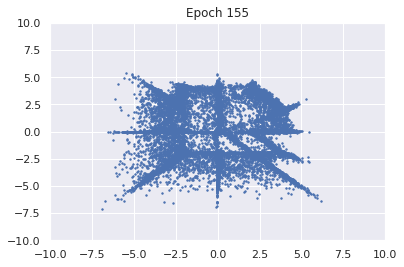

100%|██████████| 976/976 [00:10<00:00, 96.95it/s]


D loss : 1.0847, GP_loss : 0.0 G_loss : -0.6016, MI : 0.7094


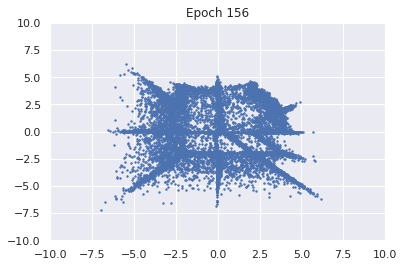

100%|██████████| 976/976 [00:10<00:00, 96.33it/s]


D loss : 1.0814, GP_loss : 0.0 G_loss : -0.5978, MI : 0.7079


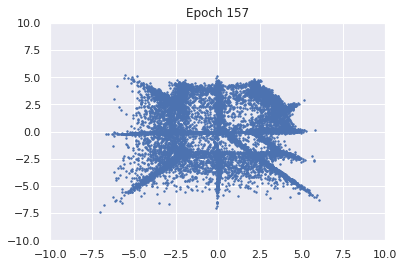

100%|██████████| 976/976 [00:10<00:00, 96.63it/s]


D loss : 1.0774, GP_loss : 0.0 G_loss : -0.5952, MI : 0.7129


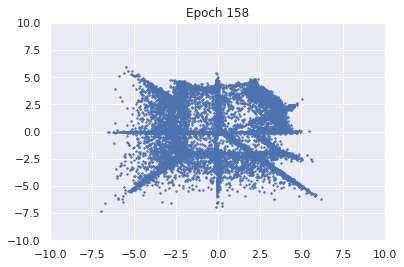

100%|██████████| 976/976 [00:13<00:00, 74.42it/s]


D loss : 1.0808, GP_loss : 0.0 G_loss : -0.6002, MI : 0.7168


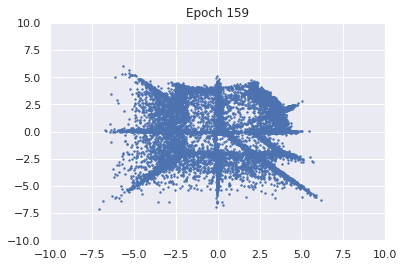

100%|██████████| 976/976 [00:10<00:00, 96.13it/s]


D loss : 1.0856, GP_loss : 0.0 G_loss : -0.5944, MI : 0.7111


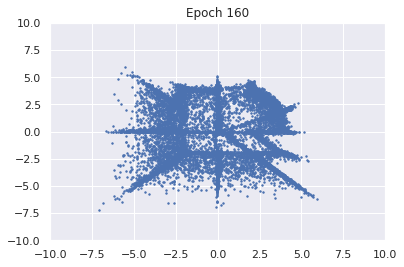

100%|██████████| 976/976 [00:10<00:00, 94.73it/s]


D loss : 1.0878, GP_loss : 0.0 G_loss : -0.5999, MI : 0.7206


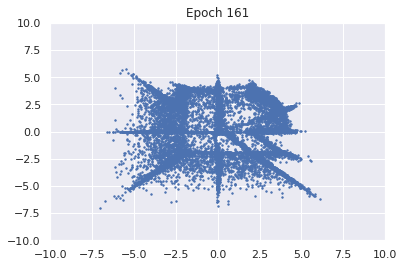

100%|██████████| 976/976 [00:10<00:00, 96.28it/s]


D loss : 1.0862, GP_loss : 0.0 G_loss : -0.5976, MI : 0.7224


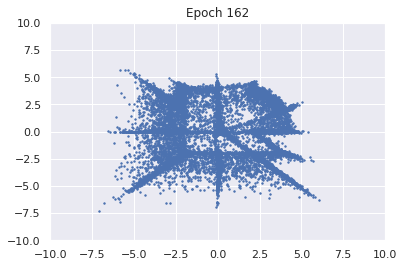

100%|██████████| 976/976 [00:10<00:00, 95.43it/s]


D loss : 1.0859, GP_loss : 0.0 G_loss : -0.5963, MI : 0.7198


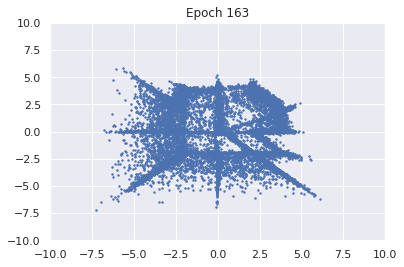

100%|██████████| 976/976 [00:10<00:00, 95.40it/s]


D loss : 1.0857, GP_loss : 0.0 G_loss : -0.5937, MI : 0.7119


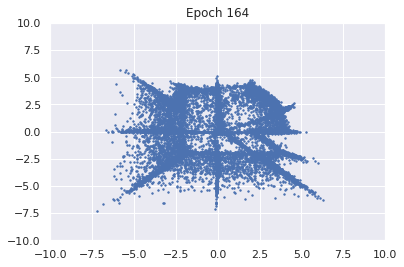

100%|██████████| 976/976 [00:10<00:00, 97.33it/s]


D loss : 1.0944, GP_loss : 0.0 G_loss : -0.5974, MI : 0.7236


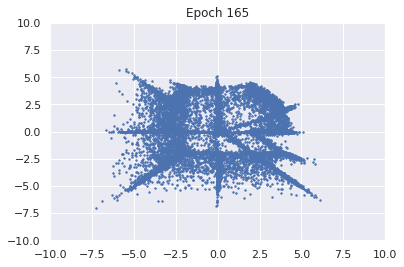

100%|██████████| 976/976 [00:10<00:00, 96.15it/s] 


D loss : 1.0909, GP_loss : 0.0 G_loss : -0.596, MI : 0.7201


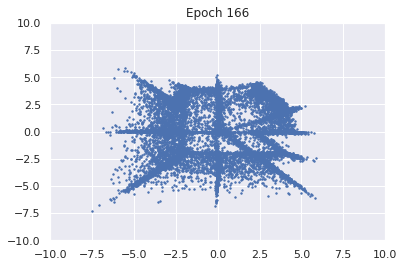

100%|██████████| 976/976 [00:08<00:00, 122.95it/s]


D loss : 1.0903, GP_loss : 0.0 G_loss : -0.6, MI : 0.718


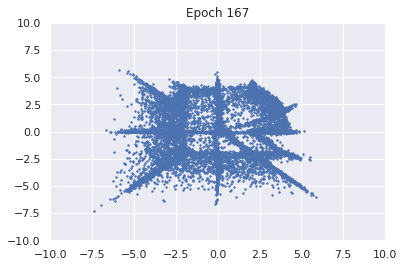

100%|██████████| 976/976 [00:13<00:00, 73.14it/s]


D loss : 1.0879, GP_loss : 0.0 G_loss : -0.599, MI : 0.7225


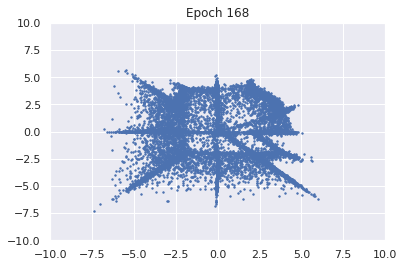

100%|██████████| 976/976 [00:10<00:00, 91.74it/s]


D loss : 1.0905, GP_loss : 0.0 G_loss : -0.6002, MI : 0.7283


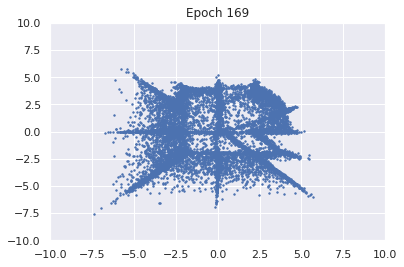

100%|██████████| 976/976 [00:12<00:00, 76.83it/s]


D loss : 1.0948, GP_loss : 0.0 G_loss : -0.5943, MI : 0.7285


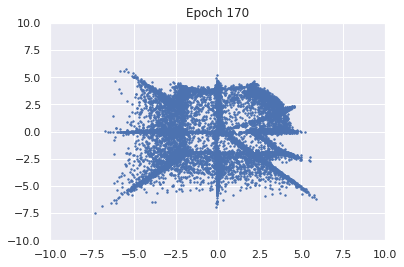

100%|██████████| 976/976 [00:10<00:00, 97.47it/s]


D loss : 1.0935, GP_loss : 0.0 G_loss : -0.5998, MI : 0.7208


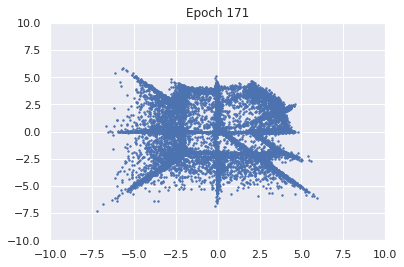

100%|██████████| 976/976 [00:11<00:00, 85.91it/s]


D loss : 1.0955, GP_loss : 0.0 G_loss : -0.596, MI : 0.7239


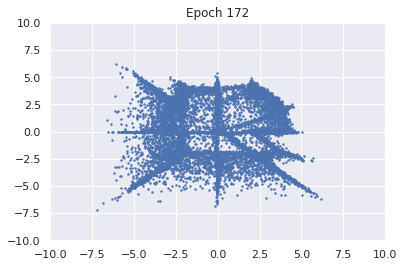

100%|██████████| 976/976 [00:09<00:00, 98.69it/s]


D loss : 1.0966, GP_loss : 0.0 G_loss : -0.5973, MI : 0.7154


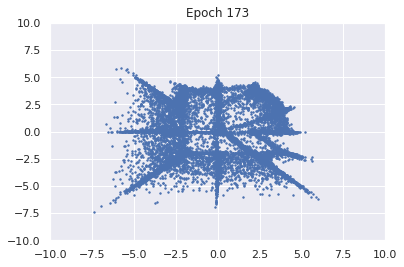

100%|██████████| 976/976 [00:09<00:00, 98.98it/s]


D loss : 1.0889, GP_loss : 0.0 G_loss : -0.5989, MI : 0.7214


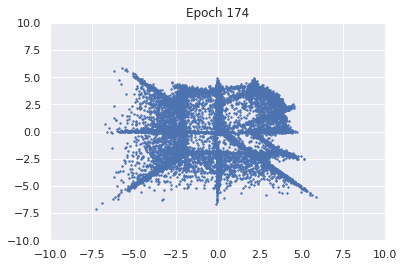

100%|██████████| 976/976 [00:09<00:00, 98.61it/s]


D loss : 1.1002, GP_loss : 0.0 G_loss : -0.595, MI : 0.7263


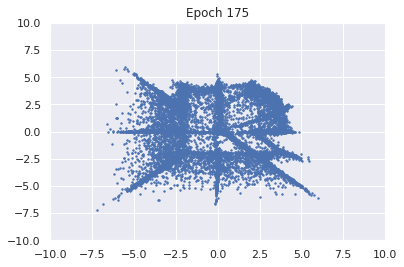

100%|██████████| 976/976 [00:09<00:00, 98.41it/s]


D loss : 1.0935, GP_loss : 0.0 G_loss : -0.5956, MI : 0.7275


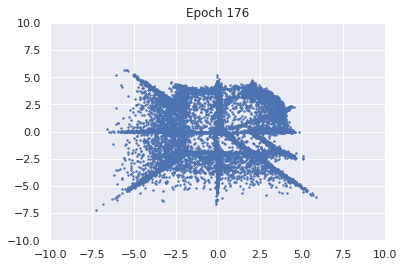

100%|██████████| 976/976 [00:10<00:00, 97.48it/s]


D loss : 1.0992, GP_loss : 0.0 G_loss : -0.5951, MI : 0.7268


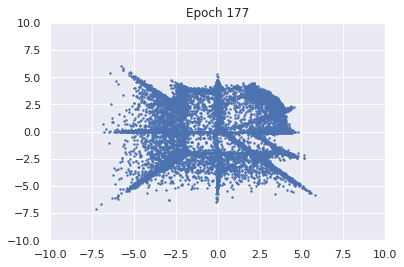

100%|██████████| 976/976 [00:09<00:00, 98.62it/s] 


D loss : 1.0987, GP_loss : 0.0 G_loss : -0.5984, MI : 0.7277


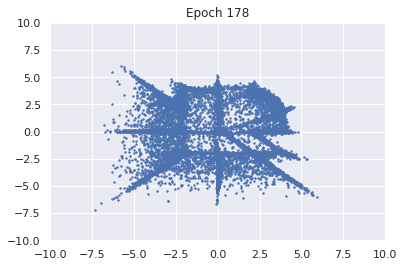

100%|██████████| 976/976 [00:09<00:00, 98.30it/s] 


D loss : 1.0914, GP_loss : 0.0 G_loss : -0.5972, MI : 0.7235


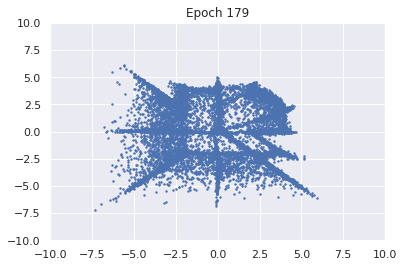

100%|██████████| 976/976 [00:10<00:00, 92.81it/s]


D loss : 1.0955, GP_loss : 0.0 G_loss : -0.5968, MI : 0.7268


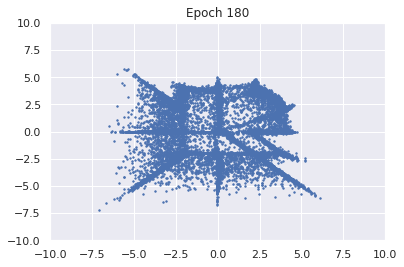

100%|██████████| 976/976 [00:10<00:00, 97.32it/s]


D loss : 1.1043, GP_loss : 0.0 G_loss : -0.5945, MI : 0.7234


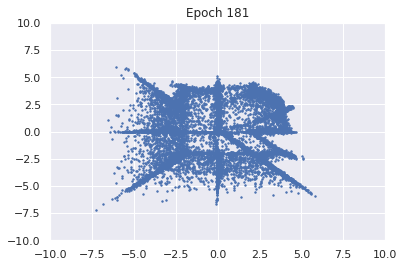

100%|██████████| 976/976 [00:10<00:00, 97.19it/s]


D loss : 1.0987, GP_loss : 0.0 G_loss : -0.594, MI : 0.73


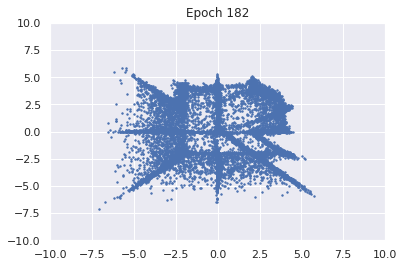

100%|██████████| 976/976 [00:10<00:00, 97.02it/s]


D loss : 1.1013, GP_loss : 0.0 G_loss : -0.6003, MI : 0.7328


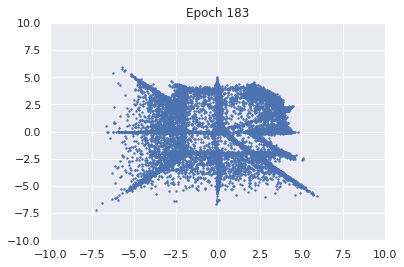

100%|██████████| 976/976 [00:10<00:00, 97.49it/s]


D loss : 1.0944, GP_loss : 0.0 G_loss : -0.5973, MI : 0.7369


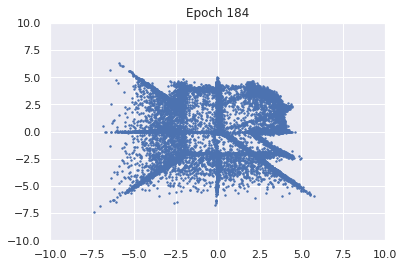

100%|██████████| 976/976 [00:10<00:00, 96.68it/s]


D loss : 1.1001, GP_loss : 0.0 G_loss : -0.594, MI : 0.7351


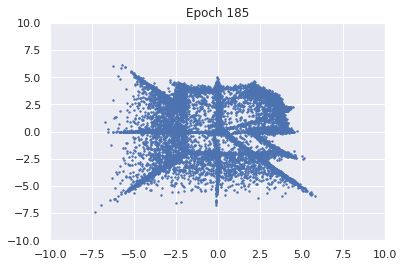

100%|██████████| 976/976 [00:10<00:00, 97.09it/s]


D loss : 1.0704, GP_loss : 0.0 G_loss : -0.5921, MI : 0.7216


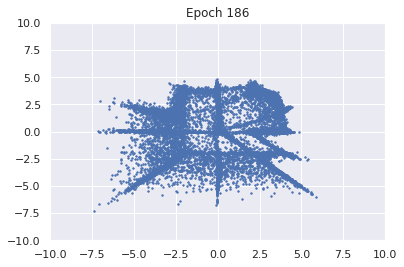

100%|██████████| 976/976 [00:10<00:00, 96.28it/s]


D loss : 1.0743, GP_loss : 0.0 G_loss : -0.5883, MI : 0.7342


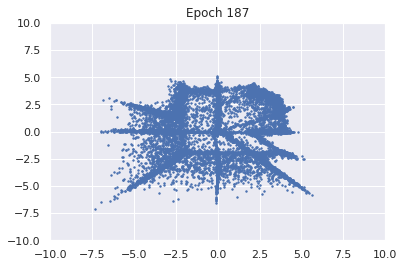

100%|██████████| 976/976 [00:10<00:00, 96.80it/s]


D loss : 1.0758, GP_loss : 0.0 G_loss : -0.5864, MI : 0.7341


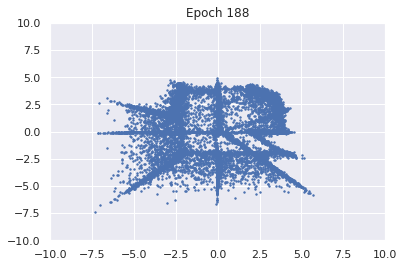

100%|██████████| 976/976 [00:10<00:00, 97.03it/s]


D loss : 1.0776, GP_loss : 0.0 G_loss : -0.5869, MI : 0.7368


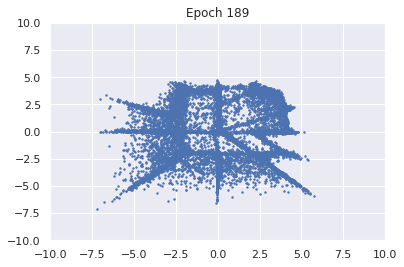

100%|██████████| 976/976 [00:10<00:00, 95.73it/s]


D loss : 1.0798, GP_loss : 0.0 G_loss : -0.5873, MI : 0.7375


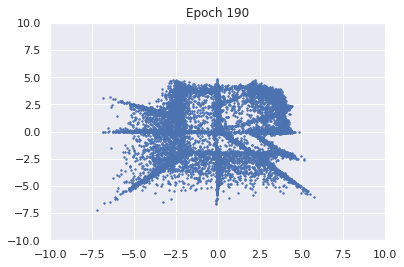

100%|██████████| 976/976 [00:10<00:00, 97.10it/s]


D loss : 1.0705, GP_loss : 0.0 G_loss : -0.5812, MI : 0.725


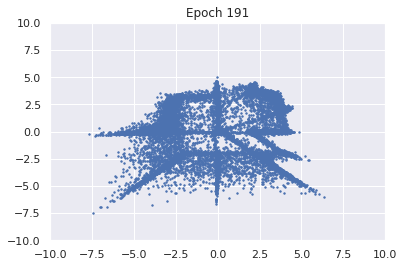

100%|██████████| 976/976 [00:12<00:00, 76.04it/s]


D loss : 1.0332, GP_loss : 0.0 G_loss : -0.5701, MI : 0.7001


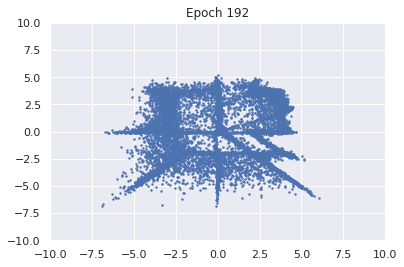

100%|██████████| 976/976 [00:12<00:00, 73.48it/s]


D loss : 1.0451, GP_loss : 0.0 G_loss : -0.5765, MI : 0.719


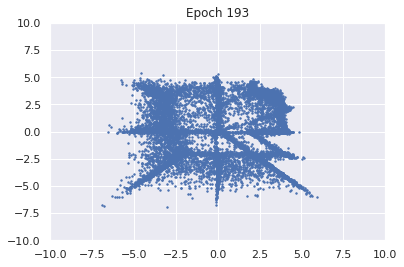

100%|██████████| 976/976 [00:13<00:00, 74.82it/s]


D loss : 1.0562, GP_loss : 0.0 G_loss : -0.5757, MI : 0.731


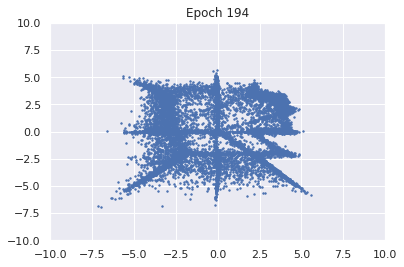

100%|██████████| 976/976 [00:10<00:00, 97.11it/s]


D loss : 1.0578, GP_loss : 0.0 G_loss : -0.5759, MI : 0.7305


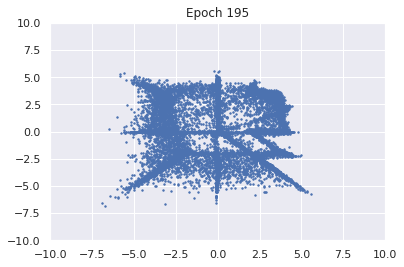

100%|██████████| 976/976 [00:10<00:00, 97.11it/s]


D loss : 1.0565, GP_loss : 0.0 G_loss : -0.5737, MI : 0.7347


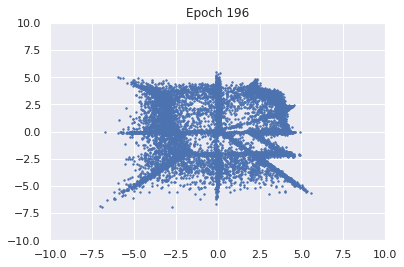

100%|██████████| 976/976 [00:09<00:00, 97.93it/s]


D loss : 1.0614, GP_loss : 0.0 G_loss : -0.5767, MI : 0.7303


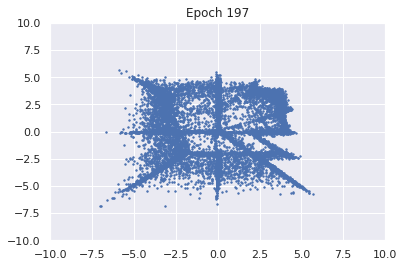

100%|██████████| 976/976 [00:10<00:00, 96.75it/s]


D loss : 1.0678, GP_loss : 0.0 G_loss : -0.5694, MI : 0.7289


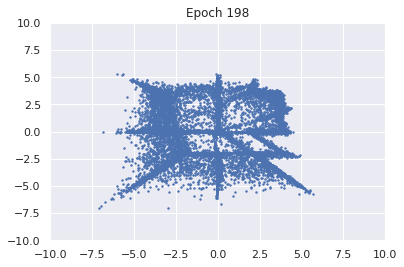

100%|██████████| 976/976 [00:09<00:00, 75.92it/s] 


D loss : 1.0697, GP_loss : 0.0 G_loss : -0.571, MI : 0.732


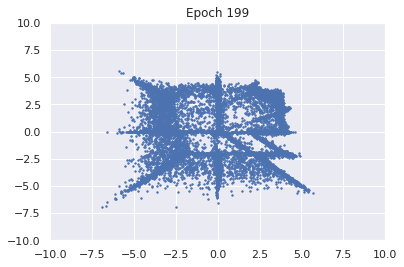

100%|██████████| 976/976 [00:10<00:00, 93.46it/s]


D loss : 1.0674, GP_loss : 0.0 G_loss : -0.5725, MI : 0.7372


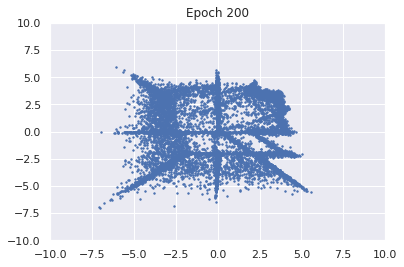

100%|██████████| 976/976 [00:09<00:00, 98.77it/s] 


D loss : 1.0694, GP_loss : 0.0 G_loss : -0.5777, MI : 0.7406


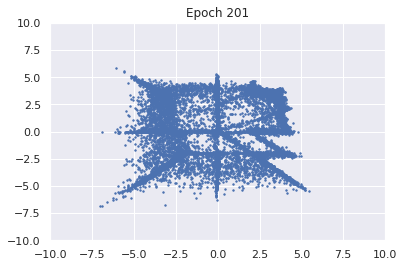

100%|██████████| 976/976 [00:10<00:00, 92.29it/s] 


D loss : 1.0775, GP_loss : 0.0 G_loss : -0.575, MI : 0.7379


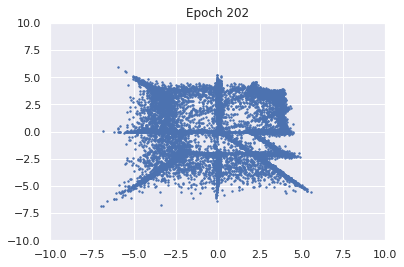

100%|██████████| 976/976 [00:09<00:00, 102.70it/s]


D loss : 1.0723, GP_loss : 0.0 G_loss : -0.5711, MI : 0.7359


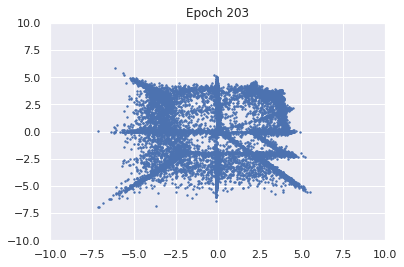

100%|██████████| 976/976 [00:09<00:00, 102.83it/s]


D loss : 1.0724, GP_loss : 0.0 G_loss : -0.5764, MI : 0.7282


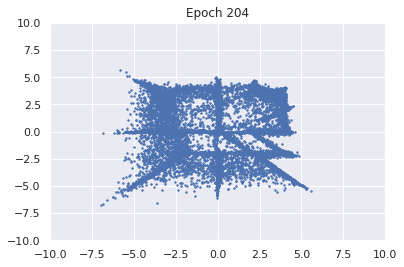

100%|██████████| 976/976 [00:09<00:00, 103.06it/s]


D loss : 1.0803, GP_loss : 0.0 G_loss : -0.5789, MI : 0.7379


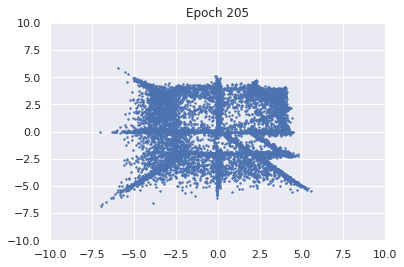

100%|██████████| 976/976 [00:09<00:00, 102.56it/s]


D loss : 1.0794, GP_loss : 0.0 G_loss : -0.5688, MI : 0.7271


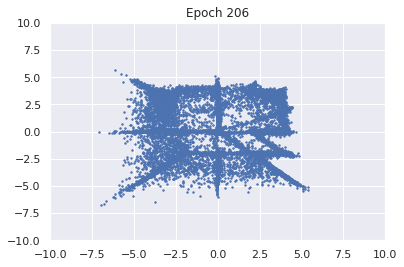

100%|██████████| 976/976 [00:09<00:00, 101.90it/s]


D loss : 1.082, GP_loss : 0.0 G_loss : -0.5732, MI : 0.7284


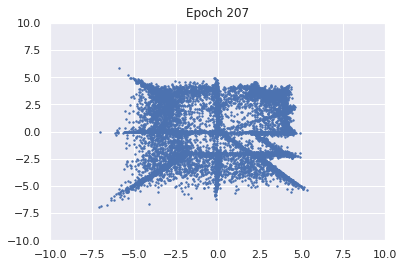

100%|██████████| 976/976 [00:10<00:00, 97.14it/s]


D loss : 1.0829, GP_loss : 0.0 G_loss : -0.5751, MI : 0.7293


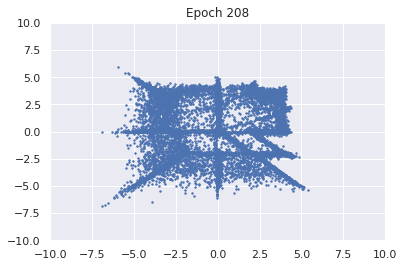

100%|██████████| 976/976 [00:10<00:00, 96.95it/s]


D loss : 1.0804, GP_loss : 0.0 G_loss : -0.5808, MI : 0.7248


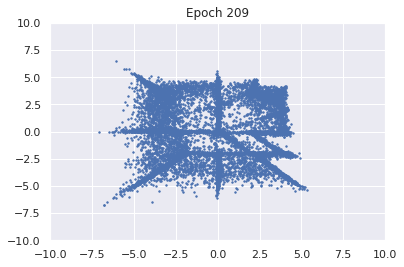

100%|██████████| 976/976 [00:09<00:00, 98.27it/s] 


D loss : 1.0832, GP_loss : 0.0 G_loss : -0.5812, MI : 0.7303


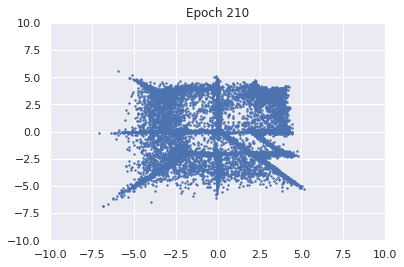

100%|██████████| 976/976 [00:09<00:00, 99.28it/s] 


D loss : 1.0904, GP_loss : 0.0 G_loss : -0.5768, MI : 0.7179


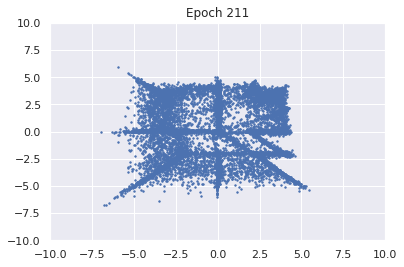

100%|██████████| 976/976 [00:09<00:00, 97.67it/s]


D loss : 1.0872, GP_loss : 0.0 G_loss : -0.58, MI : 0.7157


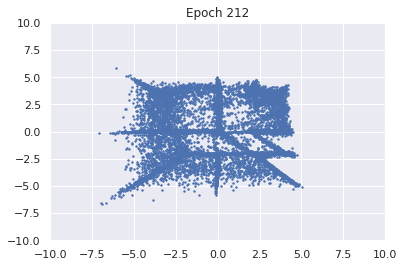

100%|██████████| 976/976 [00:09<00:00, 98.29it/s]


D loss : 1.0921, GP_loss : 0.0 G_loss : -0.5782, MI : 0.727


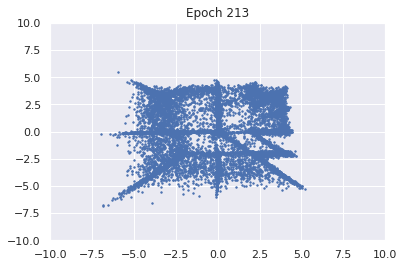

100%|██████████| 976/976 [00:12<00:00, 77.27it/s]


D loss : 1.0842, GP_loss : 0.0 G_loss : -0.5843, MI : 0.7235


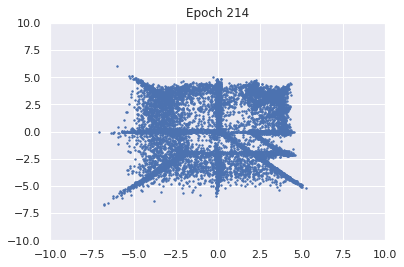

100%|██████████| 976/976 [00:11<00:00, 87.13it/s]


D loss : 1.091, GP_loss : 0.0 G_loss : -0.5809, MI : 0.729


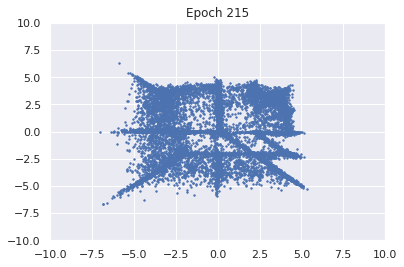

100%|██████████| 976/976 [00:10<00:00, 95.44it/s]


D loss : 1.0868, GP_loss : 0.0 G_loss : -0.5788, MI : 0.7161


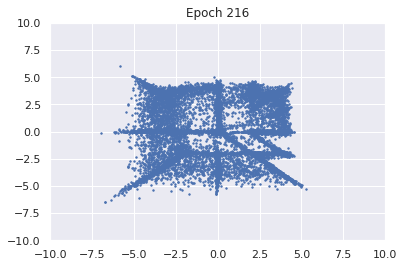

100%|██████████| 976/976 [00:10<00:00, 96.64it/s]


D loss : 1.0923, GP_loss : 0.0 G_loss : -0.5839, MI : 0.7243


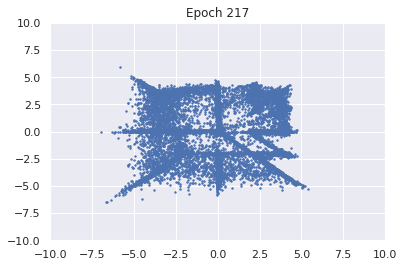

100%|██████████| 976/976 [00:10<00:00, 97.46it/s]


D loss : 1.0903, GP_loss : 0.0 G_loss : -0.5851, MI : 0.7253


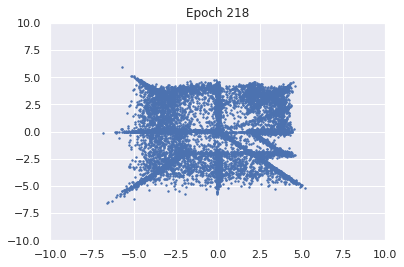

100%|██████████| 976/976 [00:10<00:00, 96.54it/s]


D loss : 1.0921, GP_loss : 0.0 G_loss : -0.5771, MI : 0.7206


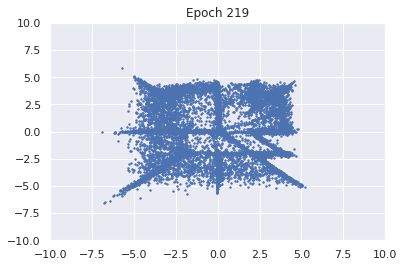

100%|██████████| 976/976 [00:10<00:00, 97.29it/s]


D loss : 1.0919, GP_loss : 0.0 G_loss : -0.5841, MI : 0.7233


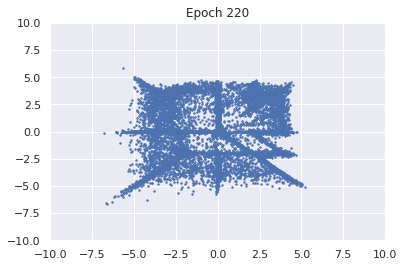

100%|██████████| 976/976 [00:10<00:00, 97.19it/s]


D loss : 1.0966, GP_loss : 0.0 G_loss : -0.5848, MI : 0.723


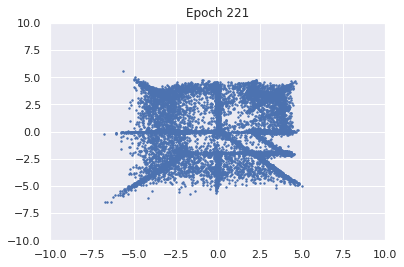

100%|██████████| 976/976 [00:09<00:00, 98.73it/s]


D loss : 1.0978, GP_loss : 0.0 G_loss : -0.5804, MI : 0.7192


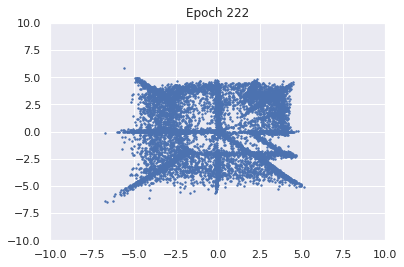

100%|██████████| 976/976 [00:10<00:00, 97.38it/s]


D loss : 1.0977, GP_loss : 0.0 G_loss : -0.5732, MI : 0.7227


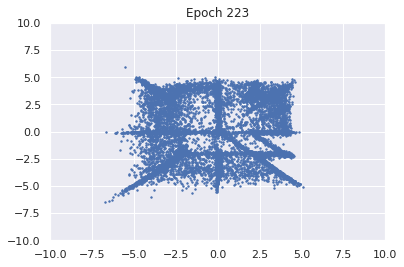

100%|██████████| 976/976 [00:10<00:00, 96.48it/s]


D loss : 1.0988, GP_loss : 0.0 G_loss : -0.5804, MI : 0.7299


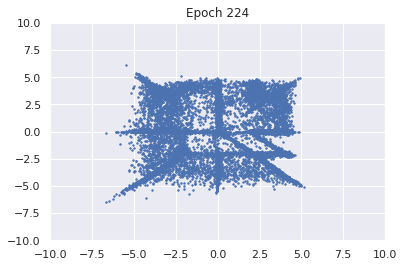

100%|██████████| 976/976 [00:12<00:00, 77.12it/s]


D loss : 1.0991, GP_loss : 0.0 G_loss : -0.5802, MI : 0.7244


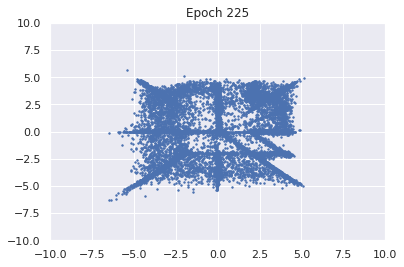

100%|██████████| 976/976 [00:10<00:00, 95.99it/s]


D loss : 1.1, GP_loss : 0.0 G_loss : -0.5841, MI : 0.7278


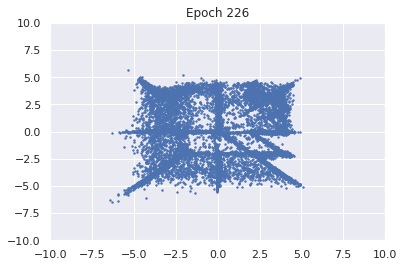

100%|██████████| 976/976 [00:10<00:00, 95.23it/s]


D loss : 1.0979, GP_loss : 0.0 G_loss : -0.5822, MI : 0.7272


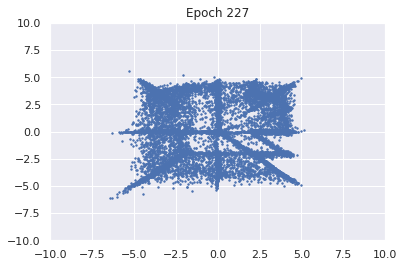

100%|██████████| 976/976 [00:10<00:00, 95.84it/s]


D loss : 1.1001, GP_loss : 0.0 G_loss : -0.5822, MI : 0.728


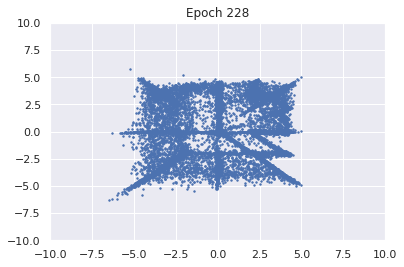

100%|██████████| 976/976 [00:10<00:00, 95.75it/s]


D loss : 1.1007, GP_loss : 0.0 G_loss : -0.5876, MI : 0.7329


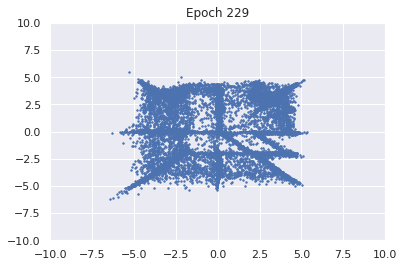

100%|██████████| 976/976 [00:10<00:00, 96.89it/s]


D loss : 1.1012, GP_loss : 0.0 G_loss : -0.5806, MI : 0.7339


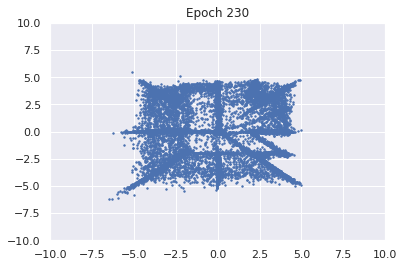

100%|██████████| 976/976 [00:10<00:00, 97.26it/s]


D loss : 1.1048, GP_loss : 0.0 G_loss : -0.5787, MI : 0.7331


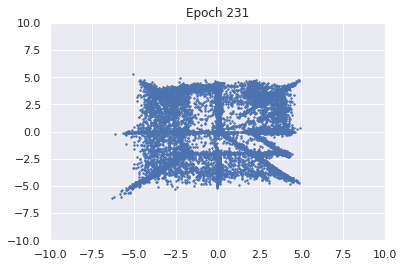

100%|██████████| 976/976 [00:10<00:00, 95.26it/s]


D loss : 1.1108, GP_loss : 0.0 G_loss : -0.5858, MI : 0.7393


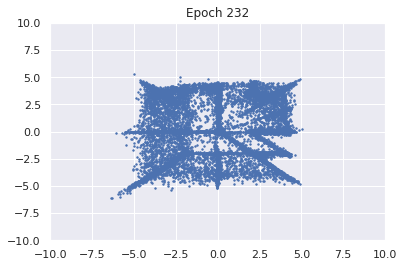

100%|██████████| 976/976 [00:10<00:00, 92.44it/s]


D loss : 1.1108, GP_loss : 0.0 G_loss : -0.5847, MI : 0.7302


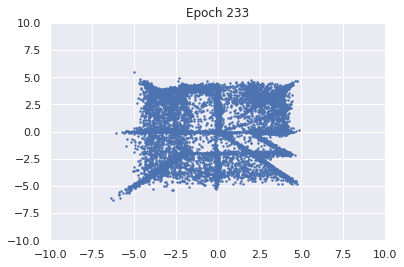

100%|██████████| 976/976 [00:12<00:00, 78.63it/s]


D loss : 1.11, GP_loss : 0.0 G_loss : -0.5869, MI : 0.7398


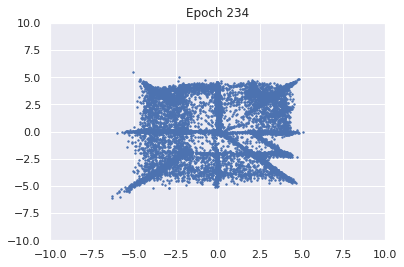

 81%|████████  | 789/976 [00:08<00:01, 97.79it/s]

In [ ]:
# non MI augmented GAN
G = Generator()
G_ma = Generator()
D = Discriminator()
M = Mine()

if USE_GPU:
    G, G_ma, D, M = G.cuda(), G_ma.cuda(), D.cuda(), M.cuda()

G_ma.load_state_dict(G.state_dict())

G_opt = torch.optim.Adam(G.parameters(), lr=2e-4)
D_opt = torch.optim.Adam(D.parameters(), lr=2e-4)
M_opt = torch.optim.Adam(M.parameters(), lr=2e-4)

train(is_zero_gp=False, is_mi_obj=False)